# Imports

In [ ]:
import numpy
import torch
import torch.nn as nn
from collections import OrderedDict
import os
import sys
import warnings
from torch.utils.data import DataLoader
import argparse
import time
import copy
import math
import torchvision.utils as vision_utils
import json
import numpy as np
from torch.distributions import bernoulli
from scipy import linalg
import torchvision.datasets as _datasets
import torchvision.transforms as _transforms
import matplotlib.pyplot as plt
import shutil

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Models

In [ ]:
_NOISE_DIM = 128
_H_FILTERS = 64


class DiscriminatorCNN28(nn.Module):

    def __init__(self, img_channels=1, h_filters=_H_FILTERS,
                 spectral_norm=False, img_size=None, n_outputs=1):
        if any(not isinstance(_arg, int) for _arg in [img_channels, h_filters, n_outputs]):
            raise TypeError("Unsupported operand type. Expected integer.")
        if not isinstance(spectral_norm, bool):
            raise TypeError(f"Unsupported operand type: {type(spectral_norm)}. "
                            "Expected bool.")
        if min([img_channels, h_filters, n_outputs]) <= 0:
            raise ValueError("Expected nonzero positive input arguments for: the "
                             "number of output channels, the dimension of the noise "
                             "vector, as well as the depth of the convolution kernels.")
        super(DiscriminatorCNN28, self).__init__()
        # _conv = nn.utils.spectral_norm(nn.Conv2d) if spectral_norm else nn.Conv2d
        _apply_sn = lambda x: nn.utils.spectral_norm(x) if spectral_norm else x
        self.img_channels = img_channels
        self.img_size = img_size
        self.n_outputs = n_outputs
        self.main = nn.Sequential(
            _apply_sn(nn.Conv2d(img_channels, h_filters, 4, 2, 1, bias=False)),
            nn.LeakyReLU(0.2, inplace=True),
            _apply_sn(nn.Conv2d(h_filters, h_filters * 2, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(h_filters * 2),
            nn.LeakyReLU(0.2, inplace=True),
            _apply_sn(nn.Conv2d(h_filters * 2, h_filters * 4, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(h_filters * 4),
            nn.LeakyReLU(0.2, inplace=True),
            _apply_sn(nn.Conv2d(h_filters * 4, self.n_outputs, 3, 1, 0, bias=False))        
        )

    def forward(self, x):
        if self.img_channels is not None and self.img_size is not None:
            if numpy.prod(list(x.size())) % (self.img_size ** 2 * self.img_channels) != 0:
                raise ValueError(f"Size mismatch. Input size: {numpy.prod(list(x.size()))}. "
                                 f"Expected input divisible by: {self.noise_dim}")
            x = x.view(-1, self.img_channels, self.img_size, self.img_size)
        x = self.main(x)
        return x.view(-1, self.n_outputs)

    def load(self, model):
      self.load_state_dict(model.state_dict())


class GeneratorCNN28(nn.Module):

    def __init__(self, img_channels=1, noise_dim=_NOISE_DIM, h_filters=_H_FILTERS, out_tanh=False):
        if any(not isinstance(_arg, int) for _arg in [img_channels, noise_dim, h_filters]):
            raise TypeError("Unsupported operand type. Expected integer.")
        if min([img_channels, noise_dim, h_filters]) <= 0:
            raise ValueError("Expected strictly positive input arguments for the "
                             "number of output channels, the dimension of the noise "
                             "vector, as well as the depth of the convolution kernels.")
        super(GeneratorCNN28, self).__init__()
        self.noise_dim = noise_dim
        self.main = nn.Sequential(
            nn.ConvTranspose2d(noise_dim, h_filters * 8, 3, 1, 0, bias=False),
            nn.BatchNorm2d(_H_FILTERS * 8),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(h_filters * 8, h_filters * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(_H_FILTERS * 4),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(h_filters * 4, h_filters * 2, 4, 2, 0, bias=False),
            nn.BatchNorm2d(_H_FILTERS * 2),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(h_filters * 2, img_channels, 4, 2, 1, bias=False),
            nn.Tanh() if out_tanh else nn.Sigmoid()
        )

    def forward(self, x):

        if numpy.prod(list(x.size())) % self.noise_dim != 0:
            raise ValueError(f"Size mismatch. Input size: {numpy.prod(list(x.size()))}. "
                             f"Expected input divisible by: {self.noise_dim}")
        x = x.view(-1, self.noise_dim, 1, 1)
        x = self.main(x)
        return x

    def load(self, model):
      self.load_state_dict(model.state_dict())


class MLP_mnist(nn.Module):
  def __init__(self, input_dims, n_hiddens, n_class):
    super(MLP_mnist, self).__init__()
    assert isinstance(input_dims, int), 'Expected int for input_dims'
    self.input_dims = input_dims
    current_dims = input_dims
    layers = OrderedDict()

    if isinstance(n_hiddens, int):
      n_hiddens = [n_hiddens]
    else:
      n_hiddens = list(n_hiddens)
    for i, n_hidden in enumerate(n_hiddens):
      layers['fc{}'.format(i+1)] = nn.Linear(current_dims, n_hidden)
      layers['relu{}'.format(i+1)] = nn.ReLU()
      layers['drop{}'.format(i+1)] = nn.Dropout(0.2)
      current_dims = n_hidden
    layers['out'] = nn.Linear(current_dims, n_class)
    self.layers = layers
    self.model= nn.Sequential(layers)
    #print(self.model)

  def forward(self, input):
    input = input.view(input.size(0), -1)
    assert input.size(1) == self.input_dims
    return self.model.forward(input)

  def get_logits_and_fc2_outputs(self, x):
    x = x.view(x.size(0), -1)
    assert x.size(1) == self.input_dims
    fc2_out = None
    for l in self.model:
      x = l(x)
      if l == self.layers["fc2"]:
        fc2_out = x
    return x, fc2_out


def pretrained_mnist_model(input_dims=784, n_hiddens=[256, 256], n_class=10, 
                           pretrained=None):
    model = MLP_mnist(input_dims, n_hiddens, n_class)
    if pretrained is not None:
        if os.path.exists(pretrained):
            print('Loading trained model from %s' % pretrained)
            state_dict = torch.load(pretrained,
                    map_location='cuda:0' if torch.cuda.is_available() else 'cpu')
            if 'parallel' in pretrained:
                new_state_dict = OrderedDict()
                for k, v in state_dict.items():
                    name = k[7:]  # remove `module.`
                    new_state_dict[name] = v
                state_dict = new_state_dict
        else:
            import torch.utils.model_zoo as model_zoo
            model_urls = {'mnist': 
                          'http://ml.cs.tsinghua.edu.cn/~chenxi/pytorch-models/mnist-b07bb66b.pth'}
            m = model_zoo.load_url(model_urls['mnist'],
                                   map_location='cuda:0' if torch.cuda.is_available() else 'cpu')
            state_dict = m.state_dict() if isinstance(m, nn.Module) else m
            assert isinstance(state_dict, (dict, OrderedDict)), type(state_dict)
        model.load_state_dict(state_dict)
    if torch.cuda.is_available():
        model = model.cuda()
    return model

# Dataloader

In [ ]:
class Binarize(object):
  def __init__(self, threshold=0.3):
    self.threshold = threshold
      
  def __call__(self, t):
    t = (t > self.threshold).float()
    return t
  
  def __repr__(self):
    return self.__class__.__name__ + '(th={0})'.format(self.threshold)


class Smooth(object):
  def __init__(self, smooth=0.1):
    self.smooth = smooth
      
  def __call__(self, t):
    t[t == 1.] = 1 - self.smooth
    t[t == 0.] = 0 + self.smooth
    return t
  
  def __repr__(self):
    return self.__class__.__name__ + '(smooth={0})'.format(self.smooth)


def load_mnist(_data_root='datasets', binarized=False, bin_th=0.3, smooth=None):
    trans = [_transforms.ToTensor()]
    if binarized:
      binarizor = Binarize(bin_th)
      trans.append(binarizor)
    if smooth is not None:
      smoother = Smooth(smooth)
      trans.append(smoother)
    trans = _transforms.Compose(trans)
    _data = _datasets.MNIST(_data_root, train=True, download=True,
                            transform=trans)
    return _data

# Training Function

In [ ]:
from collections import defaultdict
from itertools import chain
from torch.optim import Optimizer
import torch
import warnings
import random


class Lookahead(Optimizer):

    def __init__(self, optimizer, k=5, alpha=0.5, k_min=3, k_max=1000):
        print("Using lookahead.")
        self.optimizer = optimizer
        self.resample_k = (k <= 0)
        self.k_min = k_min
        self.k_max = k_max
        self.k = k if k > 0 else random.randint(k_min, k_max)  # endpoints included
        self.alpha = alpha
        self.param_groups = self.optimizer.param_groups
        self.state = defaultdict(dict)
        self.fast_state = self.optimizer.state
        for group in self.param_groups:
            group["counter"] = 0

    def update(self, group):
        for fast in group["params"]:
            param_state = self.state[fast]
            if "slow_param" not in param_state:
                param_state["slow_param"] = torch.zeros_like(fast.data)
                param_state["slow_param"].copy_(fast.data)
            slow = param_state["slow_param"]
            slow += (fast.data - slow) * self.alpha
            fast.data.copy_(slow)
        if self.resample_k:
            self.k = random.randint(self.k_min, self.k_max)

    def update_lookahead(self):
        for group in self.param_groups:
            self.update(group)

    def step(self, closure=None):
        loss = self.optimizer.step(closure)
        return loss
    
    def increment_counter(self):
        for group in self.param_groups:
            group["counter"] += 1

    def state_dict(self):
        fast_state_dict = self.optimizer.state_dict()
        slow_state = {
            (id(k) if isinstance(k, torch.Tensor) else k): v
            for k, v in self.state.items()
        }
        fast_state = fast_state_dict["state"]
        param_groups = fast_state_dict["param_groups"]
        return {
            "fast_state": fast_state,
            "slow_state": slow_state,
            "param_groups": param_groups,
        }

    def load_state_dict(self, state_dict):
        slow_state_dict = {
            "state": state_dict["slow_state"],
            "param_groups": state_dict["param_groups"],
        }
        fast_state_dict = {
            "state": state_dict["fast_state"],
            "param_groups": state_dict["param_groups"],
        }
        super(Lookahead, self).load_state_dict(slow_state_dict)
        self.optimizer.load_state_dict(fast_state_dict)
        self.fast_state = self.optimizer.state

    def add_param_group(self, param_group):
        param_group["counter"] = 0
        self.optimizer.add_param_group(param_group)

In [ ]:
def get_disciminator_loss(D, x_real, x_gen, lbl_real, lbl_fake):
  """"""
  D_x = D(x_real)
  D_G_z = D(x_gen)
  lossD_real = torch.binary_cross_entropy_with_logits(D_x, lbl_real).mean()
  lossD_fake = torch.binary_cross_entropy_with_logits(D_G_z, lbl_fake).mean()
  lossD = lossD_real + lossD_fake
  return lossD


def get_generator_loss(G, D, z, lbl_real):
  """"""
  D_G_z = D(G(z))
  lossG = torch.binary_cross_entropy_with_logits(D_G_z, lbl_real).mean()
  return lossG


def get_sampler(dataset, batch_size, shuffle=True, num_workers=1, drop_last=True):
  dataloader = DataLoader(dataset, batch_size, shuffle=shuffle, 
                          num_workers=num_workers, drop_last=drop_last)
  dataloader_iterator = iter(dataloader)
  def sampler():
    nonlocal dataloader_iterator
    try:
        data = next(dataloader_iterator) 
    except StopIteration:
        dataloader_iterator = iter(dataloader)
        data = next(dataloader_iterator) 
    return data
  return sampler


def update_avg_gen(G, G_avg, n_gen_update):
    """ Updates the uniform average generator. """
    l_param = list(G.parameters())
    l_avg_param = list(G_avg.parameters())
    if len(l_param) != len(l_avg_param):
        raise ValueError("Got different lengths: {}, {}".format(len(l_param), len(l_avg_param)))

    for i in range(len(l_param)):
        with torch.no_grad():
            l_avg_param[i].data.copy_(l_avg_param[i].data.mul(n_gen_update).div(n_gen_update + 1.).add(
                                      l_param[i].data.div(n_gen_update + 1.)))

def update_ema_gen(G, G_ema, beta_ema=0.9999):
    """ Updates the exponential moving average generator. """
    l_param = list(G.parameters())
    l_ema_param = list(G_ema.parameters())
    if len(l_param) != len(l_ema_param):
        raise ValueError("Got different lengths: {}, {}".format(len(l_param), len(l_ema_param)))

    for i in range(len(l_param)):
        with torch.no_grad():
            l_ema_param[i].data.copy_(l_ema_param[i].data.mul(beta_ema).add(
                l_param[i].data.mul(1-beta_ema)))


def train(G, D, dataset, iterations, batch_size=32, lrD=0.01, lrG=0.01, 
          beta1=0.99, eval_every=100, n_workers=5, device=torch.device('cpu'), 
          grad_max_norm=1, plot_func=lambda a,b,c,d: None, extragrad=False, 
          lookahead=False, lookahead_k=5, eval_avg=False, out_dir=None):
  
  sampler = get_sampler(dataset, batch_size, shuffle=True, 
                        num_workers=n_workers, drop_last=True)

  if extragrad:
    D_extra = copy.deepcopy(D)
    G_extra = copy.deepcopy(G)
  else:
    D_extra = D
    G_extra = G

  # Optimizers
  optimizerD = torch.optim.Adam(D.parameters(), lr=lrD, betas=(beta1, 0.999))
  optimizerG = torch.optim.Adam(G.parameters(), lr=lrG, betas=(beta1, 0.999))
  if lookahead:
    optimizerD = Lookahead(optimizerD, k=lookahead_k)
    optimizerG = Lookahead(optimizerG, k=lookahead_k)

  optimizerD_extra = torch.optim.Adam(D_extra.parameters(), lr=lrD, betas=(beta1, 0.999))
  optimizerG_extra = torch.optim.Adam(G_extra.parameters(), lr=lrG, betas=(beta1, 0.999))

  # LBLs
  lbl_real = torch.ones( batch_size, 1, device=device)
  lbl_fake = torch.zeros(batch_size, 1, device=device)

  fixed_noise = torch.randn(100, G.noise_dim, device=device)

  G.to(device)
  D.to(device)

  G_extra.to(device)
  D_extra.to(device)

  G_avg, G_ema = None, None
  if eval_avg:
    G_avg = copy.deepcopy(G)
    G_ema = copy.deepcopy(G)

  start_time = time.perf_counter()

  for i in range(iterations):

    # STEP 1: get G_{t+1} (G_extra)
    if extragrad:
      optimizerG_extra.zero_grad()
      z = torch.randn(batch_size, G_extra.noise_dim, device=device)
      lossG = get_generator_loss(G_extra, D, z, lbl_real)
      lossG.backward()
      optimizerG_extra.step()

    # STEP 3: Get D_{t+1} (D_extra)
    if extragrad:
      optimizerD_extra.zero_grad()
      x_real, _ = sampler()
      x_real = x_real.to(device)
      z = torch.randn(batch_size, G.noise_dim, device=device)
      with torch.no_grad():
        x_gen = G(z)
      lossD = get_disciminator_loss(D_extra, x_real, x_gen, lbl_real, lbl_fake)
      lossD.backward()
      optimizerD_extra.step()

    # STEP 2: D optimization step using G_extra
    x_real, _ = sampler()
    x_real = x_real.to(device)
    z = torch.randn(batch_size, G.noise_dim, device=device)
    with torch.no_grad():
      x_gen = G_extra(z) # using G_{t+1}
    optimizerD.zero_grad()
    lossD = get_disciminator_loss(D, x_real, x_gen, lbl_real, lbl_fake)
    lossD.backward()
    if grad_max_norm is not None:
      nn.utils.clip_grad_norm_(D.parameters(), grad_max_norm)
    optimizerD.step()

    # STEP 4: G optimization step using D_extra
    z = torch.randn(batch_size, G.noise_dim, device=device)
    optimizerG.zero_grad()
    lossG = get_generator_loss(G, D_extra, z, lbl_real) # we use the unrolled D
    lossG.backward()
    if grad_max_norm is not None:
      nn.utils.clip_grad_norm_(G.parameters(), grad_max_norm)
    optimizerG.step()

    if extragrad:
      G_extra.load_state_dict(G.state_dict())
      D_extra.load_state_dict(D.state_dict())

    if eval_avg:
      update_avg_gen(G, G_avg, i)
      update_ema_gen(G, G_ema, beta_ema=0.9999)

    if lookahead and (i+1) % lookahead_k == 0: 
      optimizerG.update_lookahead()
      optimizerD.update_lookahead()

    if i % 20000 == 0:
      save_models(G, D, optimizerG, optimizerD, out_dir, suffix=f"{i}")

    # Just plotting things
    if i % eval_every == 0 or i == iterations-1:
      if out_dir is not None:
        save_models(G, D, optimizerG, optimizerD, out_dir, suffix="last")
      with torch.no_grad():
        probas = torch.sigmoid(D(G(fixed_noise)))
        mean_proba = probas.mean().cpu().item()
        std_proba = probas.std().cpu().item()
        samples = G(fixed_noise)
      print(f"Iter {i}: Mean proba from D(G(z)): {mean_proba:.4f} +/- {std_proba:.4f}")
      plot_func(samples.detach().cpu(), time_tick=time.perf_counter() - start_time, D=D, G=G, iteration=i, G_avg=G_avg, G_ema=G_ema)
  

# Display & Eval

In [ ]:
def compute_mu_sigma_pretrained_model(dataset, pretrained_clf):
  dataloader = DataLoader(dataset, batch_size=512, num_workers=2, drop_last=True)
  cuda = next(pretrained_clf.parameters()).is_cuda
  all_fc2_out = []
  pretrained_clf.eval()
  for batch, _ in dataloader:
    with torch.no_grad():
      if cuda:
        batch = batch.cuda()
      _, fc2_out = pretrained_clf.get_logits_and_fc2_outputs(batch)
    all_fc2_out.append(fc2_out.cpu())
  all_fc2_out = torch.cat(all_fc2_out, dim=0).numpy()
  mu_real = np.mean(all_fc2_out, axis=0)
  sigma_real = np.cov(all_fc2_out, rowvar=False)
  return mu_real, sigma_real


def calculate_frechet_distance(mu1, sigma1, mu2, sigma2, eps=1e-6):
    """Numpy implementation of the Frechet Distance."""
    mu1 = np.atleast_1d(mu1)
    mu2 = np.atleast_1d(mu2)

    sigma1 = np.atleast_2d(sigma1)
    sigma2 = np.atleast_2d(sigma2)

    assert mu1.shape == mu2.shape, "Training and test mean vectors have different lengths"
    assert sigma1.shape == sigma2.shape, "Training and test covariances have different dimensions"

    diff = mu1 - mu2

    # product might be almost singular
    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if not np.isfinite(covmean).all():
        msg = "fid calculation produces singular product; adding %s to diagonal of cov estimates" % eps
        print(msg)
        # warnings.warn(msg)
        offset = np.eye(sigma1.shape[0]) * eps
        covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))

    # numerical error might give slight imaginary component
    if np.iscomplexobj(covmean):
        if not np.allclose(np.diagonal(covmean).imag, 0, atol=1e-3):
            m = np.max(np.abs(covmean.imag))
            raise ValueError("Imaginary component {}".format(m))
        covmean = covmean.real
    tr_covmean = np.trace(covmean)

    return diff.dot(diff) + np.trace(sigma1) + np.trace(sigma2) - 2 * tr_covmean


def _calculate_metrics(pretrained_clf, G, dataset_length, mu_real, sigma_real, 
                       n_classes=10, batch_size=1024):
    cuda = next(pretrained_clf.parameters()).is_cuda
    if cuda:
      device = torch.device('cuda')
    else:
      device = torch.device('cpu')
    # Using pretrained clf to get predictions over fake data
    inception_predictions, all_fc2_out, class_probas = [], [], []
    dataloader = DataLoader(list(range(dataset_length)), batch_size, num_workers=2, drop_last=True)
    pretrained_clf.eval()
    for batch in dataloader:
      with torch.no_grad():
        noise = torch.randn(batch_size, G.noise_dim, device=device)
        probas, fc2_out = pretrained_clf.get_logits_and_fc2_outputs(G(noise).view(batch_size, -1))
      all_fc2_out.append(fc2_out.cpu())
      class_probas.append(probas.cpu())
    all_fc2_out = torch.cat(all_fc2_out, dim=0).numpy()
    class_probas = torch.cat(class_probas, dim=0)
    inception_predictions = torch.softmax(class_probas, dim=1).numpy()
    class_probas = class_probas.numpy()
    pred_prob = np.maximum(class_probas, 1e-20 * np.ones_like(class_probas))

    y_vec = 1e-20 * np.ones((len(pred_prob), n_classes), dtype=np.float)  # pred label distr
    gnd_vec = 0.1 * np.ones((1, n_classes), dtype=np.float)  # gnd label distr, uniform over classes

    for i, label in enumerate(pred_prob):
        y_vec[i, np.argmax(pred_prob[i])] = 1.0
    y_vec = np.sum(y_vec, axis=0, keepdims=True)
    y_vec = y_vec / np.sum(y_vec)

    label_entropy = np.sum(-y_vec * np.log(y_vec)).tolist()
    label_tv = np.true_divide(np.sum(np.abs(y_vec - gnd_vec)), 2).tolist()
    label_l2 = np.sum((y_vec - gnd_vec) ** 2).tolist()

    # --- is ----
    inception_scores = []
    for i in range(n_classes):
        part = inception_predictions[(i * inception_predictions.shape[0]
                                      // n_classes):((i + 1) * inception_predictions.shape[0]
                                                     // n_classes), :]
        kl = part * (np.log(part) - np.log(np.expand_dims(np.mean(part, 0), 0)))
        kl = np.mean(np.sum(kl, 1))
        inception_scores.append(np.exp(kl))

    mu = np.mean(all_fc2_out, axis=0)
    sigma = np.cov(all_fc2_out, rowvar=False)
    _fid = calculate_frechet_distance(mu, sigma, mu_real, sigma_real)

    return (label_entropy, label_tv, label_l2,
            float(np.mean(inception_scores)),
            float(np.std(inception_scores)),
            _fid)


def get_metrics(pretrained_clf, dataset_length, mu_real, sigma_real, G):
    """Calculates entropy, TV, L2, and inception scores."""
    e, tv, l2, is_m, is_std, fid = _calculate_metrics(pretrained_clf,
                                                      G,
                                                      dataset_length,
                                                      mu_real,
                                                      sigma_real)
    m_result = {
        'entropy': e,
        'TV': tv,
        'L2': l2,
        'inception_mean': is_m,
        'inception_std': is_std,
        'fid': fid
    }
    return m_result

In [ ]:
def save_models(G, D, opt_G, opt_D, out_dir, suffix):
  torch.save(G.state_dict(), os.path.join(out_dir, f"gen_{suffix}.pth"))
  torch.save(D.state_dict(), os.path.join(out_dir, f"disc_{suffix}.pth"))
  torch.save(opt_G.state_dict(), os.path.join(out_dir, f"gen_optim_{suffix}.pth"))
  torch.save(opt_D.state_dict(), os.path.join(out_dir, f"disc_optim_{suffix}.pth"))


def get_plot_func(out_dir, img_size, num_samples_eval=10000, save_curves=None):
  dataset = load_mnist(_data_root='datasets', binarized=False)
  #shutil.rmtree(out_dir, ignore_errors=True)
  #if not os.path.exists(out_dir):
  #  os.makedirs(out_dir)
  pretrained_clf = pretrained_mnist_model(pretrained='./drive/My Drive/Data/models/mnist.pth')
  mu_real, sigma_real = compute_mu_sigma_pretrained_model(dataset, pretrained_clf)
  inception_means, inception_stds, inception_means_ema, inception_means_avg, fids, fids_ema, fids_avg = [], [], [], [], [], [], []
  iterations, times = [], []
  def plot_func(samples, iteration, time_tick, G=None, D=None, G_avg=None, G_ema=None):
    fig = plt.figure(figsize=(12,5), dpi=100)
    plt.subplot(1,2,1)
    samples = samples.view(100, *img_size)
    file_name = os.path.join(out_dir, '%08d.png' % iteration)
    vision_utils.save_image(samples, file_name, nrow=10)
    grid_img = vision_utils.make_grid(samples, nrow=10, normalize=True, padding=0)
    plt.imshow(grid_img.permute(1, 2, 0), interpolation='nearest')
    plt.subplot(1,2,2)
    metrics = get_metrics(pretrained_clf, num_samples_eval, mu_real, sigma_real, G)
    fids.append(metrics['fid'])
    inception_means.append(metrics['inception_mean'])
    inception_stds.append(metrics['inception_std'])
    if G_avg is not None:
      metrics = get_metrics(pretrained_clf, num_samples_eval, mu_real, sigma_real, G_avg)
      fids_avg.append(metrics['fid'])
      inception_means_avg.append(metrics['inception_mean'])
    if G_ema is not None:
      metrics = get_metrics(pretrained_clf, num_samples_eval, mu_real, sigma_real, G_ema)
      fids_ema.append(metrics['fid'])
      inception_means_ema.append(metrics['inception_mean'])
    iterations.append(iteration)
    times.append(time_tick)
    #  is
    is_low  = [m - s for m, s in zip(inception_means, inception_stds)]
    is_high = [m + s for m, s in zip(inception_means, inception_stds)]
    plt.plot(times, inception_means, label="is", color='r')
    plt.fill_between(times, is_low, is_high, facecolor='r', alpha=.3)
    plt.yticks(np.arange(0, 10+1, 0.5))
    # fid
    plt.plot(times, fids, label="fid", color='b')
    plt.xlabel('Time (sec)')
    plt.ylabel('Metric')
    plt.grid()
    ax = fig.gca()
    ax.set_ylim(-0.1, 10)
    plt.legend(fancybox=True, framealpha=.5)
    curves_img_file_name = os.path.join(out_dir, 'curves.png')
    fig.savefig(curves_img_file_name)
    plt.show()
    curves_file_name = os.path.join(out_dir, 'curves.json')
    curves = {
        'inception_means': list(inception_means),
        'inception_stds': list(inception_stds),
        'inception_means_ema': list(inception_means_ema),
        'inception_means_avg': list(inception_means_avg),
        'fids_ema': list(fids_ema),
        'fids_avg': list(fids_avg),
        'fids': list(fids),
        'iterations':iterations,
        'times': times
    }
    with open(curves_file_name, 'w') as fs:
      json.dump(curves, fs)
  return plot_func

# Experiments

### AltGAN

In [ ]:
args = dict(iterations = 100000,
            batch_size = 50,
            lrD = 0.001,
            lrG = 0.001,
            beta1 = 0.05,
            extragrad = False,
            eval_every = 1000,
            lookahead = False,
            eval_avg = True,
            lookahead_k = 1000,
            n_workers = 5,
            device = 'cuda',
            grad_max_norm = None)


for k in range(1,5+1):
  exp_key = f"iter{args['iterations']}_bs{args['batch_size']}_lrD{args['lrD']}" + \
            f"_lrG{args['lrG']}_beta1{args['beta1']}_lookahead{args['lookahead']}" + \
            f"_lak{args['lookahead_k']}" + \
            f"_extragrad{args['extragrad']}_ee{args['eval_every']}"
  out_dir = f"./drive/My Drive/results/final/{exp_key}/{k}/"

  shutil.rmtree(out_dir, ignore_errors=True)
  if not os.path.exists(out_dir):
    os.makedirs(out_dir)

  with open(os.path.join(out_dir, 'args.json'), 'w') as fs:
    json.dump(args, fs)

  dataset = load_mnist(_data_root='datasets', binarized=False)

  plot_func = get_plot_func(out_dir=out_dir, 
                            img_size=dataset[0][0].size(),
                            num_samples_eval=10000)

  G = GeneratorCNN28(noise_dim=_NOISE_DIM, out_tanh=True)
  D = DiscriminatorCNN28(spectral_norm=False, img_size=28)

  train(G, D, dataset, 
        iterations=args['iterations'], 
        batch_size=args['batch_size'], 
        lookahead=args['lookahead'],
        lookahead_k=args['lookahead_k'],
        eval_avg=args['eval_avg'],
        lrD=args['lrD'], 
        lrG=args['lrG'], 
        beta1=args['beta1'], 
        extragrad=args['extragrad'],
        eval_every=args['eval_every'], 
        n_workers=args['n_workers'], 
        device=torch.device(args['device']), 
        grad_max_norm=args['grad_max_norm'], 
        plot_func=plot_func,
        out_dir=out_dir)

### LA-AltGAN

Loading trained model from ./drive/My Drive/Data/models/mnist.pth
in init of lookahead
in init of lookahead
Iter 0: Mean proba from D(G(z)): 0.8568 +/- 0.0422


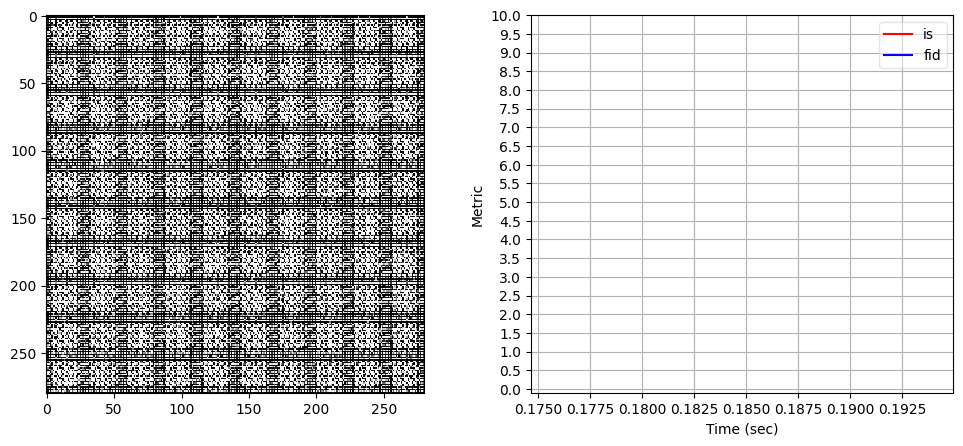

Iter 1000: Mean proba from D(G(z)): 0.0000 +/- 0.0000


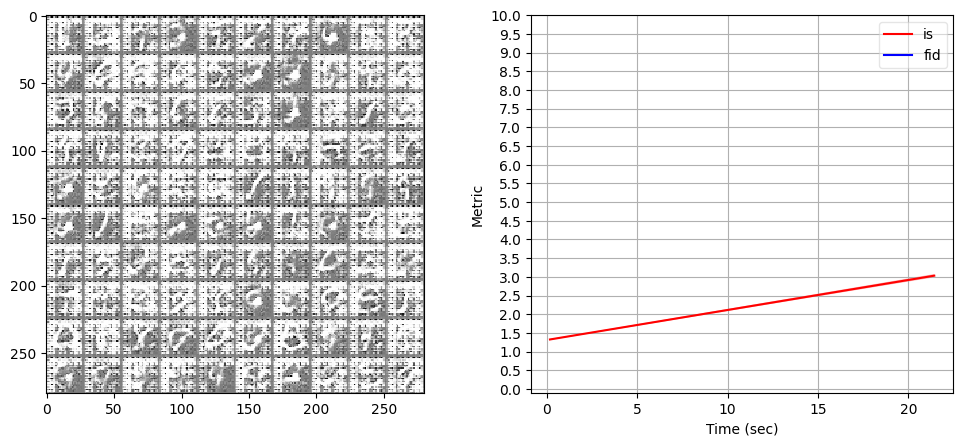

Iter 2000: Mean proba from D(G(z)): 0.0015 +/- 0.0014


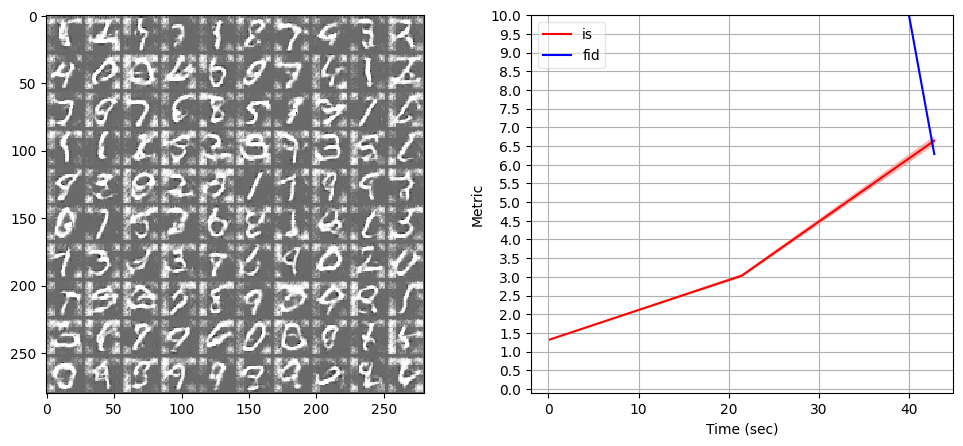

Iter 3000: Mean proba from D(G(z)): 0.2321 +/- 0.1281


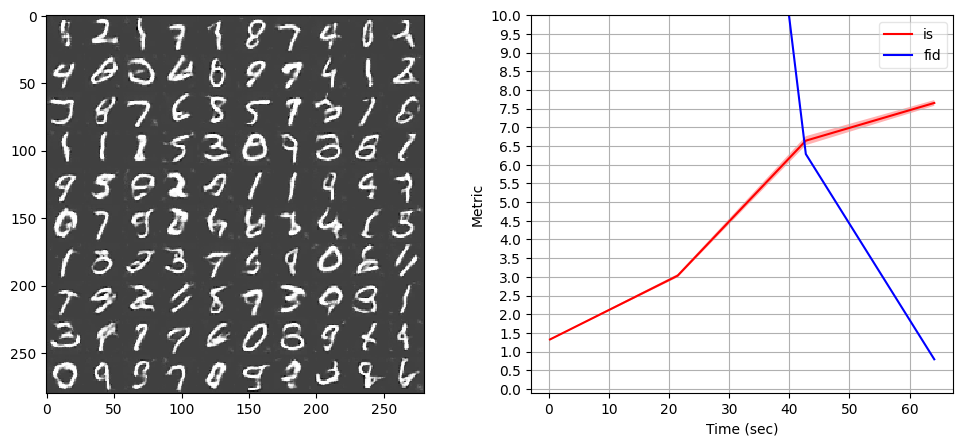

Iter 4000: Mean proba from D(G(z)): 0.4176 +/- 0.1653


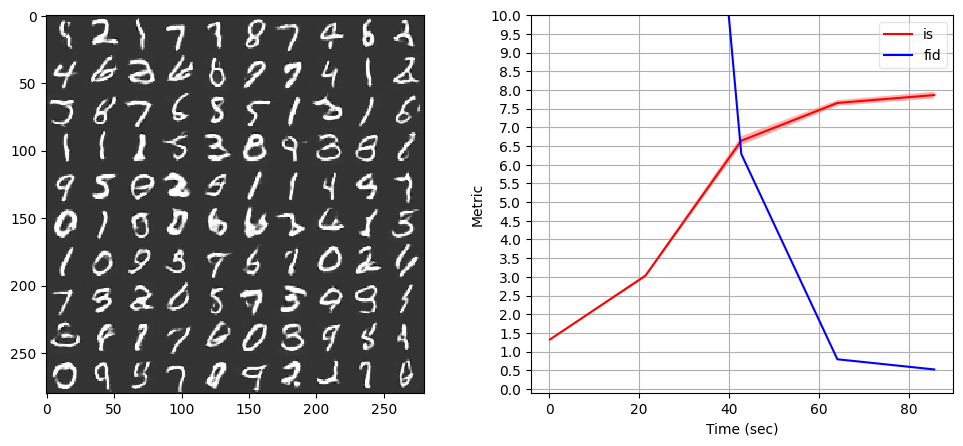

Iter 5000: Mean proba from D(G(z)): 0.3514 +/- 0.1579


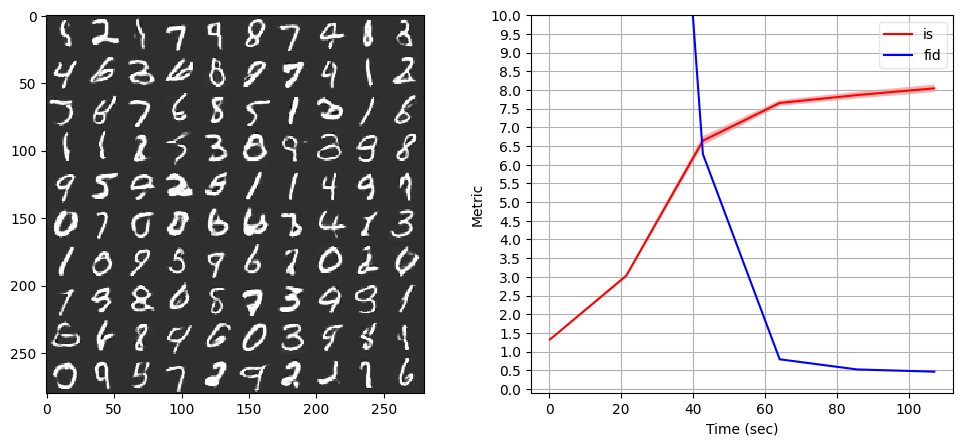

Iter 6000: Mean proba from D(G(z)): 0.4263 +/- 0.1804


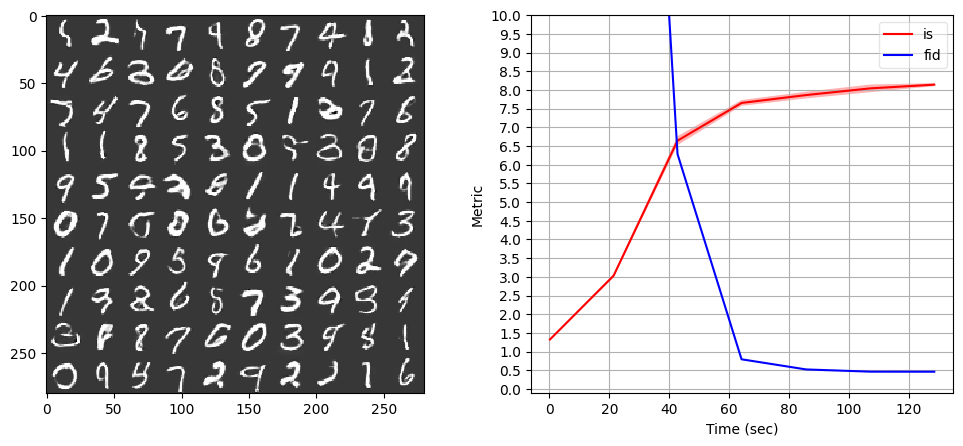

Iter 7000: Mean proba from D(G(z)): 0.4986 +/- 0.1765


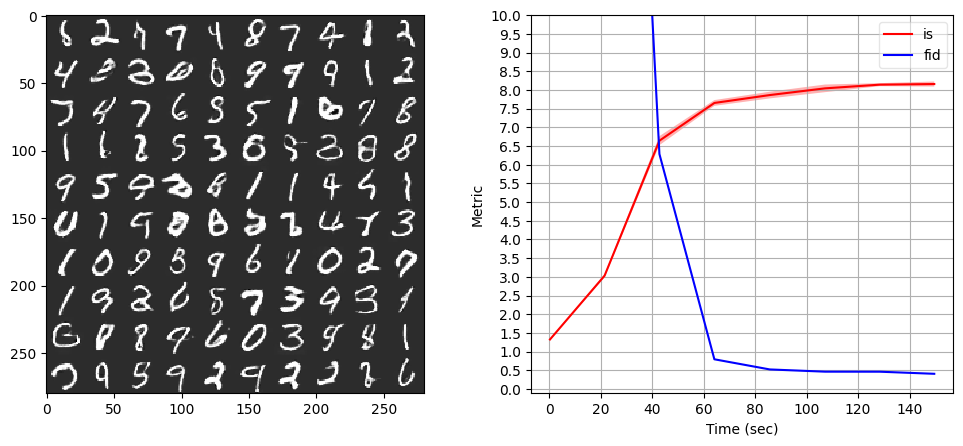

Iter 8000: Mean proba from D(G(z)): 0.6390 +/- 0.1722


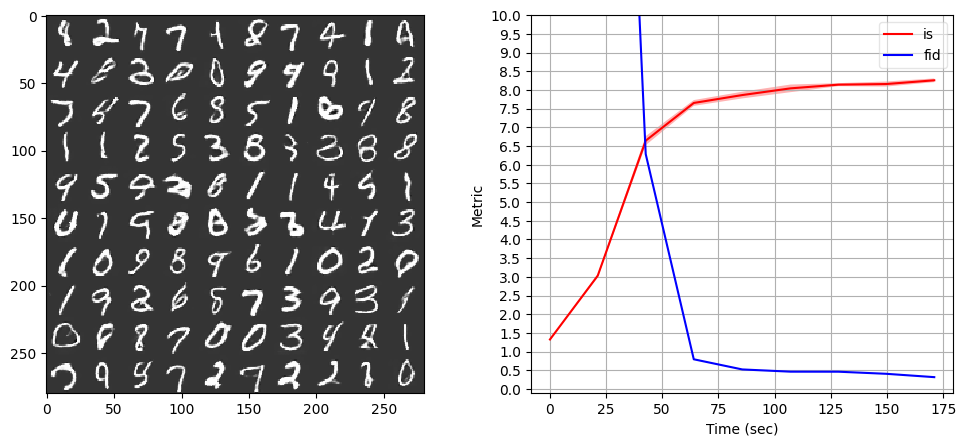

Iter 9000: Mean proba from D(G(z)): 0.6767 +/- 0.1552


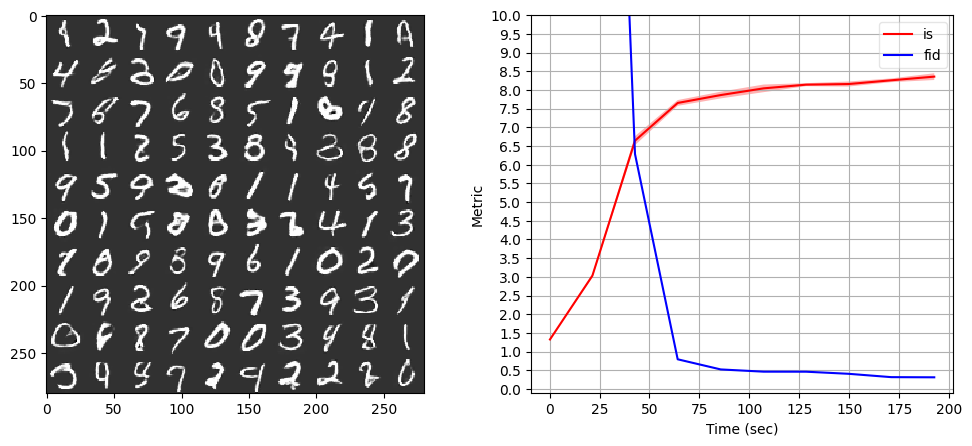

Iter 10000: Mean proba from D(G(z)): 0.6006 +/- 0.1756


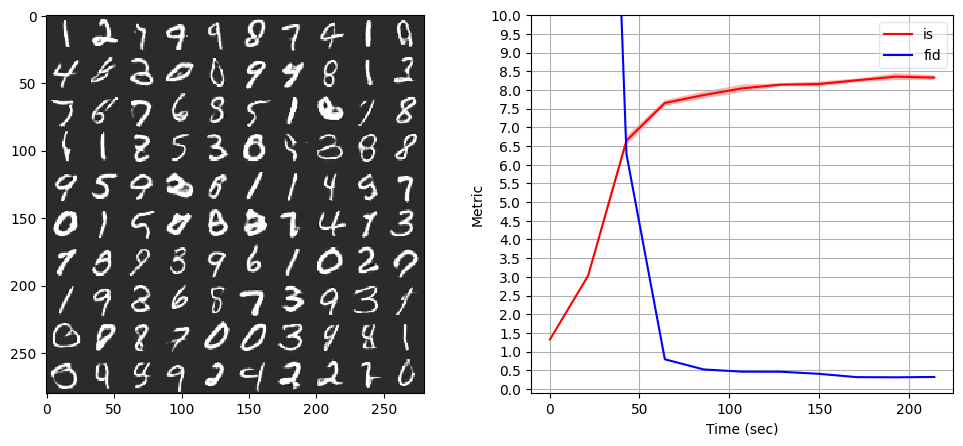

Iter 11000: Mean proba from D(G(z)): 0.3686 +/- 0.1739


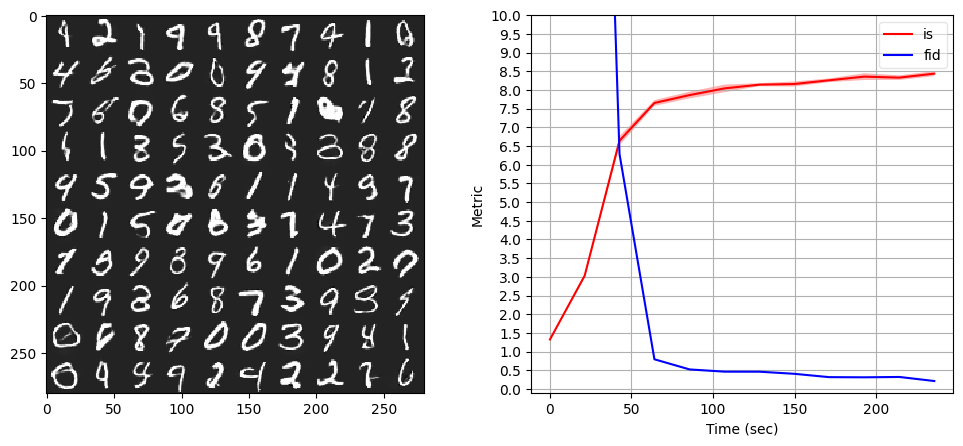

Iter 12000: Mean proba from D(G(z)): 0.2579 +/- 0.1583


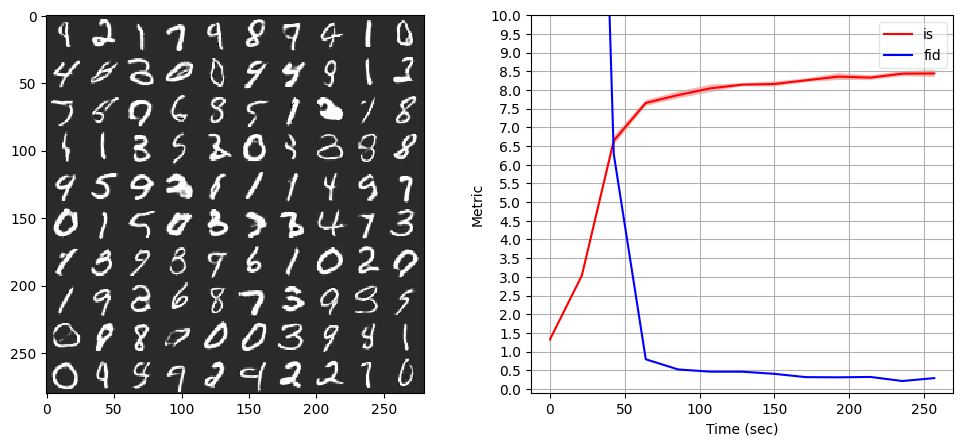

Iter 13000: Mean proba from D(G(z)): 0.3314 +/- 0.1723


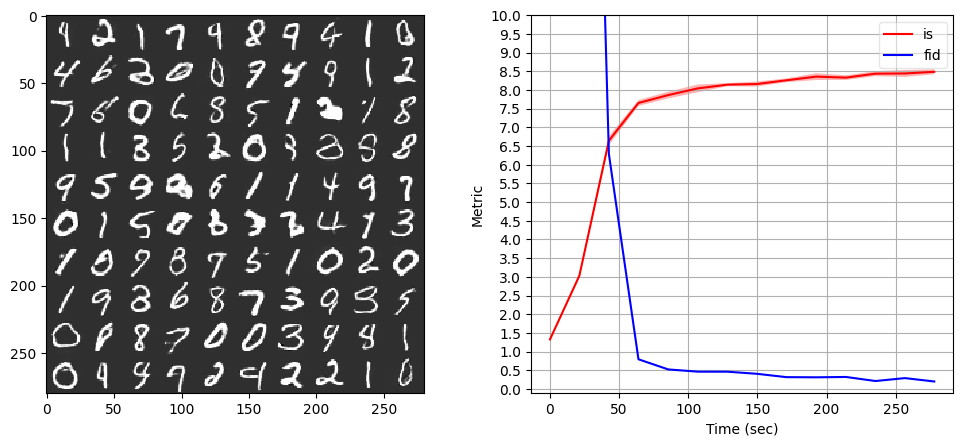

Iter 14000: Mean proba from D(G(z)): 0.2634 +/- 0.1479


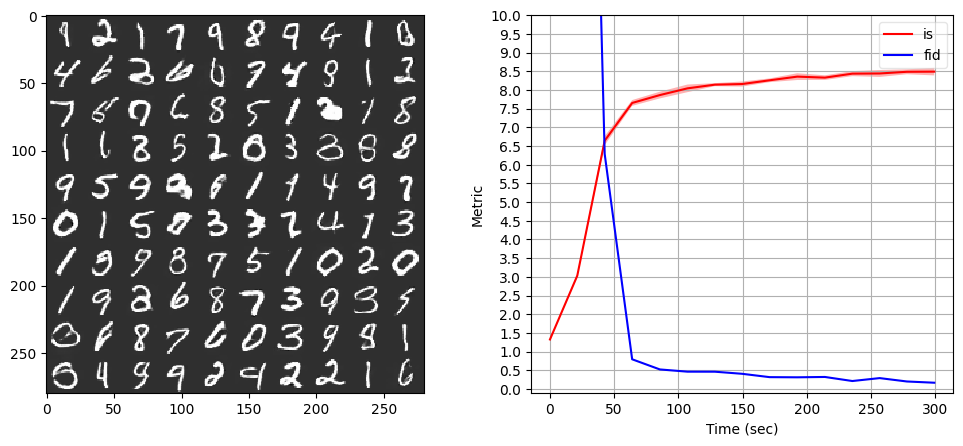

Iter 15000: Mean proba from D(G(z)): 0.2654 +/- 0.1652


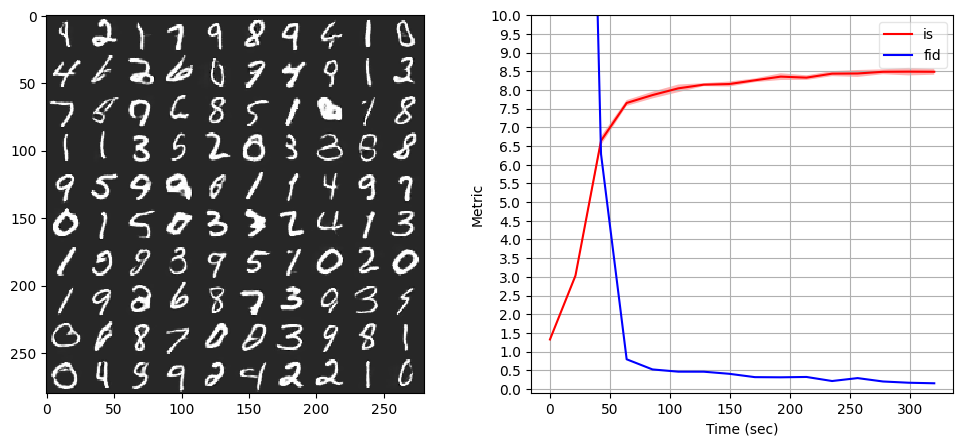

Iter 16000: Mean proba from D(G(z)): 0.3116 +/- 0.1841


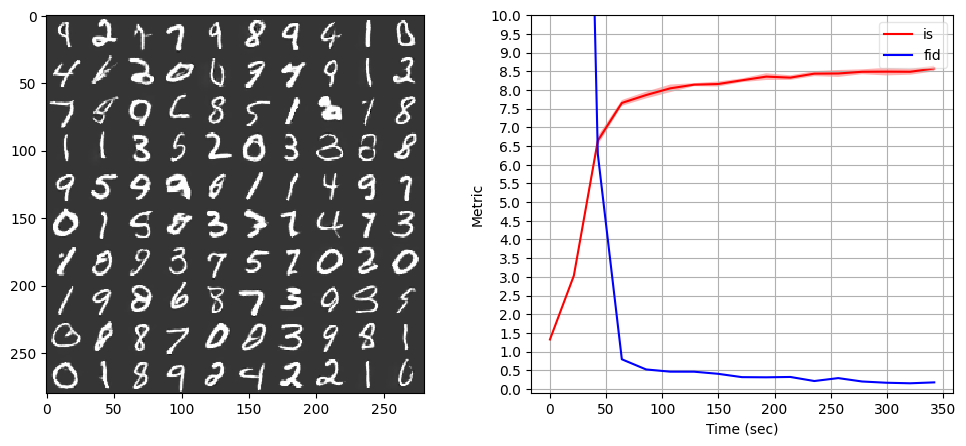

Iter 17000: Mean proba from D(G(z)): 0.4797 +/- 0.2127


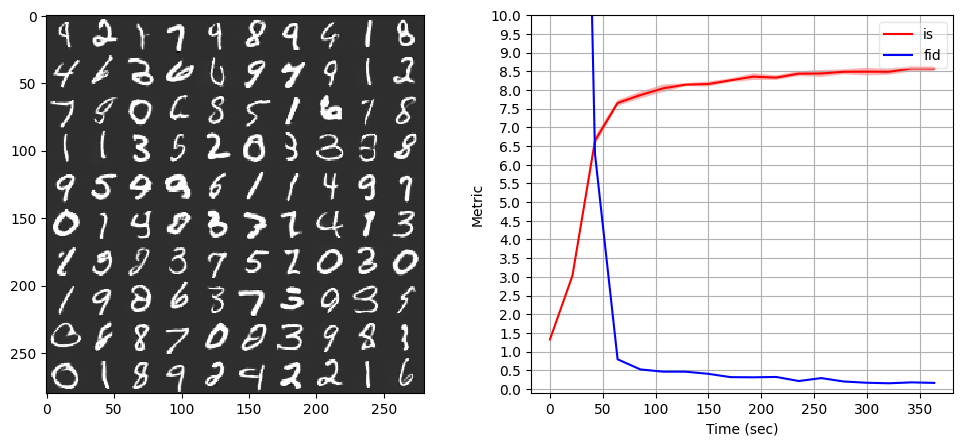

Iter 18000: Mean proba from D(G(z)): 0.3797 +/- 0.1781


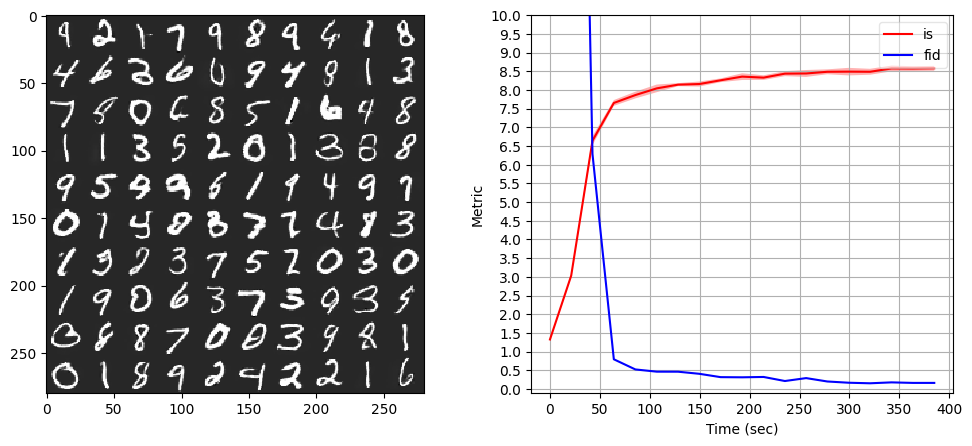

Iter 19000: Mean proba from D(G(z)): 0.2593 +/- 0.1569


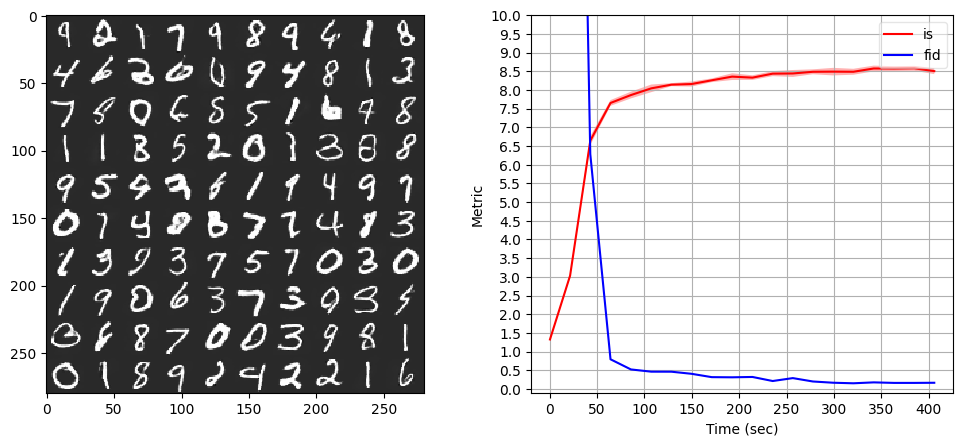

Iter 20000: Mean proba from D(G(z)): 0.2871 +/- 0.1571


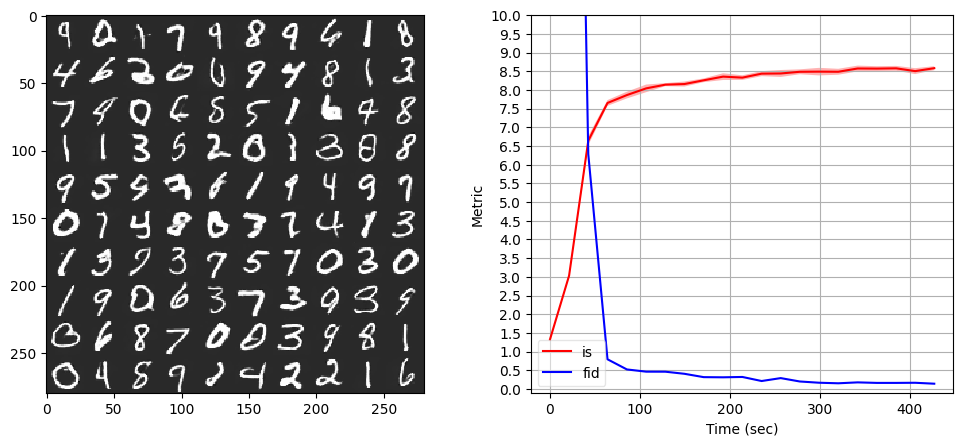

Iter 21000: Mean proba from D(G(z)): 0.5845 +/- 0.2020


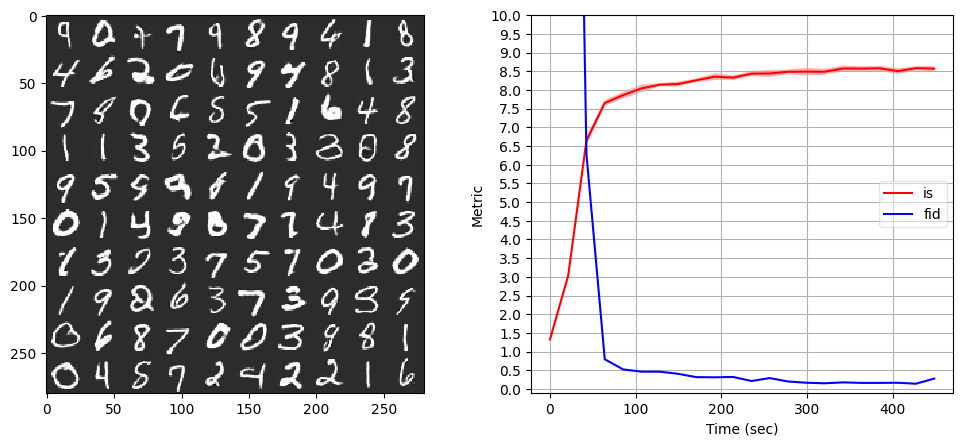

Iter 22000: Mean proba from D(G(z)): 0.4576 +/- 0.1860


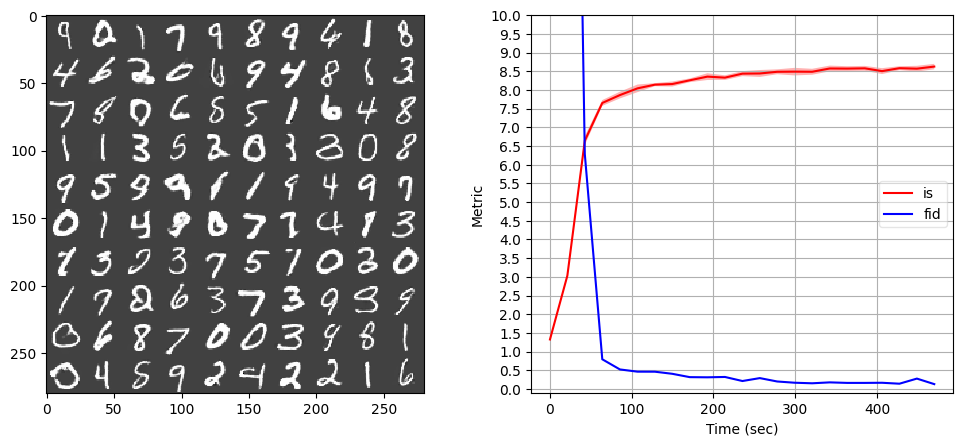

Iter 23000: Mean proba from D(G(z)): 0.5217 +/- 0.2312


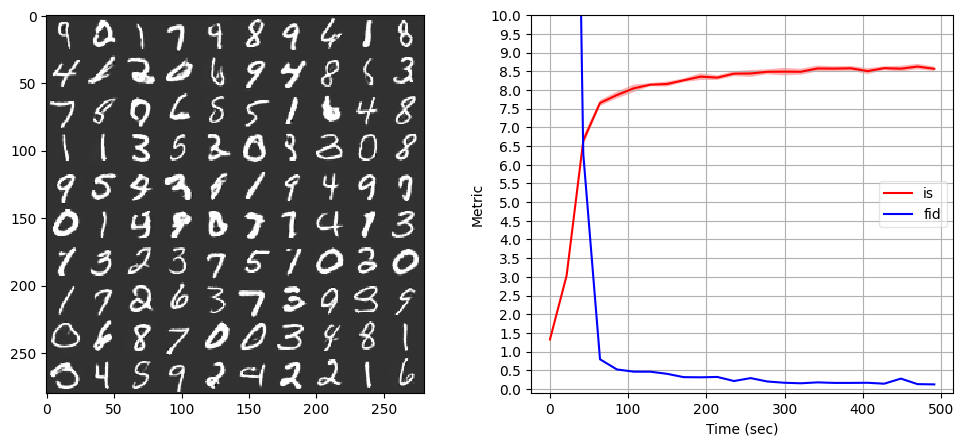

Iter 24000: Mean proba from D(G(z)): 0.4113 +/- 0.1792


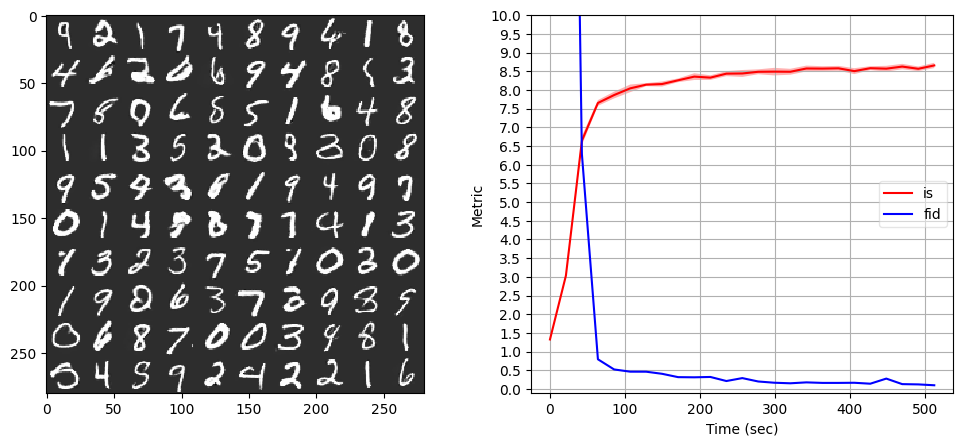

Iter 25000: Mean proba from D(G(z)): 0.7865 +/- 0.1718


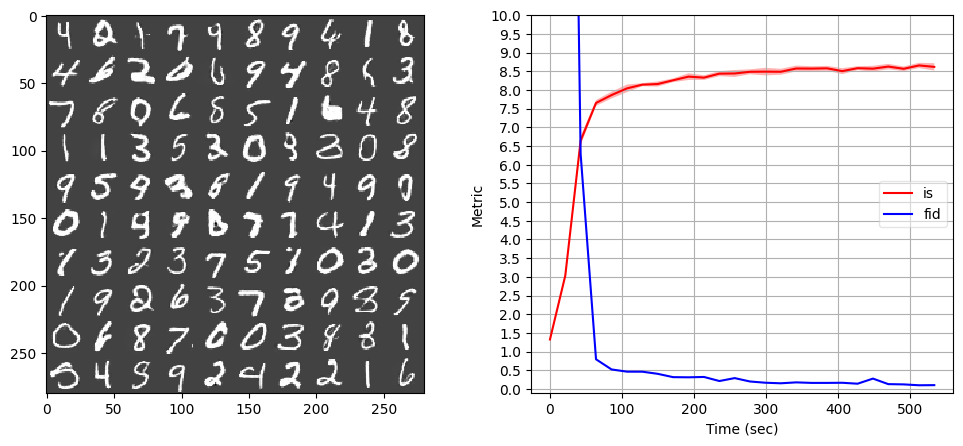

Iter 26000: Mean proba from D(G(z)): 0.4765 +/- 0.2082


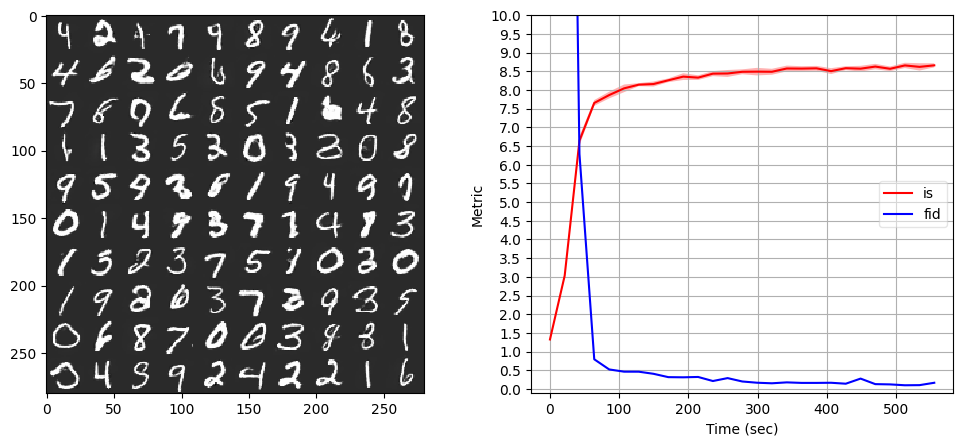

Iter 27000: Mean proba from D(G(z)): 0.6512 +/- 0.2188


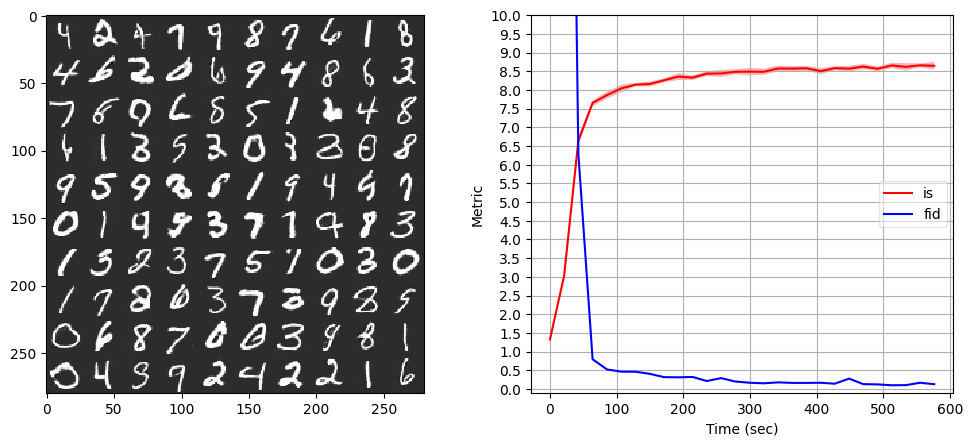

Iter 28000: Mean proba from D(G(z)): 0.5534 +/- 0.2260


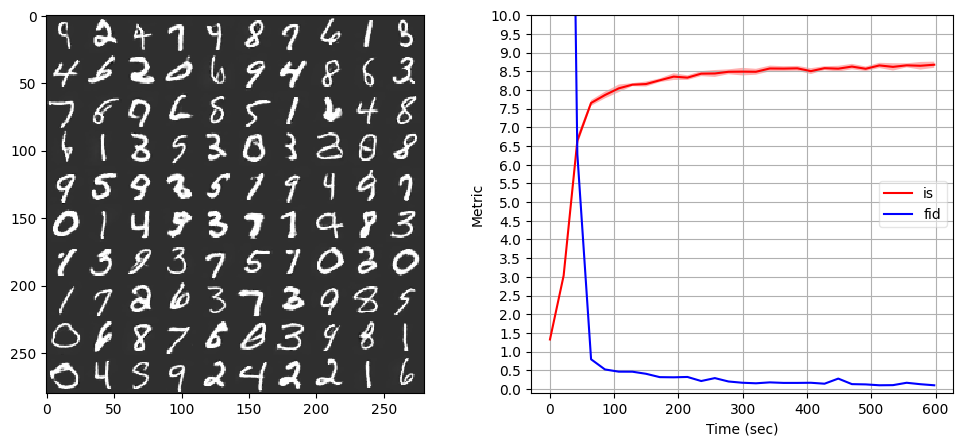

Iter 29000: Mean proba from D(G(z)): 0.5228 +/- 0.2173


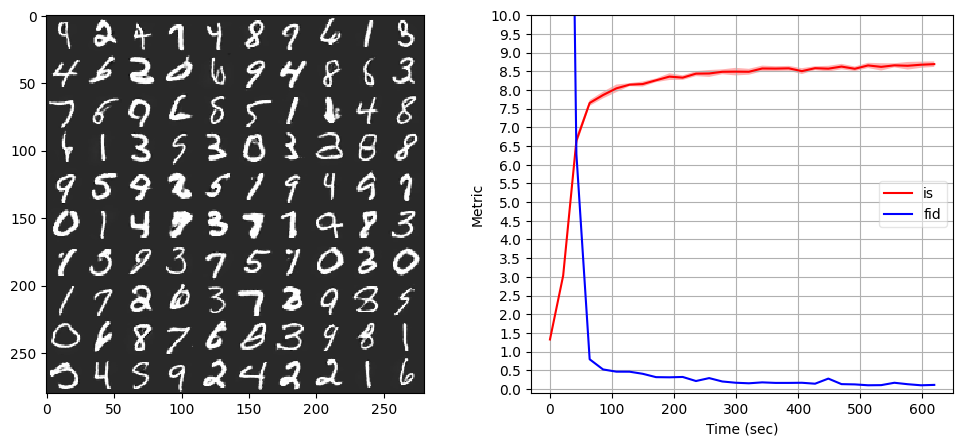

Iter 30000: Mean proba from D(G(z)): 0.6043 +/- 0.2028


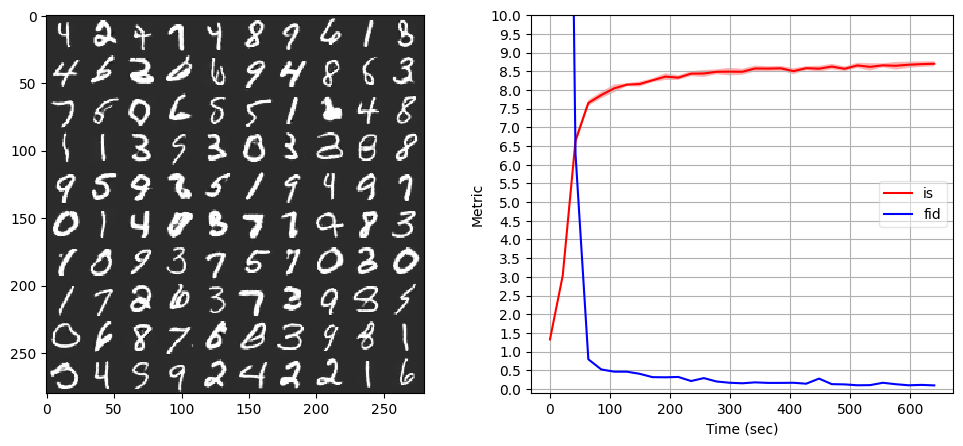

Iter 31000: Mean proba from D(G(z)): 0.6821 +/- 0.2131


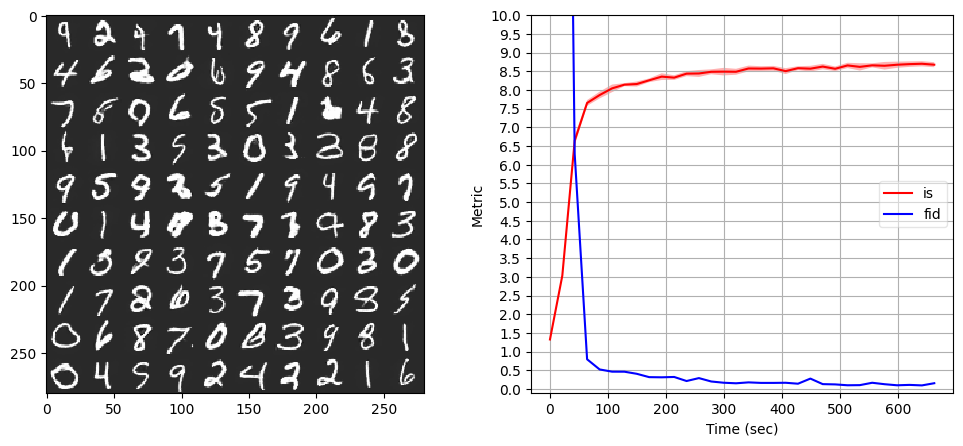

Iter 32000: Mean proba from D(G(z)): 0.6102 +/- 0.2019


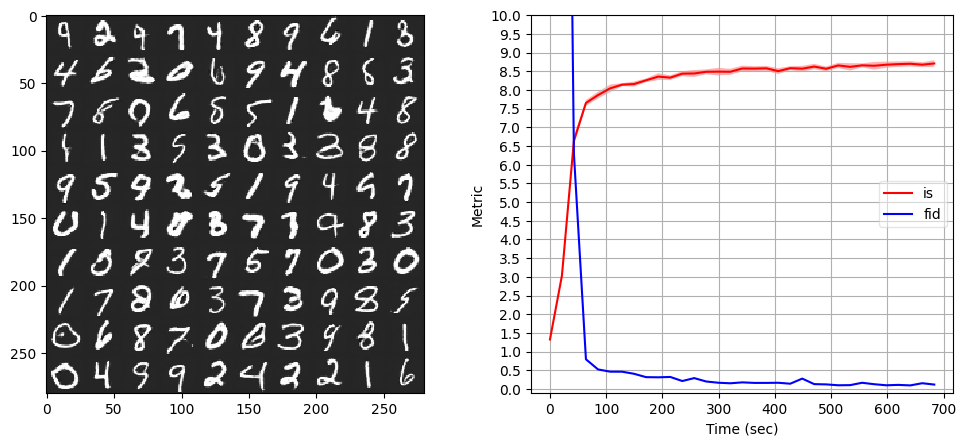

Iter 33000: Mean proba from D(G(z)): 0.4603 +/- 0.2021


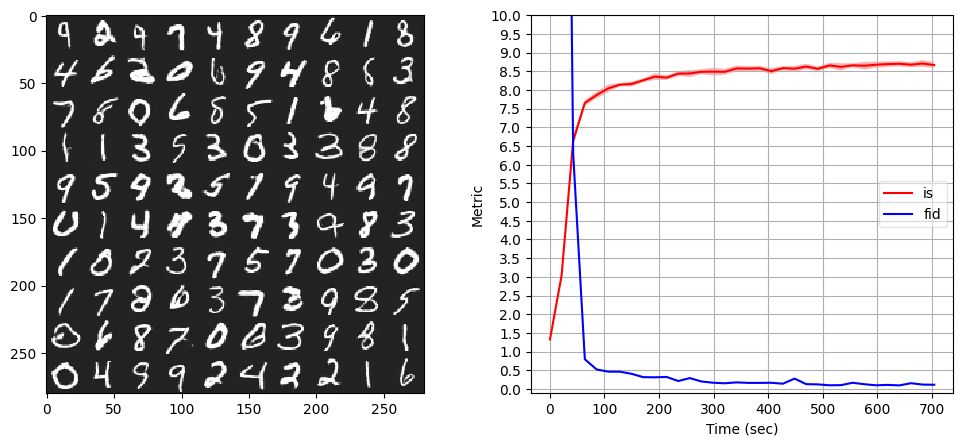

Iter 34000: Mean proba from D(G(z)): 0.2931 +/- 0.1587


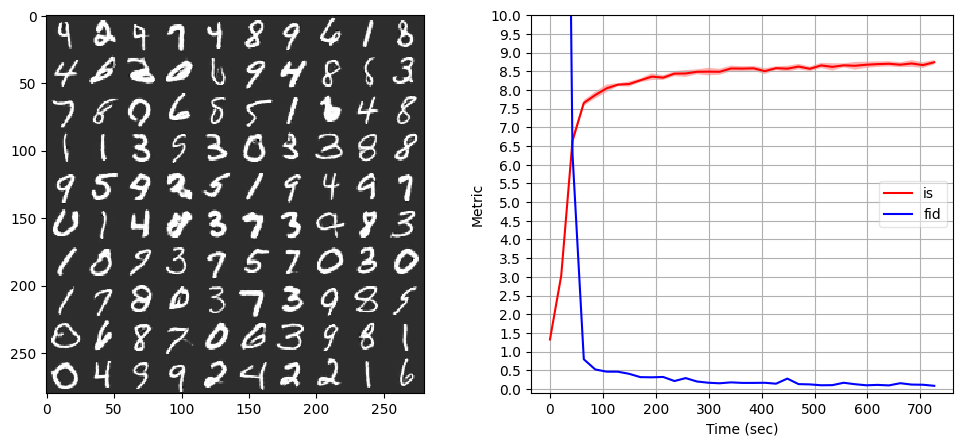

Iter 35000: Mean proba from D(G(z)): 0.2472 +/- 0.1652


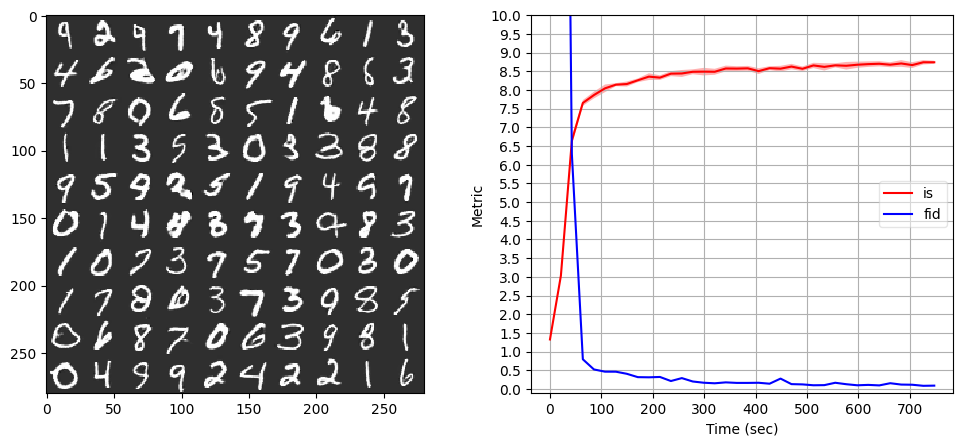

Iter 36000: Mean proba from D(G(z)): 0.2877 +/- 0.1671


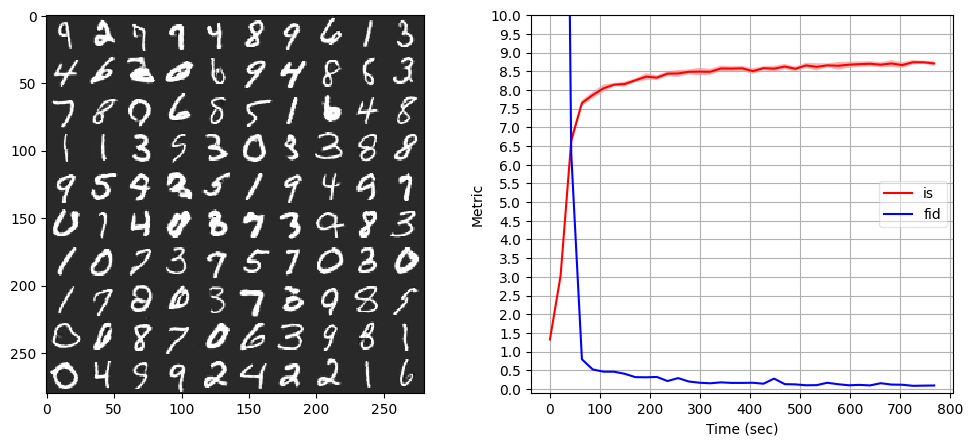

Iter 37000: Mean proba from D(G(z)): 0.2613 +/- 0.1618


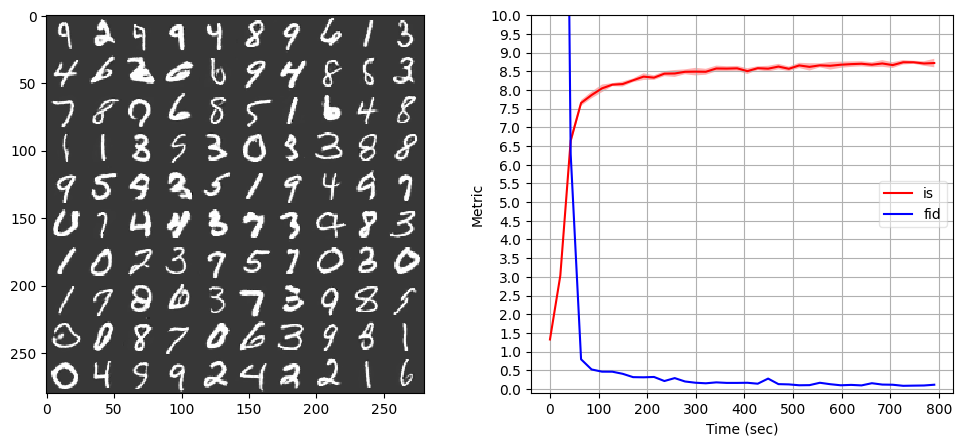

Iter 38000: Mean proba from D(G(z)): 0.2383 +/- 0.1770


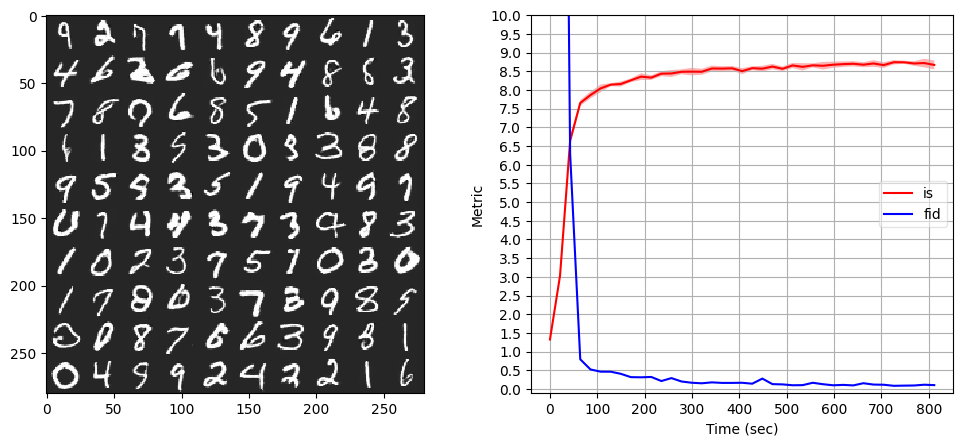

Iter 39000: Mean proba from D(G(z)): 0.2083 +/- 0.1513


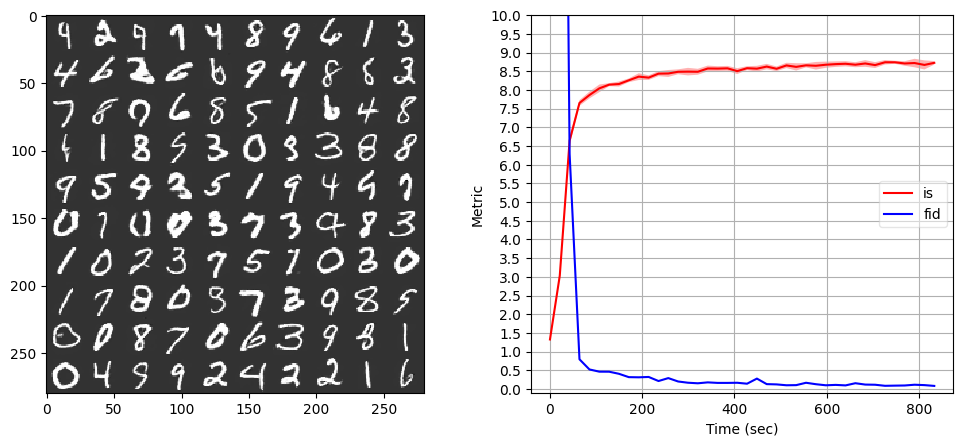

Iter 40000: Mean proba from D(G(z)): 0.1245 +/- 0.1197


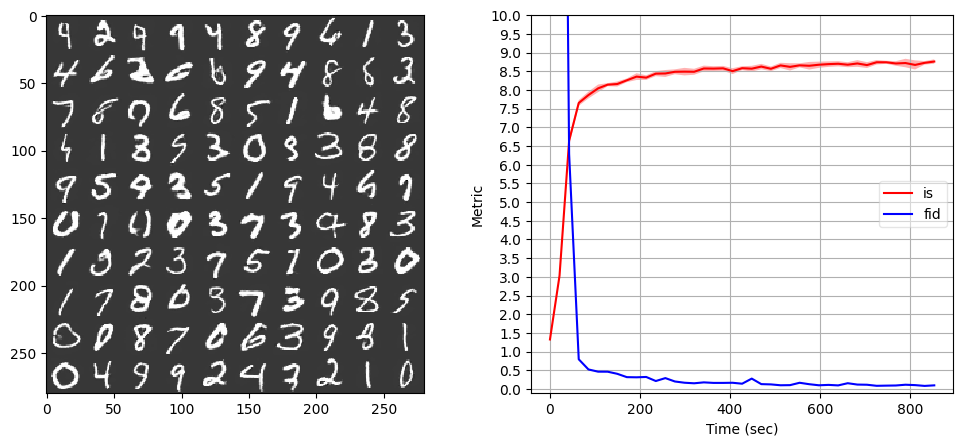

Iter 41000: Mean proba from D(G(z)): 0.4691 +/- 0.2451


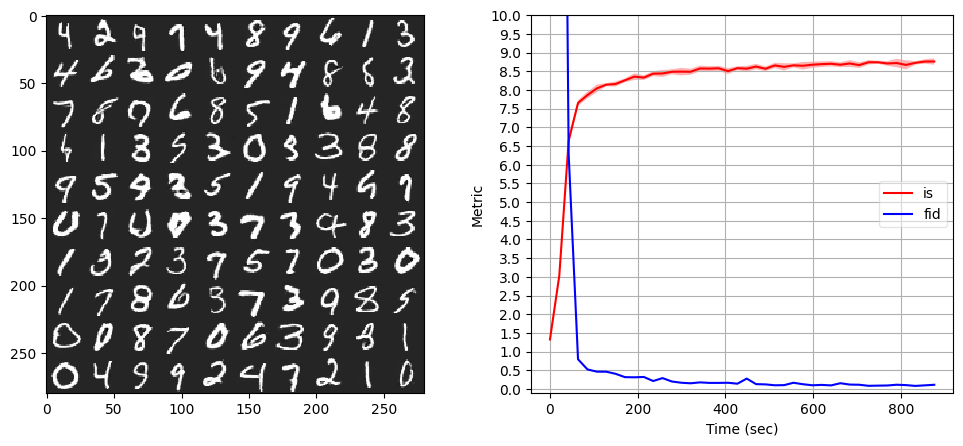

Iter 42000: Mean proba from D(G(z)): 0.2821 +/- 0.1825


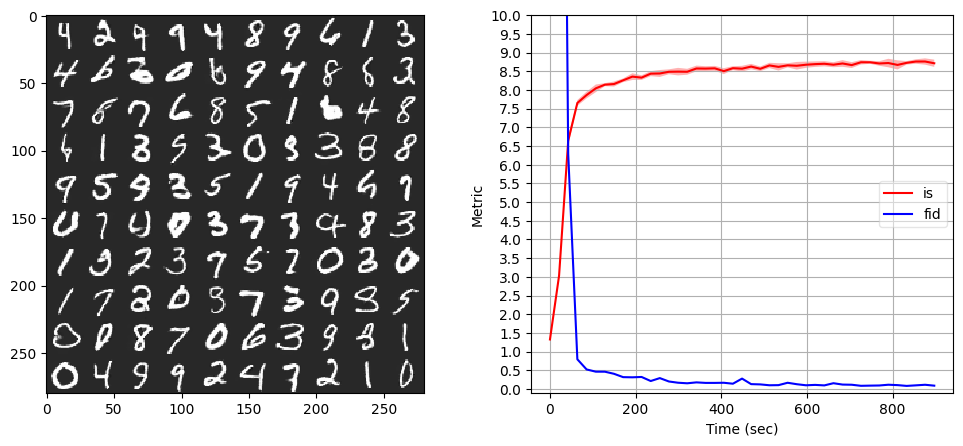

Iter 43000: Mean proba from D(G(z)): 0.1839 +/- 0.1524


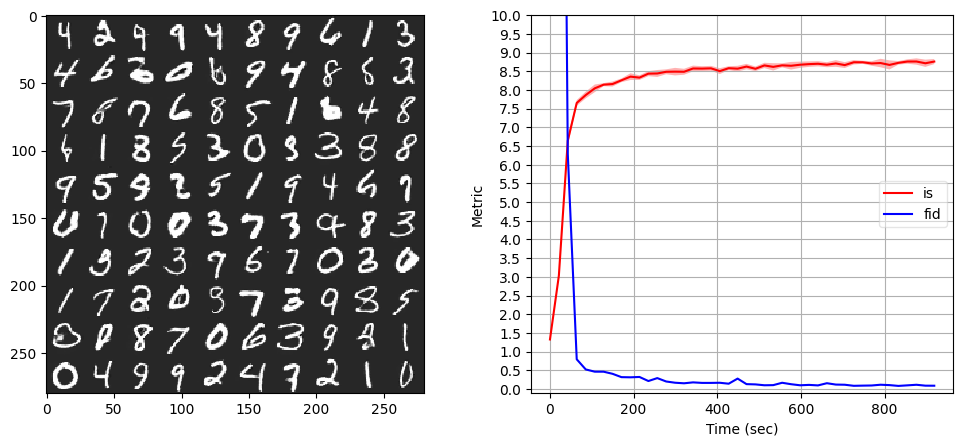

Iter 44000: Mean proba from D(G(z)): 0.3487 +/- 0.1941


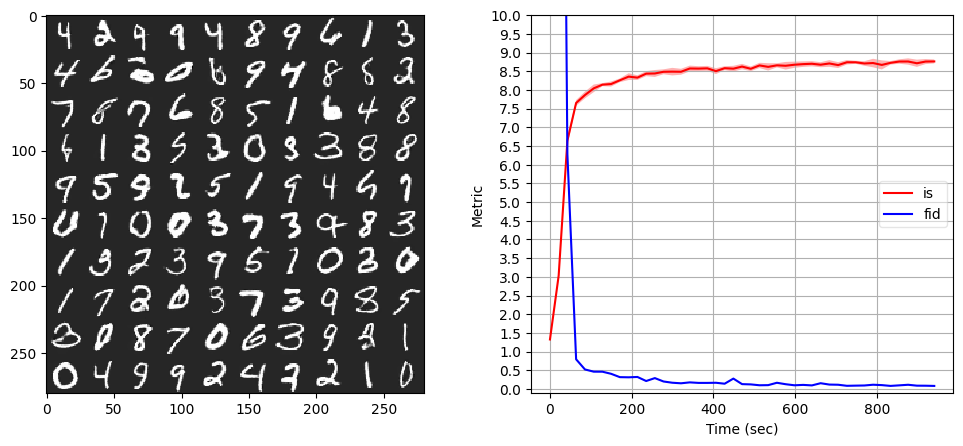

Iter 45000: Mean proba from D(G(z)): 0.2296 +/- 0.1620


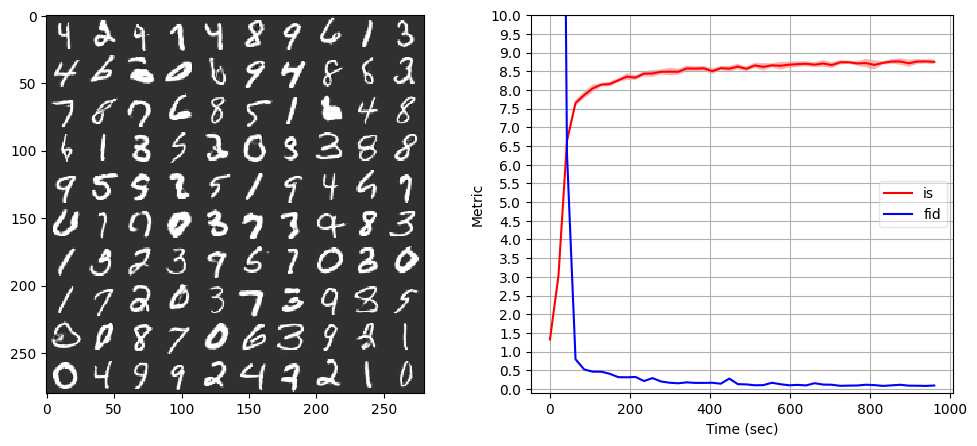

Iter 46000: Mean proba from D(G(z)): 0.4279 +/- 0.2188


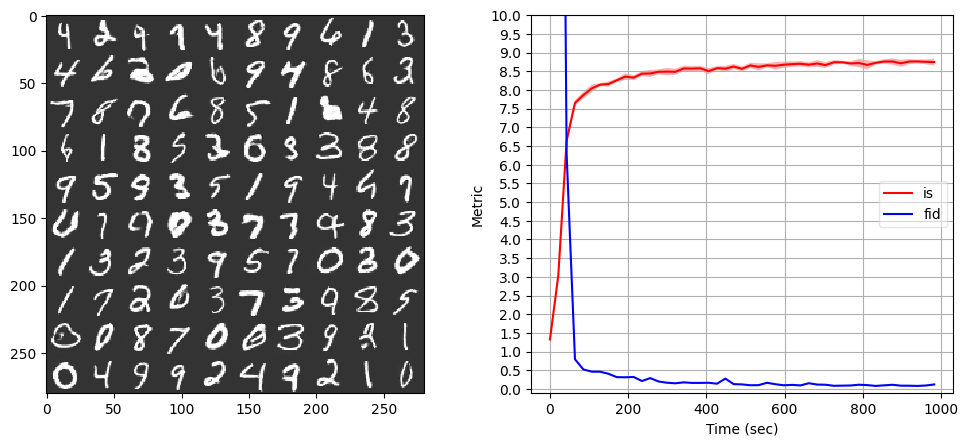

Iter 47000: Mean proba from D(G(z)): 0.4956 +/- 0.2220


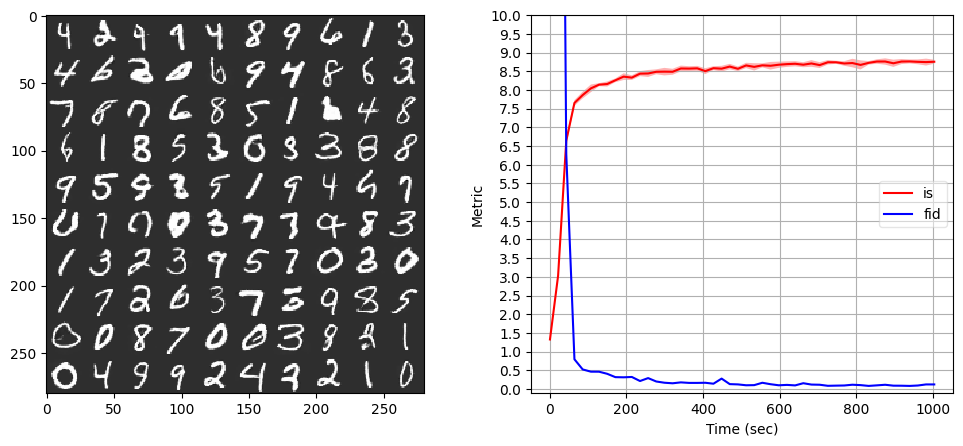

Iter 48000: Mean proba from D(G(z)): 0.2775 +/- 0.1888


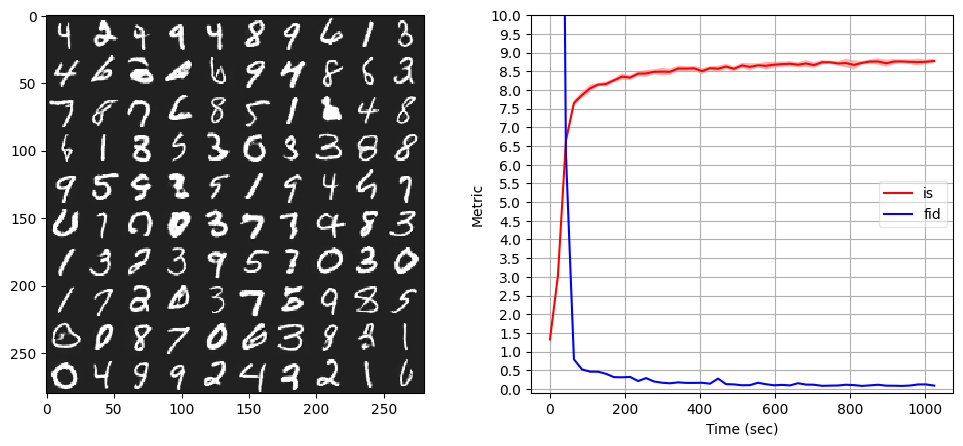

Iter 49000: Mean proba from D(G(z)): 0.3537 +/- 0.2200


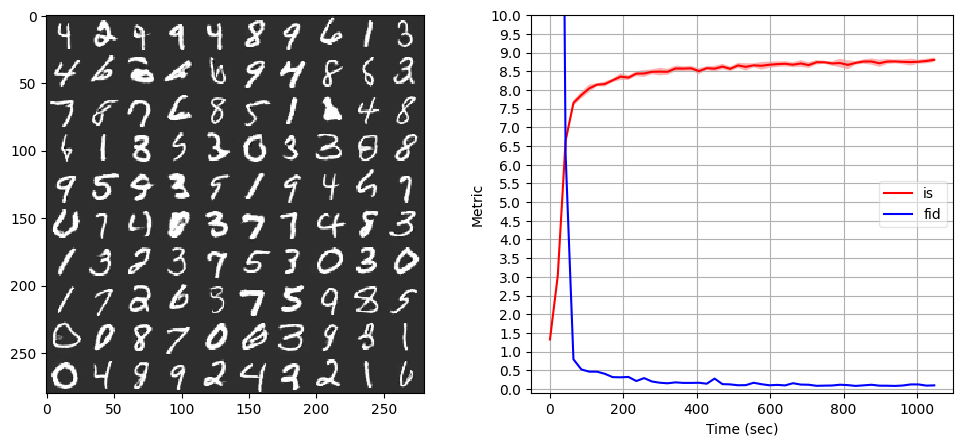

Iter 50000: Mean proba from D(G(z)): 0.2055 +/- 0.1851


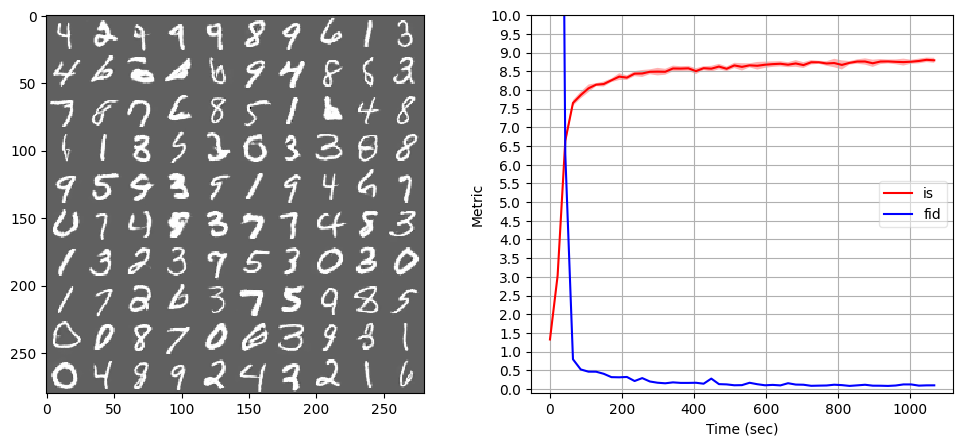

Iter 51000: Mean proba from D(G(z)): 0.2194 +/- 0.1784


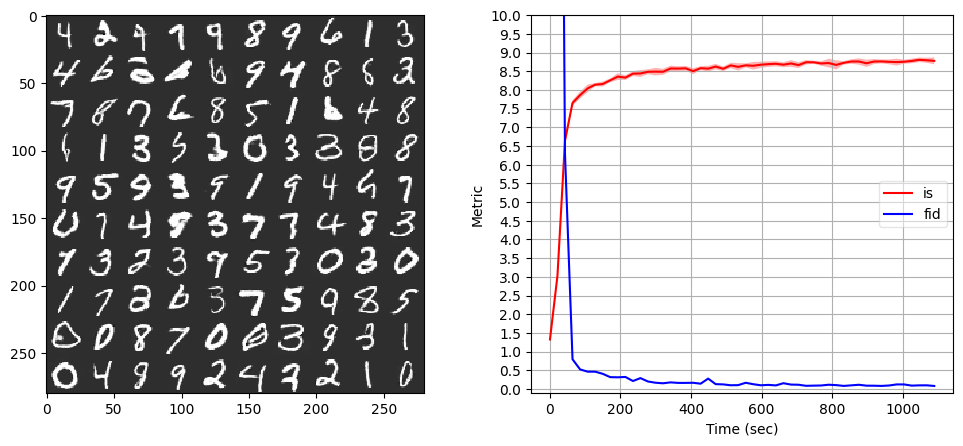

Iter 52000: Mean proba from D(G(z)): 0.2777 +/- 0.2063


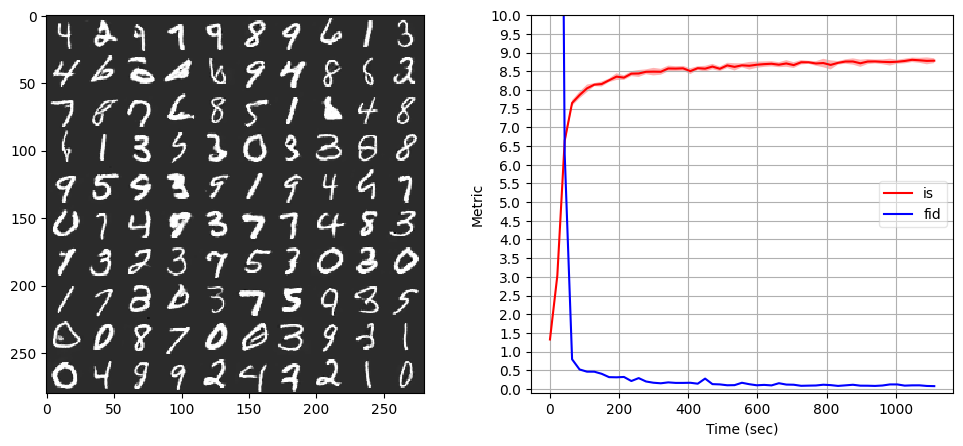

Iter 53000: Mean proba from D(G(z)): 0.3270 +/- 0.2103


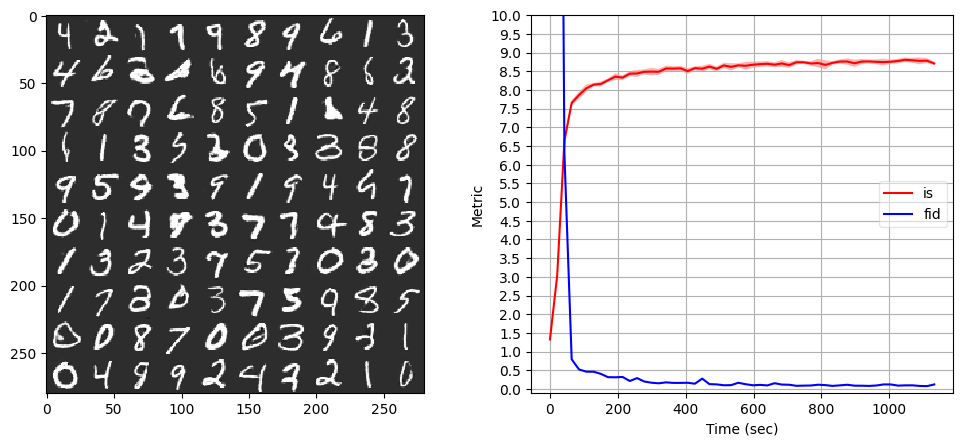

Iter 54000: Mean proba from D(G(z)): 0.2637 +/- 0.1839


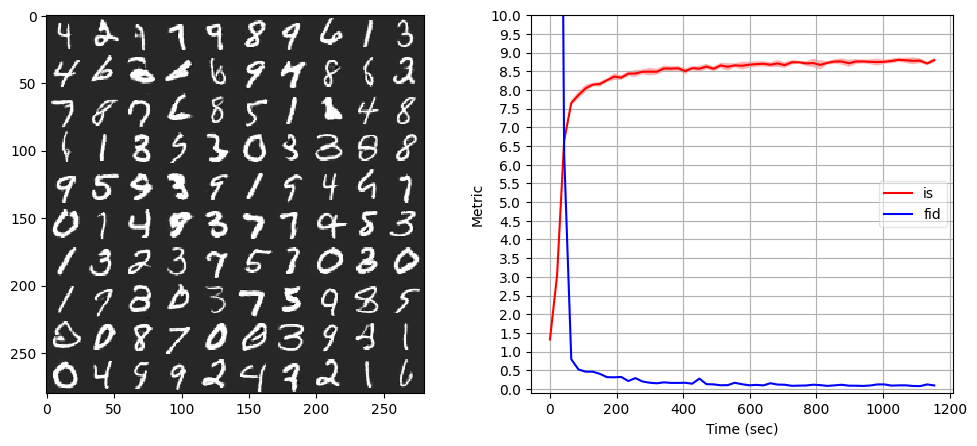

Iter 55000: Mean proba from D(G(z)): 0.3242 +/- 0.2193


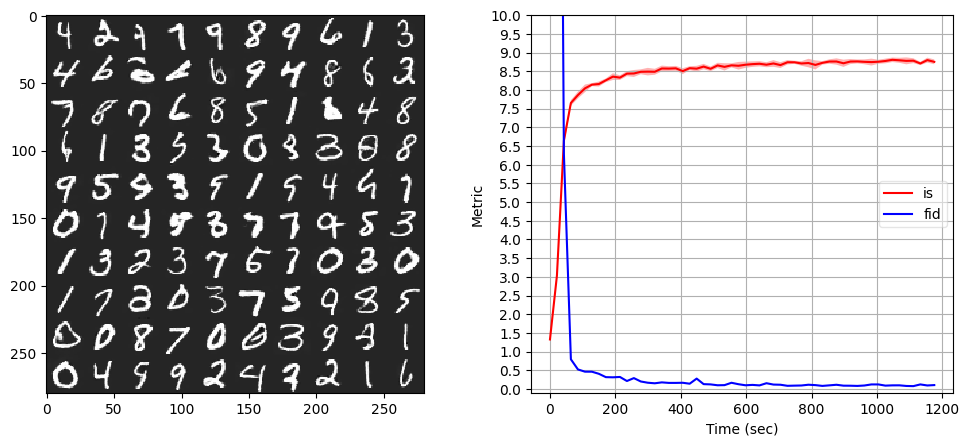

Iter 56000: Mean proba from D(G(z)): 0.2969 +/- 0.2025


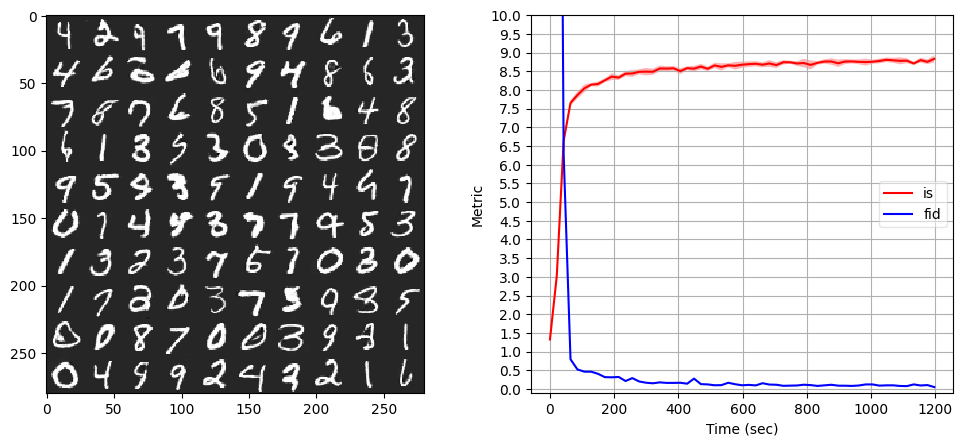

Iter 57000: Mean proba from D(G(z)): 0.1979 +/- 0.1457


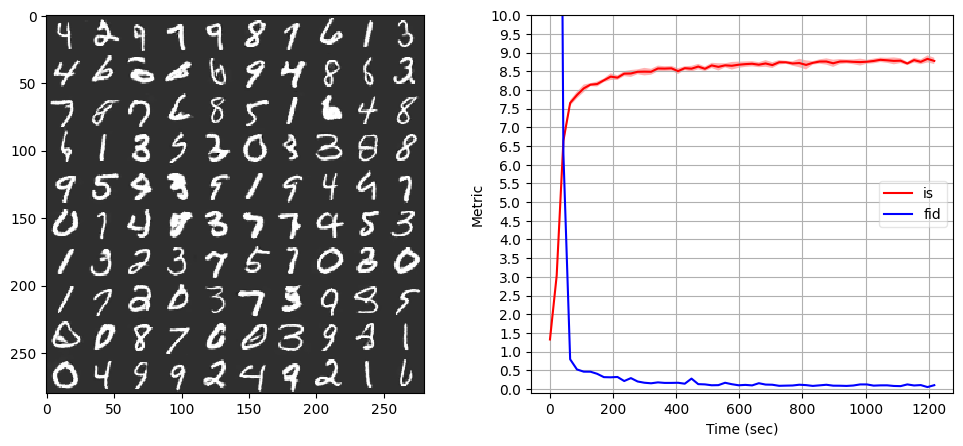

Iter 58000: Mean proba from D(G(z)): 0.1721 +/- 0.1417


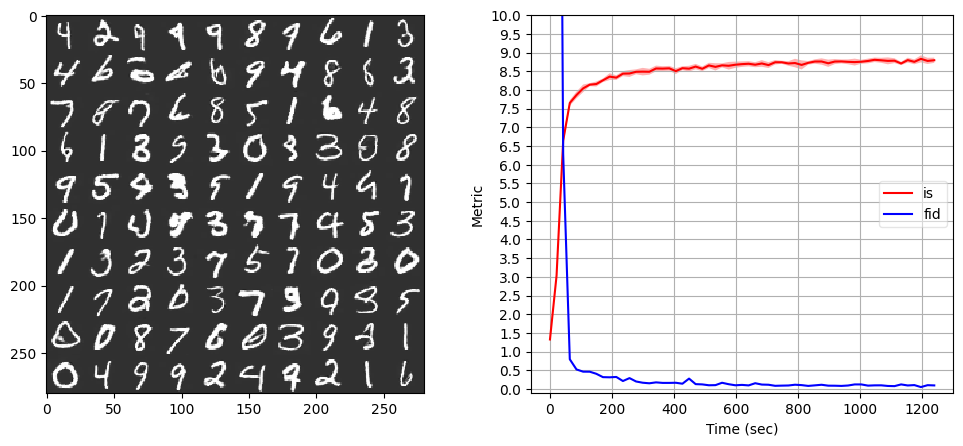

Iter 59000: Mean proba from D(G(z)): 0.1864 +/- 0.1468


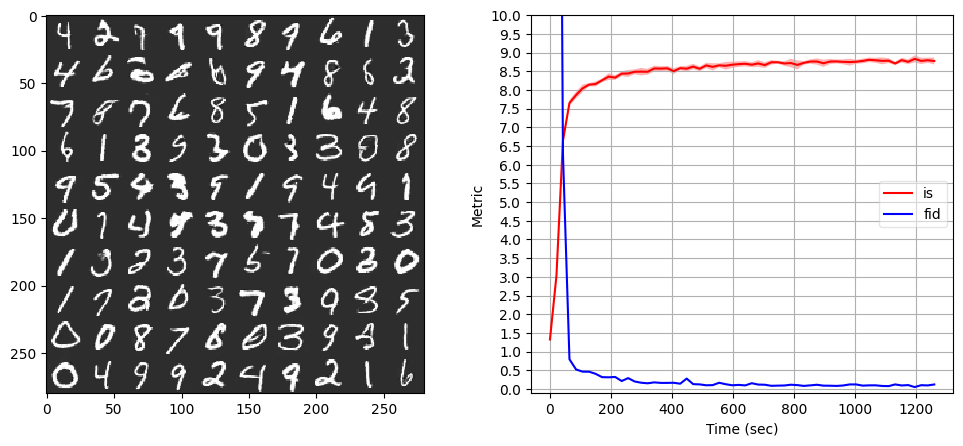

Iter 60000: Mean proba from D(G(z)): 0.3622 +/- 0.2119


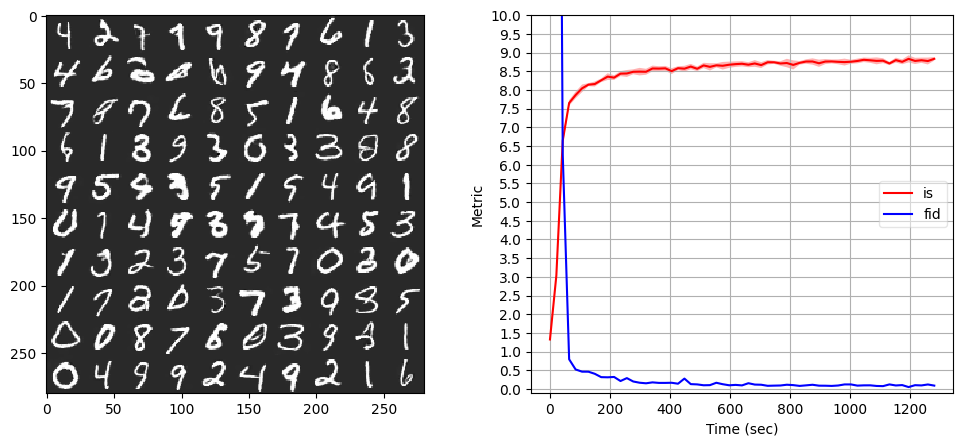

Iter 61000: Mean proba from D(G(z)): 0.4211 +/- 0.2244


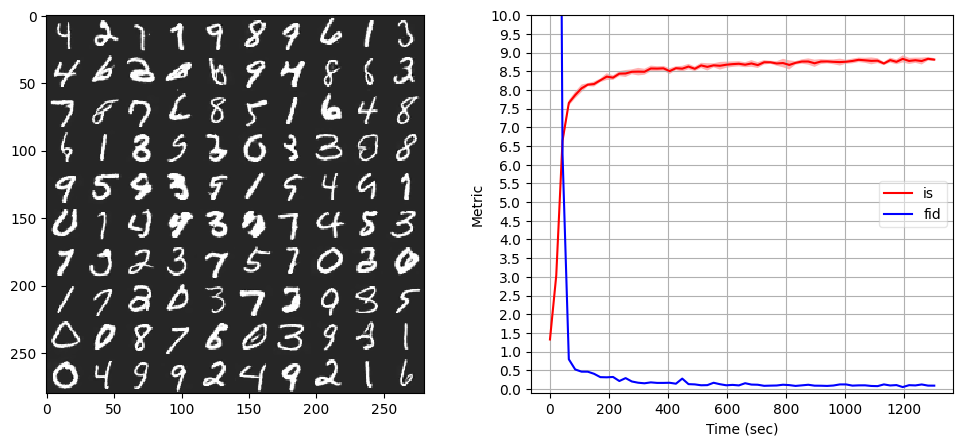

Iter 62000: Mean proba from D(G(z)): 0.2537 +/- 0.1892


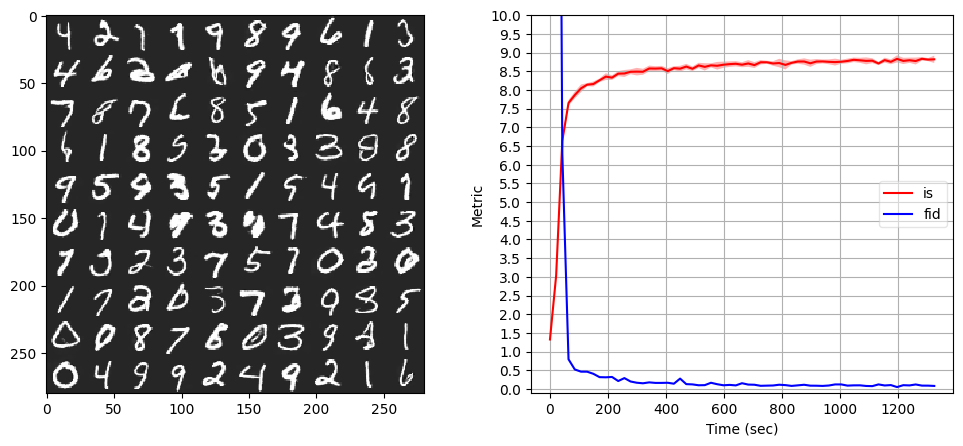

Iter 63000: Mean proba from D(G(z)): 0.2912 +/- 0.2092


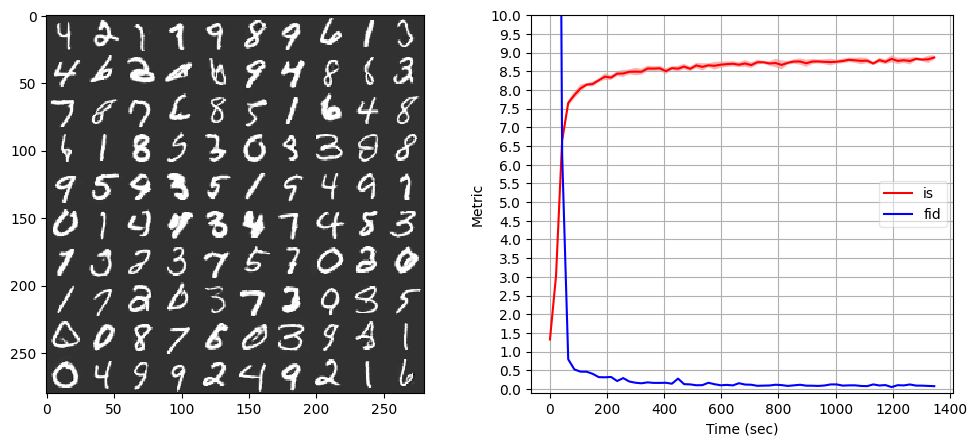

Iter 64000: Mean proba from D(G(z)): 0.3150 +/- 0.1990


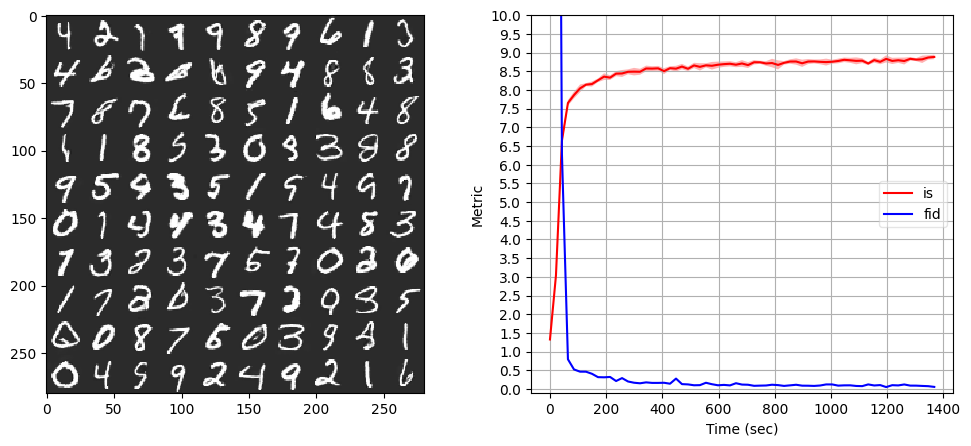

Iter 65000: Mean proba from D(G(z)): 0.3530 +/- 0.2188


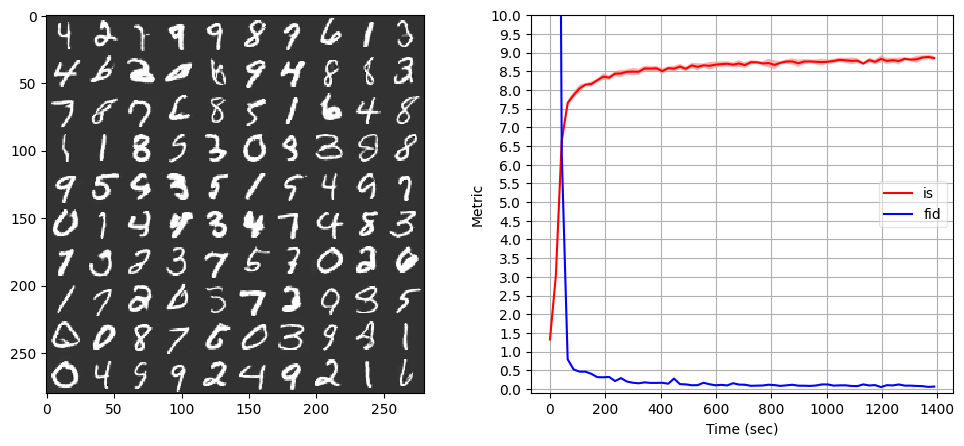

Iter 66000: Mean proba from D(G(z)): 0.1899 +/- 0.1697


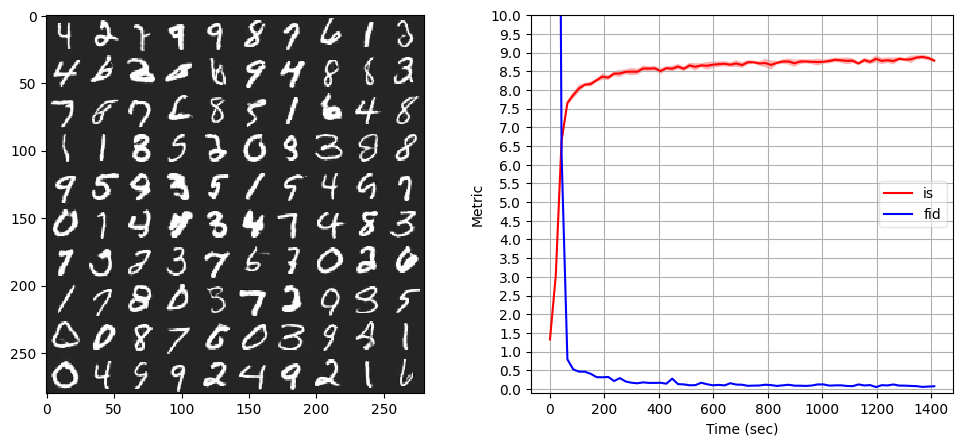

Iter 67000: Mean proba from D(G(z)): 0.2128 +/- 0.1686


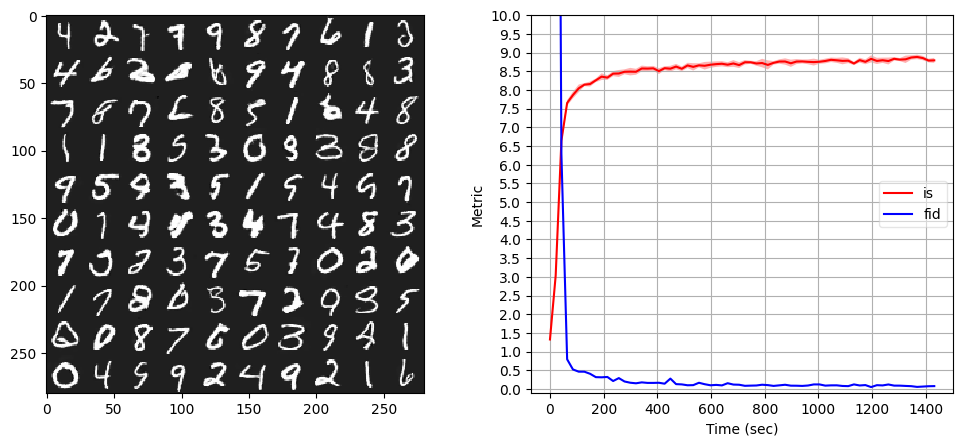

Iter 68000: Mean proba from D(G(z)): 0.2514 +/- 0.1855


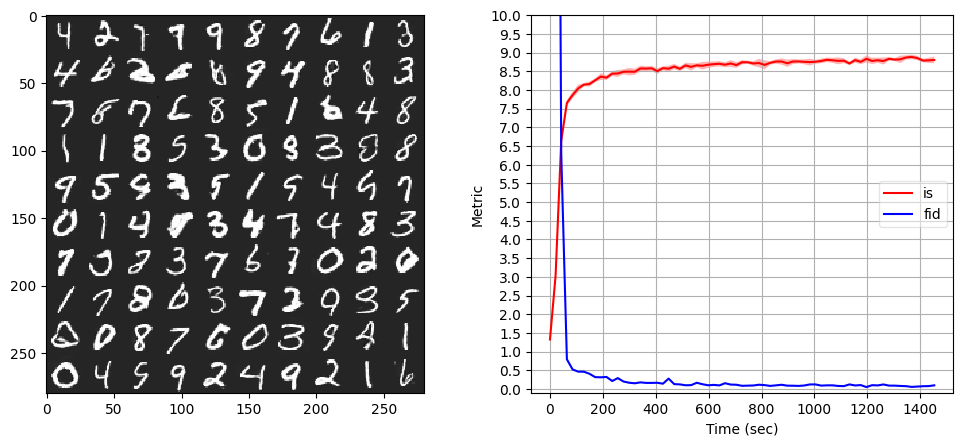

Iter 69000: Mean proba from D(G(z)): 0.2926 +/- 0.2050


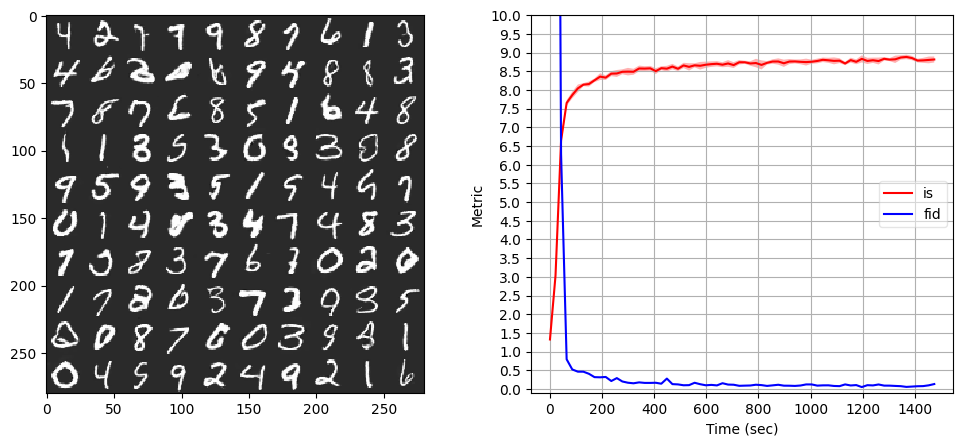

Iter 70000: Mean proba from D(G(z)): 0.2647 +/- 0.1934


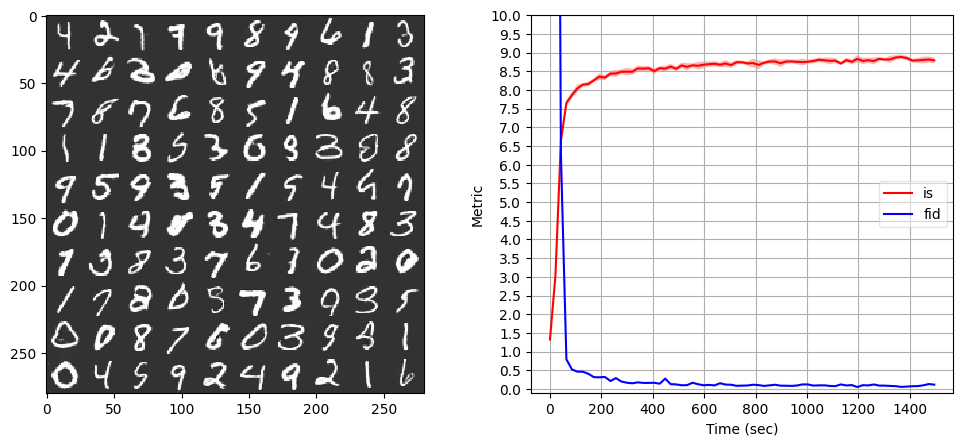

Iter 71000: Mean proba from D(G(z)): 0.1609 +/- 0.1717


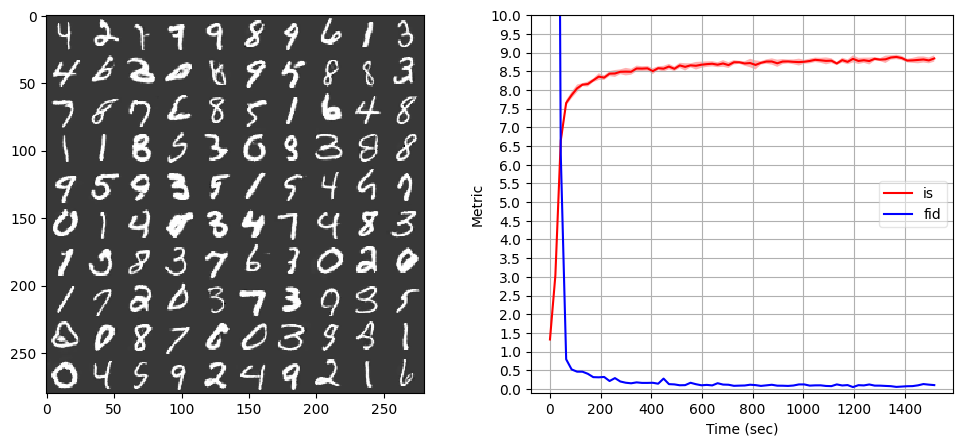

Iter 72000: Mean proba from D(G(z)): 0.2846 +/- 0.2197


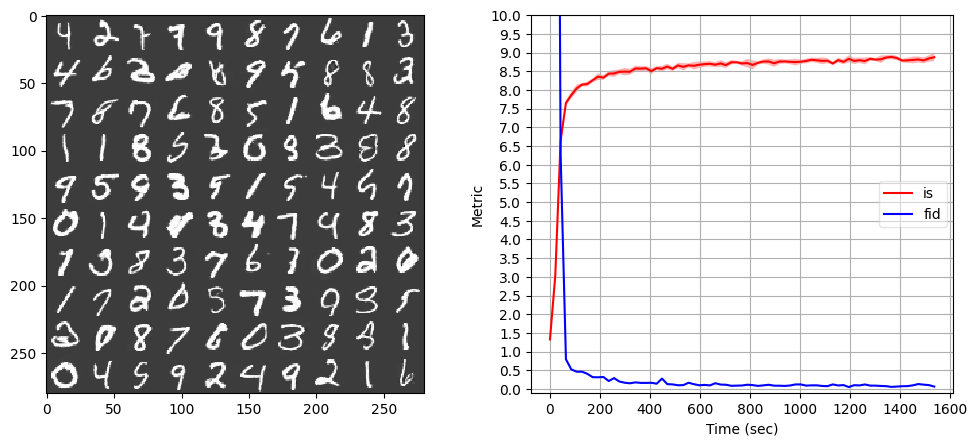

Iter 73000: Mean proba from D(G(z)): 0.2393 +/- 0.1952


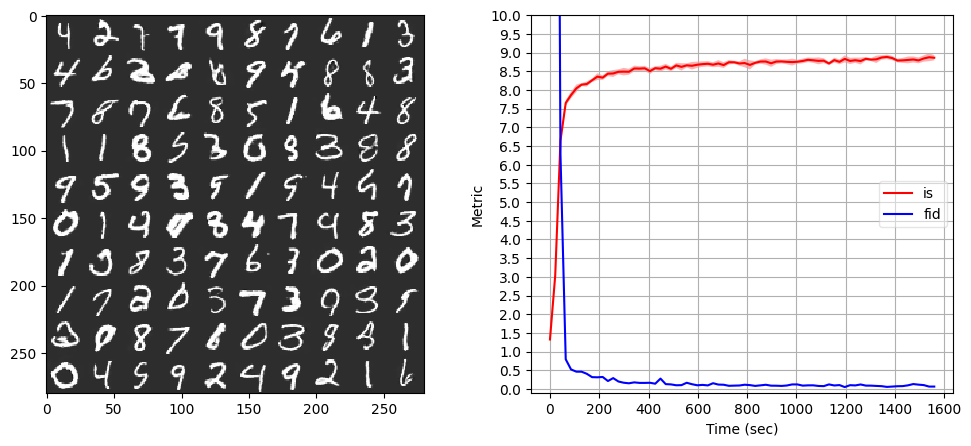

Iter 74000: Mean proba from D(G(z)): 0.2657 +/- 0.2178


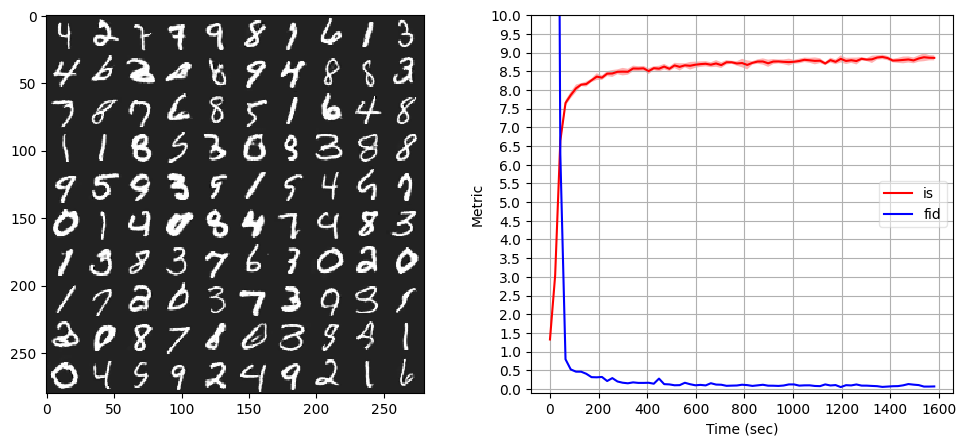

Iter 75000: Mean proba from D(G(z)): 0.3358 +/- 0.2333


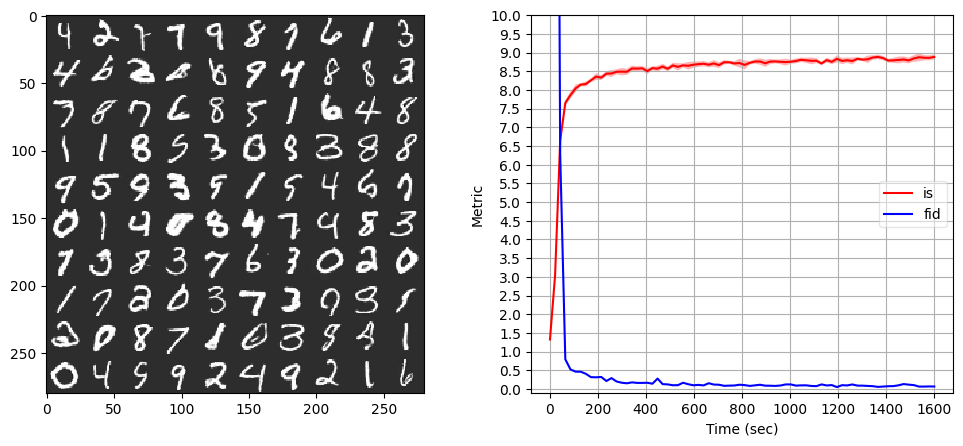

Iter 76000: Mean proba from D(G(z)): 0.1640 +/- 0.1557


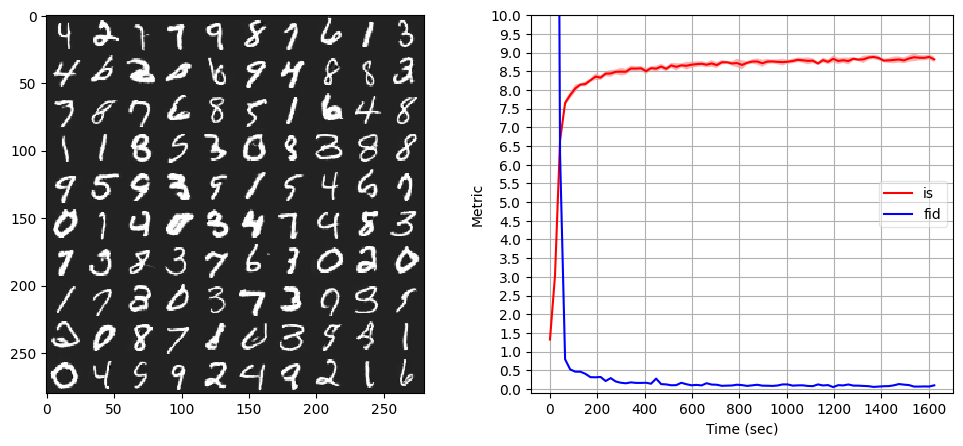

Iter 77000: Mean proba from D(G(z)): 0.2099 +/- 0.1789


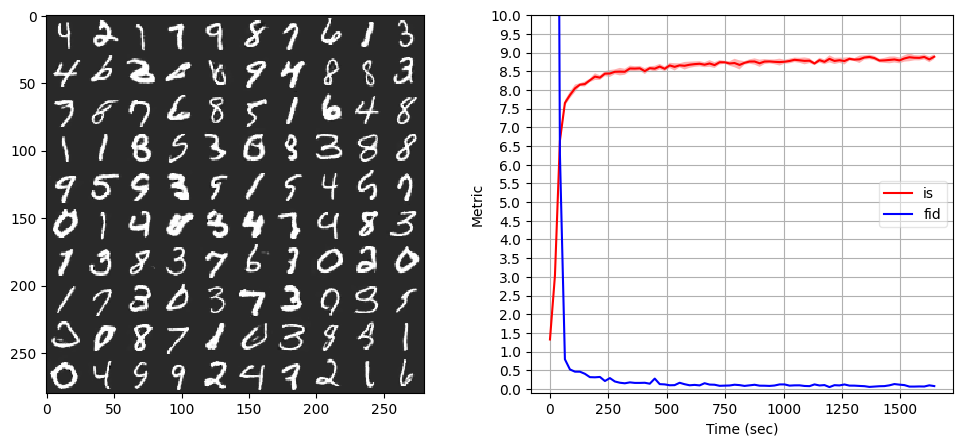

Iter 78000: Mean proba from D(G(z)): 0.1499 +/- 0.1409


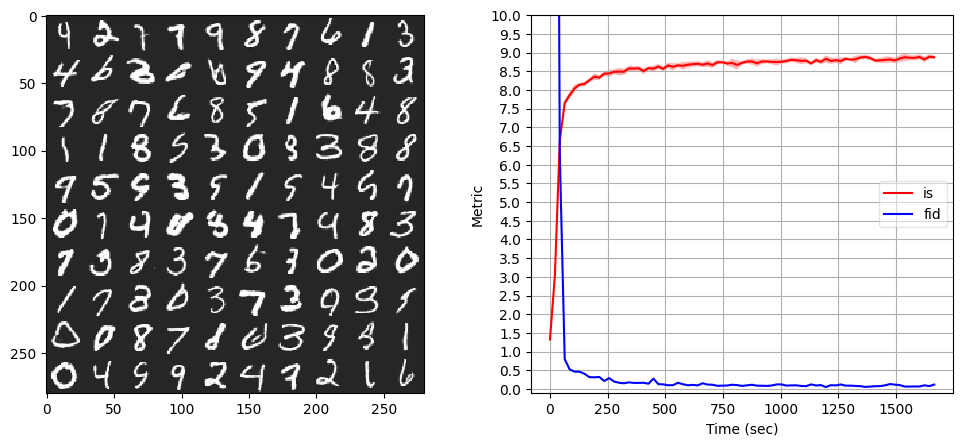

Iter 79000: Mean proba from D(G(z)): 0.1215 +/- 0.1420


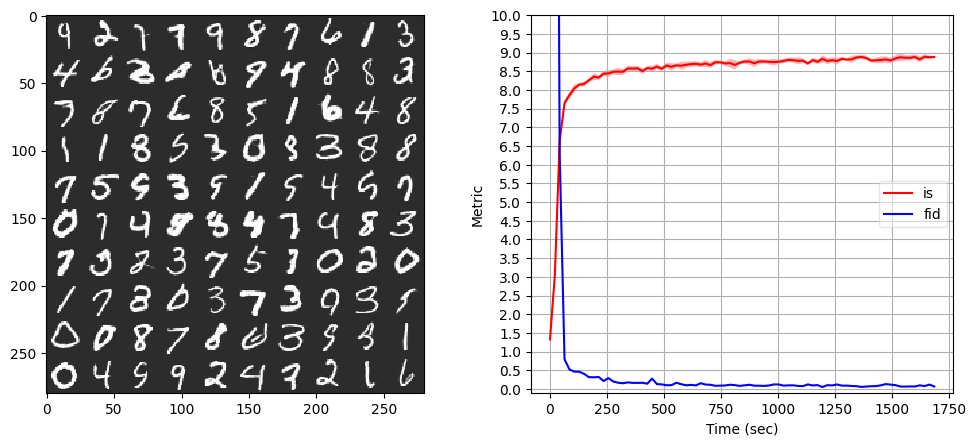

Iter 80000: Mean proba from D(G(z)): 0.1811 +/- 0.1890


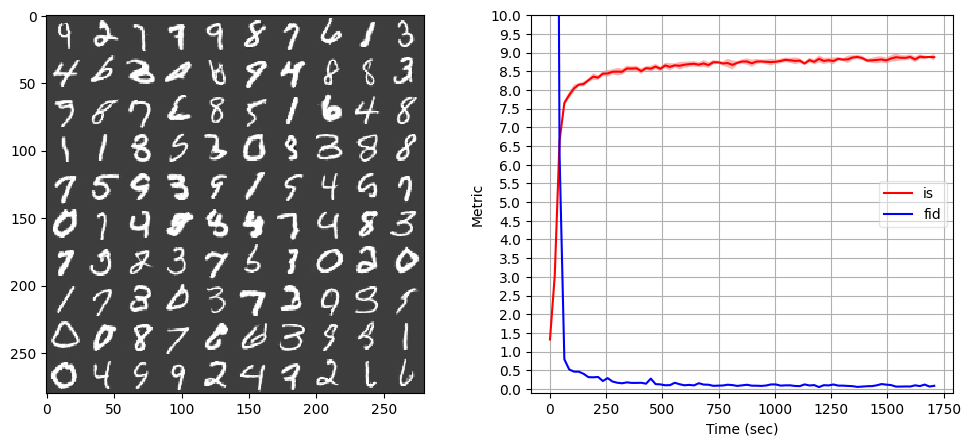

Iter 81000: Mean proba from D(G(z)): 0.0960 +/- 0.1353


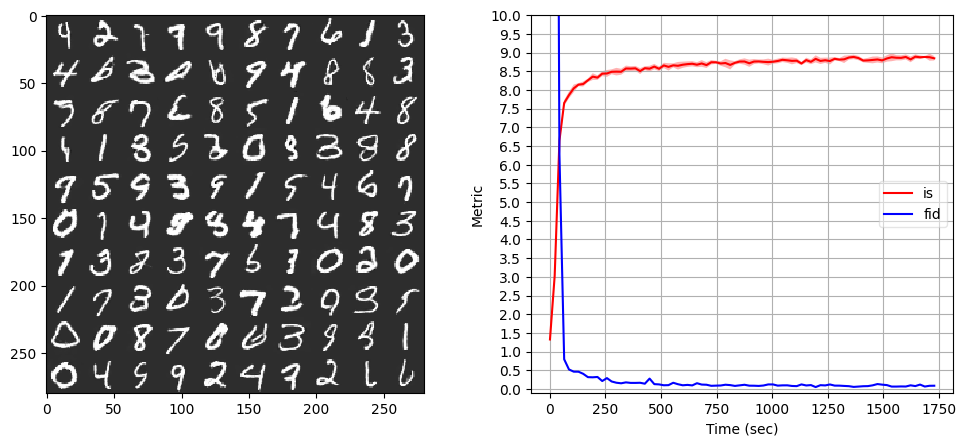

Iter 82000: Mean proba from D(G(z)): 0.1991 +/- 0.1929


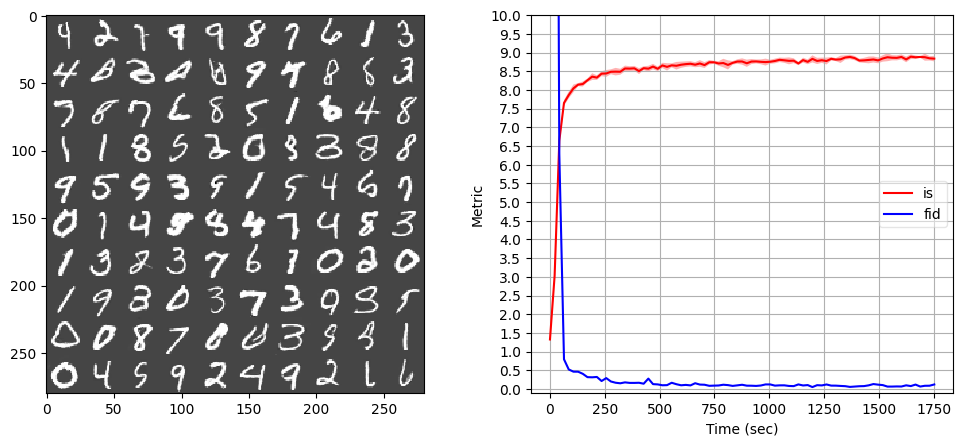

Iter 83000: Mean proba from D(G(z)): 0.1950 +/- 0.1756


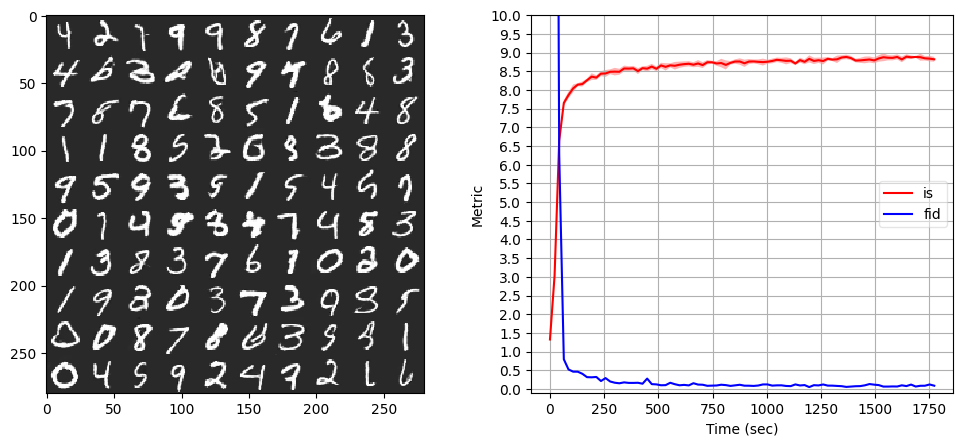

Iter 84000: Mean proba from D(G(z)): 0.1497 +/- 0.1549


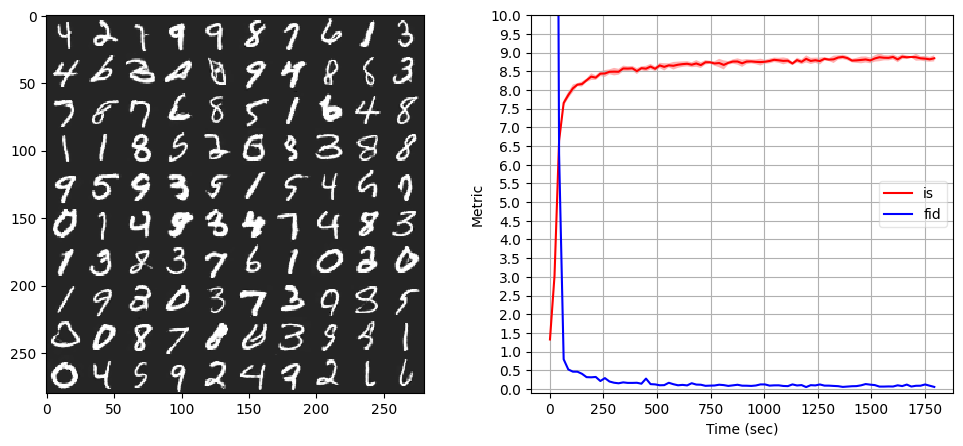

Iter 85000: Mean proba from D(G(z)): 0.2517 +/- 0.2161


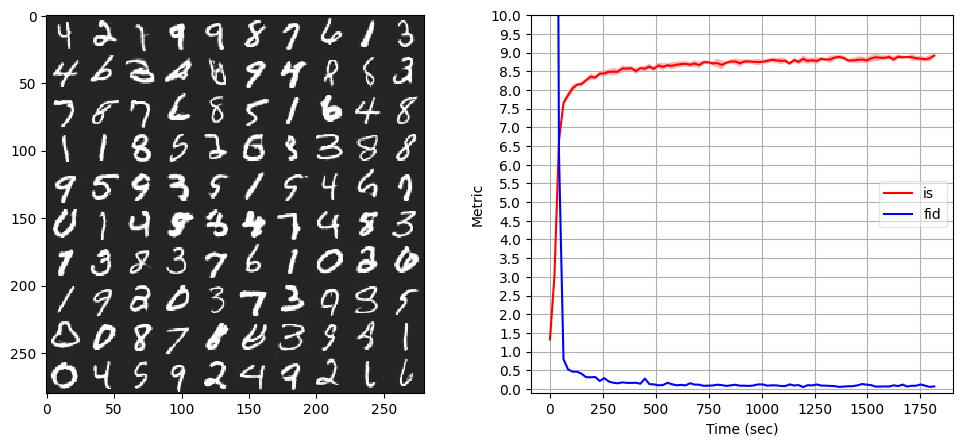

Iter 86000: Mean proba from D(G(z)): 0.1608 +/- 0.1696


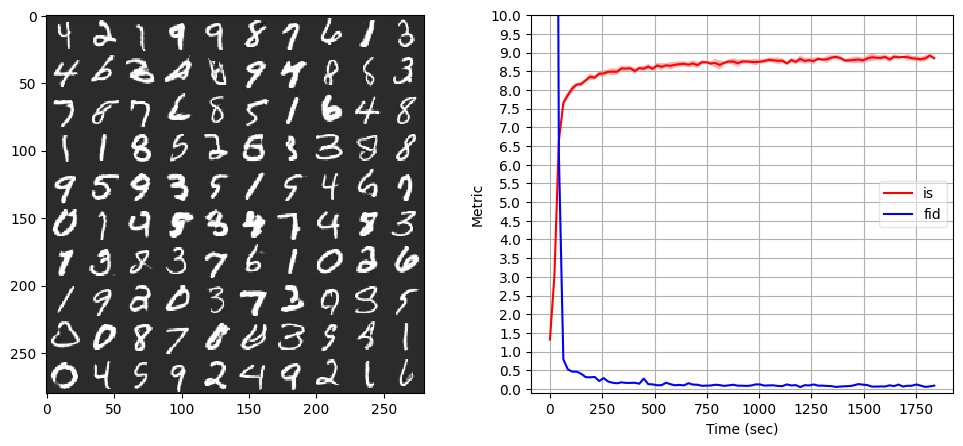

Iter 87000: Mean proba from D(G(z)): 0.1456 +/- 0.1530


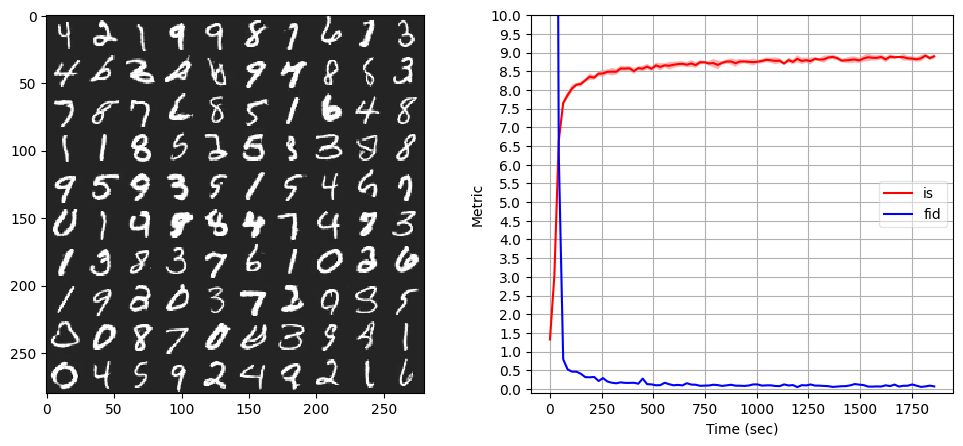

Iter 88000: Mean proba from D(G(z)): 0.1629 +/- 0.1413


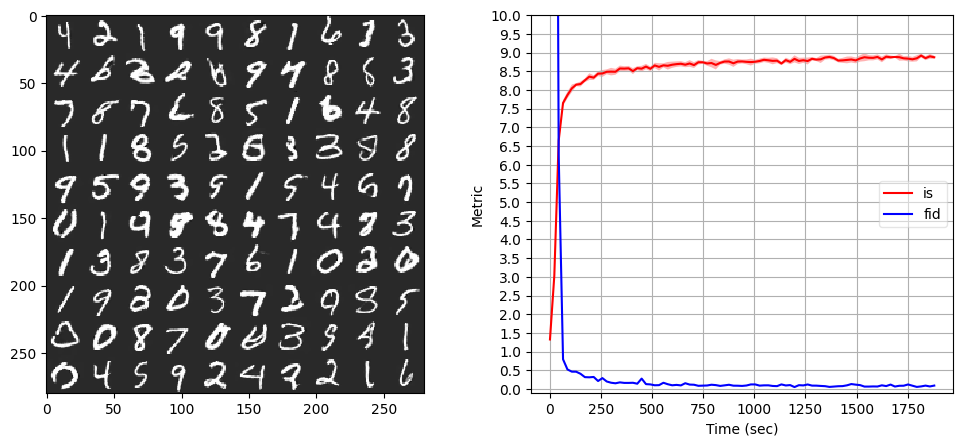

Iter 89000: Mean proba from D(G(z)): 0.1216 +/- 0.1219


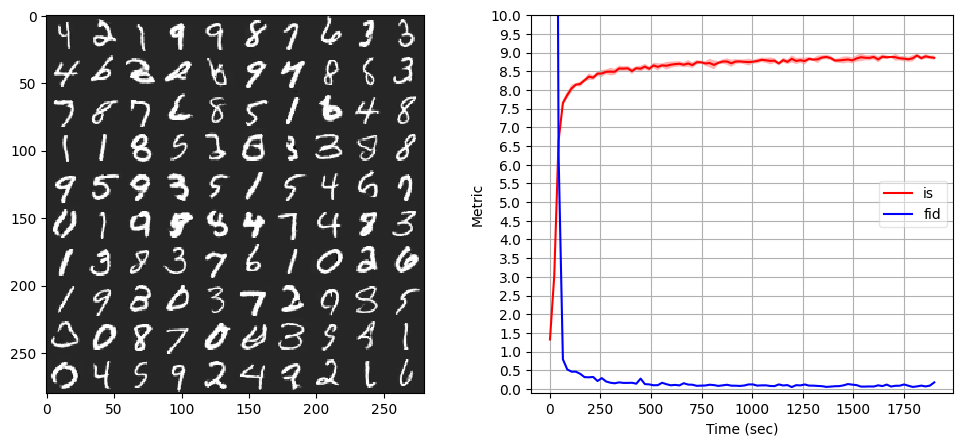

Iter 90000: Mean proba from D(G(z)): 0.1779 +/- 0.1611


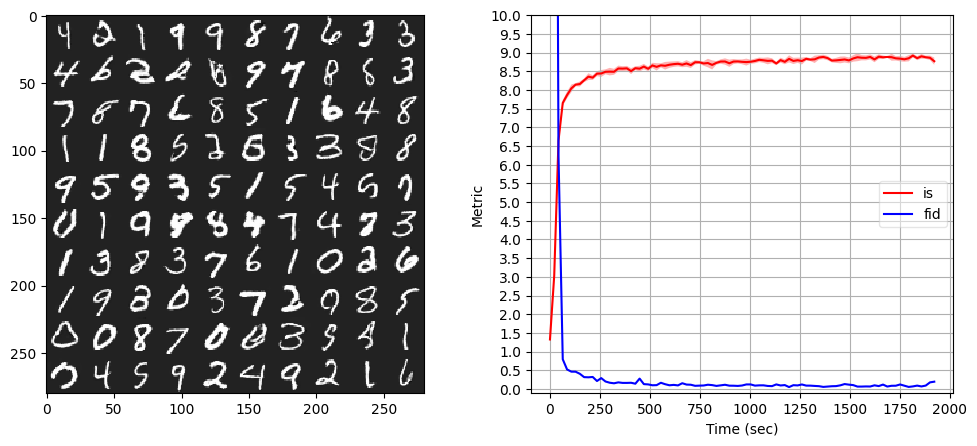

Iter 91000: Mean proba from D(G(z)): 0.0988 +/- 0.1134


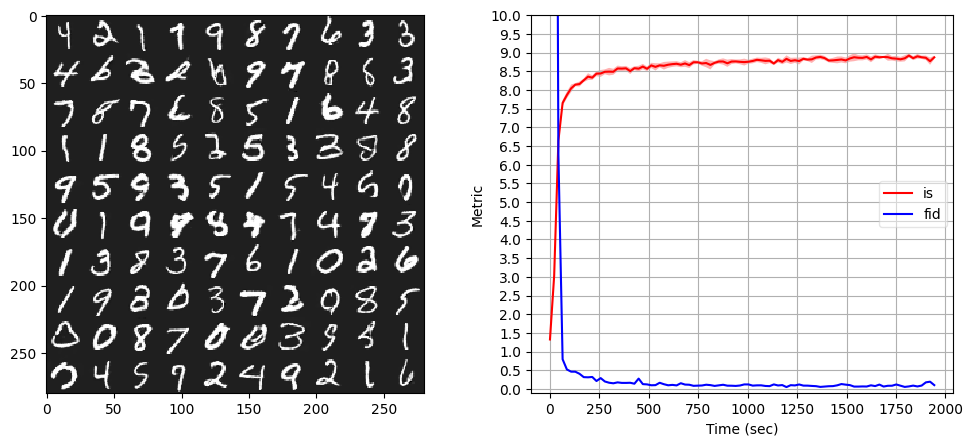

Iter 92000: Mean proba from D(G(z)): 0.1210 +/- 0.1301


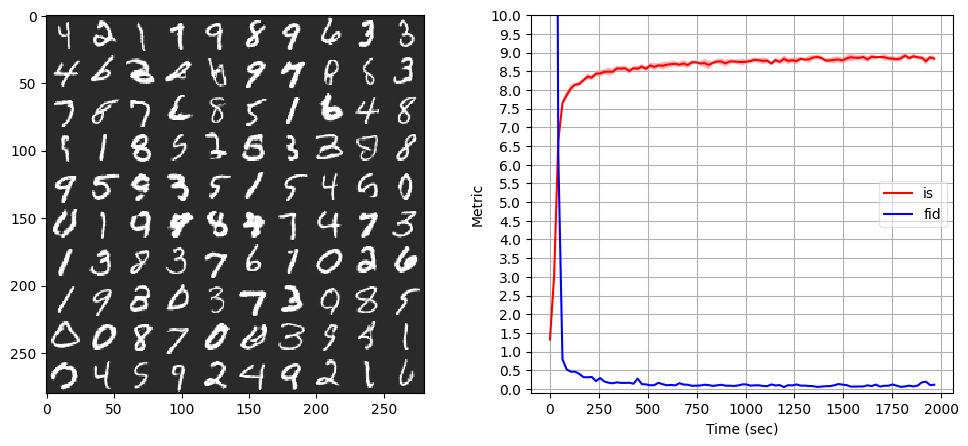

Iter 93000: Mean proba from D(G(z)): 0.1385 +/- 0.1403


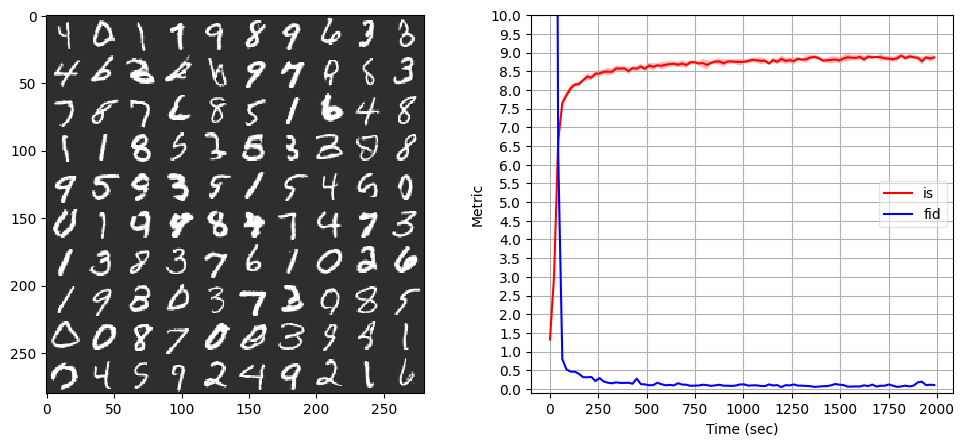

Iter 94000: Mean proba from D(G(z)): 0.1693 +/- 0.1721


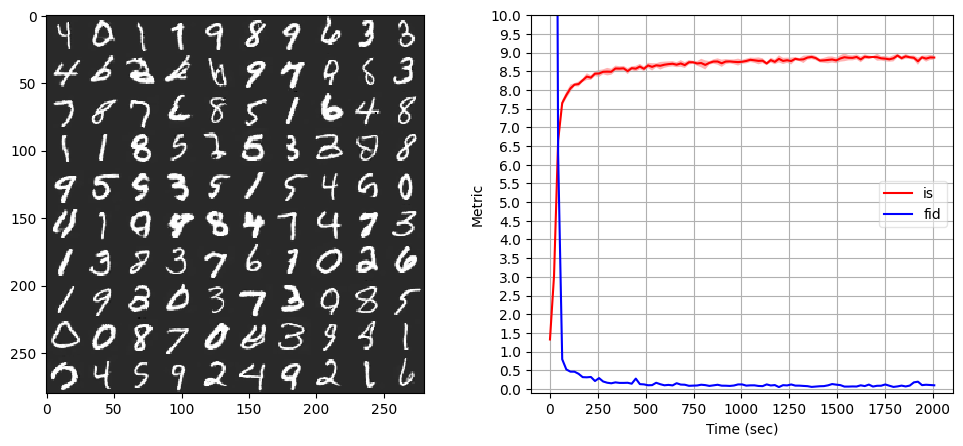

Iter 95000: Mean proba from D(G(z)): 0.0976 +/- 0.1138


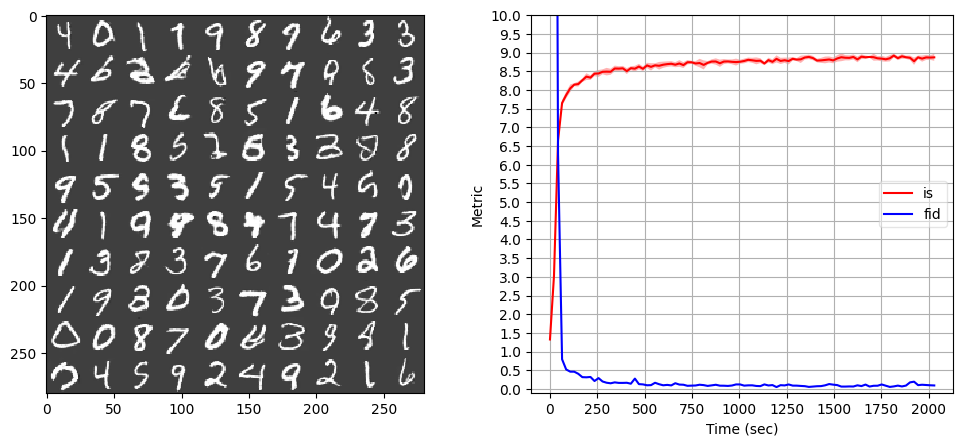

Iter 96000: Mean proba from D(G(z)): 0.1205 +/- 0.1326


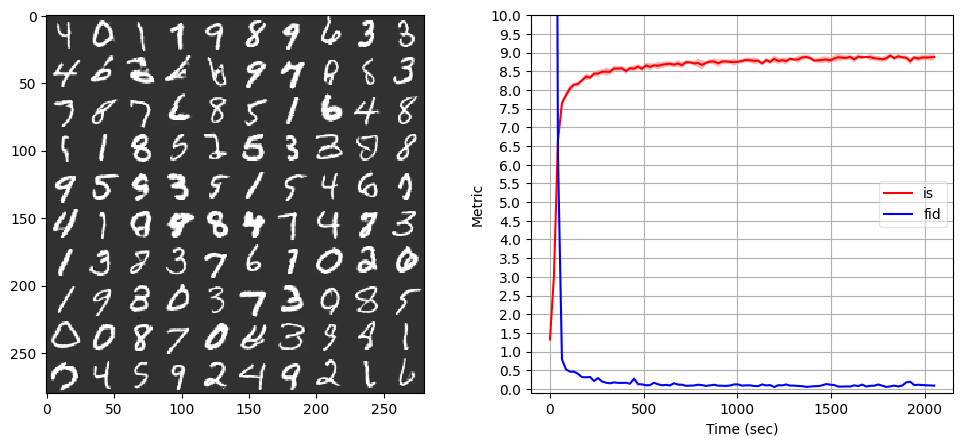

Iter 97000: Mean proba from D(G(z)): 0.1768 +/- 0.1754


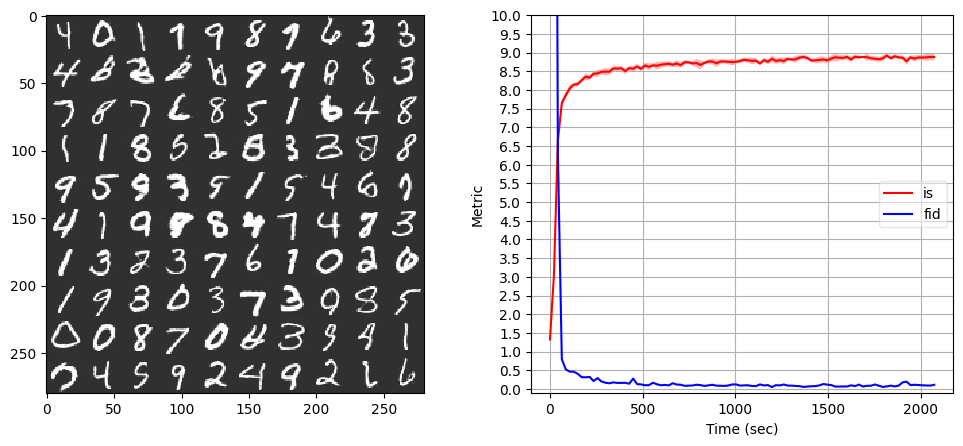

Iter 98000: Mean proba from D(G(z)): 0.1981 +/- 0.1851


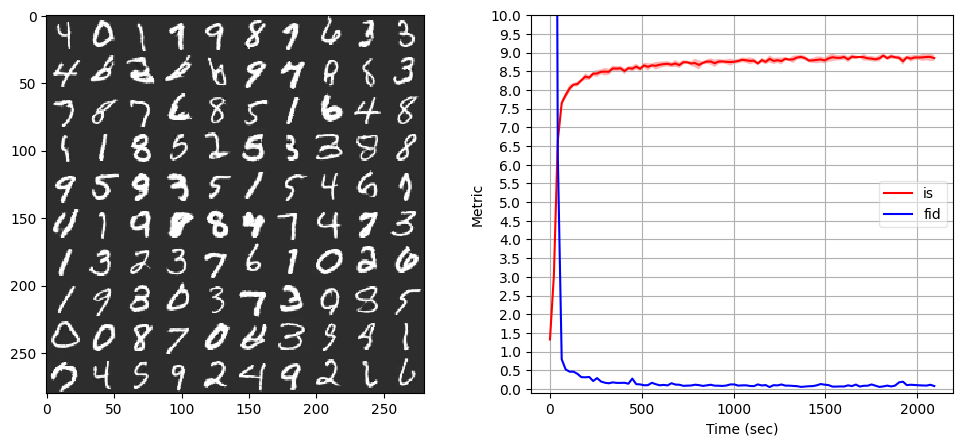

Iter 99000: Mean proba from D(G(z)): 0.2215 +/- 0.1976


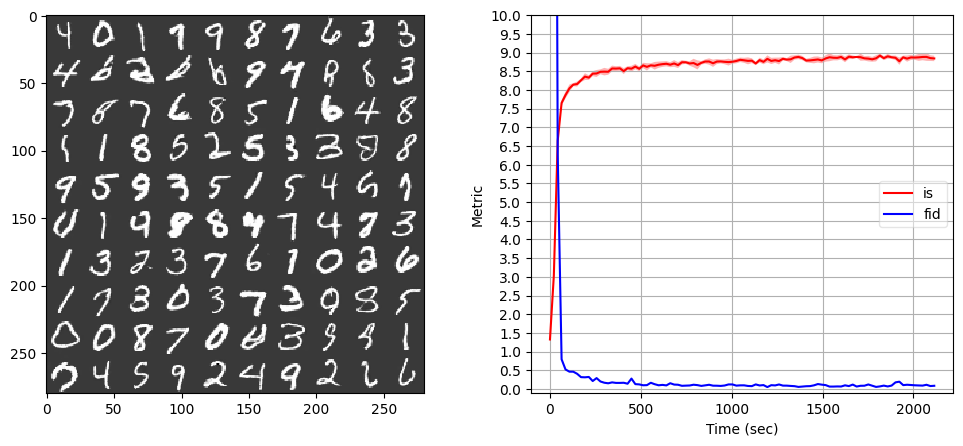

Iter 99999: Mean proba from D(G(z)): 0.0894 +/- 0.1422


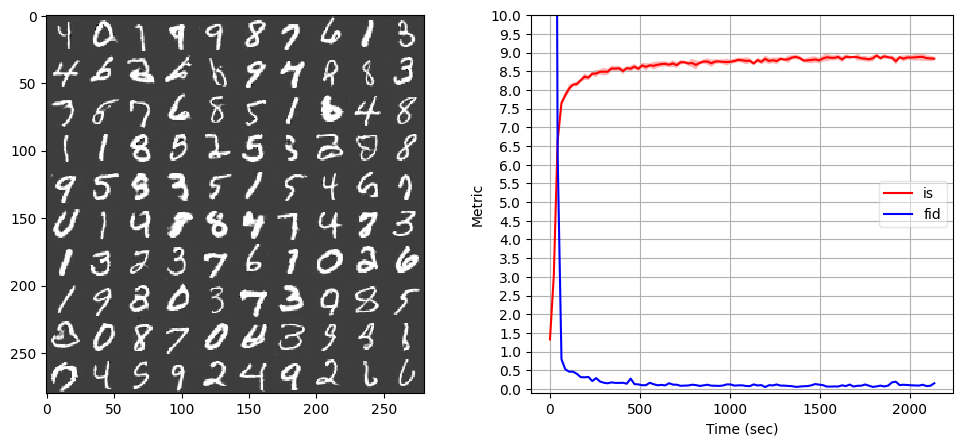

Loading trained model from ./drive/My Drive/Data/models/mnist.pth
in init of lookahead
in init of lookahead
Iter 0: Mean proba from D(G(z)): 0.9868 +/- 0.0041


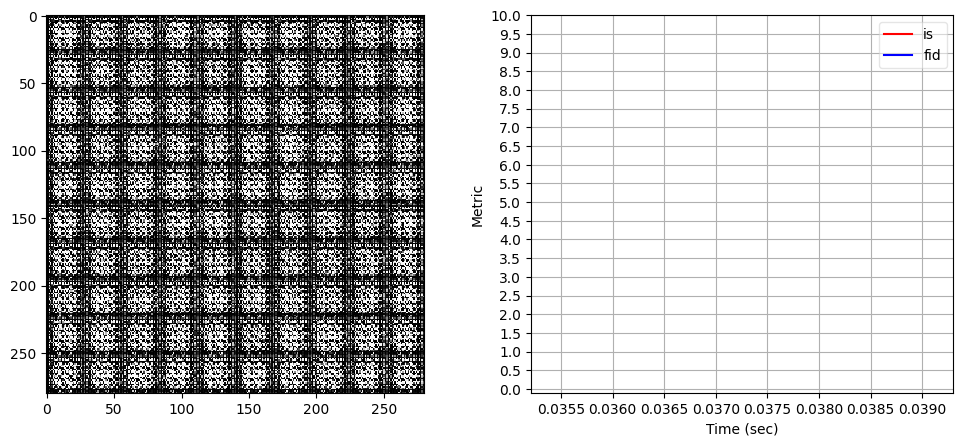

Iter 1000: Mean proba from D(G(z)): 0.0036 +/- 0.0030


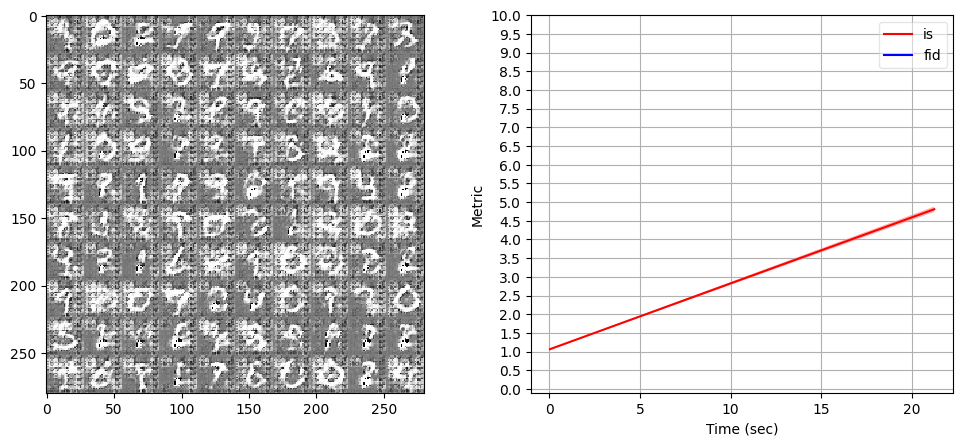

Iter 2000: Mean proba from D(G(z)): 0.0125 +/- 0.0134


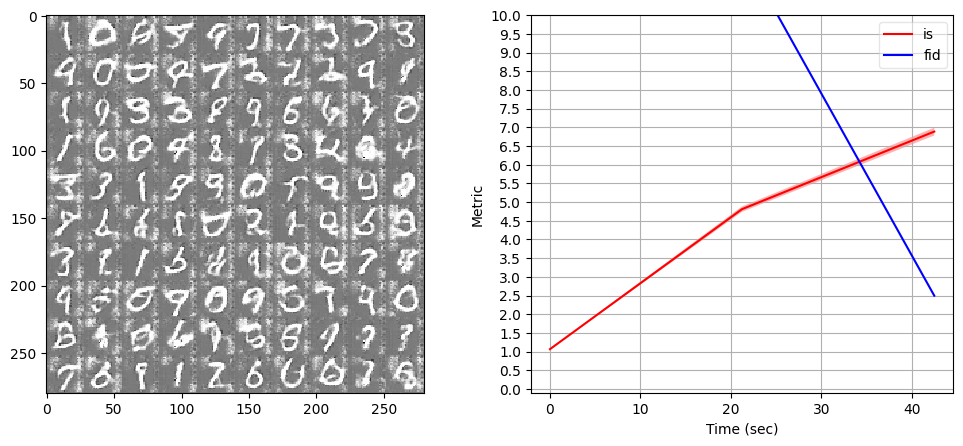

Iter 3000: Mean proba from D(G(z)): 0.2640 +/- 0.1325


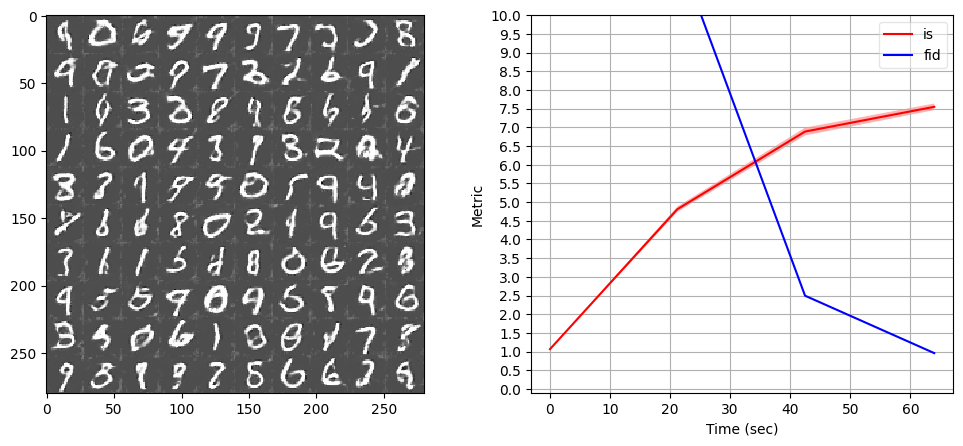

Iter 4000: Mean proba from D(G(z)): 0.4478 +/- 0.1616


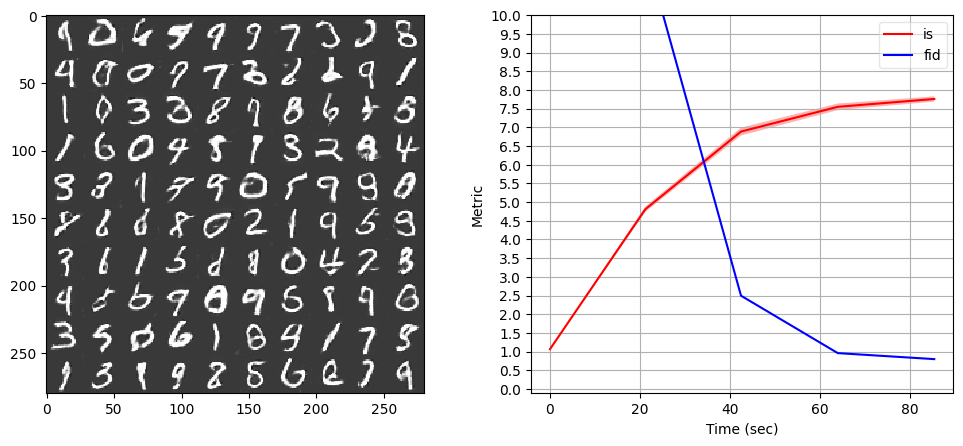

Iter 5000: Mean proba from D(G(z)): 0.4579 +/- 0.1730


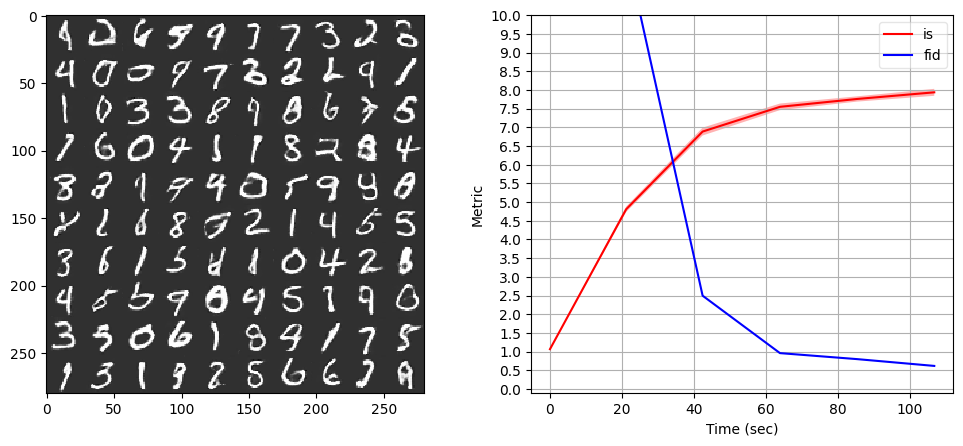

Iter 6000: Mean proba from D(G(z)): 0.4297 +/- 0.1585


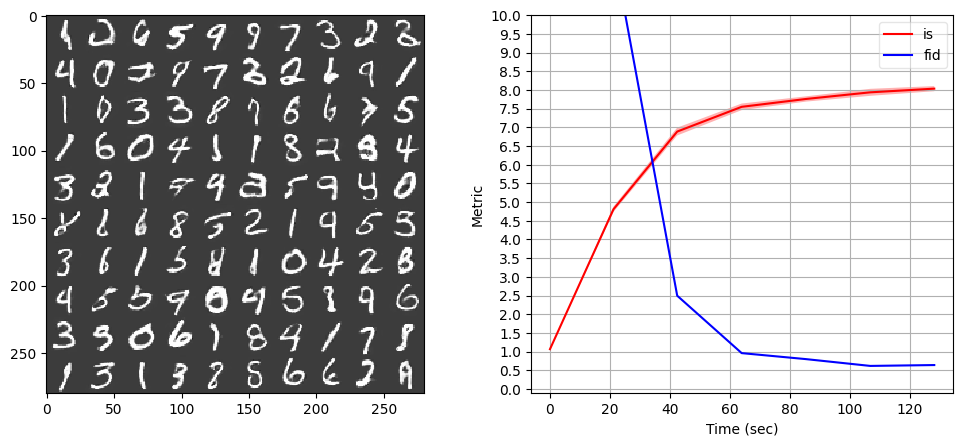

Iter 7000: Mean proba from D(G(z)): 0.5443 +/- 0.1776


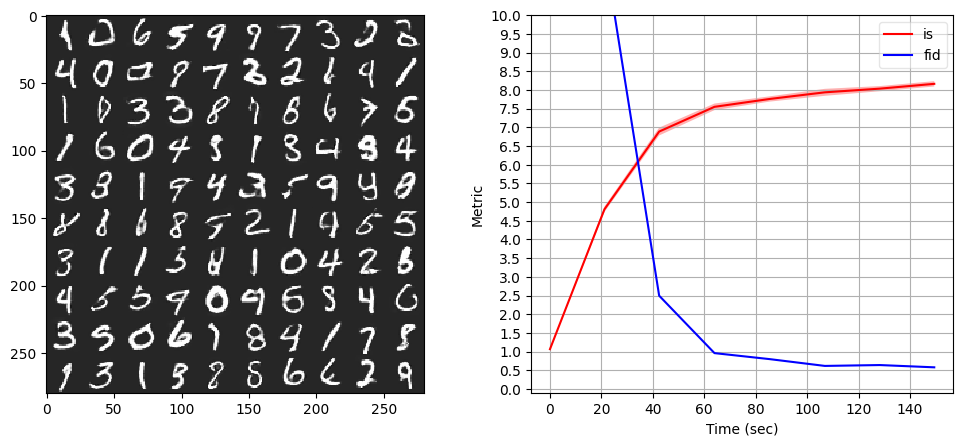

Iter 8000: Mean proba from D(G(z)): 0.4220 +/- 0.1893


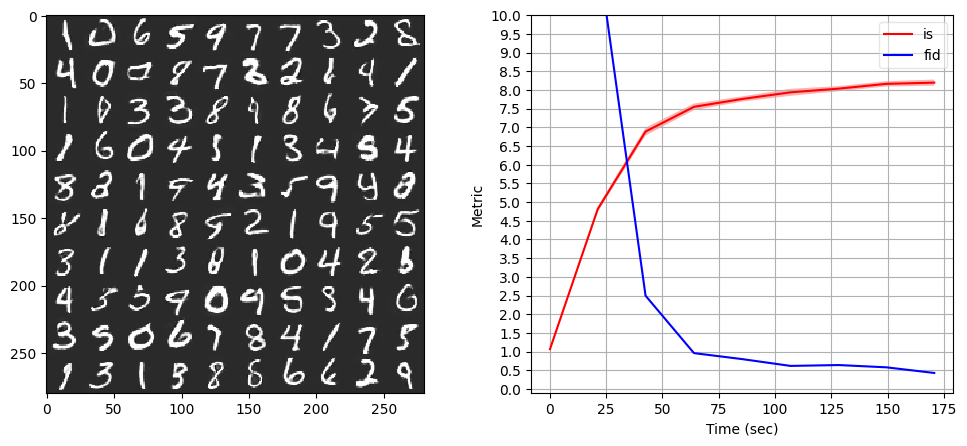

Iter 9000: Mean proba from D(G(z)): 0.3493 +/- 0.1666


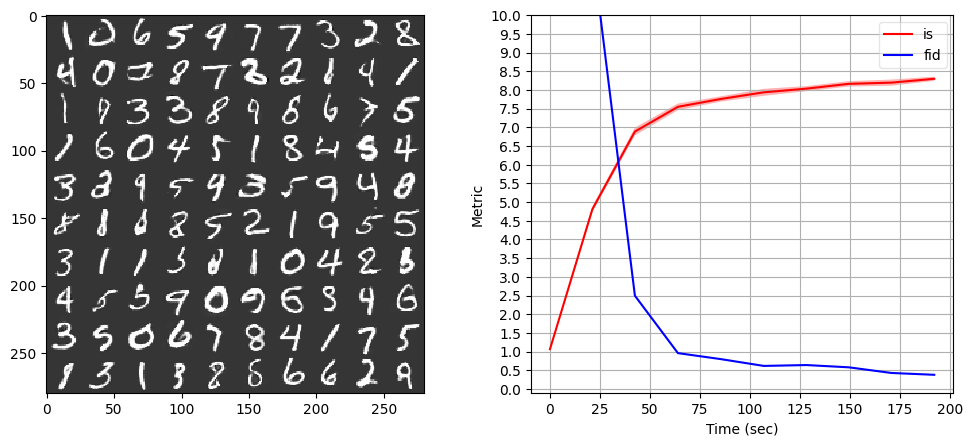

Iter 10000: Mean proba from D(G(z)): 0.5032 +/- 0.2004


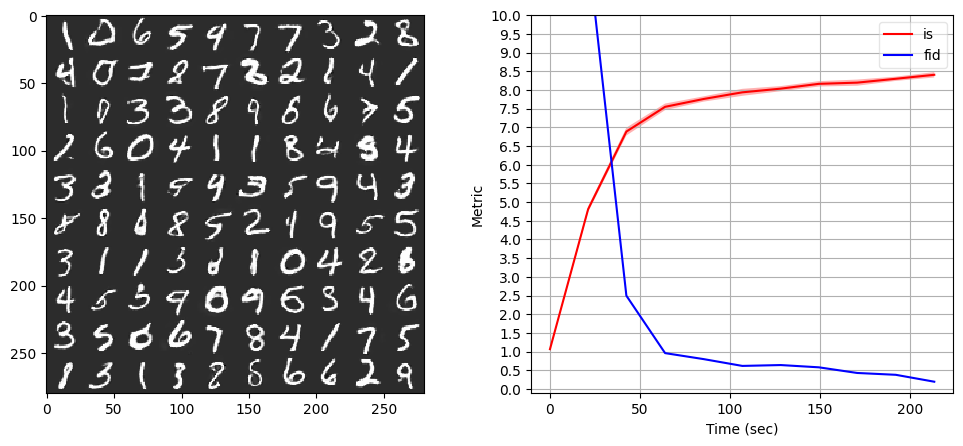

Iter 11000: Mean proba from D(G(z)): 0.5202 +/- 0.1896


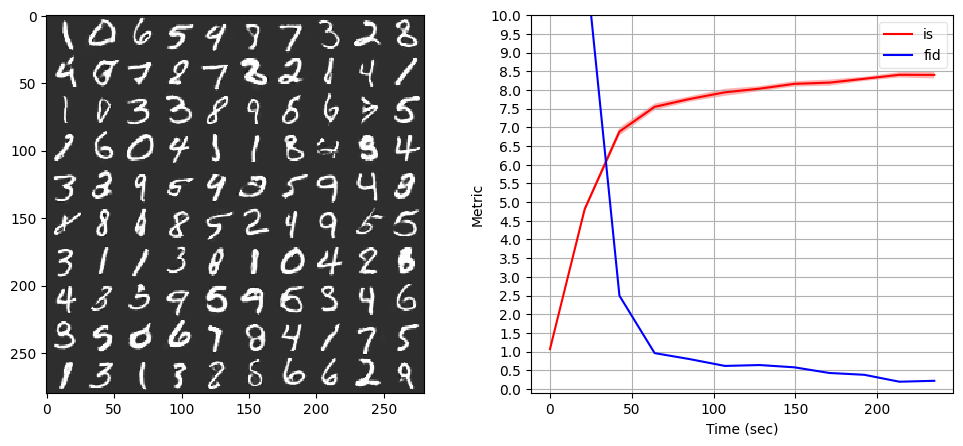

Iter 12000: Mean proba from D(G(z)): 0.5404 +/- 0.1799


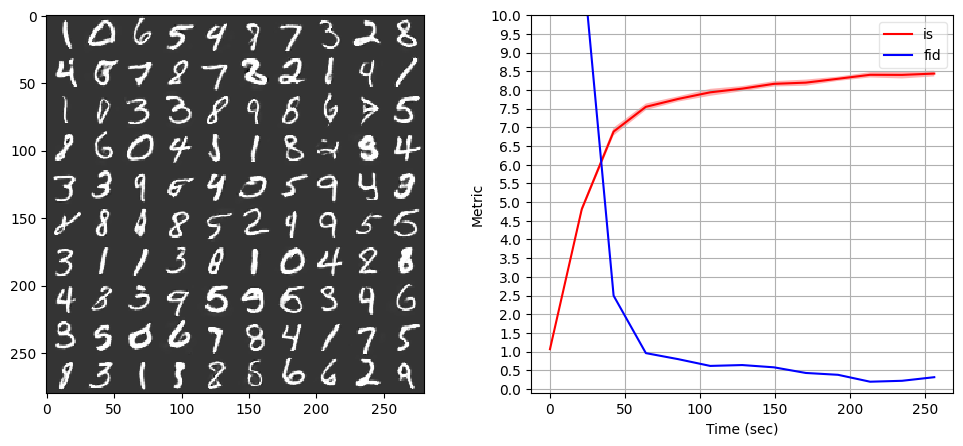

Iter 13000: Mean proba from D(G(z)): 0.5008 +/- 0.1739


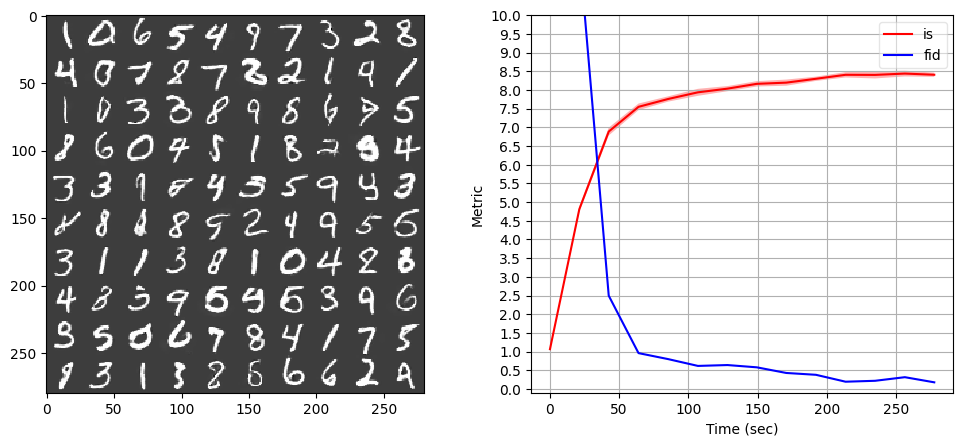

Iter 14000: Mean proba from D(G(z)): 0.3134 +/- 0.1718


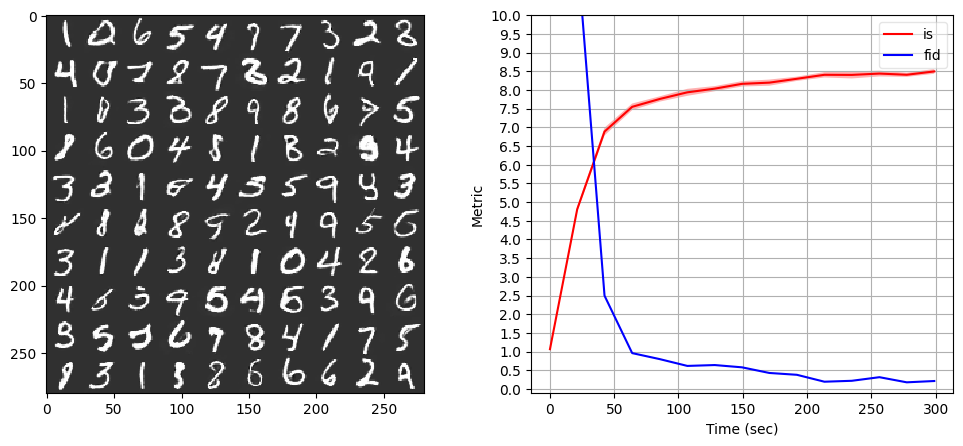

Iter 15000: Mean proba from D(G(z)): 0.3565 +/- 0.1760


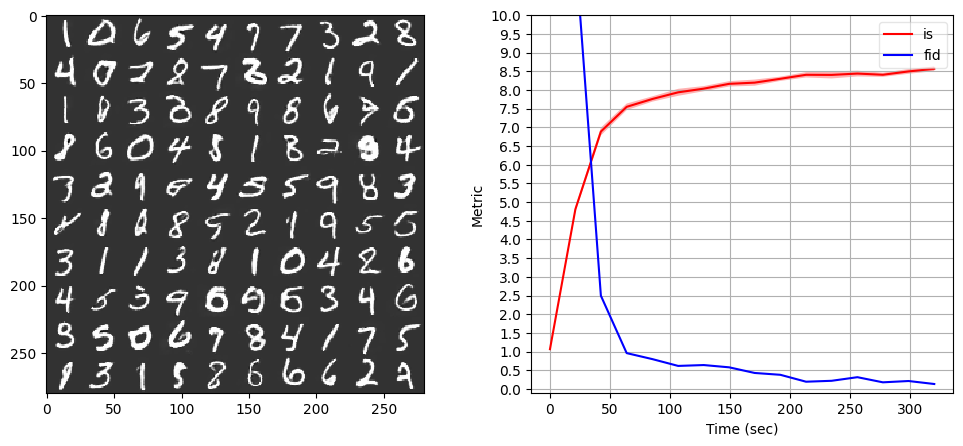

Iter 16000: Mean proba from D(G(z)): 0.2994 +/- 0.1657


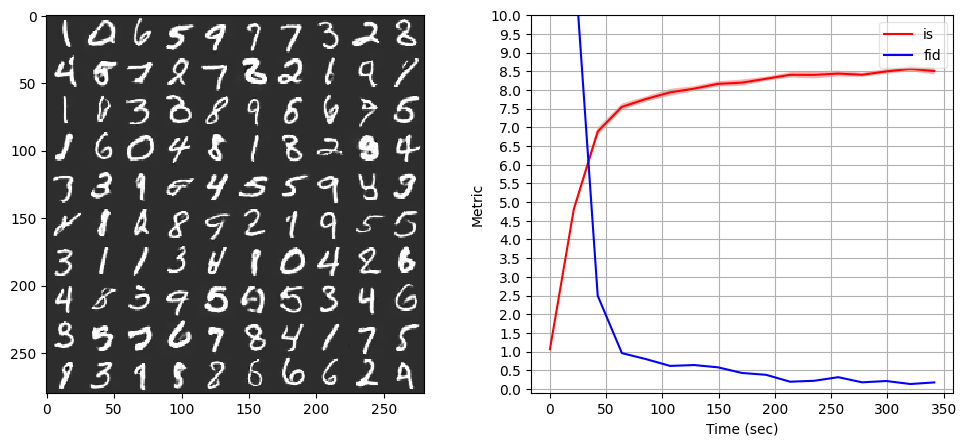

Iter 17000: Mean proba from D(G(z)): 0.2806 +/- 0.1460


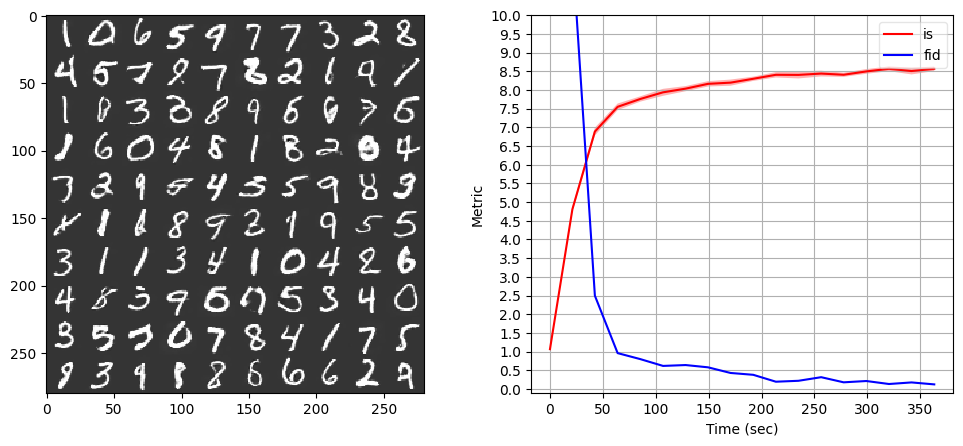

Iter 18000: Mean proba from D(G(z)): 0.2725 +/- 0.1722


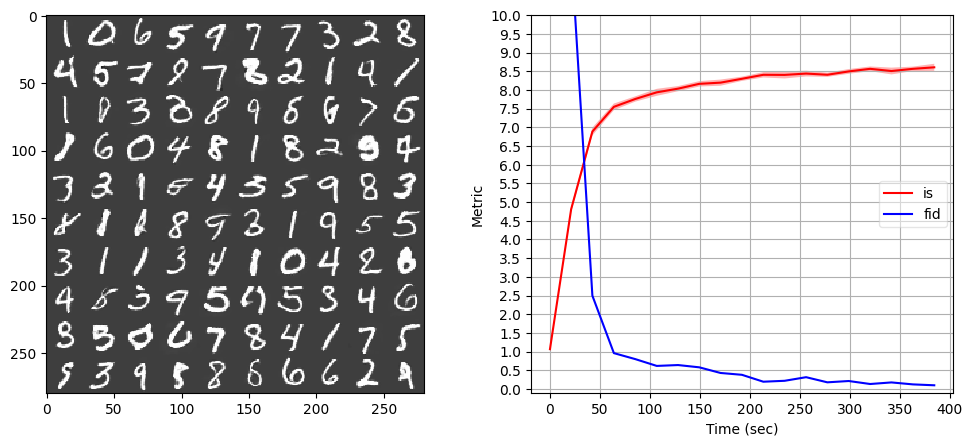

Iter 19000: Mean proba from D(G(z)): 0.2746 +/- 0.1649


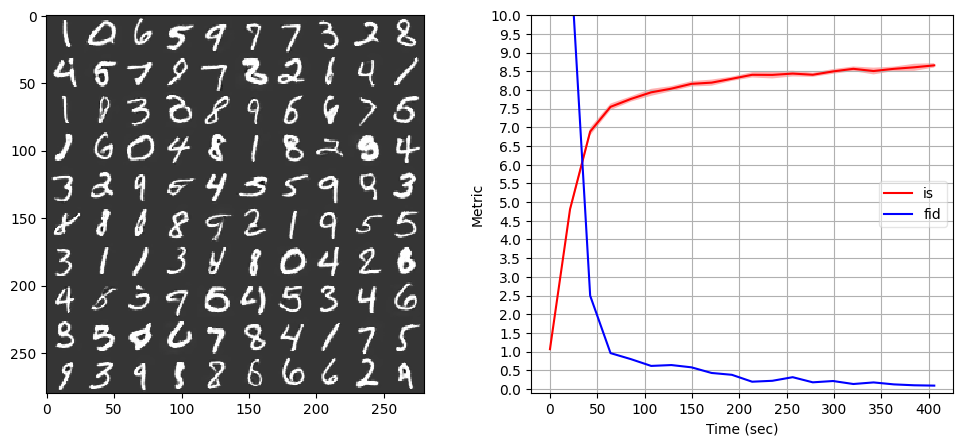

Iter 20000: Mean proba from D(G(z)): 0.3901 +/- 0.1664


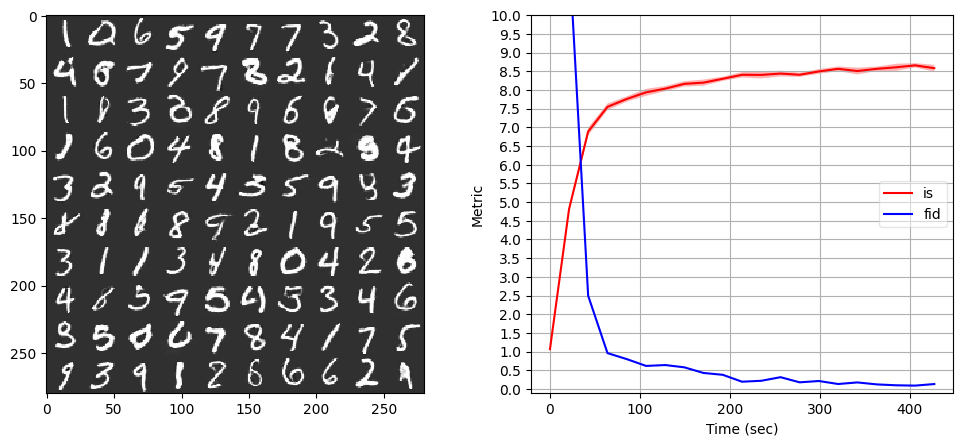

Iter 21000: Mean proba from D(G(z)): 0.3557 +/- 0.1612


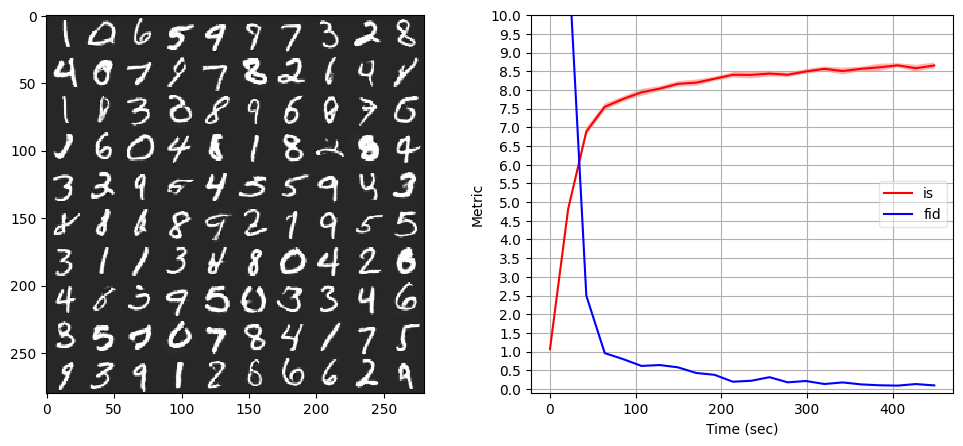

Iter 22000: Mean proba from D(G(z)): 0.4985 +/- 0.1914


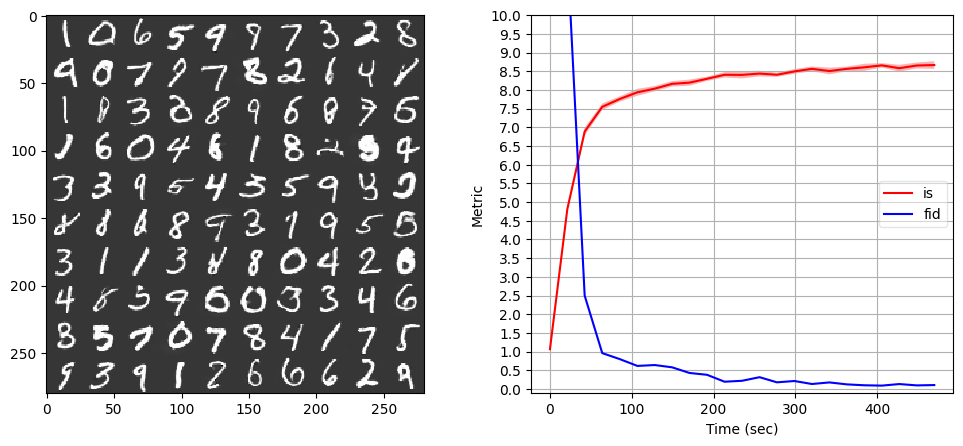

Iter 23000: Mean proba from D(G(z)): 0.4800 +/- 0.1897


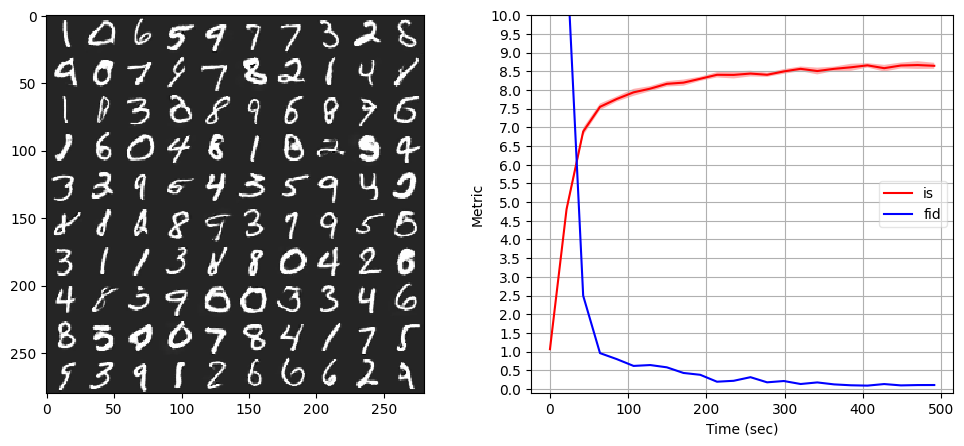

Iter 24000: Mean proba from D(G(z)): 0.5545 +/- 0.1996


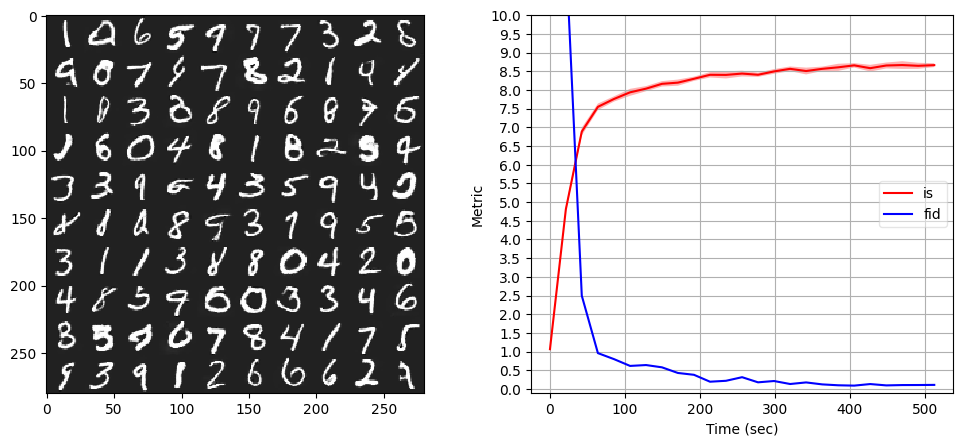

Iter 25000: Mean proba from D(G(z)): 0.5597 +/- 0.1870


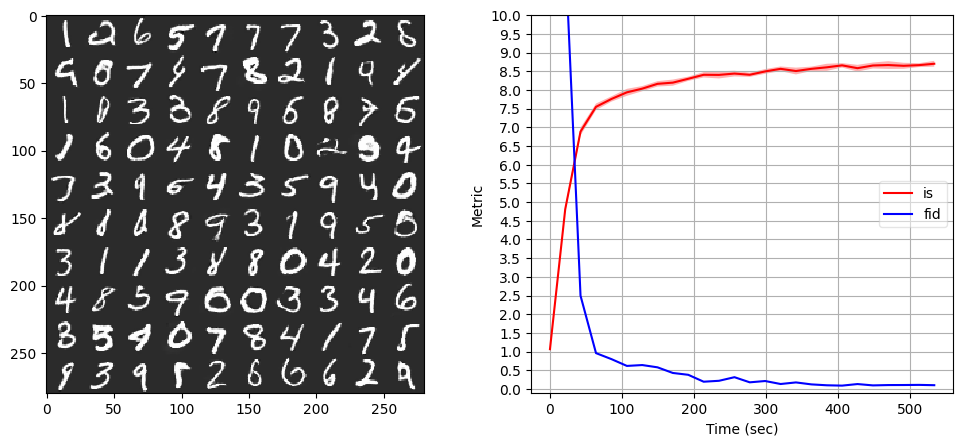

Iter 26000: Mean proba from D(G(z)): 0.7380 +/- 0.1861


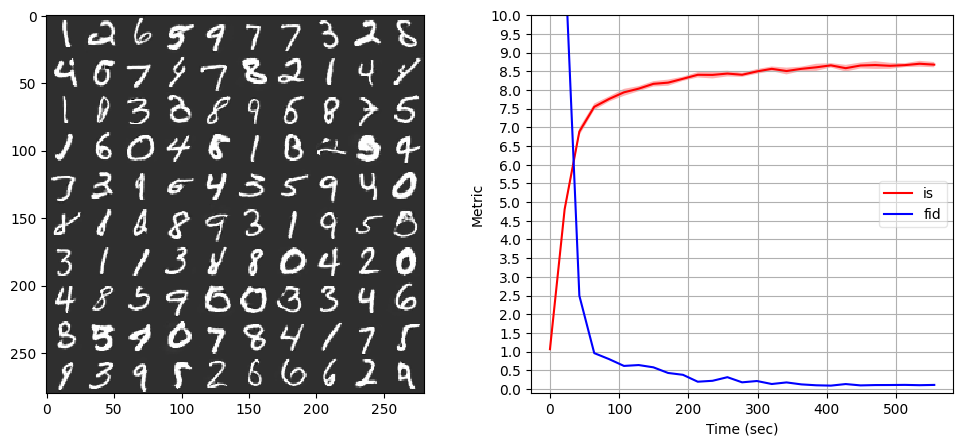

Iter 27000: Mean proba from D(G(z)): 0.5493 +/- 0.2025


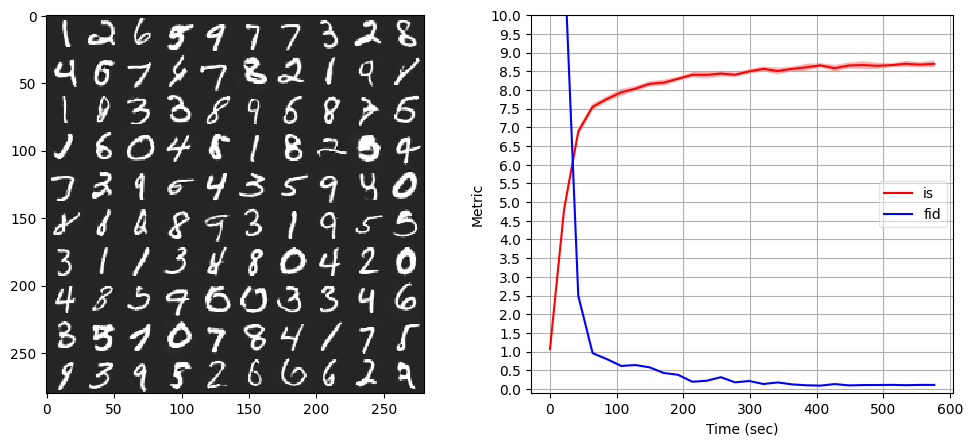

Iter 28000: Mean proba from D(G(z)): 0.6660 +/- 0.1786


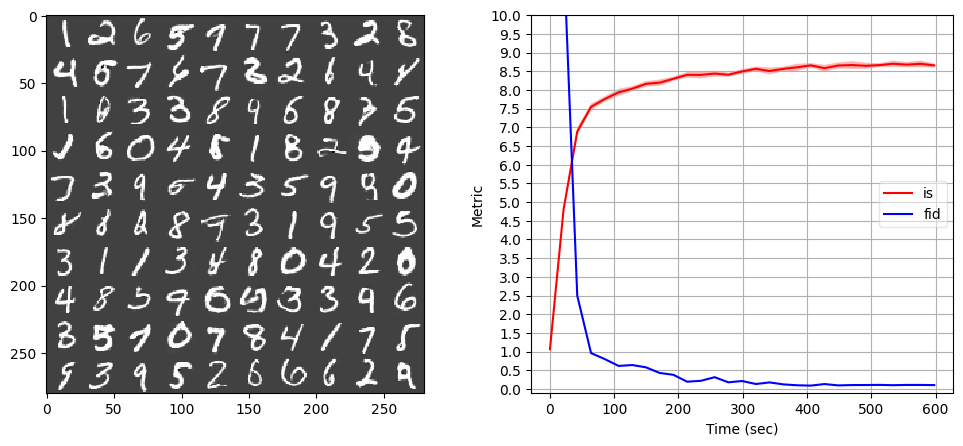

Iter 29000: Mean proba from D(G(z)): 0.7077 +/- 0.1835


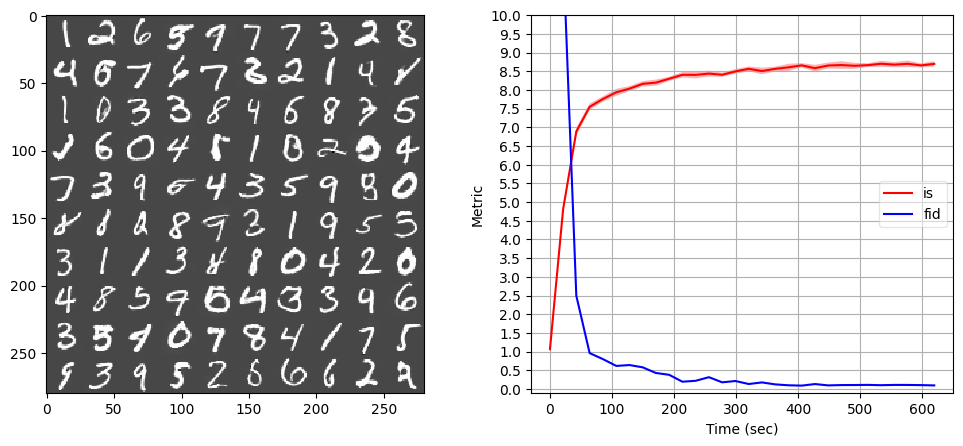

Iter 30000: Mean proba from D(G(z)): 0.5212 +/- 0.2215


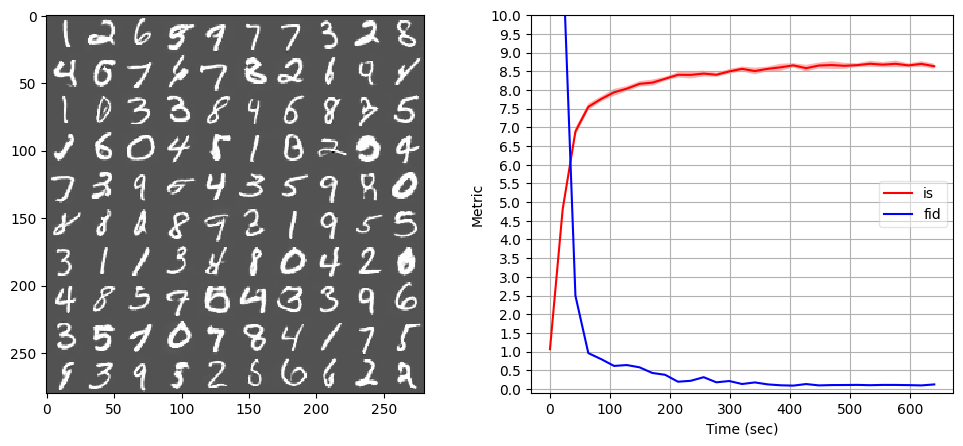

Iter 31000: Mean proba from D(G(z)): 0.5588 +/- 0.2186


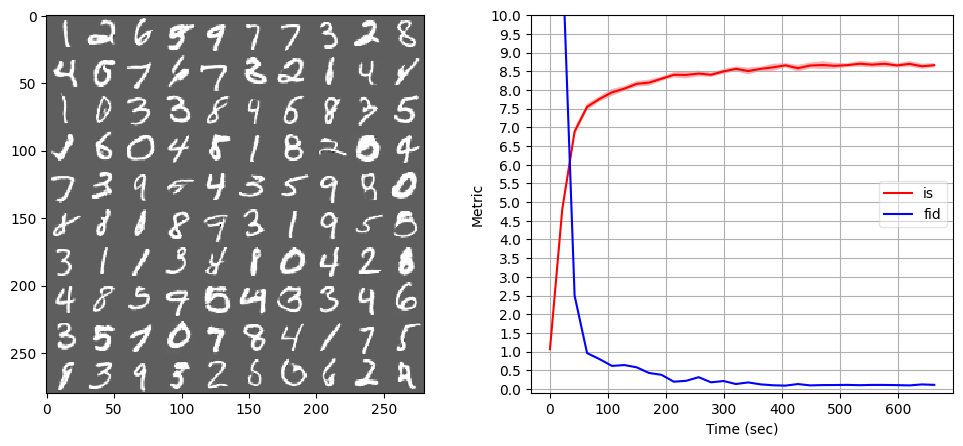

Iter 32000: Mean proba from D(G(z)): 0.5736 +/- 0.2190


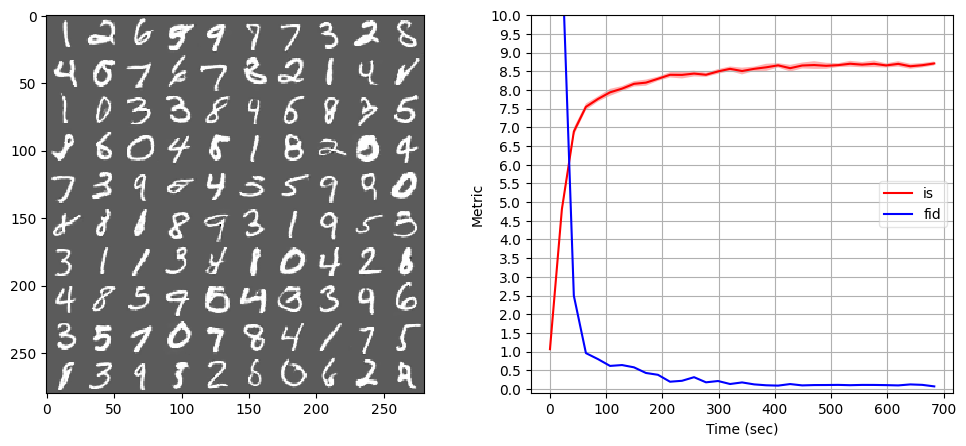

Iter 33000: Mean proba from D(G(z)): 0.6229 +/- 0.2123


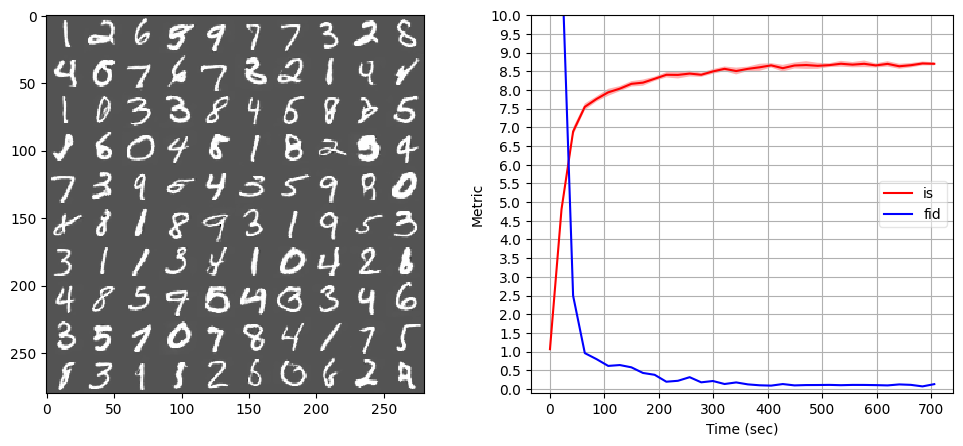

Iter 34000: Mean proba from D(G(z)): 0.4470 +/- 0.2166


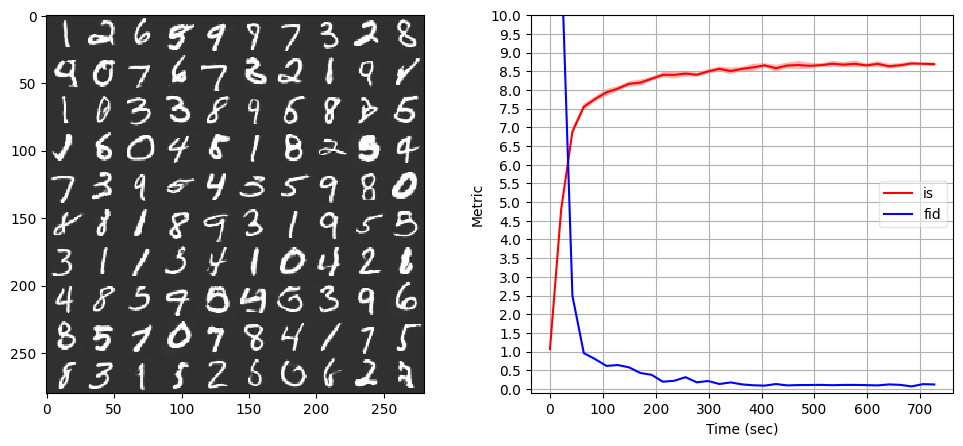

Iter 35000: Mean proba from D(G(z)): 0.6553 +/- 0.1920


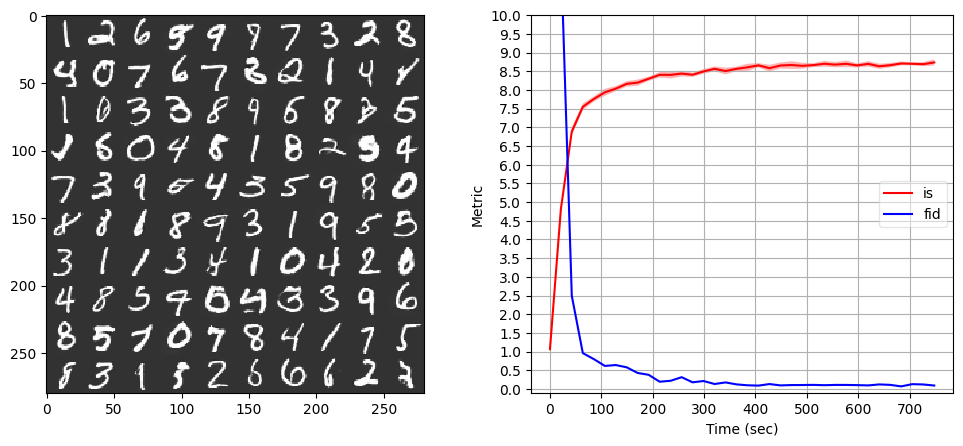

Iter 36000: Mean proba from D(G(z)): 0.7357 +/- 0.1737


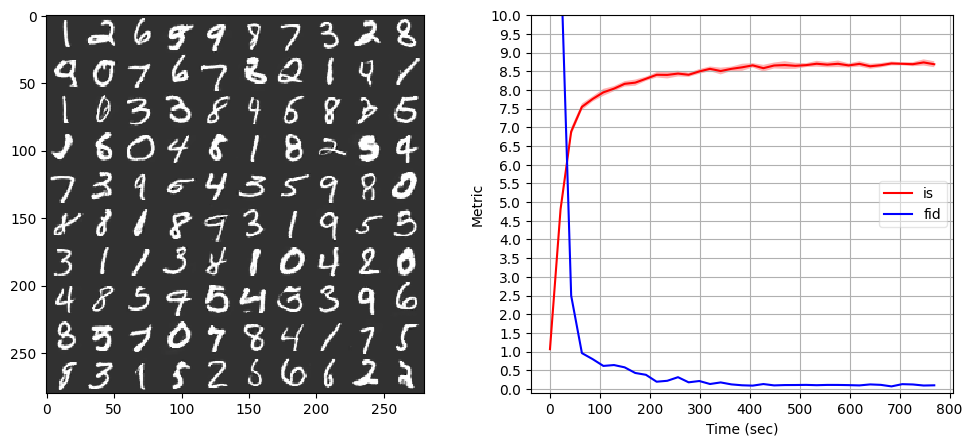

Iter 37000: Mean proba from D(G(z)): 0.4801 +/- 0.2084


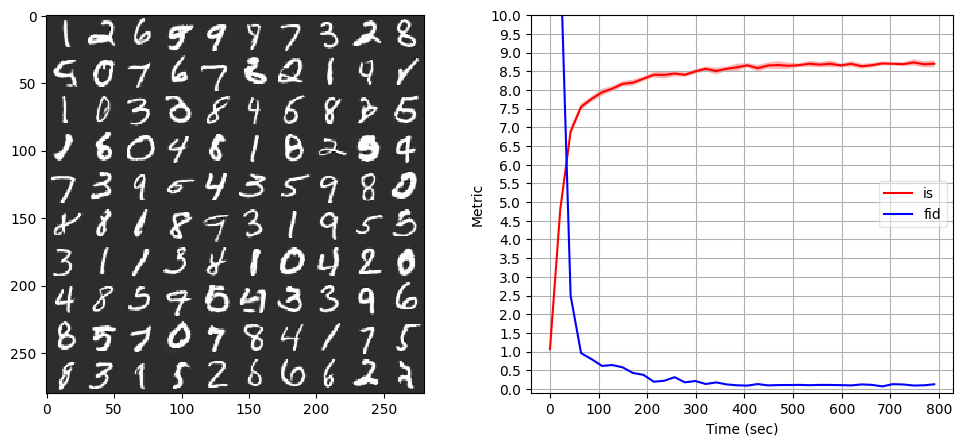

Iter 38000: Mean proba from D(G(z)): 0.5838 +/- 0.1966


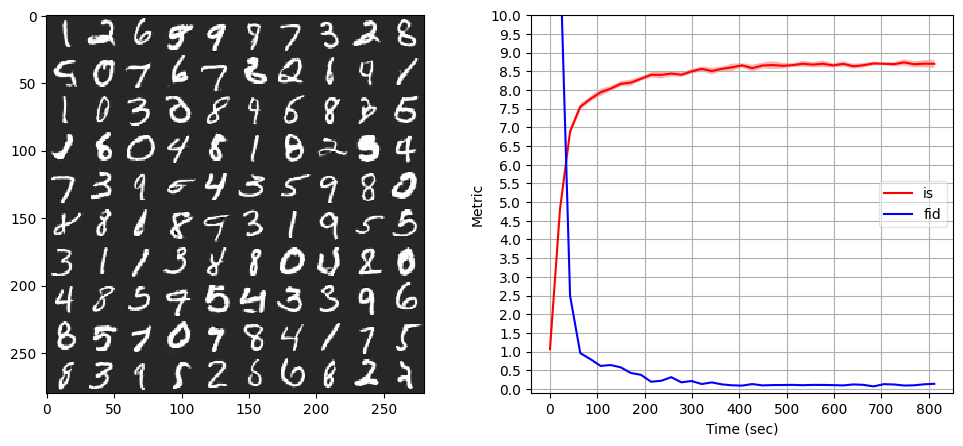

Iter 39000: Mean proba from D(G(z)): 0.6872 +/- 0.2096


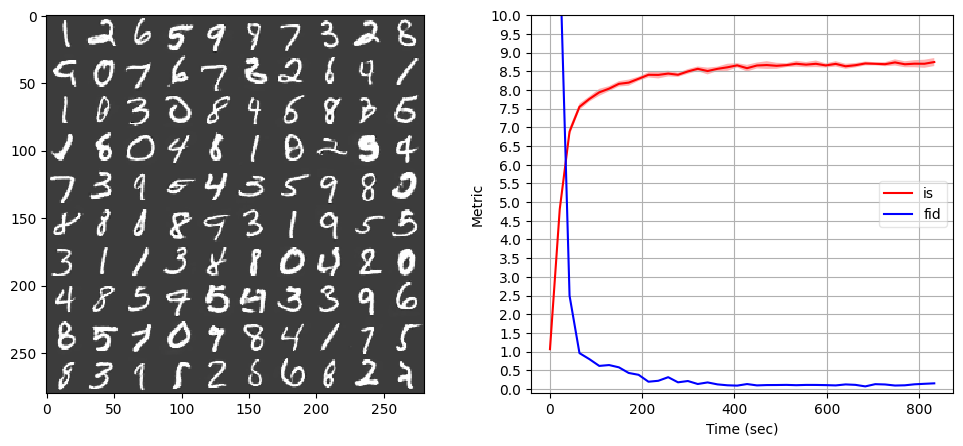

Iter 40000: Mean proba from D(G(z)): 0.5329 +/- 0.2101


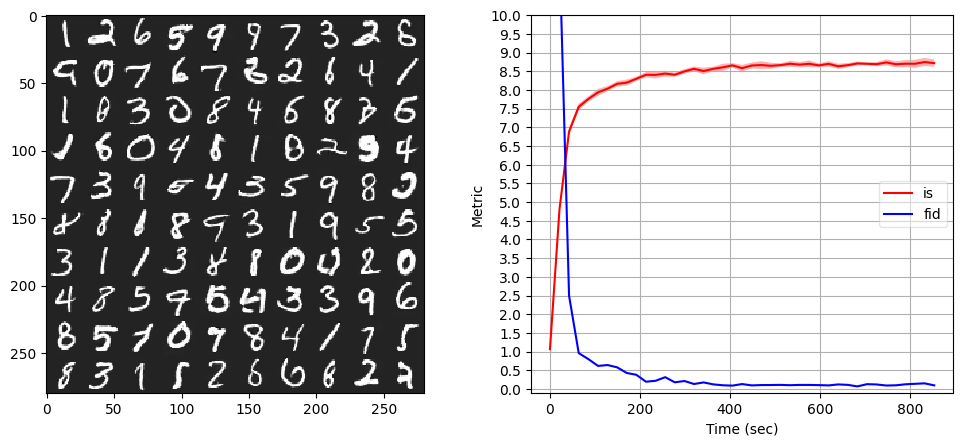

Iter 41000: Mean proba from D(G(z)): 0.5267 +/- 0.2101


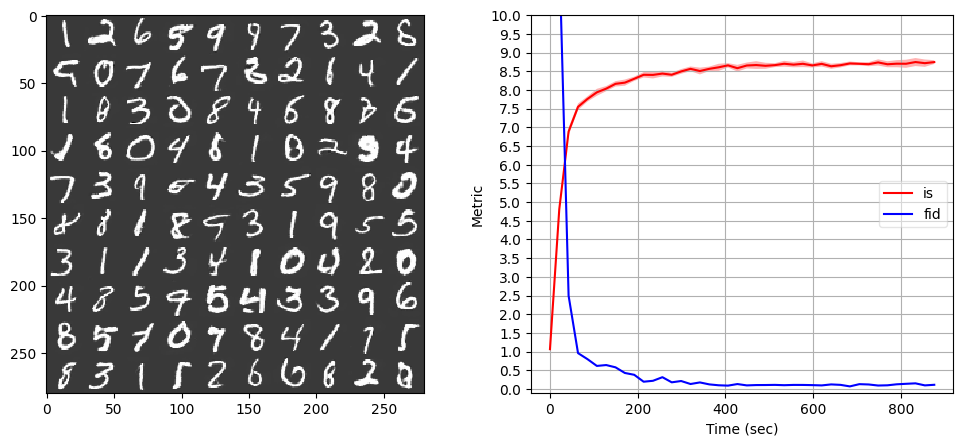

Iter 42000: Mean proba from D(G(z)): 0.5065 +/- 0.2077


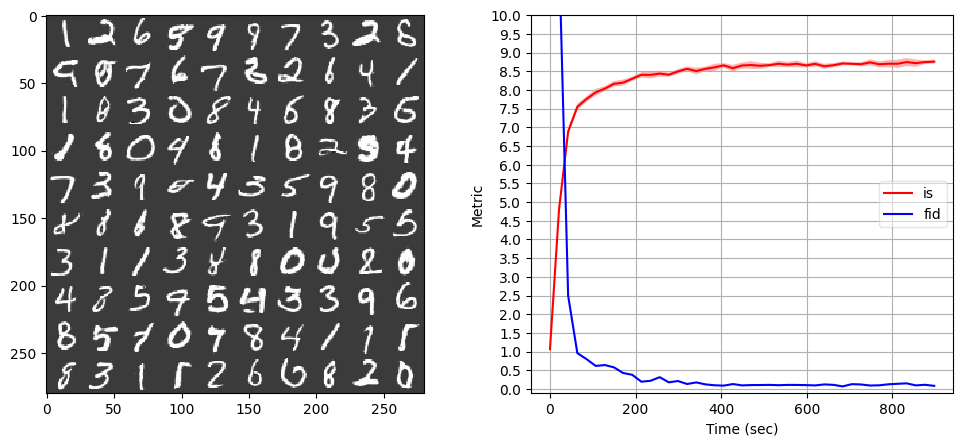

Iter 43000: Mean proba from D(G(z)): 0.6385 +/- 0.2133


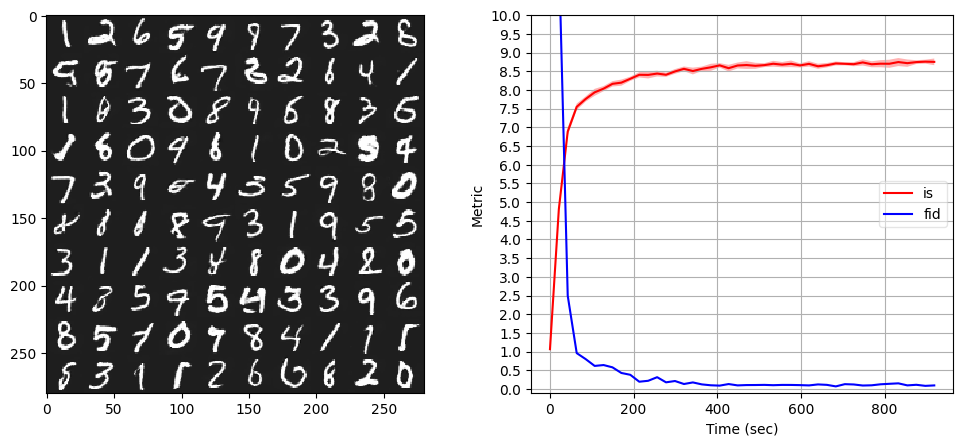

Iter 44000: Mean proba from D(G(z)): 0.5697 +/- 0.2309


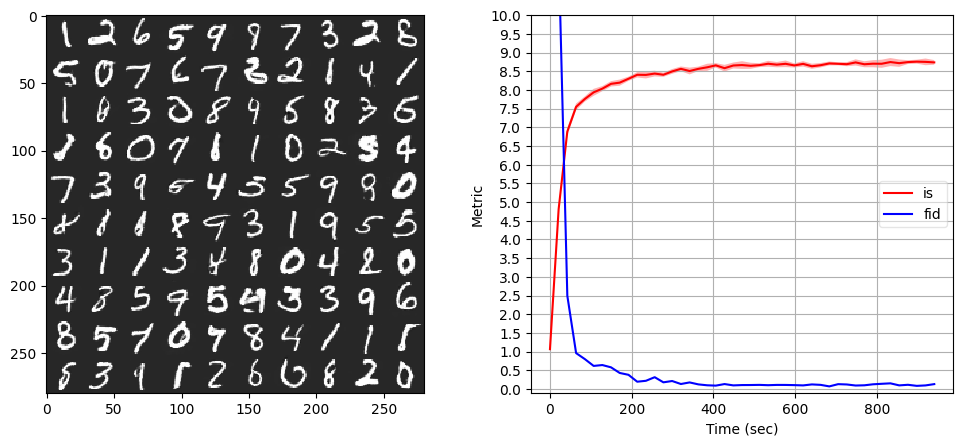

Iter 45000: Mean proba from D(G(z)): 0.4890 +/- 0.2433


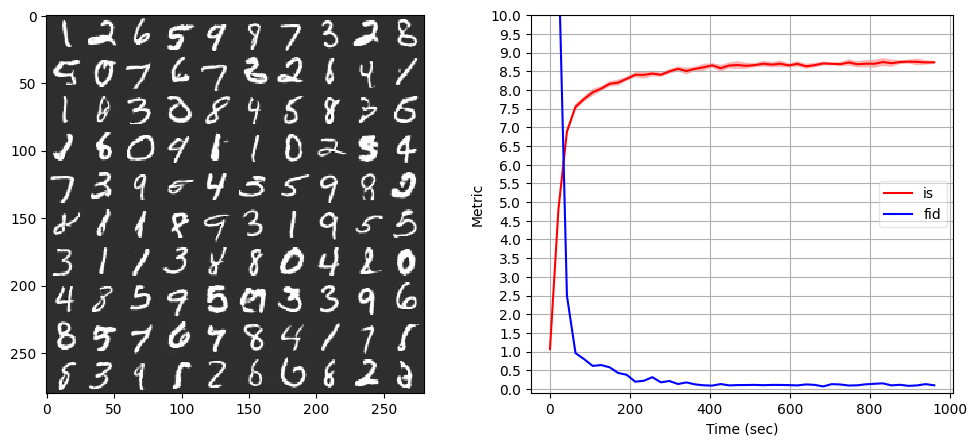

Iter 46000: Mean proba from D(G(z)): 0.4119 +/- 0.2418


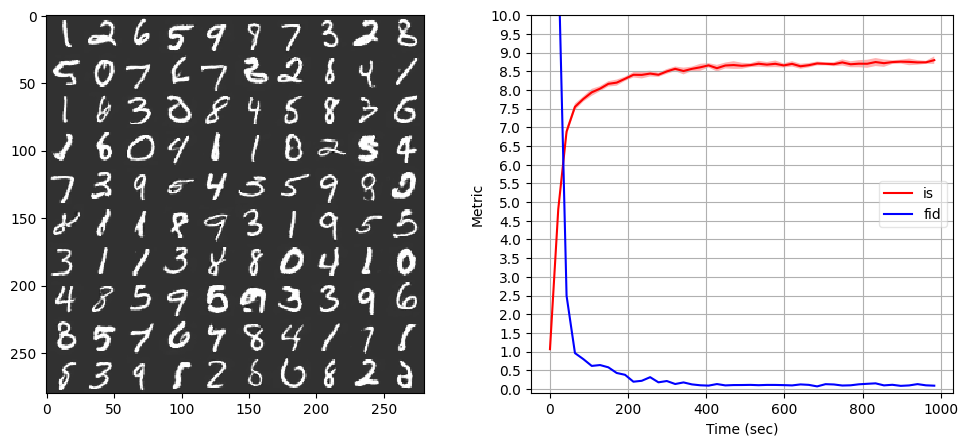

Iter 47000: Mean proba from D(G(z)): 0.2639 +/- 0.2062


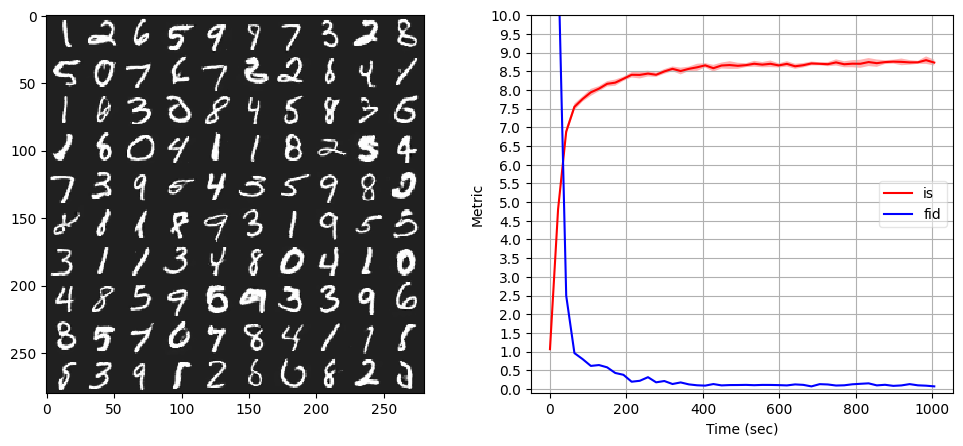

Iter 48000: Mean proba from D(G(z)): 0.3283 +/- 0.1873


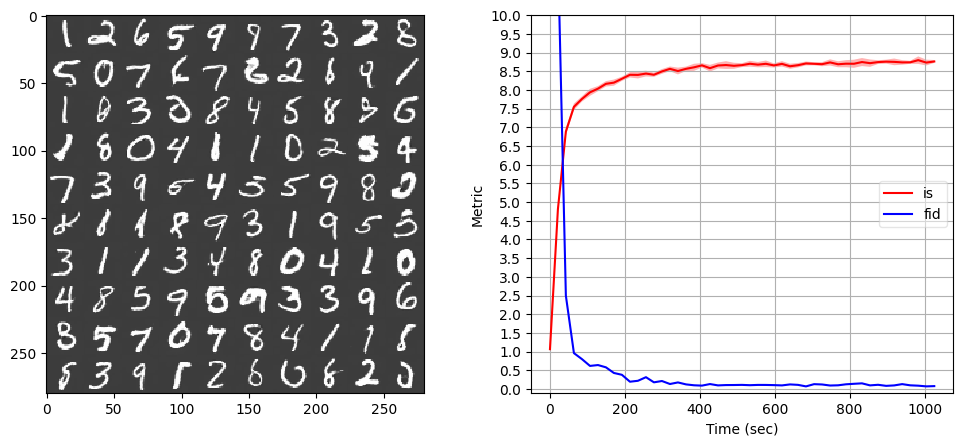

Iter 49000: Mean proba from D(G(z)): 0.4227 +/- 0.2071


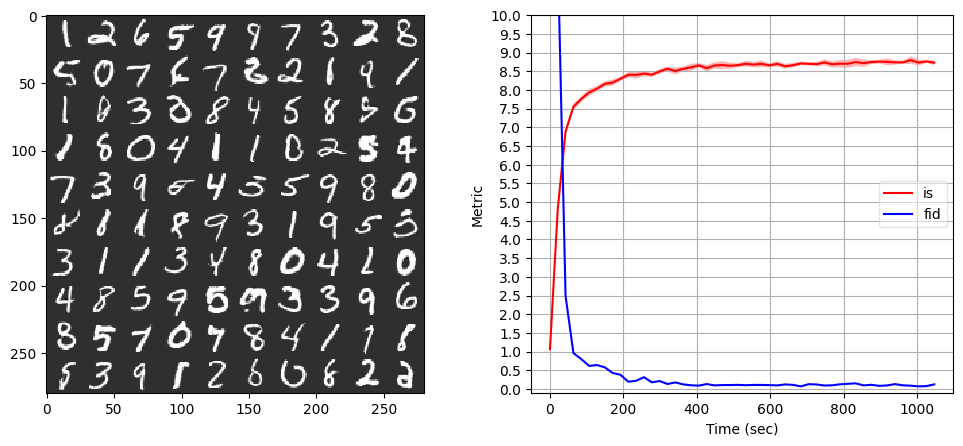

Iter 50000: Mean proba from D(G(z)): 0.4093 +/- 0.2018


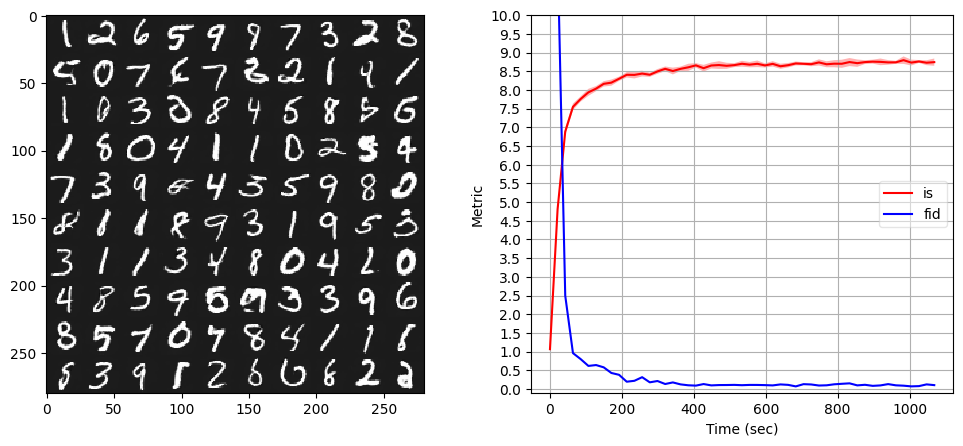

Iter 51000: Mean proba from D(G(z)): 0.4195 +/- 0.1969


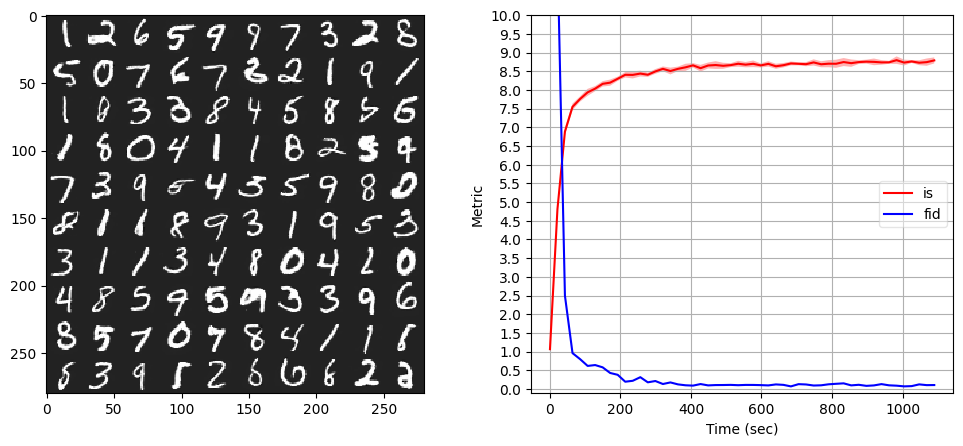

Iter 52000: Mean proba from D(G(z)): 0.4468 +/- 0.2294


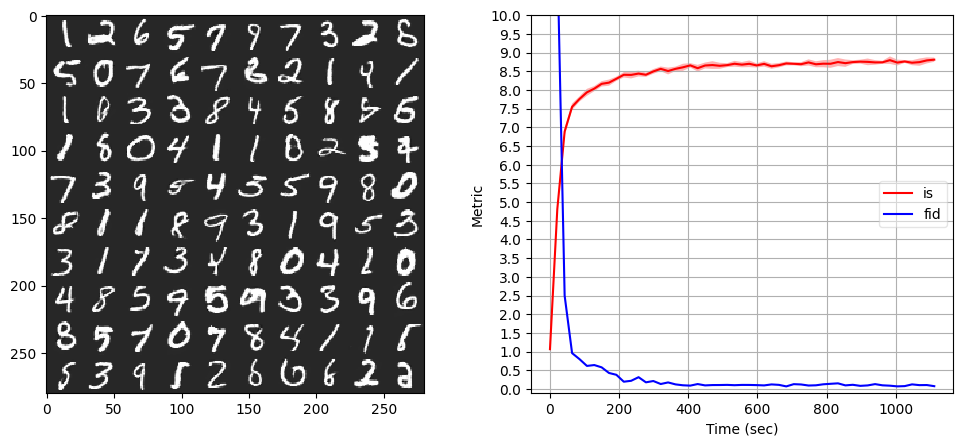

Iter 53000: Mean proba from D(G(z)): 0.2975 +/- 0.2012


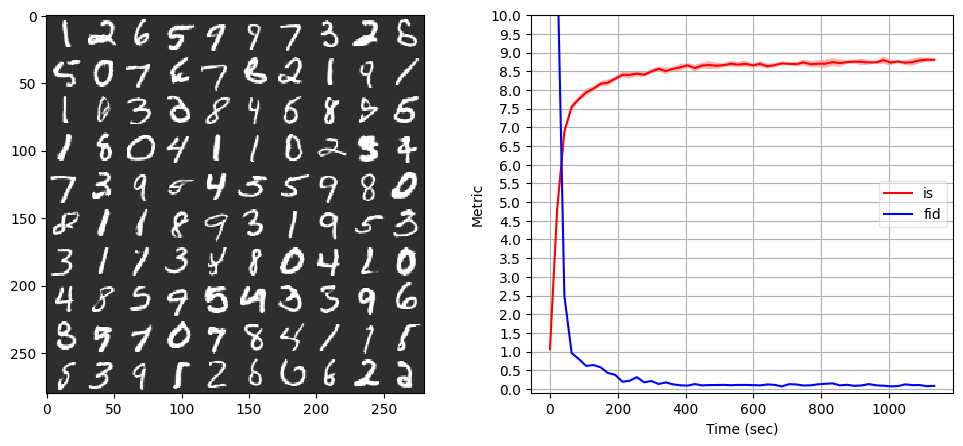

Iter 54000: Mean proba from D(G(z)): 0.3101 +/- 0.1987


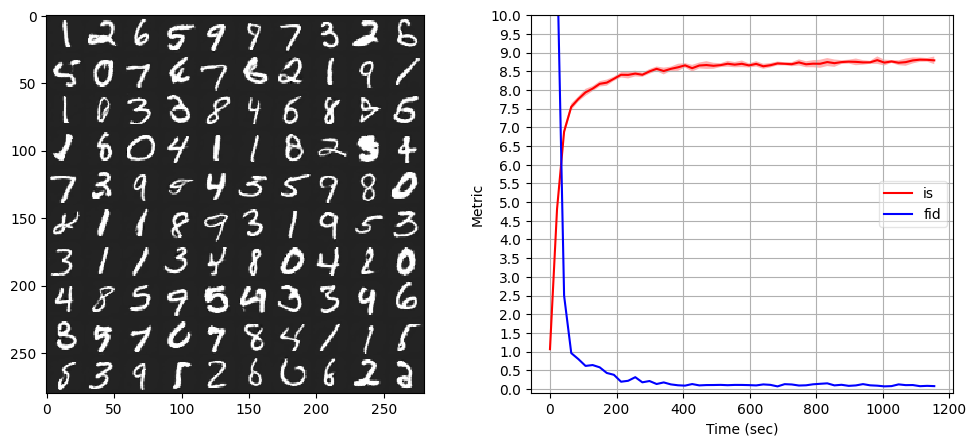

Iter 55000: Mean proba from D(G(z)): 0.3944 +/- 0.2168


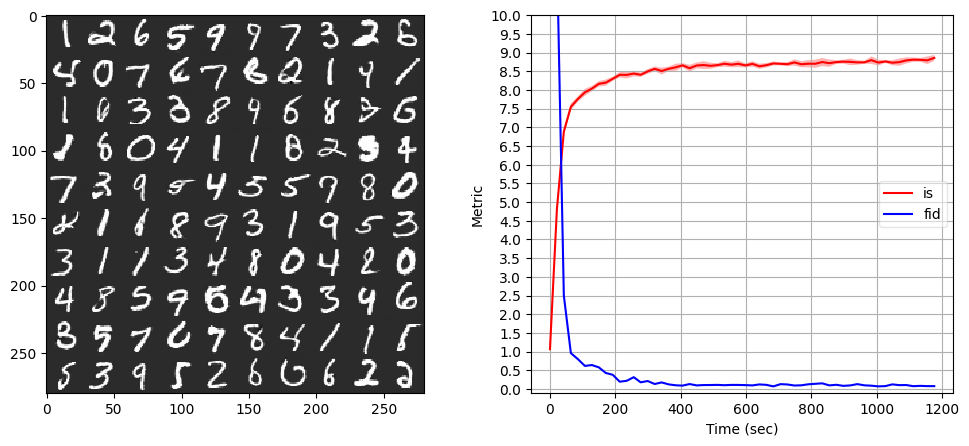

Iter 56000: Mean proba from D(G(z)): 0.1925 +/- 0.1717


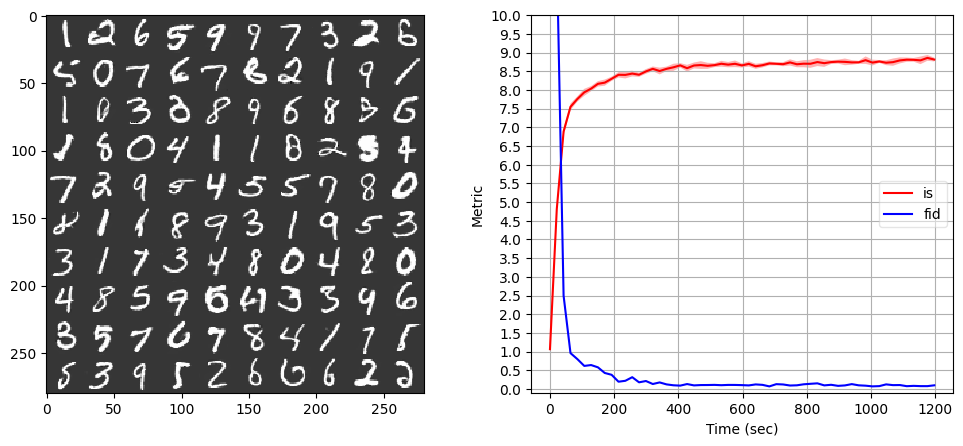

Iter 57000: Mean proba from D(G(z)): 0.3175 +/- 0.2165


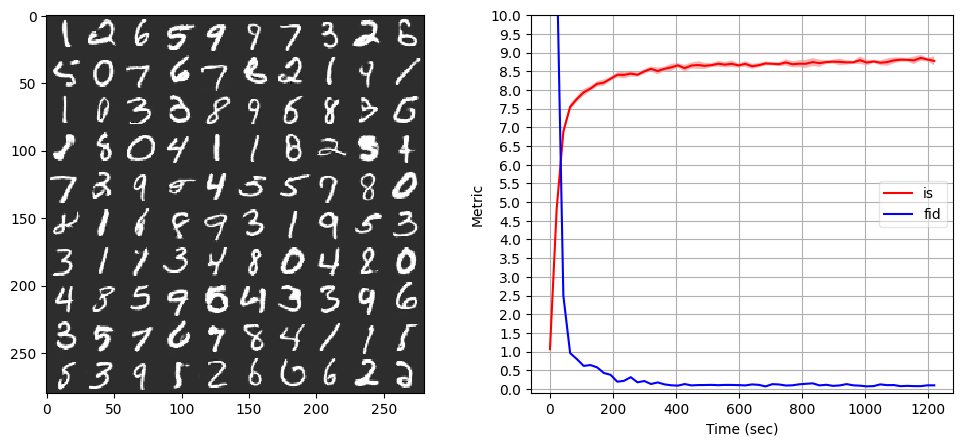

Iter 58000: Mean proba from D(G(z)): 0.3585 +/- 0.2082


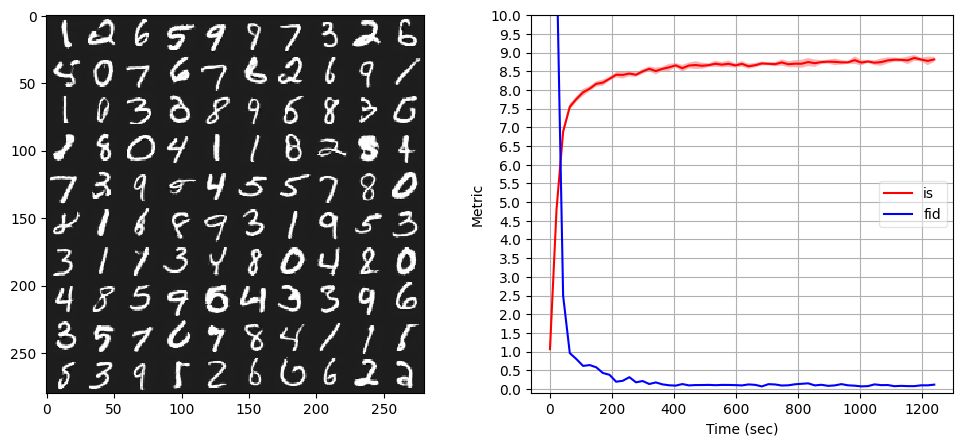

Iter 59000: Mean proba from D(G(z)): 0.3471 +/- 0.2164


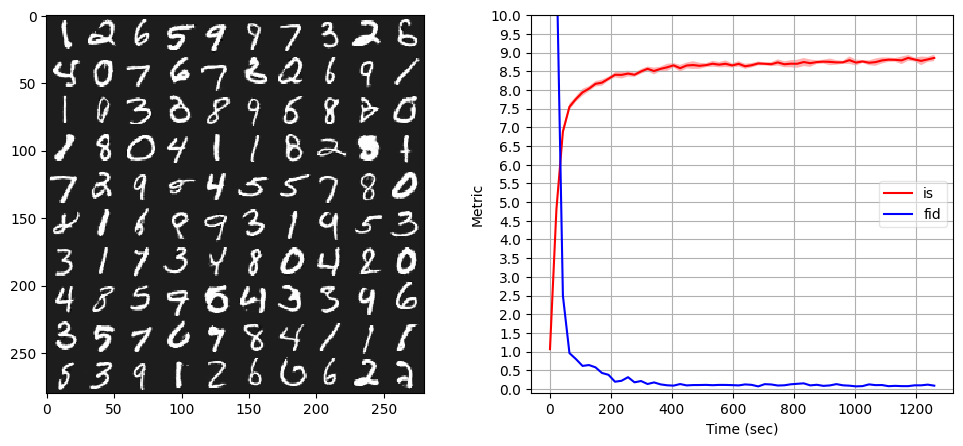

Iter 60000: Mean proba from D(G(z)): 0.2837 +/- 0.1871


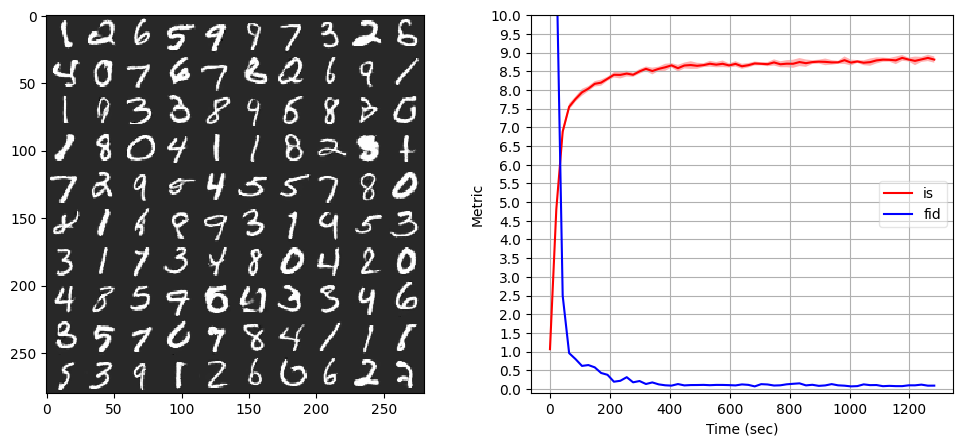

Iter 61000: Mean proba from D(G(z)): 0.1384 +/- 0.1330


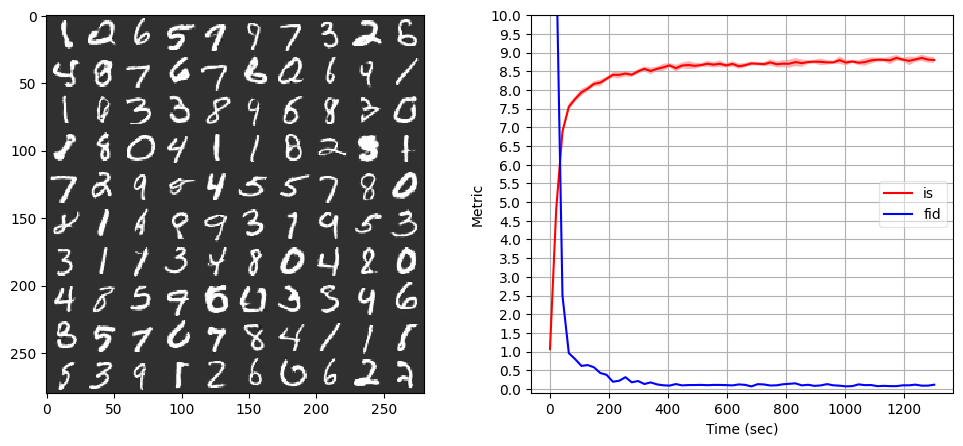

Iter 62000: Mean proba from D(G(z)): 0.2186 +/- 0.1890


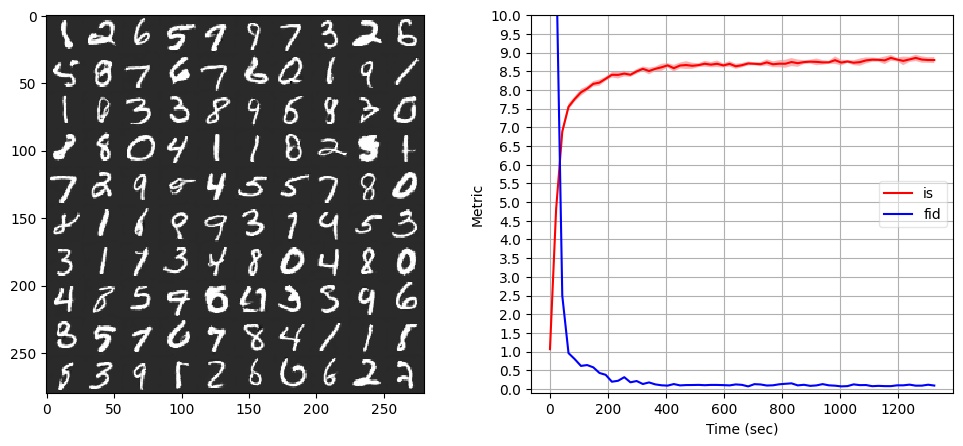

Iter 63000: Mean proba from D(G(z)): 0.5328 +/- 0.2463


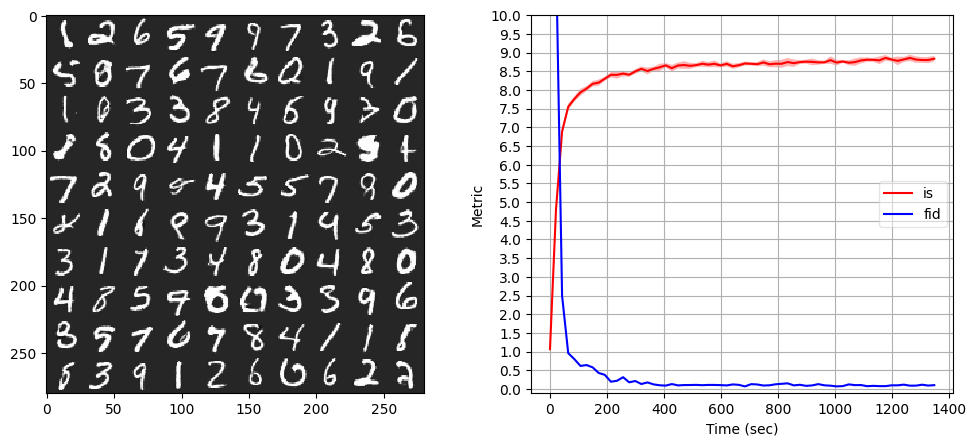

Iter 64000: Mean proba from D(G(z)): 0.4116 +/- 0.2333


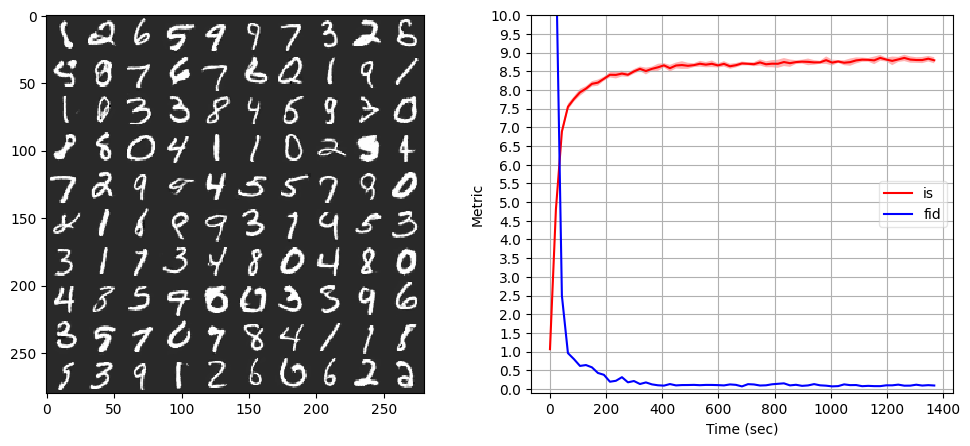

Iter 65000: Mean proba from D(G(z)): 0.2423 +/- 0.1943


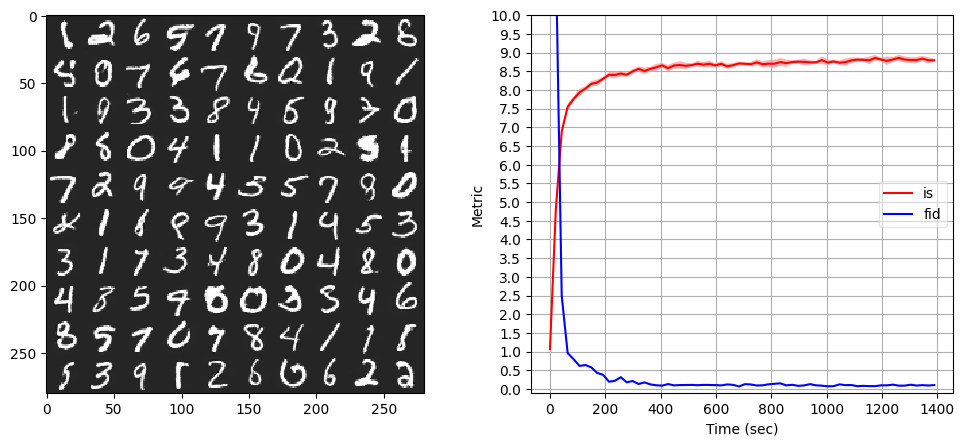

Iter 66000: Mean proba from D(G(z)): 0.2232 +/- 0.2086


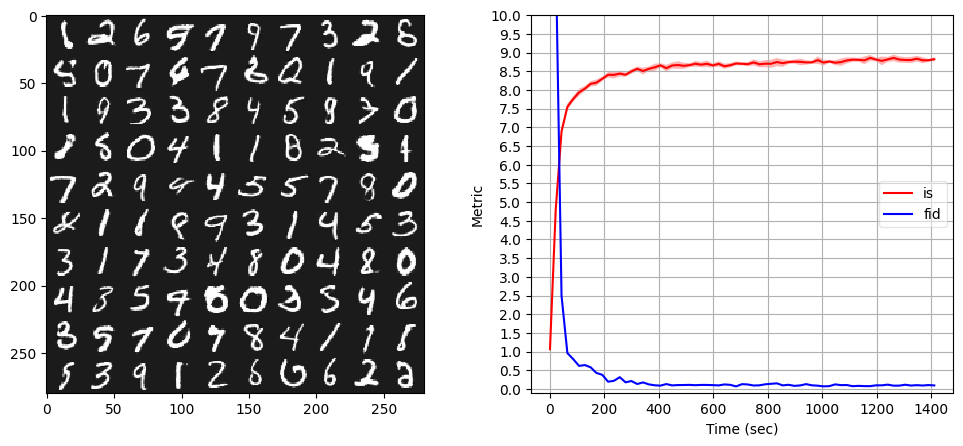

Iter 67000: Mean proba from D(G(z)): 0.3384 +/- 0.2456


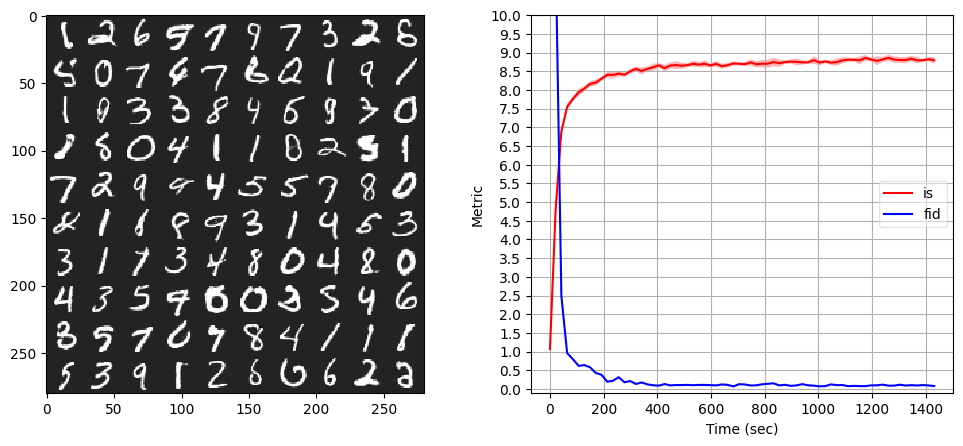

Iter 68000: Mean proba from D(G(z)): 0.3557 +/- 0.2486


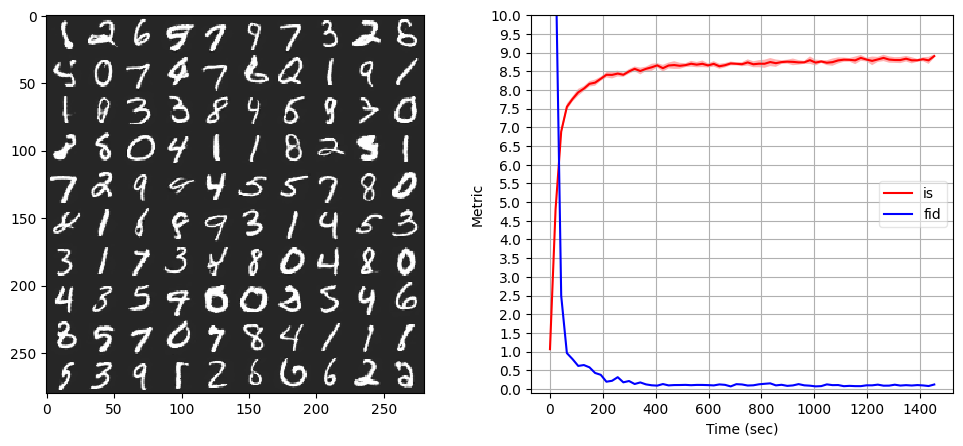

Iter 69000: Mean proba from D(G(z)): 0.2274 +/- 0.2077


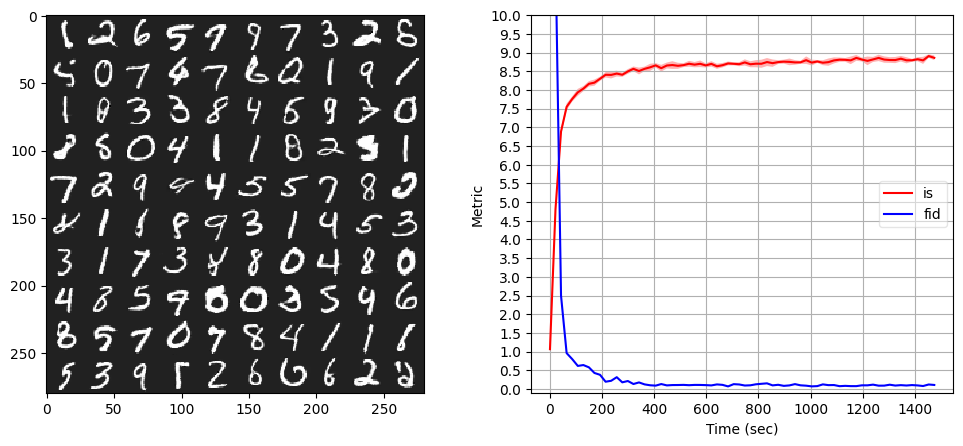

Iter 70000: Mean proba from D(G(z)): 0.2074 +/- 0.1912


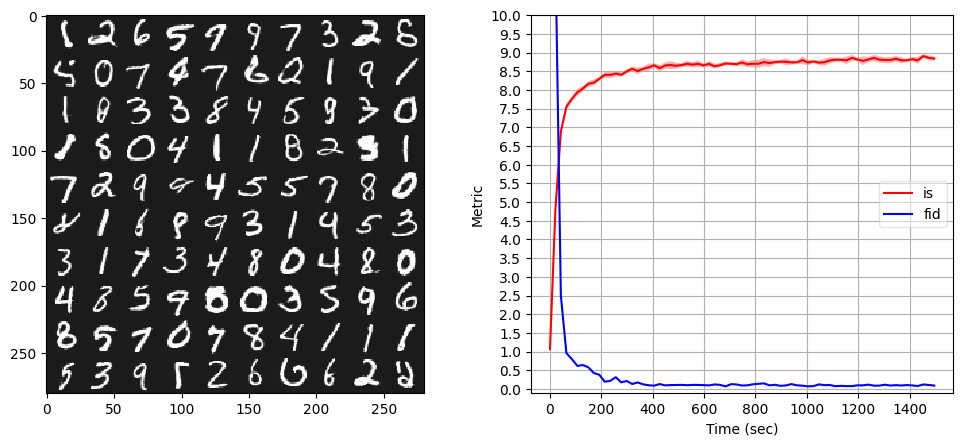

Iter 71000: Mean proba from D(G(z)): 0.2197 +/- 0.1787


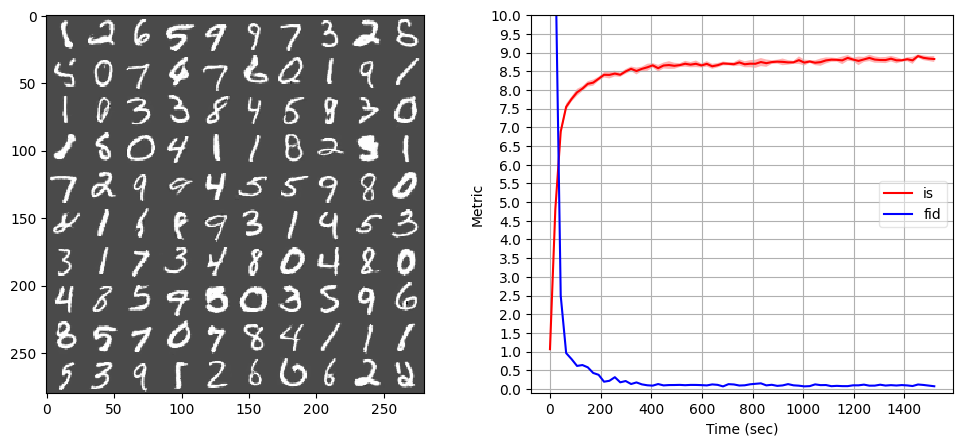

Iter 72000: Mean proba from D(G(z)): 0.1594 +/- 0.1628


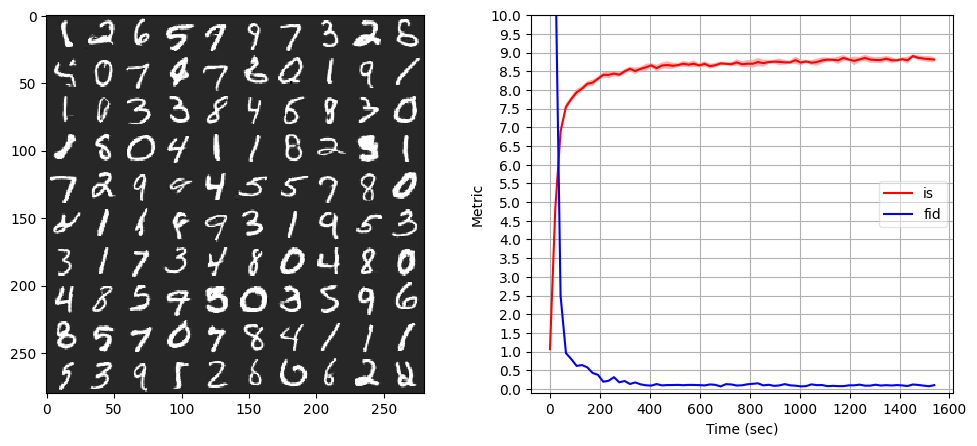

Iter 73000: Mean proba from D(G(z)): 0.2551 +/- 0.1999


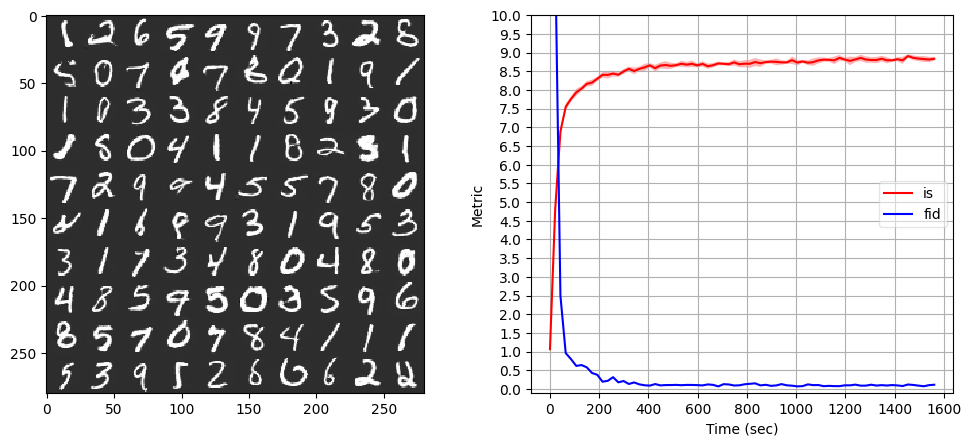

Iter 74000: Mean proba from D(G(z)): 0.5126 +/- 0.2715


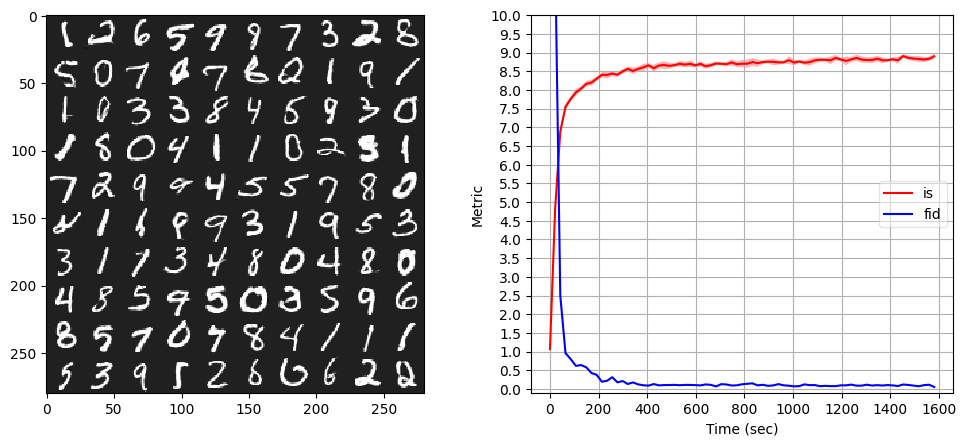

Iter 75000: Mean proba from D(G(z)): 0.3054 +/- 0.2079


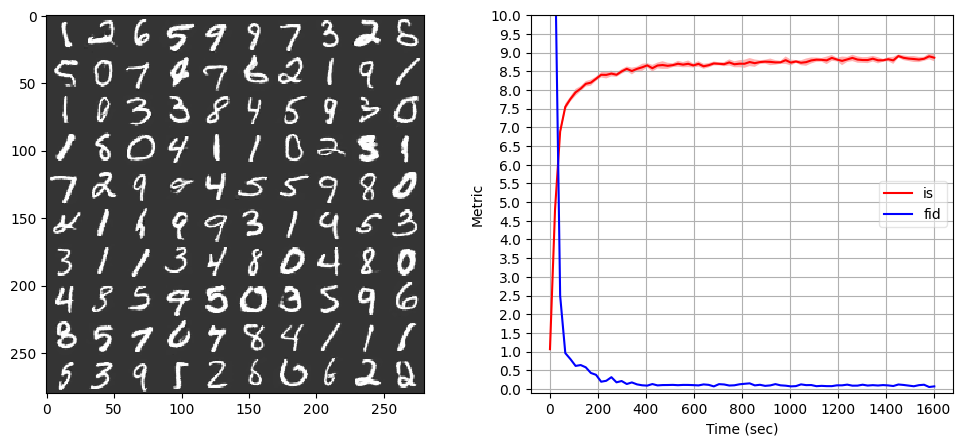

Iter 76000: Mean proba from D(G(z)): 0.2862 +/- 0.2086


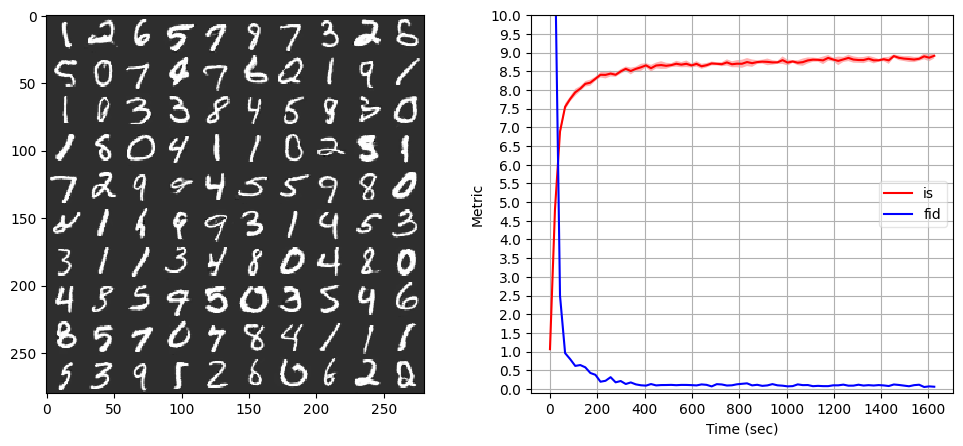

Iter 77000: Mean proba from D(G(z)): 0.4349 +/- 0.2329


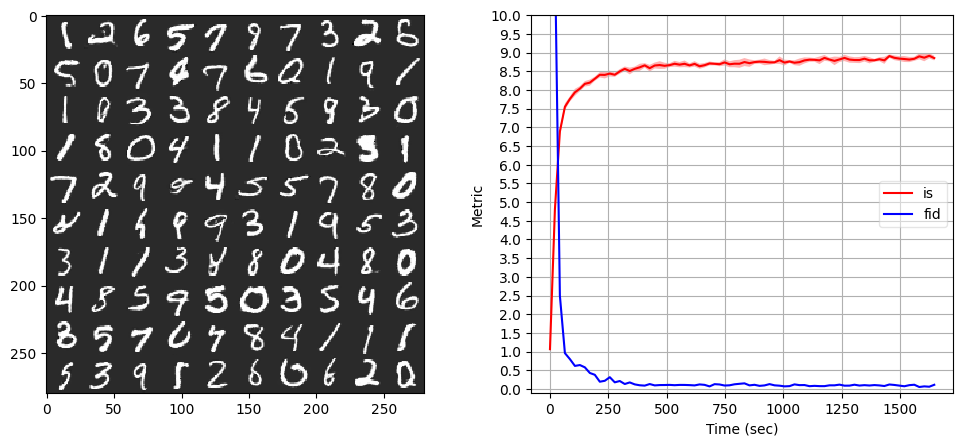

Iter 78000: Mean proba from D(G(z)): 0.3599 +/- 0.2187


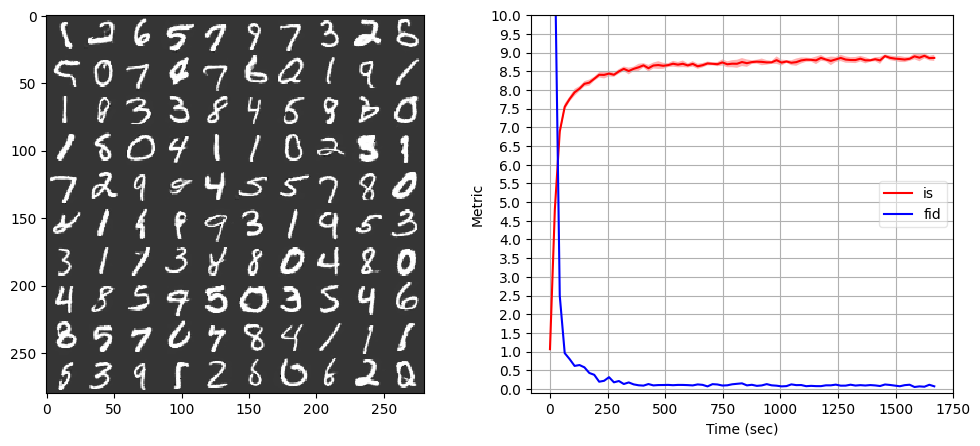

Iter 79000: Mean proba from D(G(z)): 0.3308 +/- 0.2089


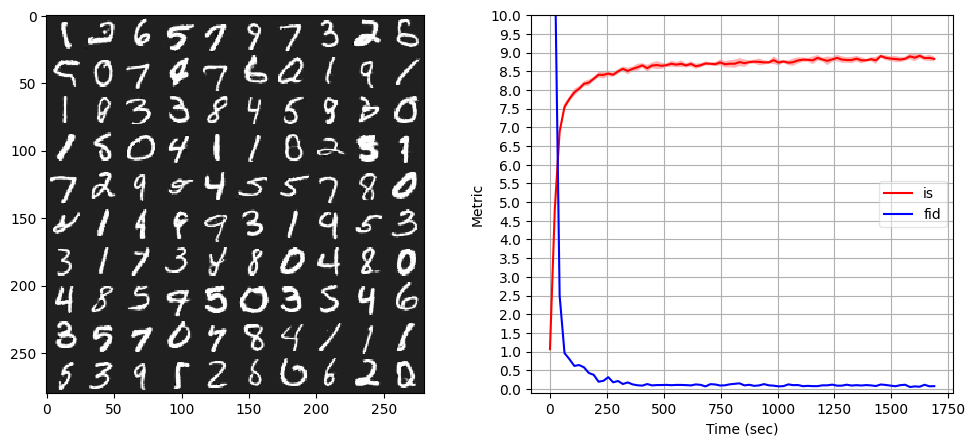

Iter 80000: Mean proba from D(G(z)): 0.3157 +/- 0.2155


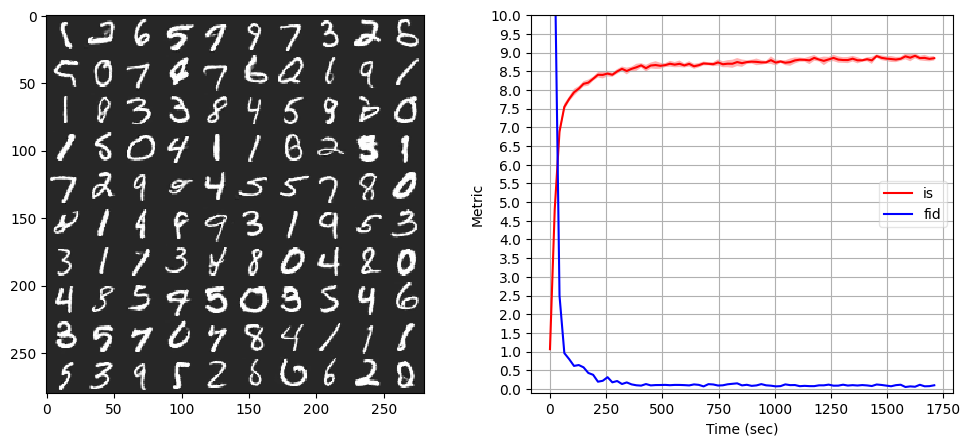

Iter 81000: Mean proba from D(G(z)): 0.4046 +/- 0.2209


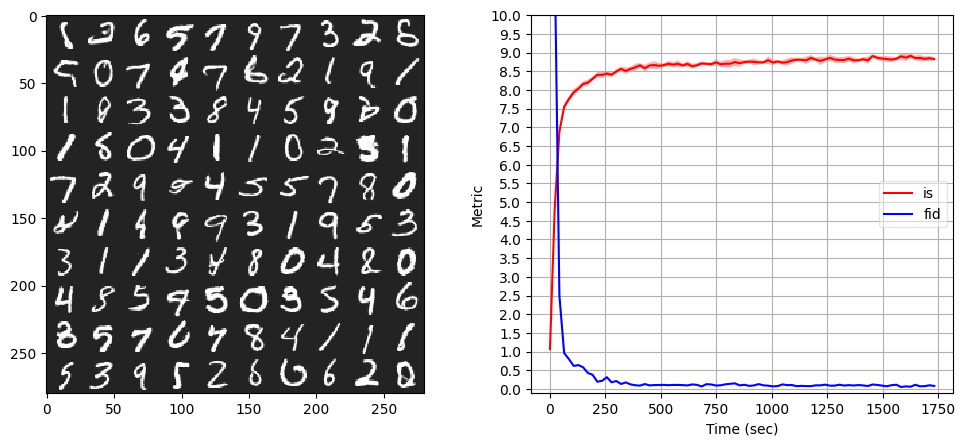

Iter 82000: Mean proba from D(G(z)): 0.3624 +/- 0.2091


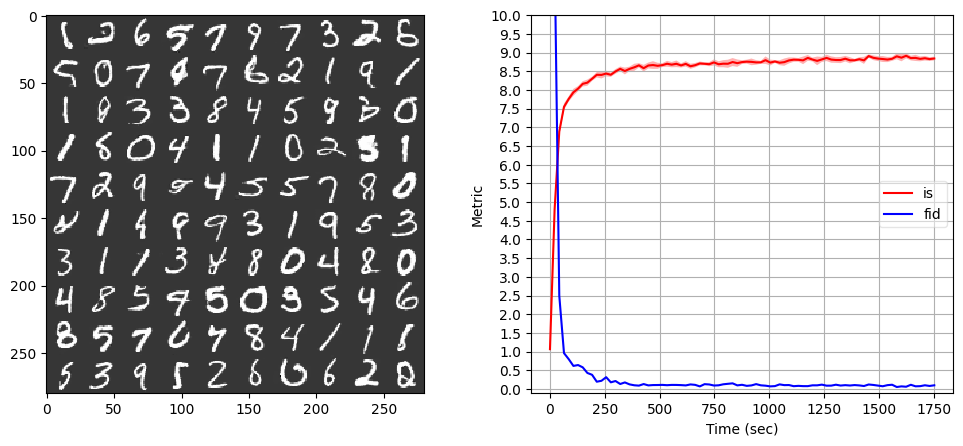

Iter 83000: Mean proba from D(G(z)): 0.2807 +/- 0.1984


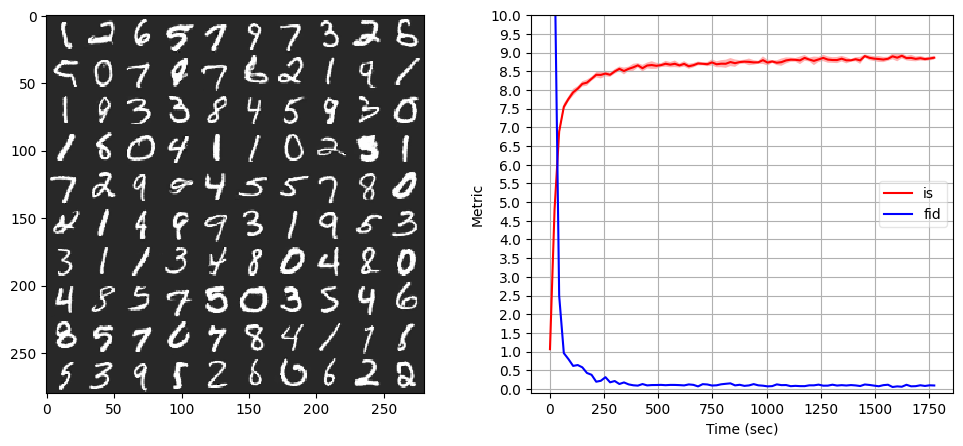

Iter 84000: Mean proba from D(G(z)): 0.3070 +/- 0.2036


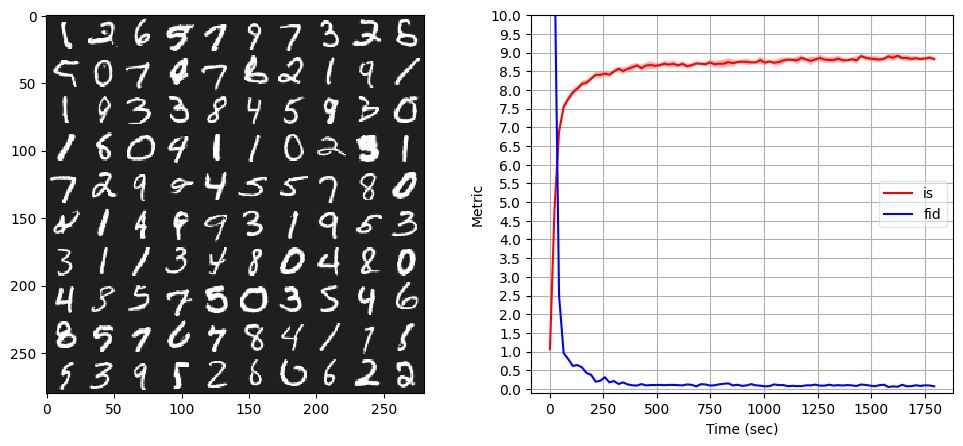

Iter 85000: Mean proba from D(G(z)): 0.2079 +/- 0.1726


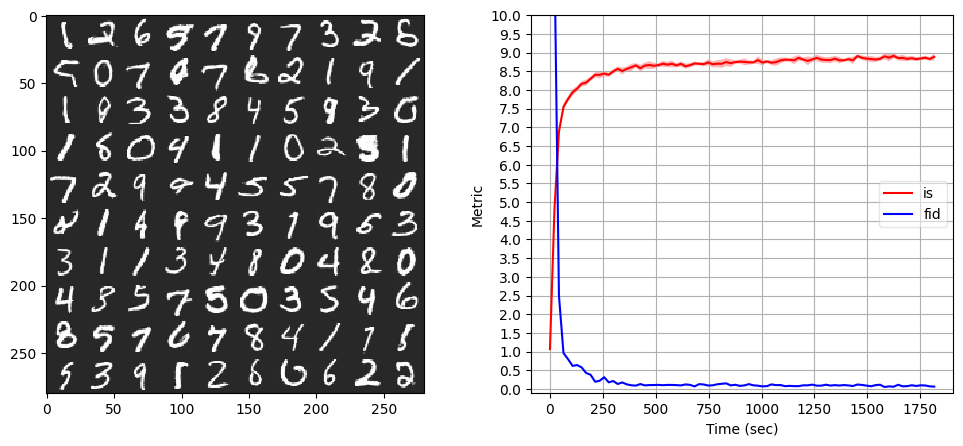

Iter 86000: Mean proba from D(G(z)): 0.1336 +/- 0.1616


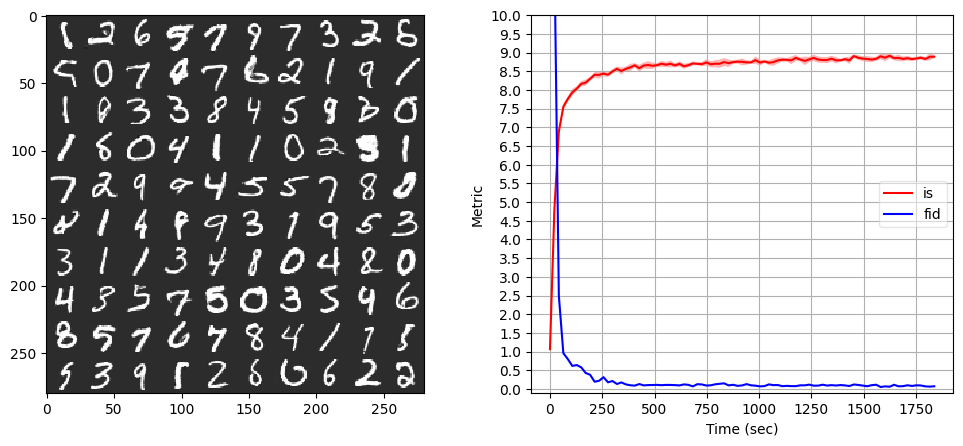

Iter 87000: Mean proba from D(G(z)): 0.0995 +/- 0.1122


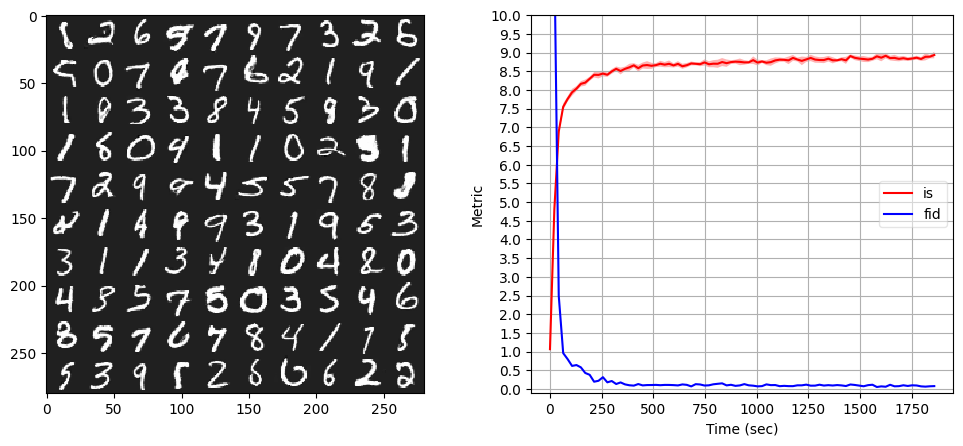

Iter 88000: Mean proba from D(G(z)): 0.1270 +/- 0.1142


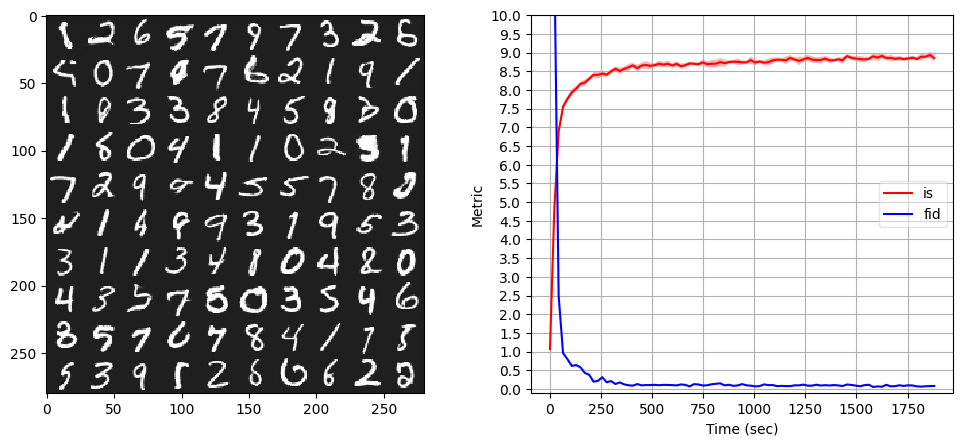

Iter 89000: Mean proba from D(G(z)): 0.3886 +/- 0.2560


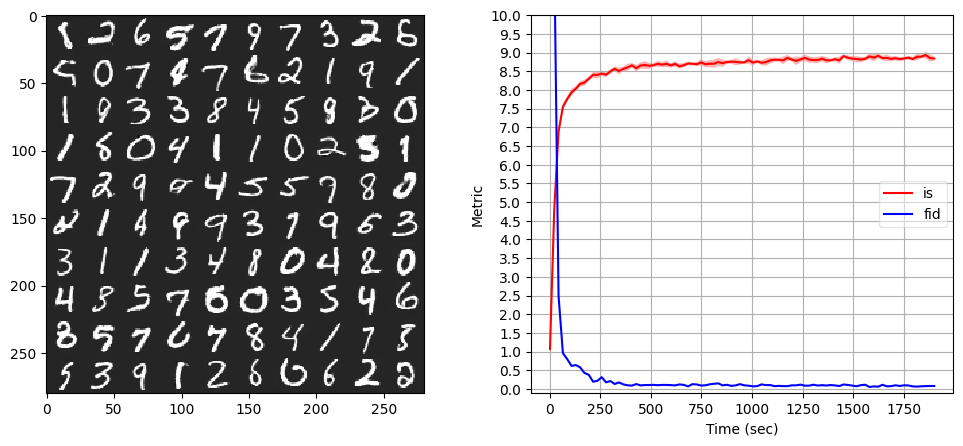

Iter 90000: Mean proba from D(G(z)): 0.4485 +/- 0.2318


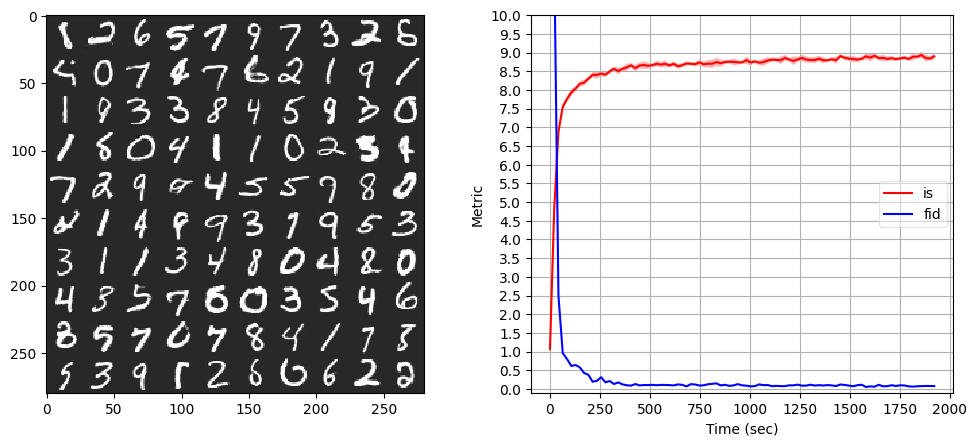

Iter 91000: Mean proba from D(G(z)): 0.4542 +/- 0.2517


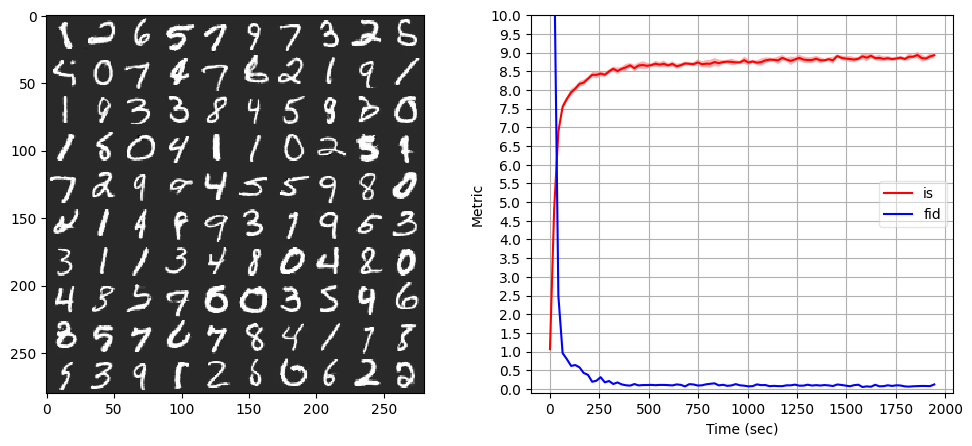

Iter 92000: Mean proba from D(G(z)): 0.3732 +/- 0.2409


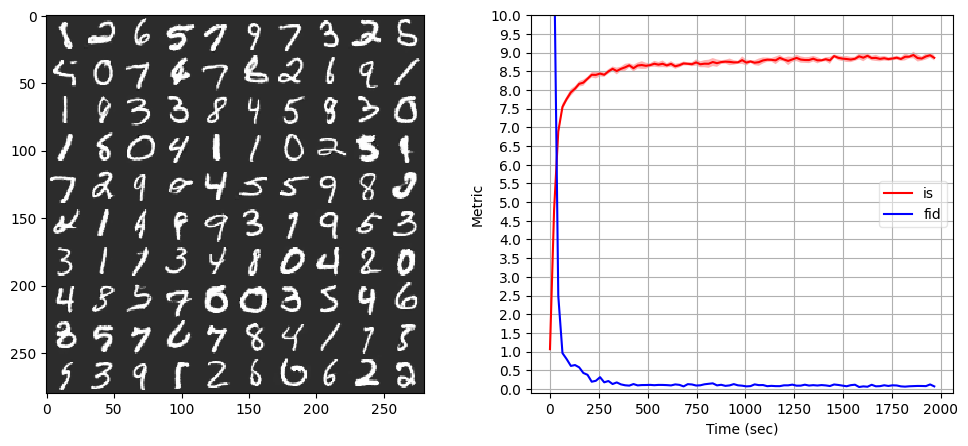

Iter 93000: Mean proba from D(G(z)): 0.2773 +/- 0.1984


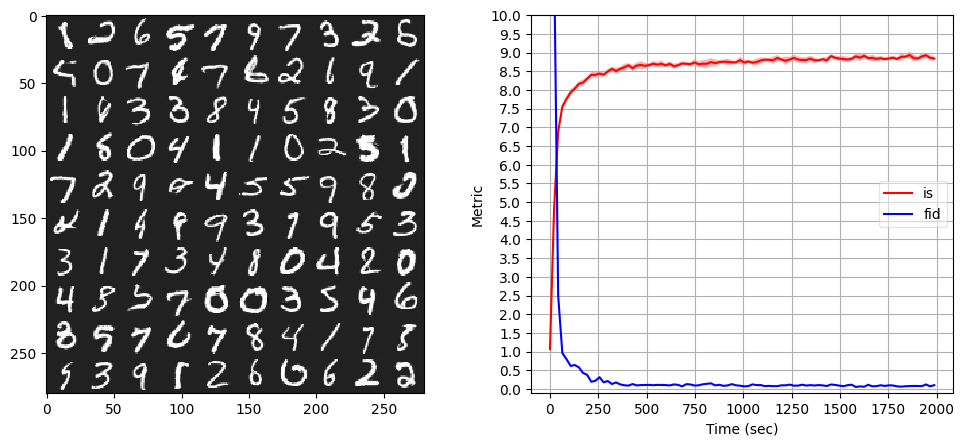

Iter 94000: Mean proba from D(G(z)): 0.1927 +/- 0.1984


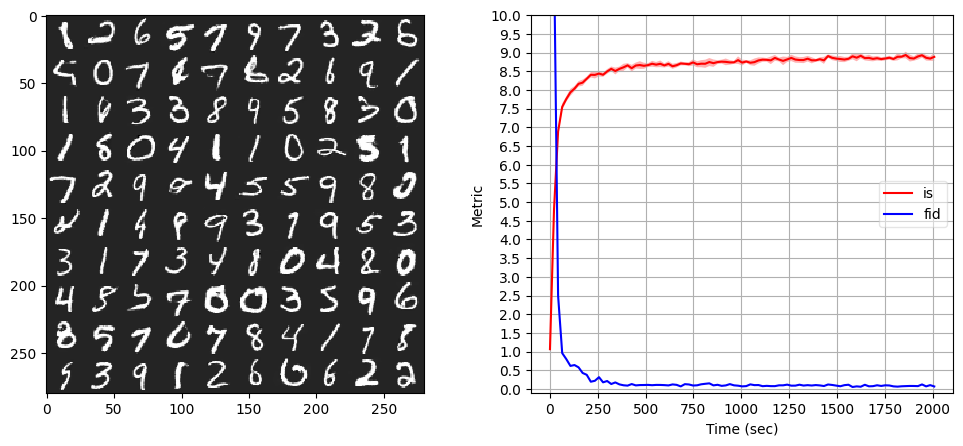

Iter 95000: Mean proba from D(G(z)): 0.1580 +/- 0.1683


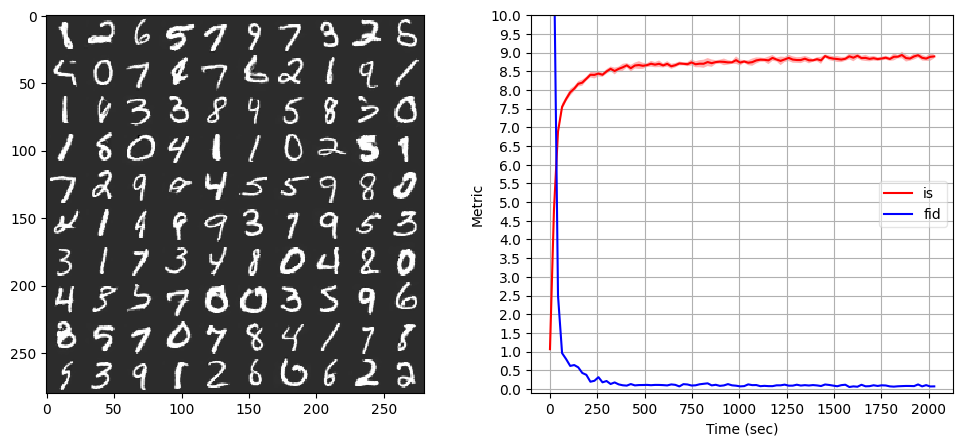

Iter 96000: Mean proba from D(G(z)): 0.2767 +/- 0.2029


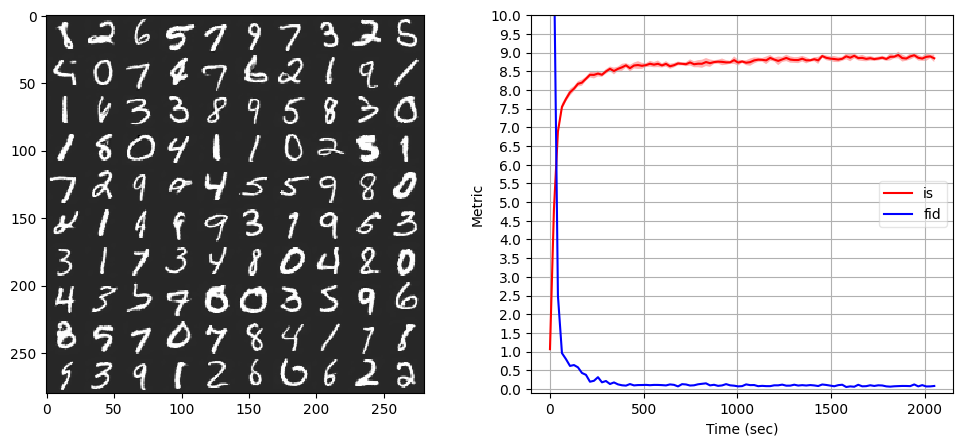

Iter 97000: Mean proba from D(G(z)): 0.1417 +/- 0.1560


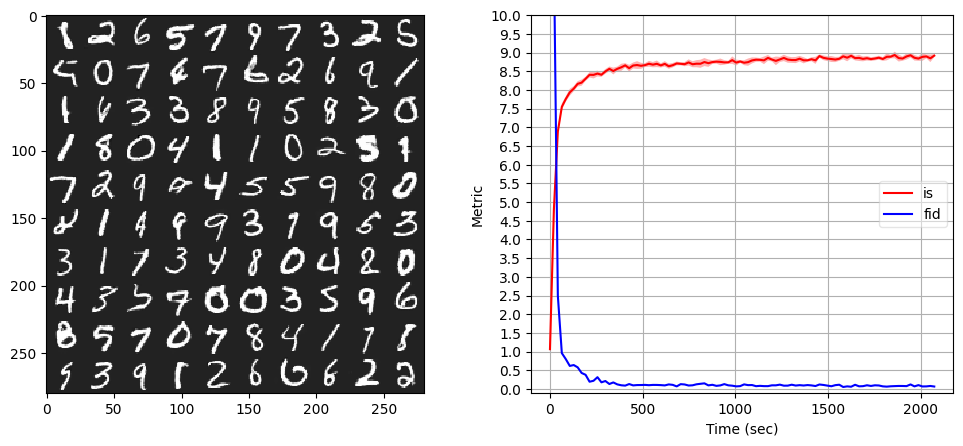

Iter 98000: Mean proba from D(G(z)): 0.1274 +/- 0.1289


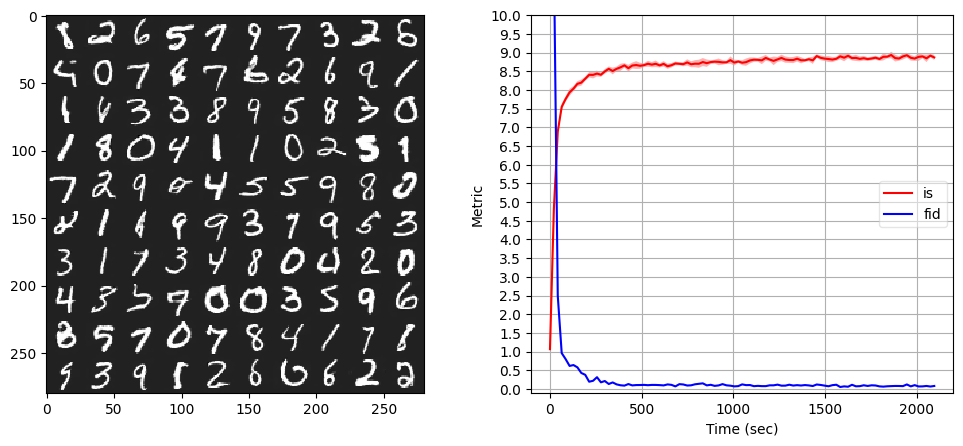

Iter 99000: Mean proba from D(G(z)): 0.1626 +/- 0.1658


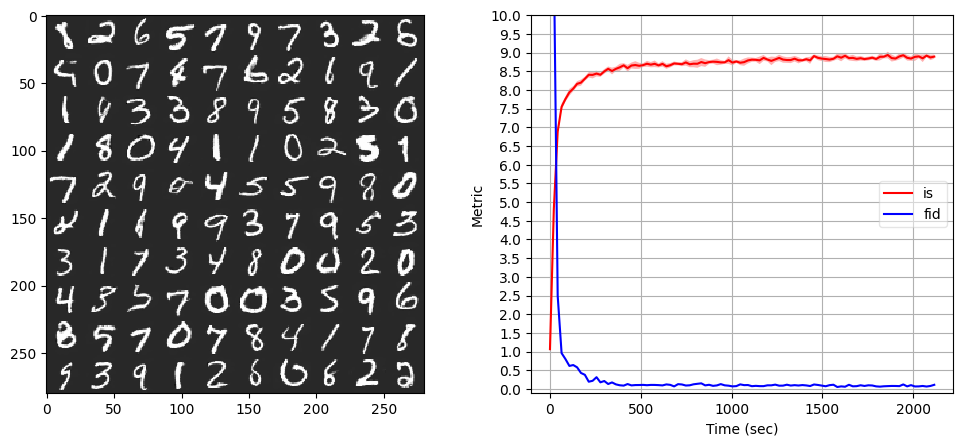

Iter 99999: Mean proba from D(G(z)): 0.2086 +/- 0.2150


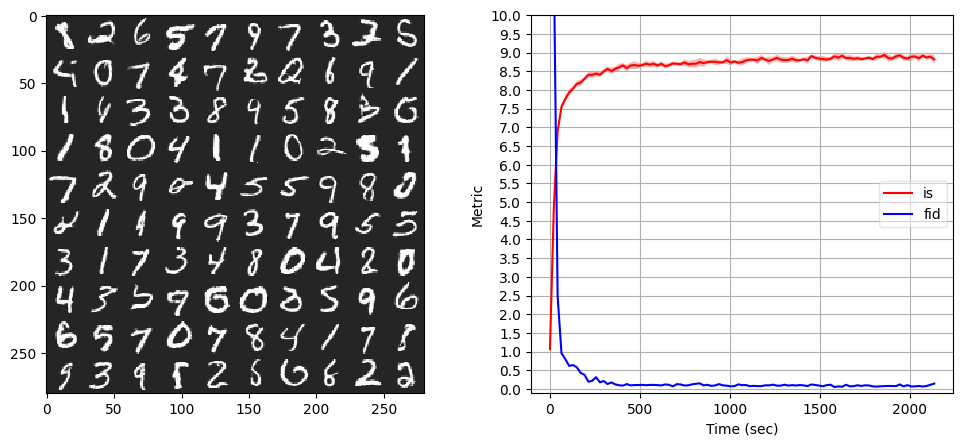

Loading trained model from ./drive/My Drive/Data/models/mnist.pth
in init of lookahead
in init of lookahead
Iter 0: Mean proba from D(G(z)): 0.9971 +/- 0.0010


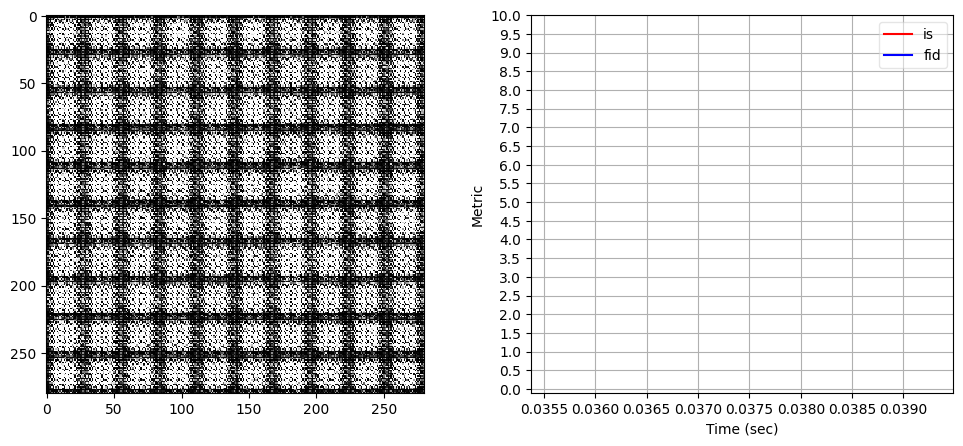

Iter 1000: Mean proba from D(G(z)): 0.0002 +/- 0.0001


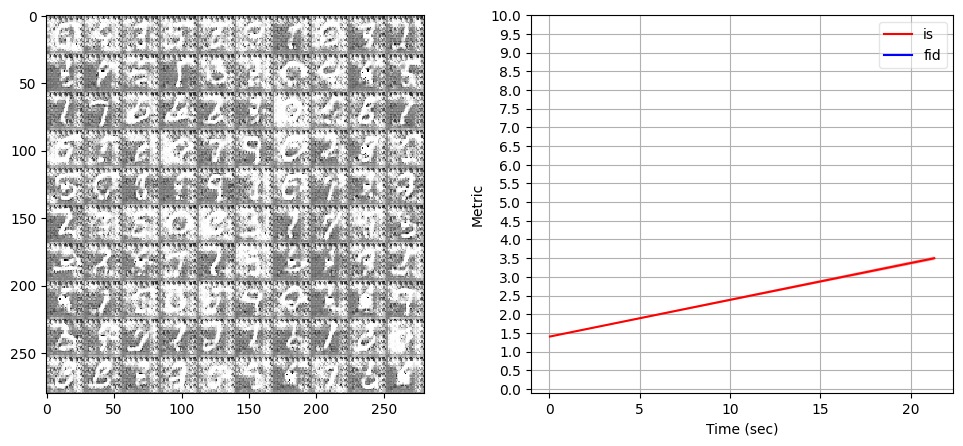

Iter 2000: Mean proba from D(G(z)): 0.0000 +/- 0.0001


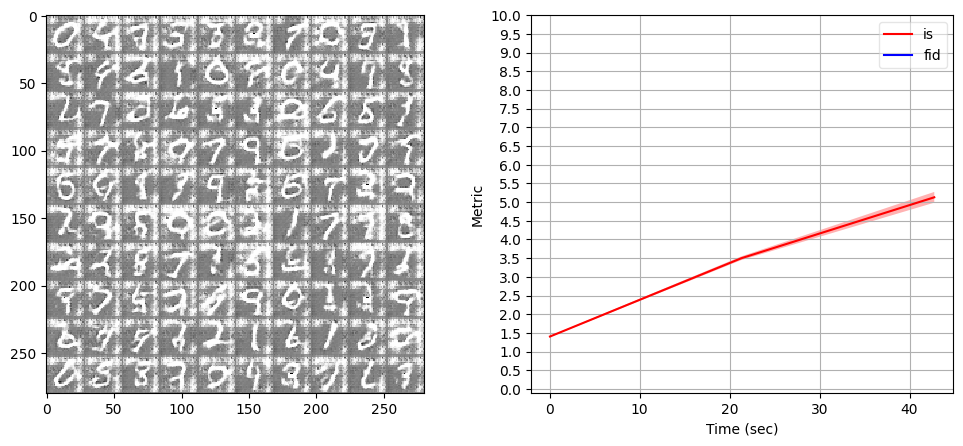

Iter 3000: Mean proba from D(G(z)): 0.3959 +/- 0.1733


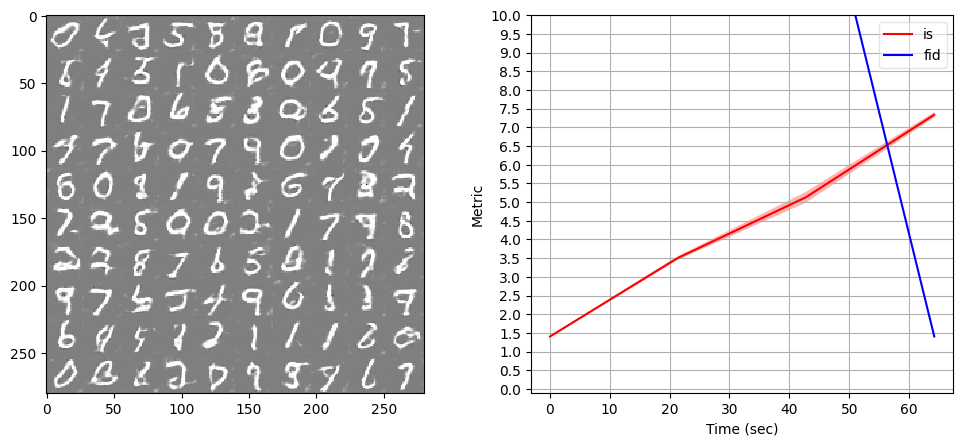

Iter 4000: Mean proba from D(G(z)): 0.4425 +/- 0.1635


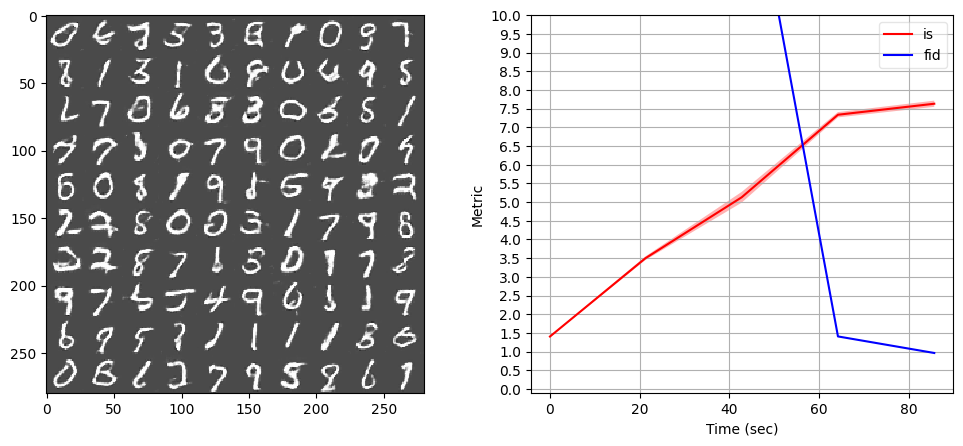

Iter 5000: Mean proba from D(G(z)): 0.5059 +/- 0.1885


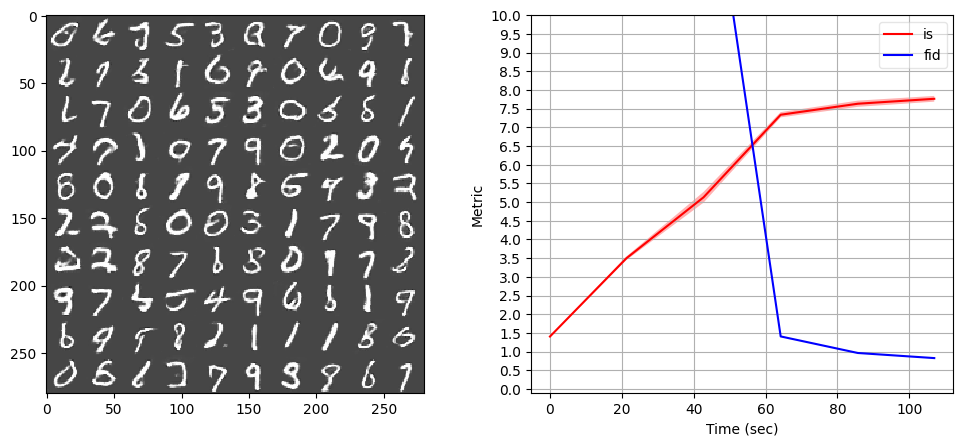

Iter 6000: Mean proba from D(G(z)): 0.3129 +/- 0.1613


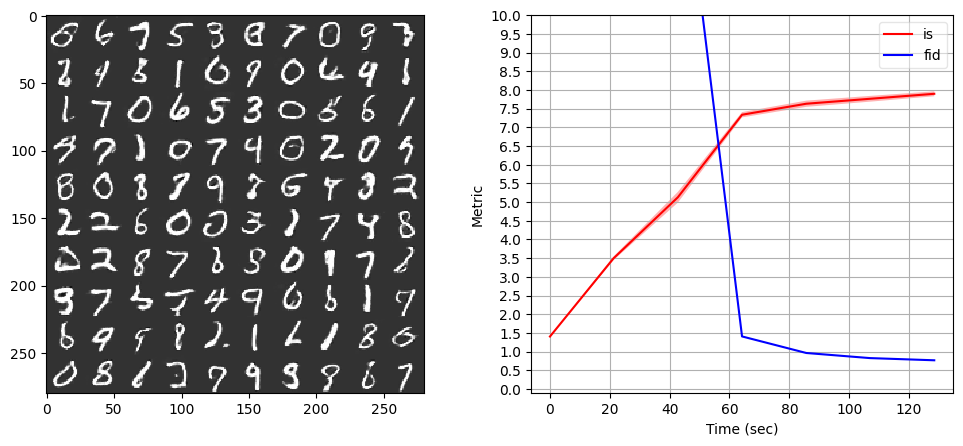

Iter 7000: Mean proba from D(G(z)): 0.2924 +/- 0.1557


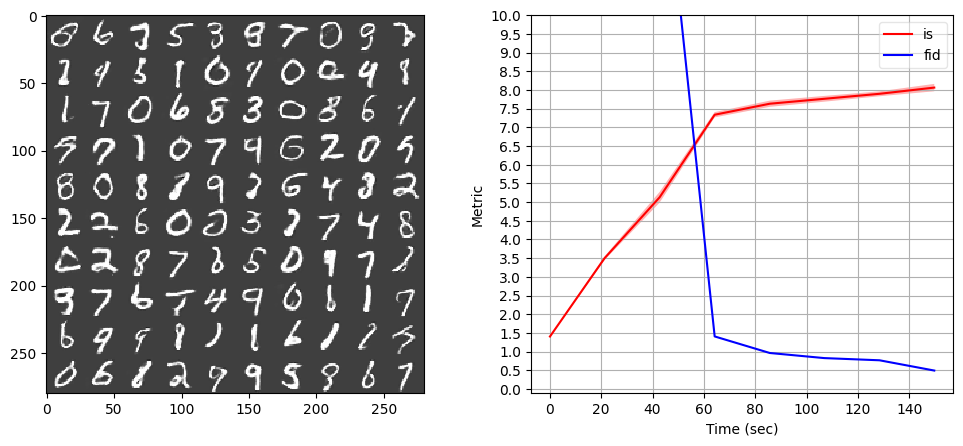

Iter 8000: Mean proba from D(G(z)): 0.4039 +/- 0.1735


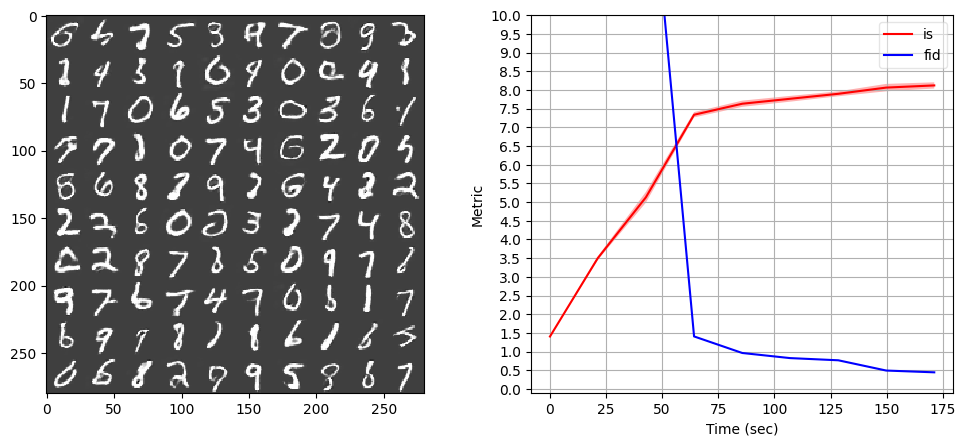

Iter 9000: Mean proba from D(G(z)): 0.5982 +/- 0.1757


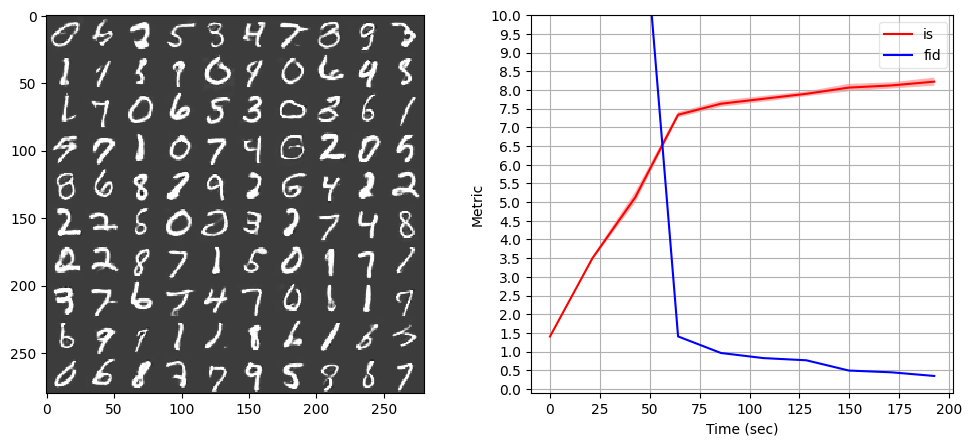

Iter 10000: Mean proba from D(G(z)): 0.5280 +/- 0.1989


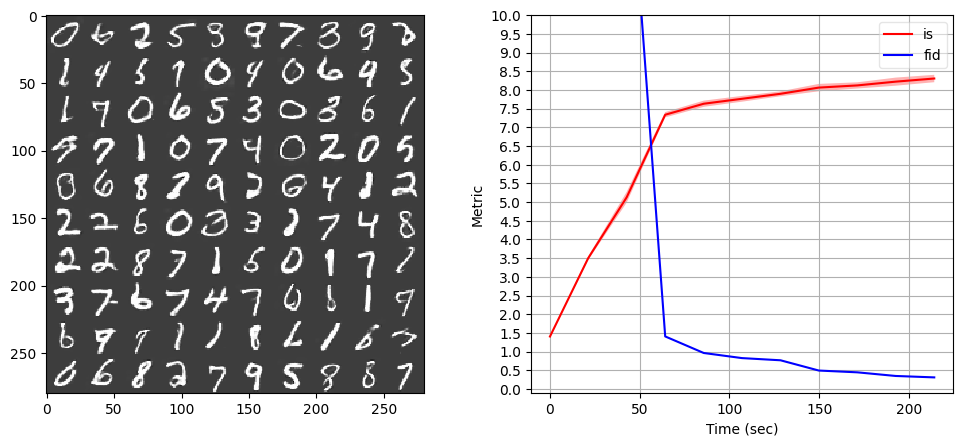

Iter 11000: Mean proba from D(G(z)): 0.7293 +/- 0.1829


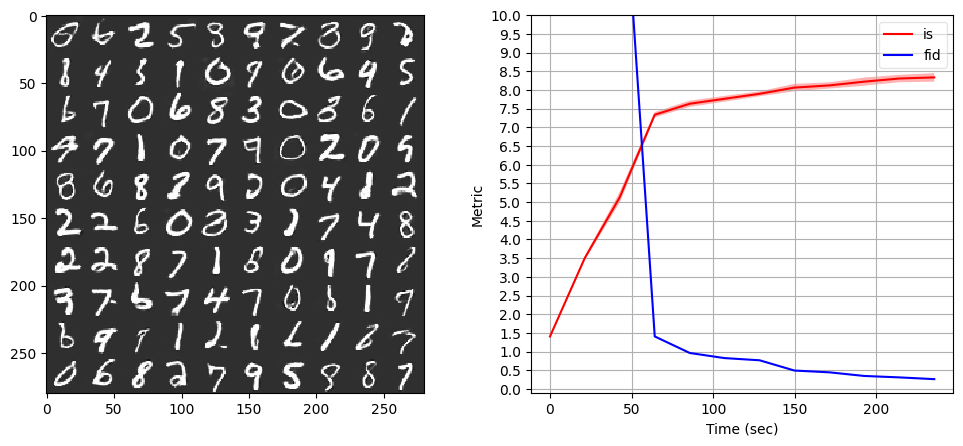

Iter 12000: Mean proba from D(G(z)): 0.4266 +/- 0.1624


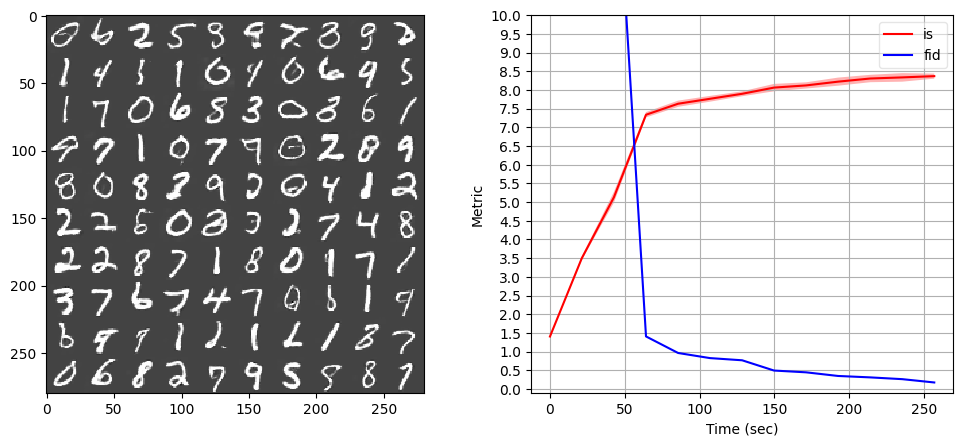

Iter 13000: Mean proba from D(G(z)): 0.3451 +/- 0.1685


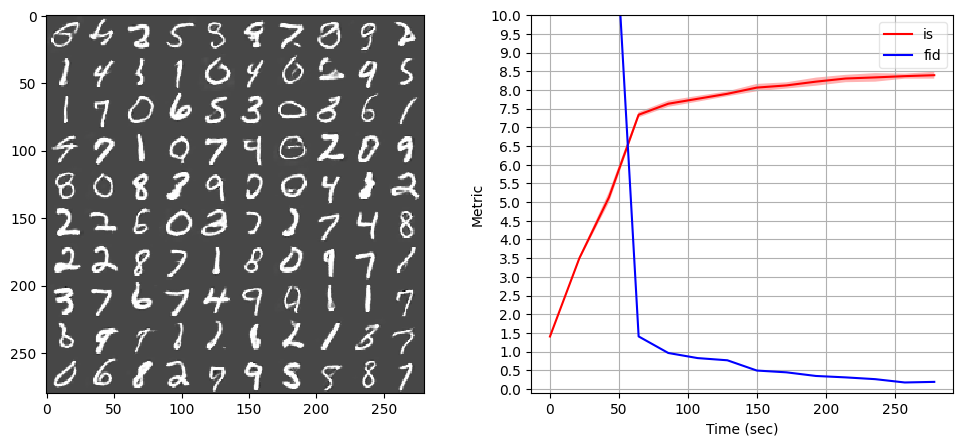

Iter 14000: Mean proba from D(G(z)): 0.3973 +/- 0.1865


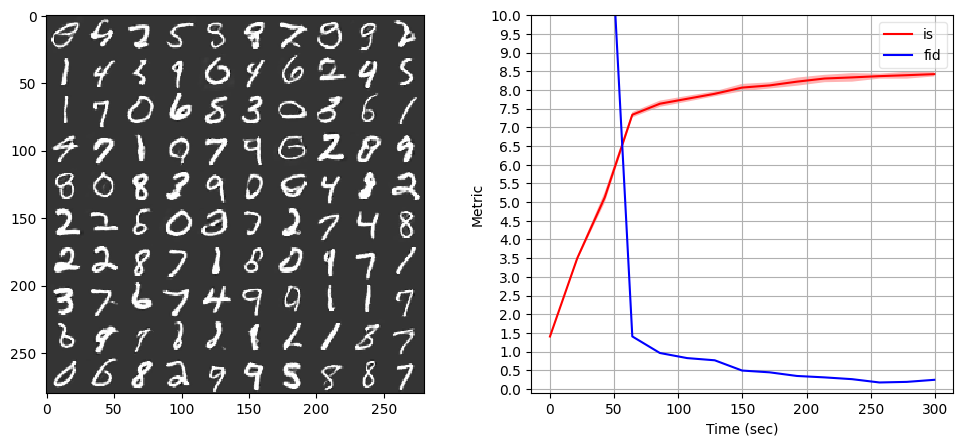

Iter 15000: Mean proba from D(G(z)): 0.2705 +/- 0.1540


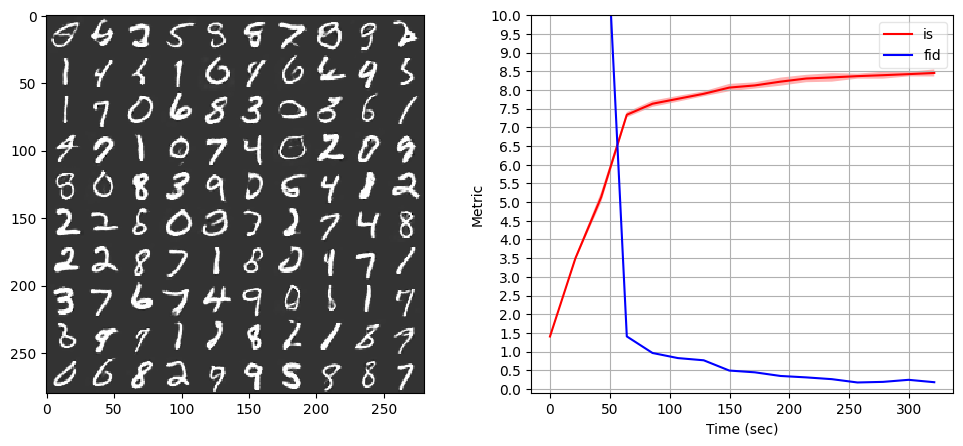

Iter 16000: Mean proba from D(G(z)): 0.2904 +/- 0.1865


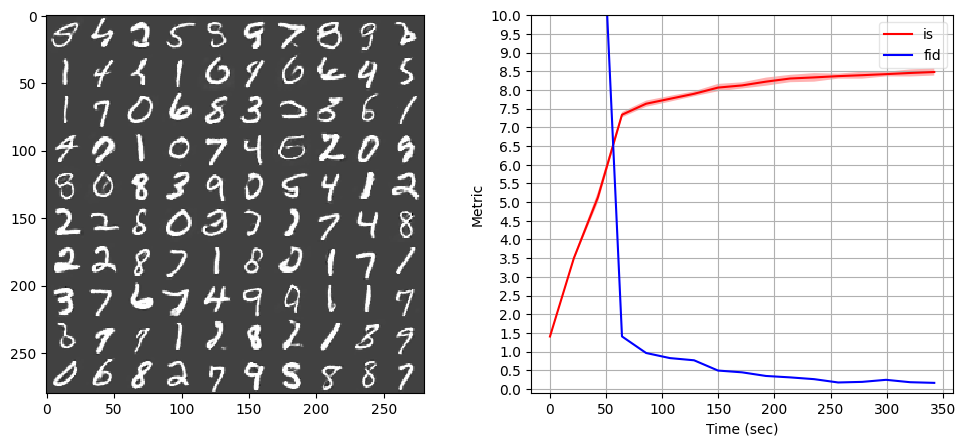

Iter 17000: Mean proba from D(G(z)): 0.5590 +/- 0.1934


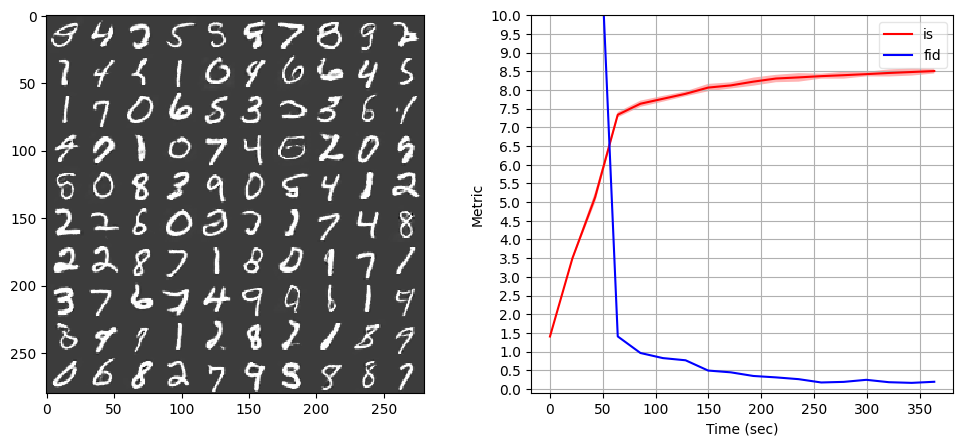

Iter 18000: Mean proba from D(G(z)): 0.5730 +/- 0.2115


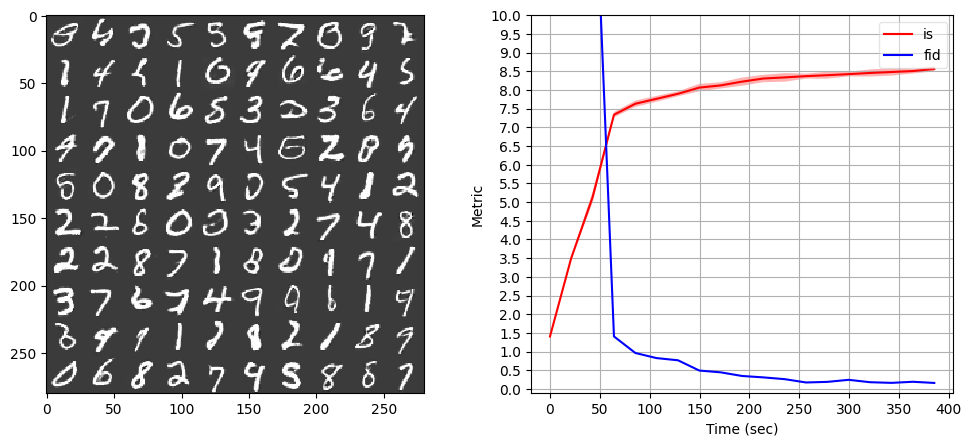

Iter 19000: Mean proba from D(G(z)): 0.5351 +/- 0.2173


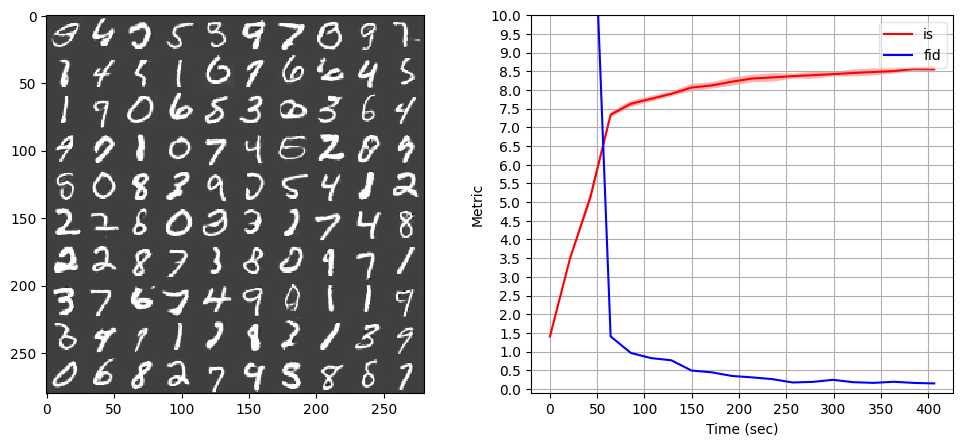

Iter 20000: Mean proba from D(G(z)): 0.3026 +/- 0.1520


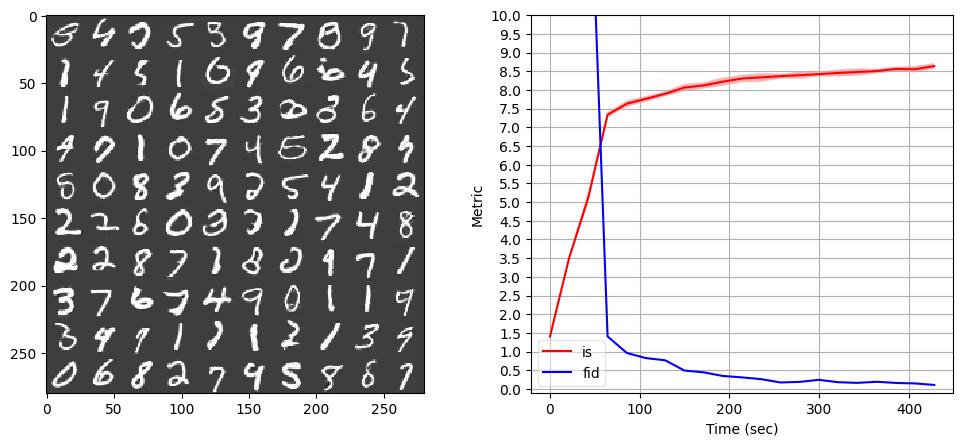

Iter 21000: Mean proba from D(G(z)): 0.3048 +/- 0.1662


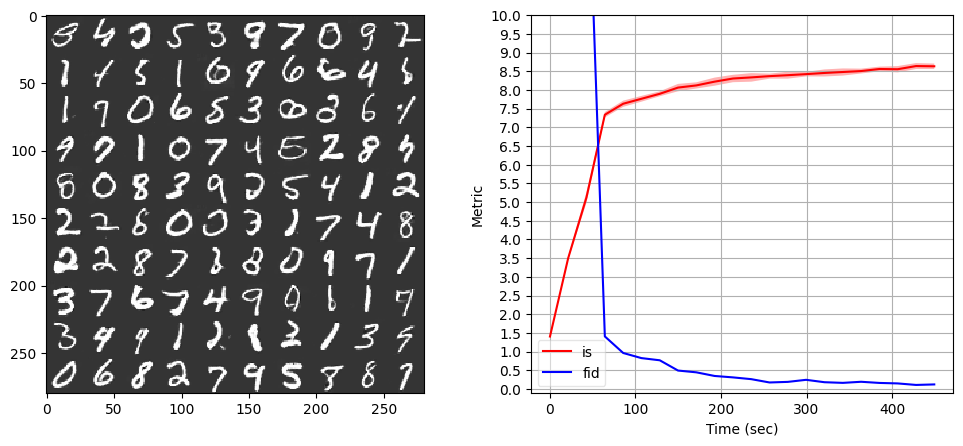

Iter 22000: Mean proba from D(G(z)): 0.5475 +/- 0.2251


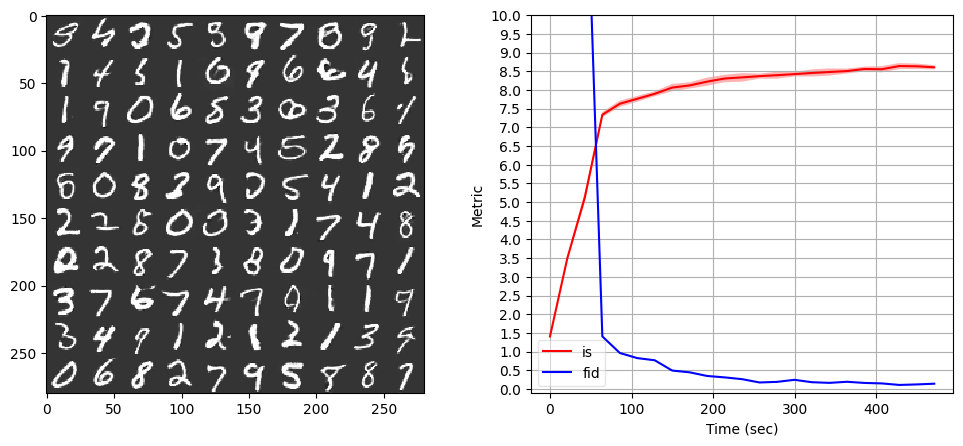

Iter 23000: Mean proba from D(G(z)): 0.4392 +/- 0.1988


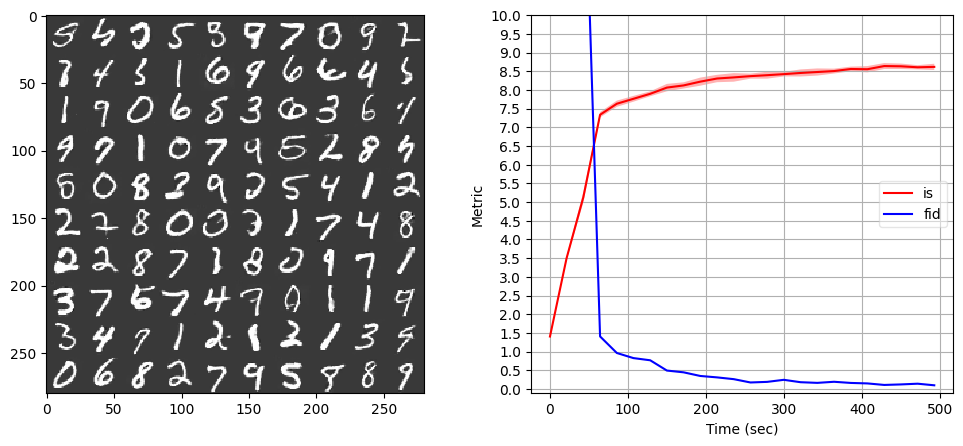

Iter 24000: Mean proba from D(G(z)): 0.3645 +/- 0.1917


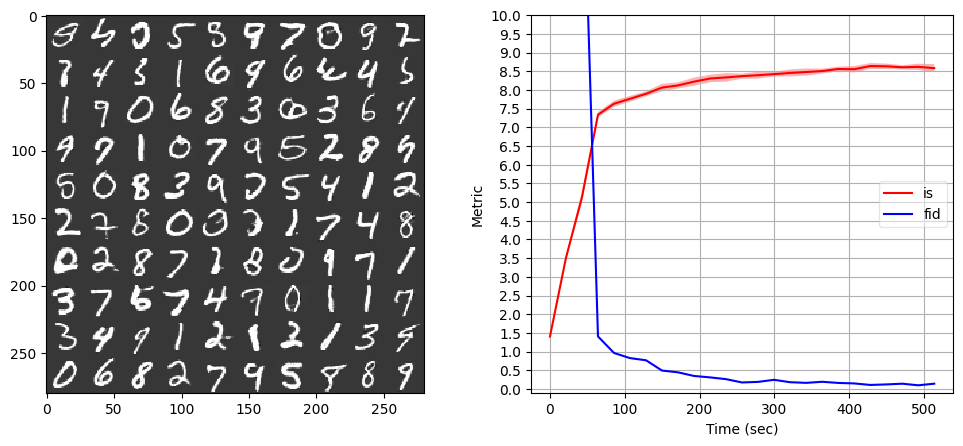

Iter 25000: Mean proba from D(G(z)): 0.3696 +/- 0.1876


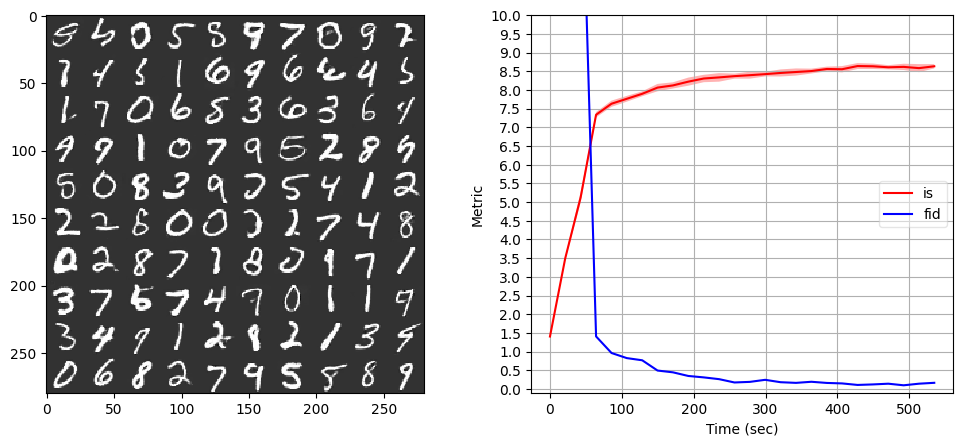

Iter 26000: Mean proba from D(G(z)): 0.3602 +/- 0.1895


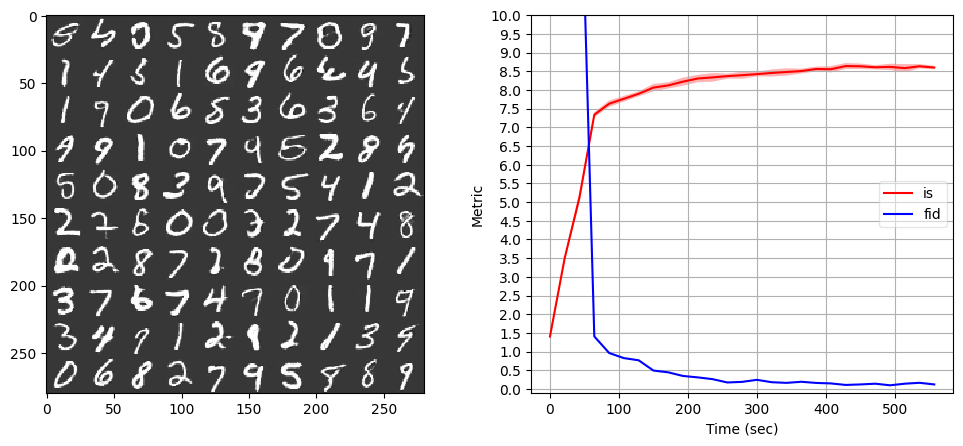

Iter 27000: Mean proba from D(G(z)): 0.5150 +/- 0.2071


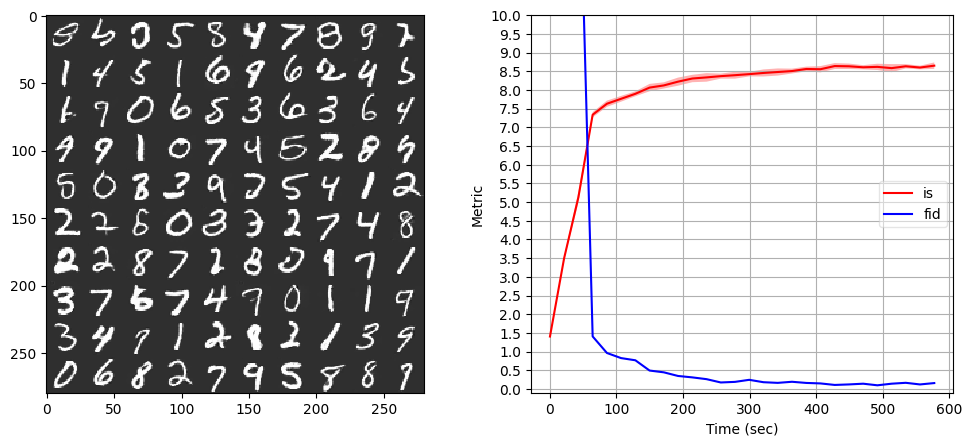

Iter 28000: Mean proba from D(G(z)): 0.4007 +/- 0.1937


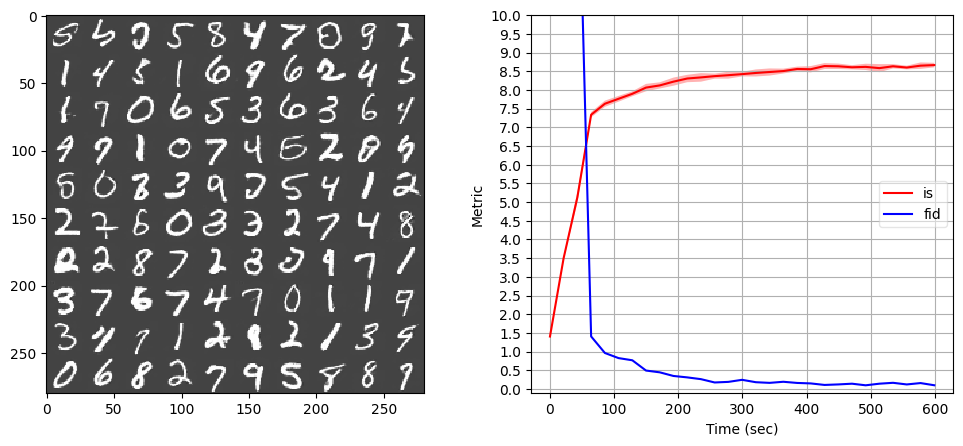

Iter 29000: Mean proba from D(G(z)): 0.2208 +/- 0.1516


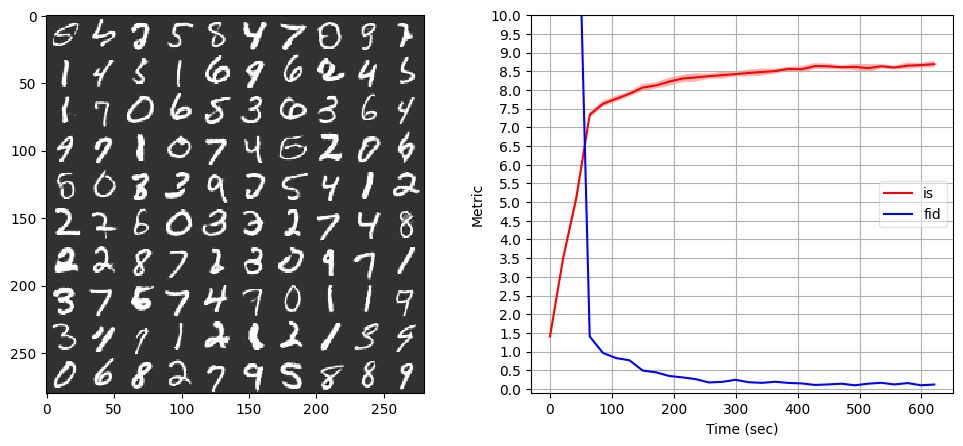

Iter 30000: Mean proba from D(G(z)): 0.6012 +/- 0.2035


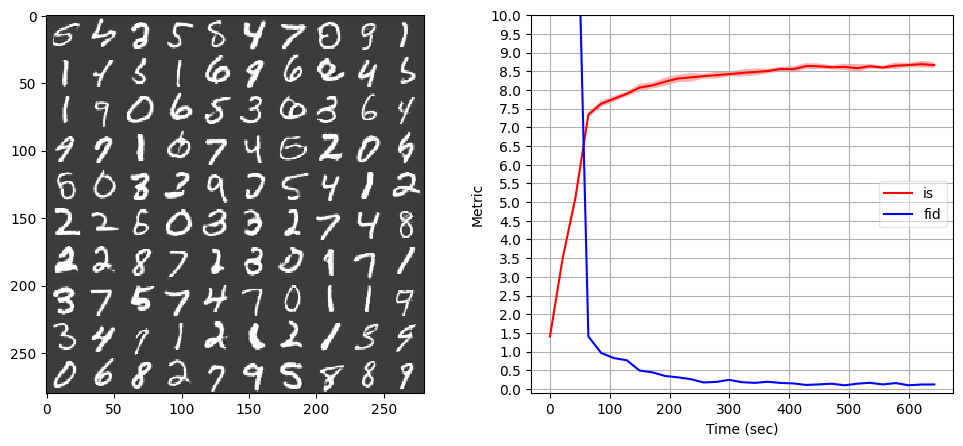

Iter 31000: Mean proba from D(G(z)): 0.6898 +/- 0.1785


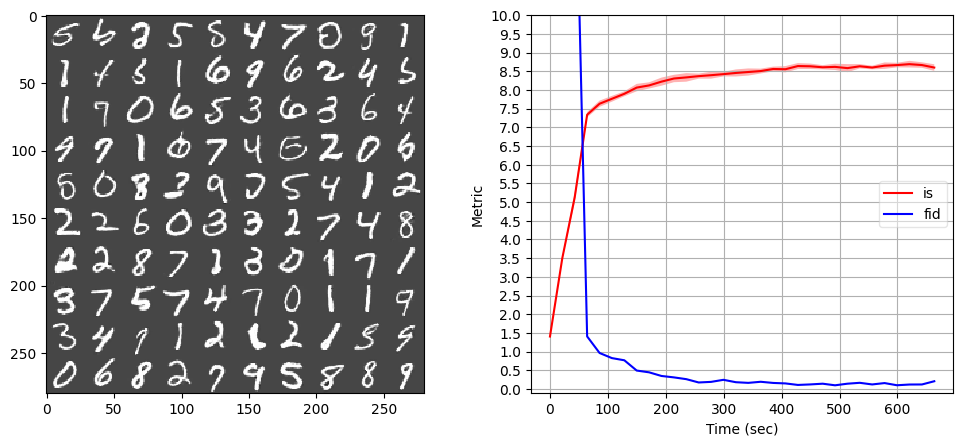

Iter 32000: Mean proba from D(G(z)): 0.3770 +/- 0.2080


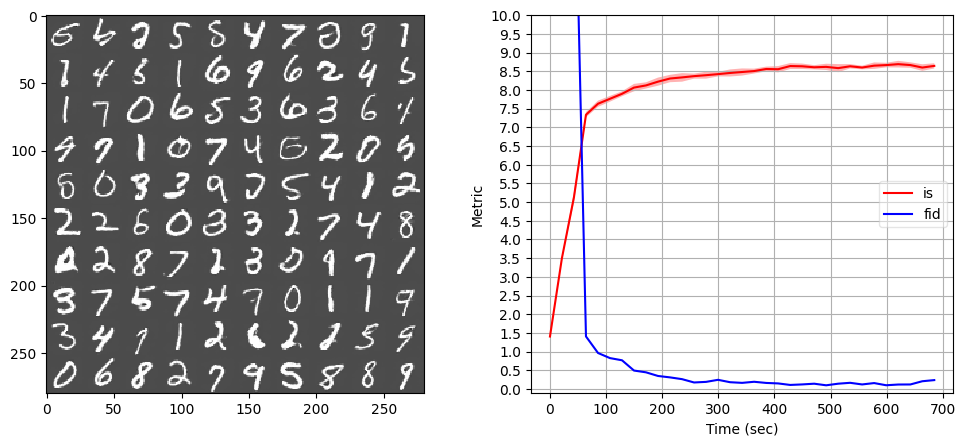

Iter 33000: Mean proba from D(G(z)): 0.2923 +/- 0.1997


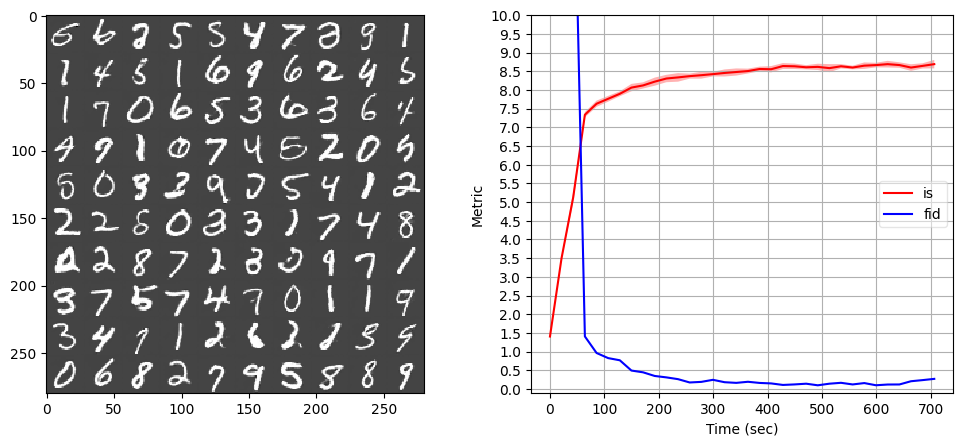

Iter 34000: Mean proba from D(G(z)): 0.2720 +/- 0.1897


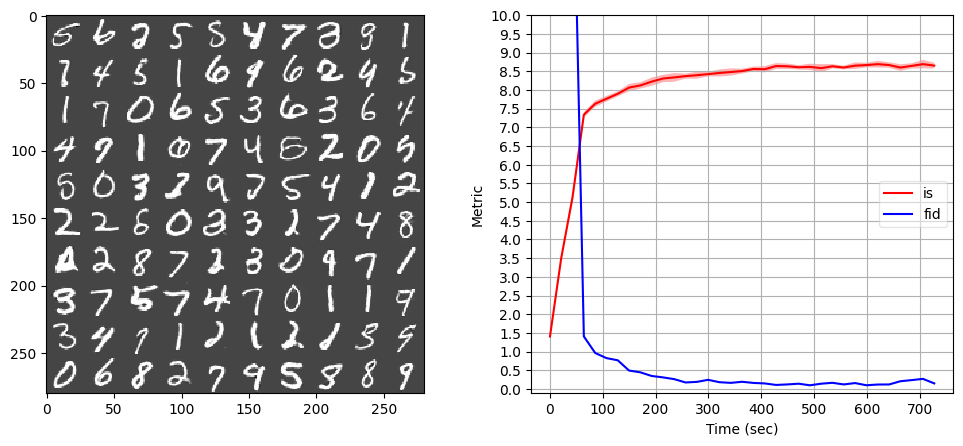

Iter 35000: Mean proba from D(G(z)): 0.2870 +/- 0.1849


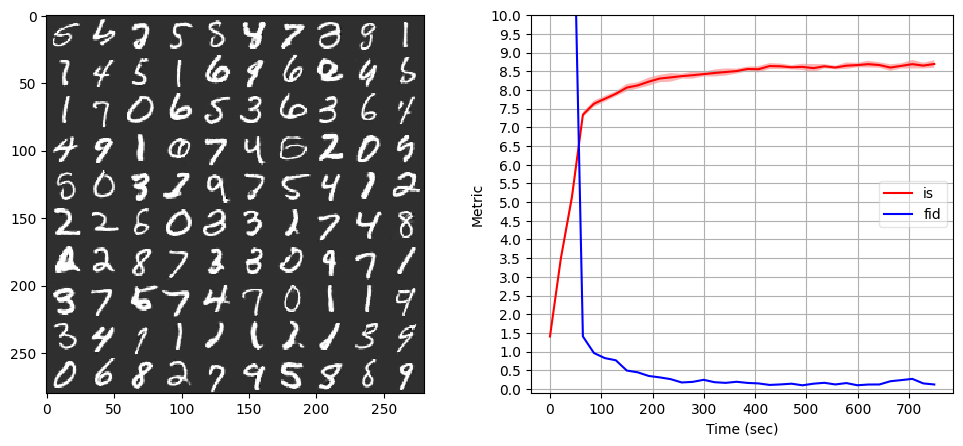

Iter 36000: Mean proba from D(G(z)): 0.6362 +/- 0.1959


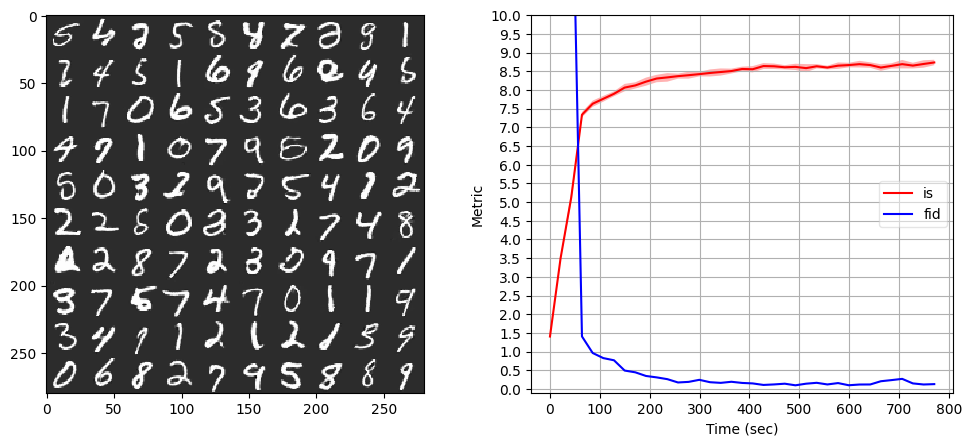

Iter 37000: Mean proba from D(G(z)): 0.7706 +/- 0.1722


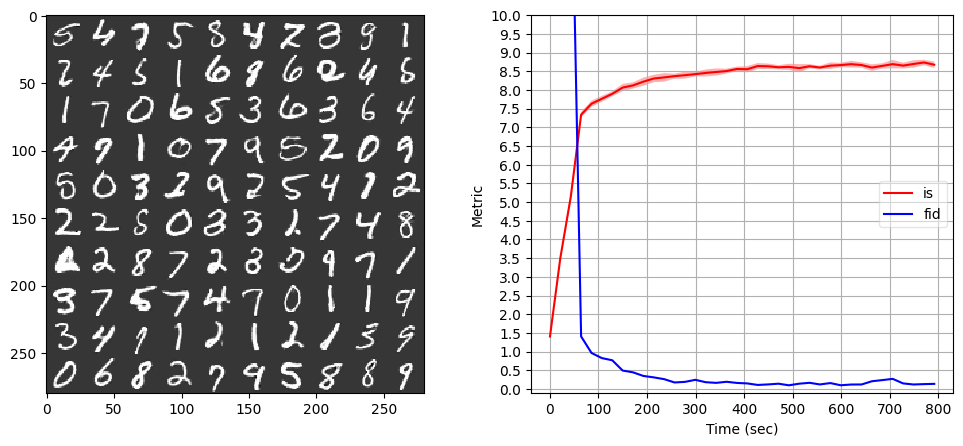

Iter 38000: Mean proba from D(G(z)): 0.5118 +/- 0.2269


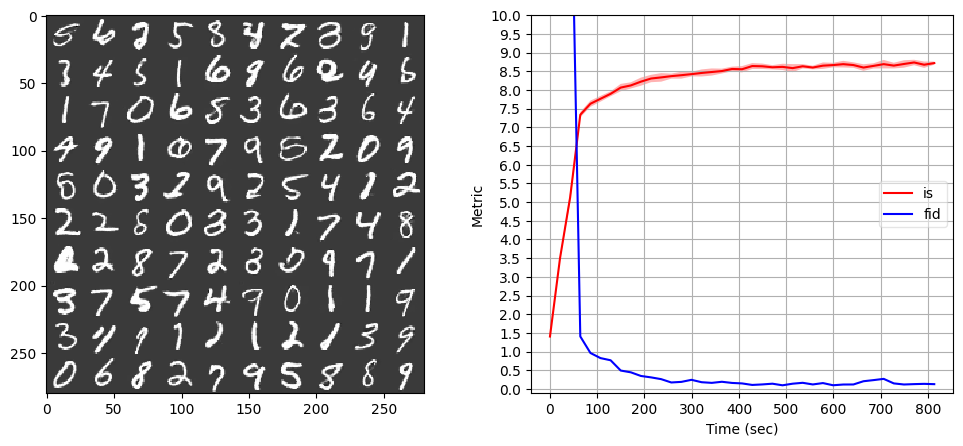

Iter 39000: Mean proba from D(G(z)): 0.3909 +/- 0.2111


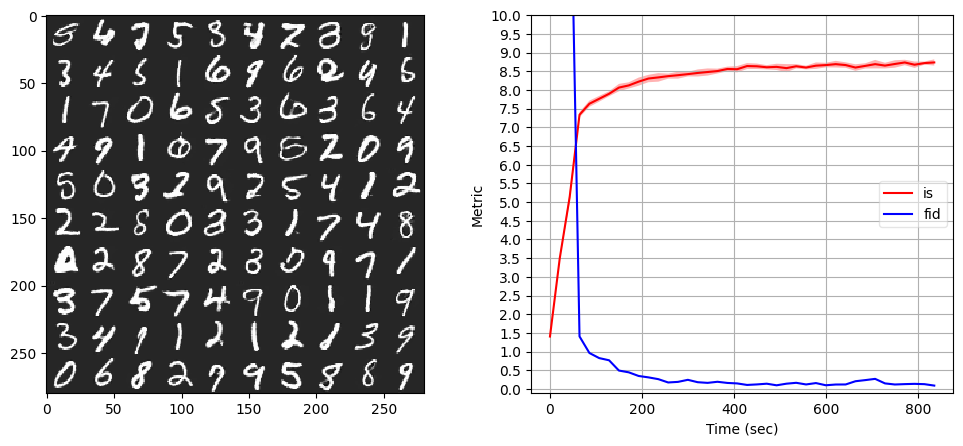

Iter 40000: Mean proba from D(G(z)): 0.6156 +/- 0.2245


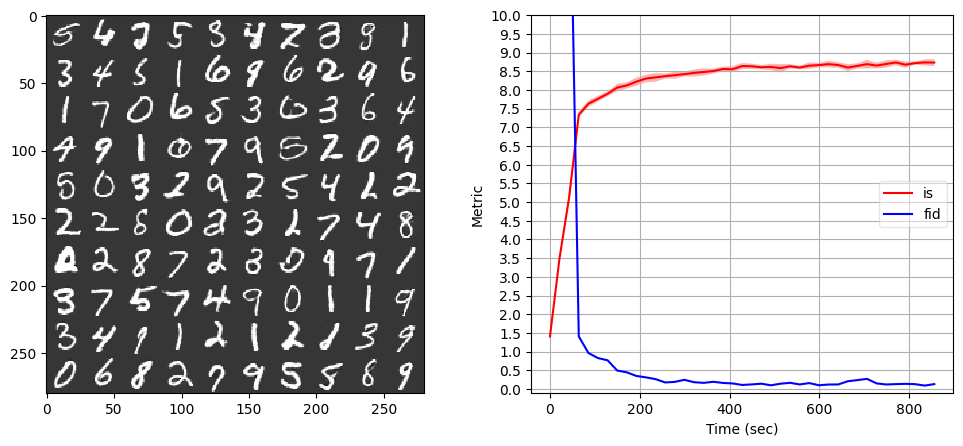

Iter 41000: Mean proba from D(G(z)): 0.5658 +/- 0.2245


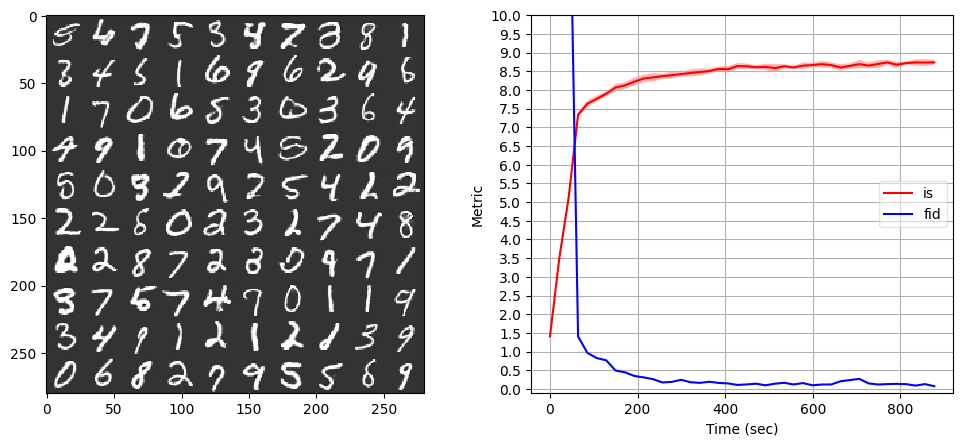

Iter 42000: Mean proba from D(G(z)): 0.3959 +/- 0.2041


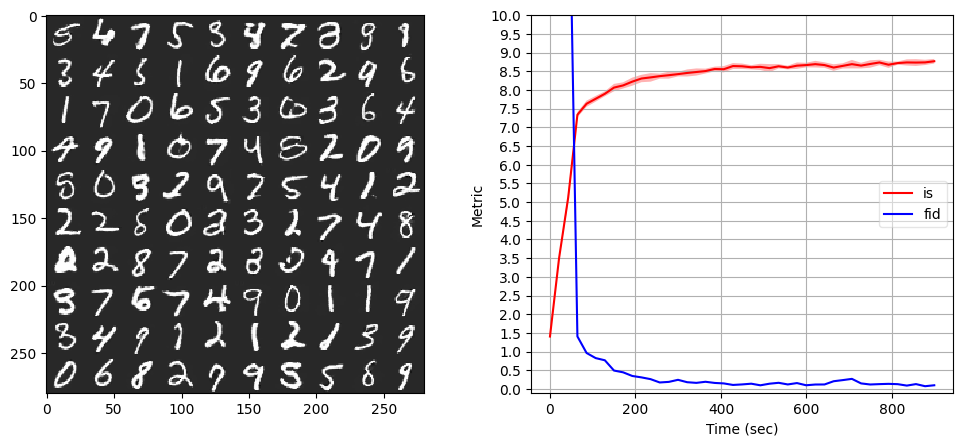

Iter 43000: Mean proba from D(G(z)): 0.3017 +/- 0.1842


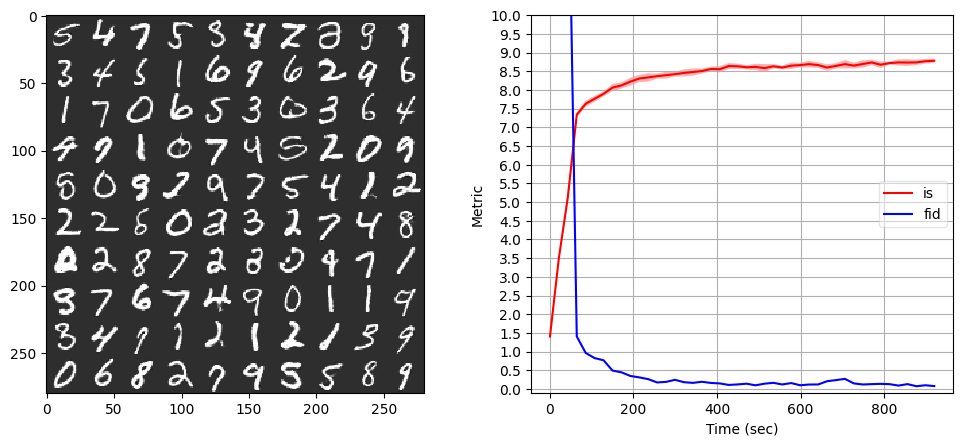

Iter 44000: Mean proba from D(G(z)): 0.4562 +/- 0.2095


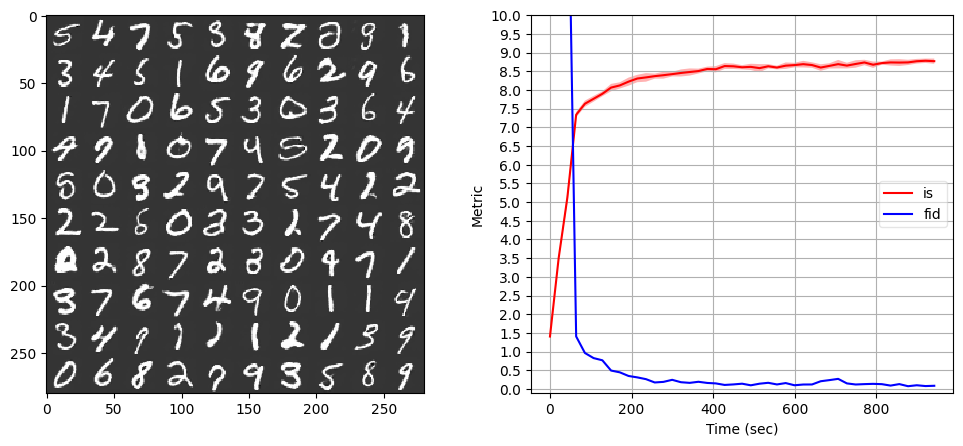

Iter 45000: Mean proba from D(G(z)): 0.4023 +/- 0.2020


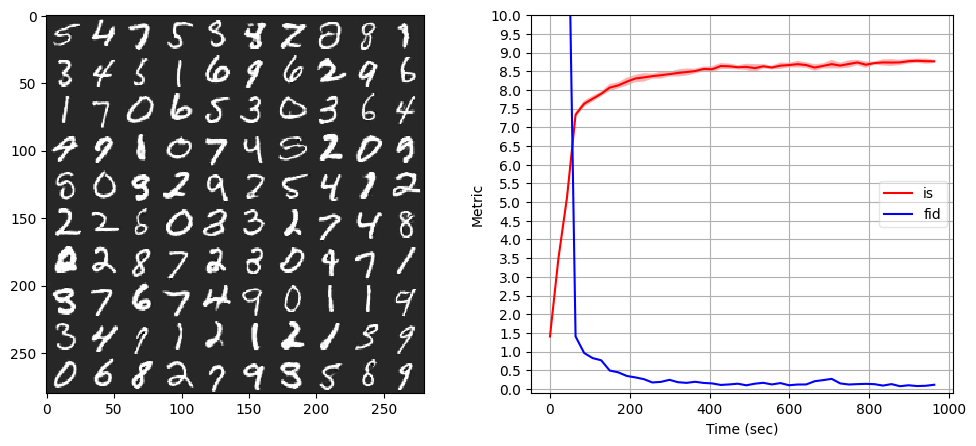

Iter 46000: Mean proba from D(G(z)): 0.3043 +/- 0.1855


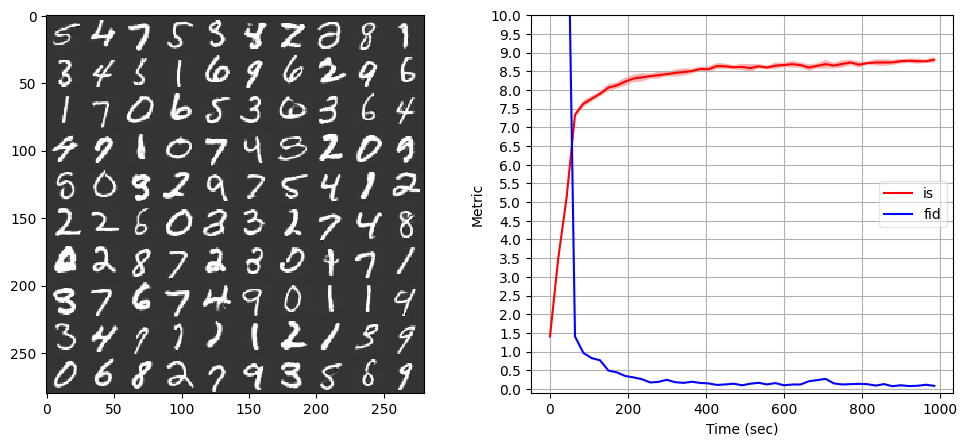

Iter 47000: Mean proba from D(G(z)): 0.3073 +/- 0.1847


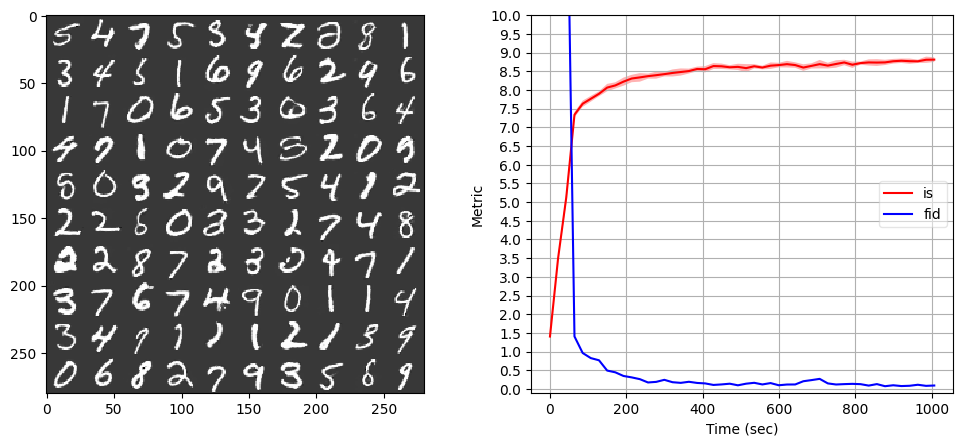

Iter 48000: Mean proba from D(G(z)): 0.3907 +/- 0.2079


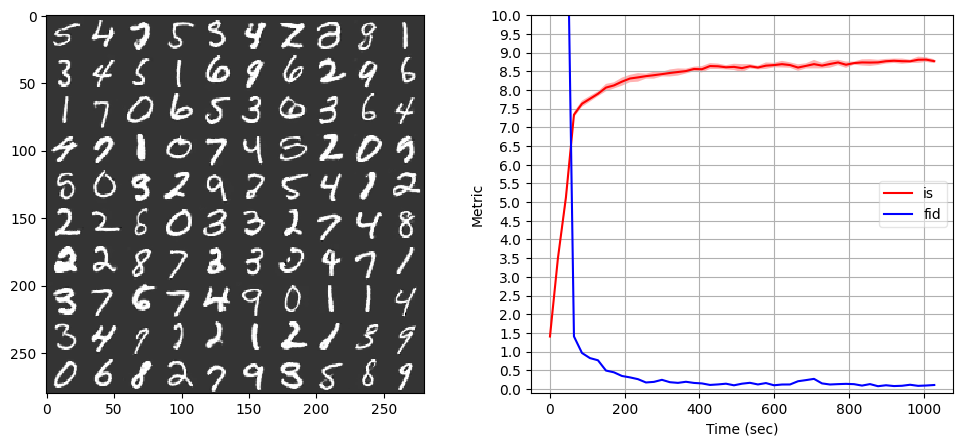

Iter 49000: Mean proba from D(G(z)): 0.5614 +/- 0.2077


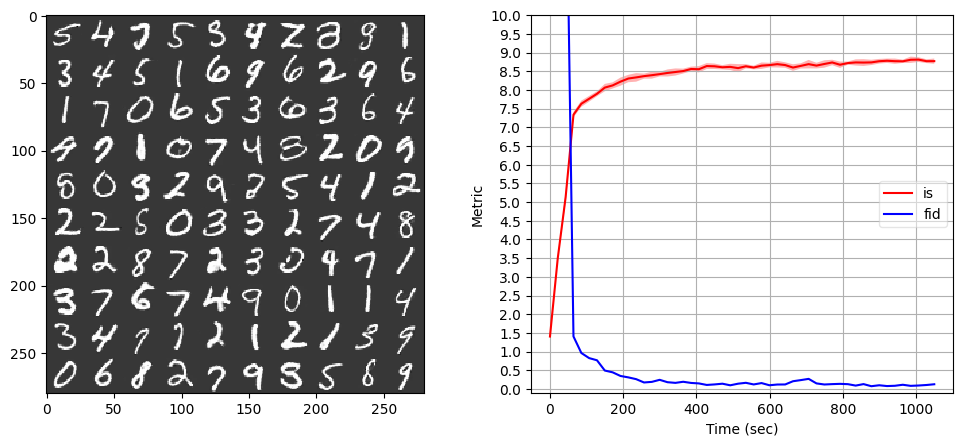

Iter 50000: Mean proba from D(G(z)): 0.6515 +/- 0.2162


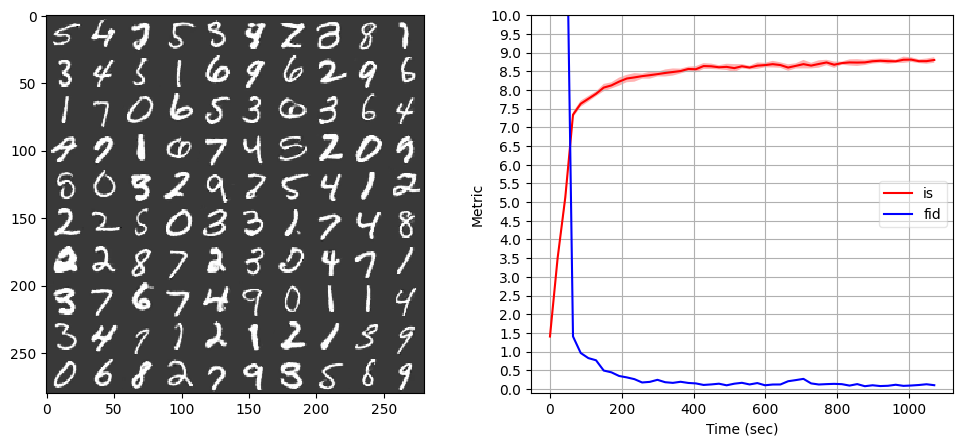

Iter 51000: Mean proba from D(G(z)): 0.3307 +/- 0.2061


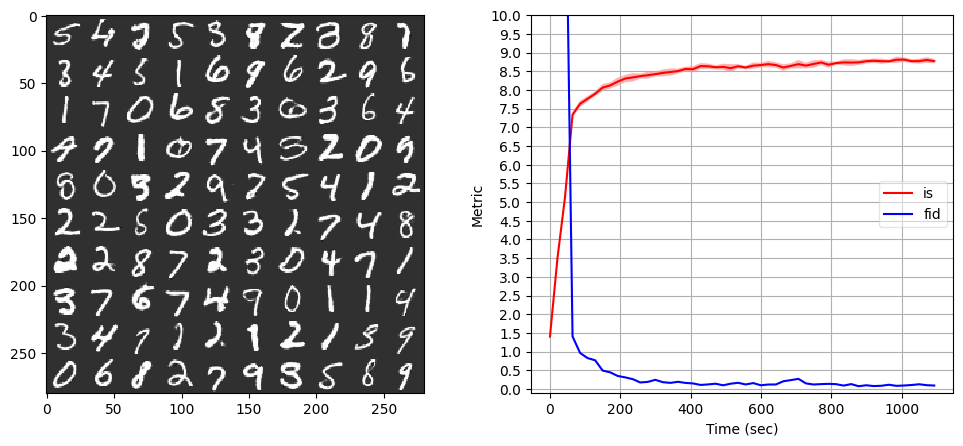

Iter 52000: Mean proba from D(G(z)): 0.3479 +/- 0.2238


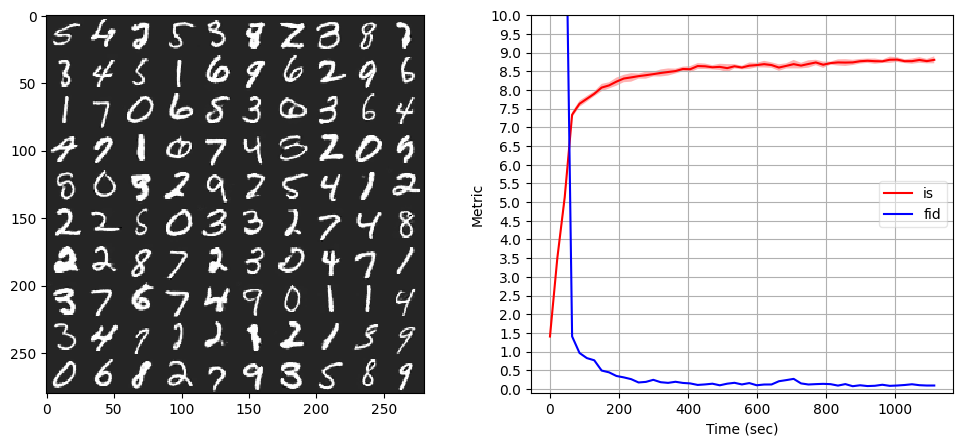

Iter 53000: Mean proba from D(G(z)): 0.3749 +/- 0.2004


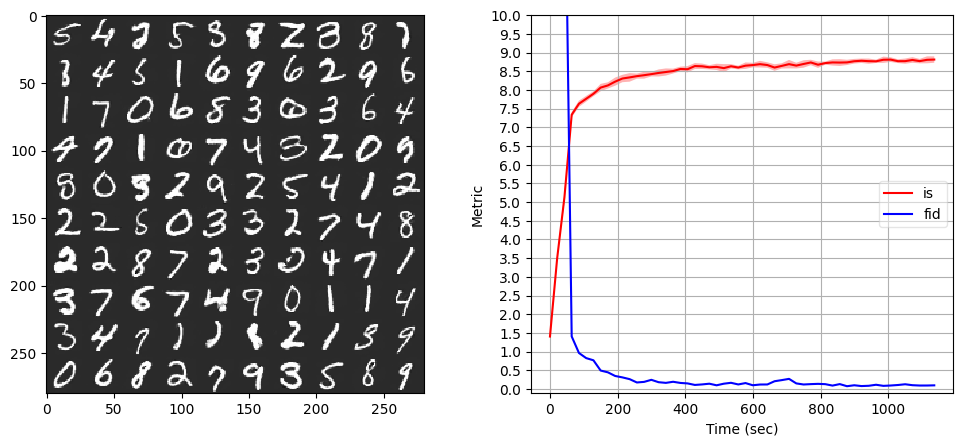

Iter 54000: Mean proba from D(G(z)): 0.2136 +/- 0.1437


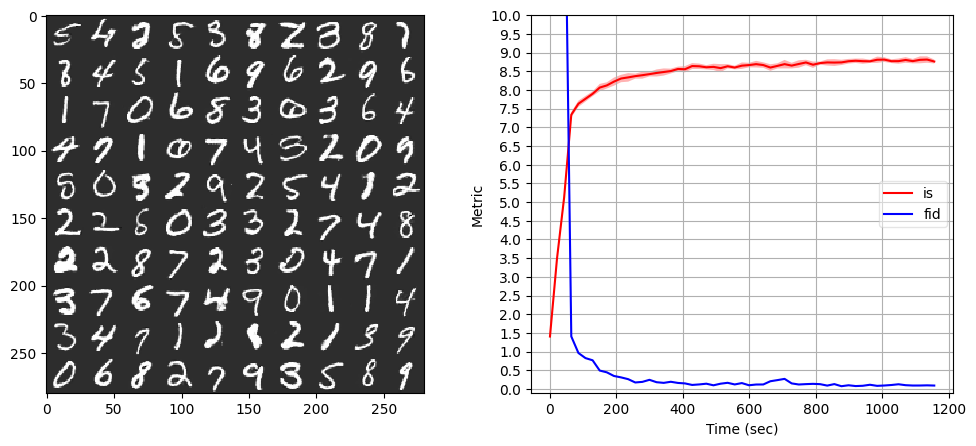

Iter 55000: Mean proba from D(G(z)): 0.3107 +/- 0.2047


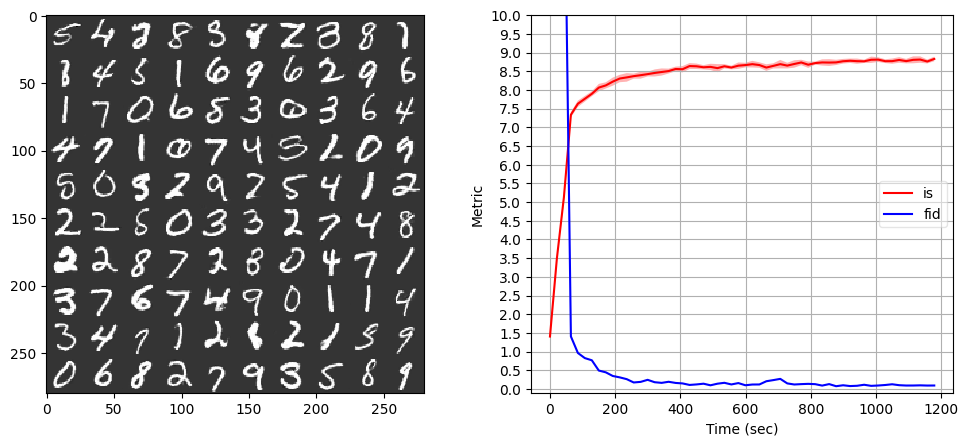

Iter 56000: Mean proba from D(G(z)): 0.3088 +/- 0.2008


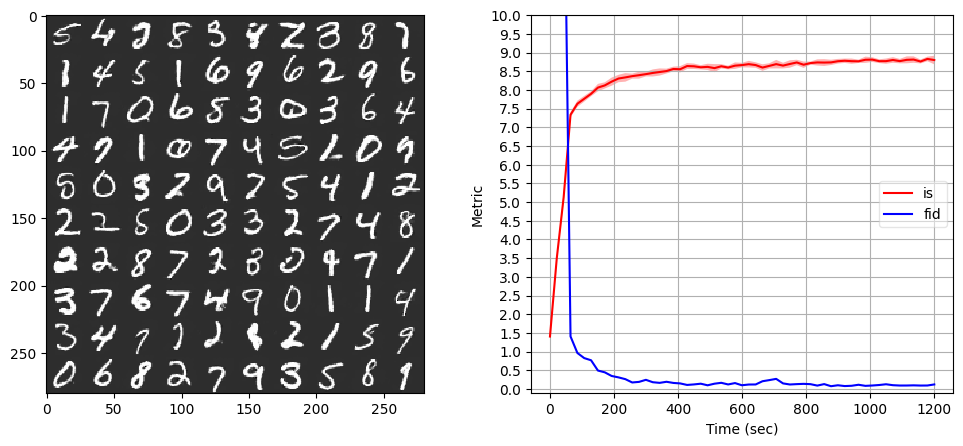

Iter 57000: Mean proba from D(G(z)): 0.4295 +/- 0.2403


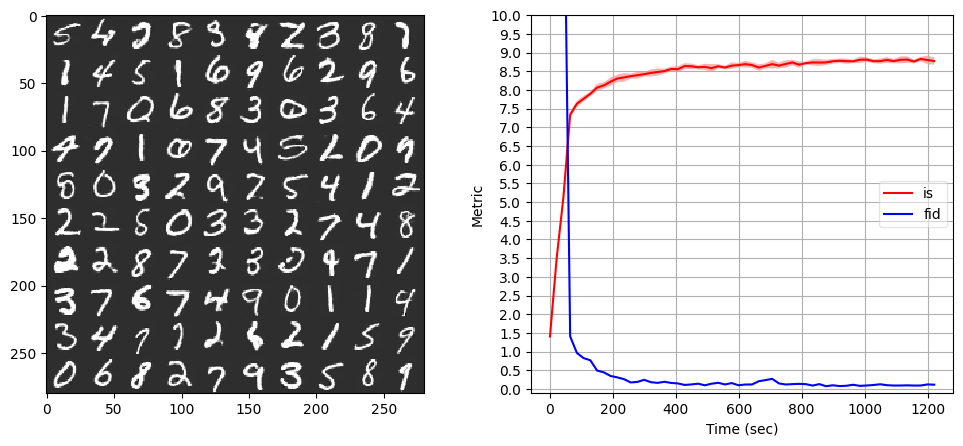

Iter 58000: Mean proba from D(G(z)): 0.3305 +/- 0.2077


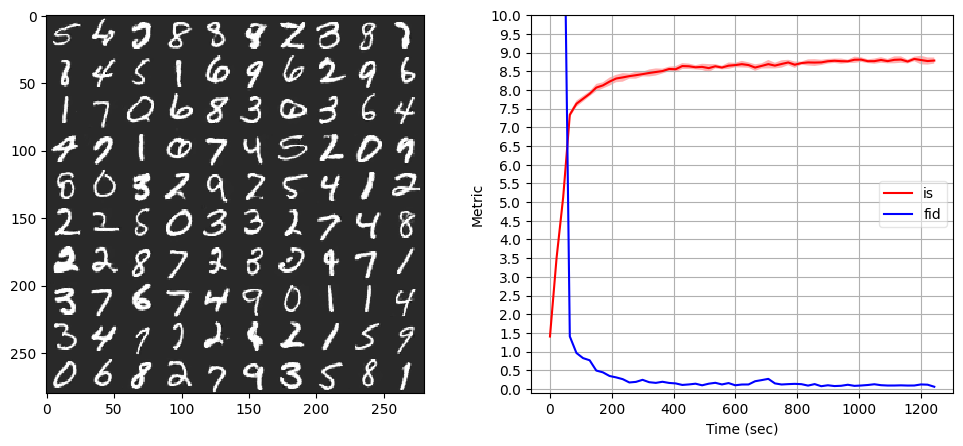

Iter 59000: Mean proba from D(G(z)): 0.3721 +/- 0.2151


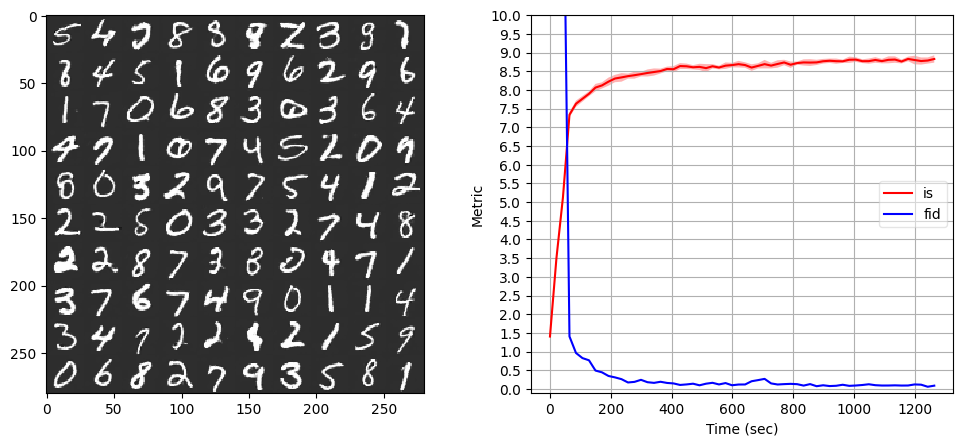

Iter 60000: Mean proba from D(G(z)): 0.4212 +/- 0.2464


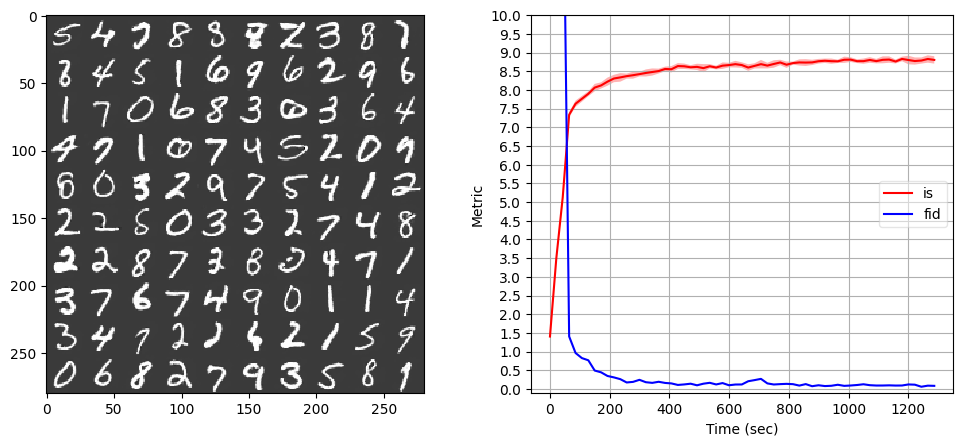

Iter 61000: Mean proba from D(G(z)): 0.2872 +/- 0.2028


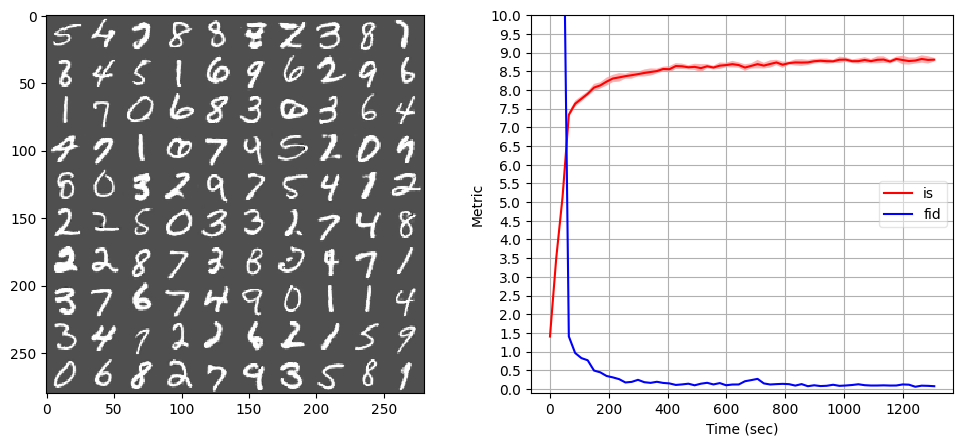

Iter 62000: Mean proba from D(G(z)): 0.2787 +/- 0.1952


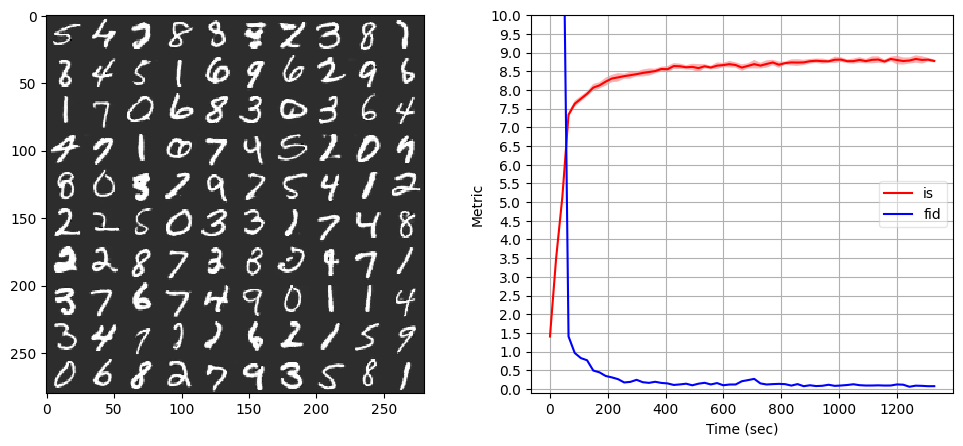

Iter 63000: Mean proba from D(G(z)): 0.5331 +/- 0.2238


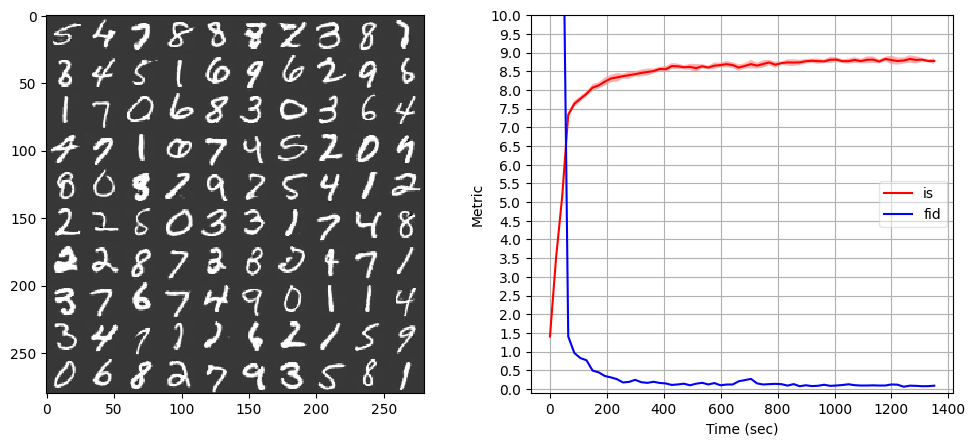

Iter 64000: Mean proba from D(G(z)): 0.3721 +/- 0.2259


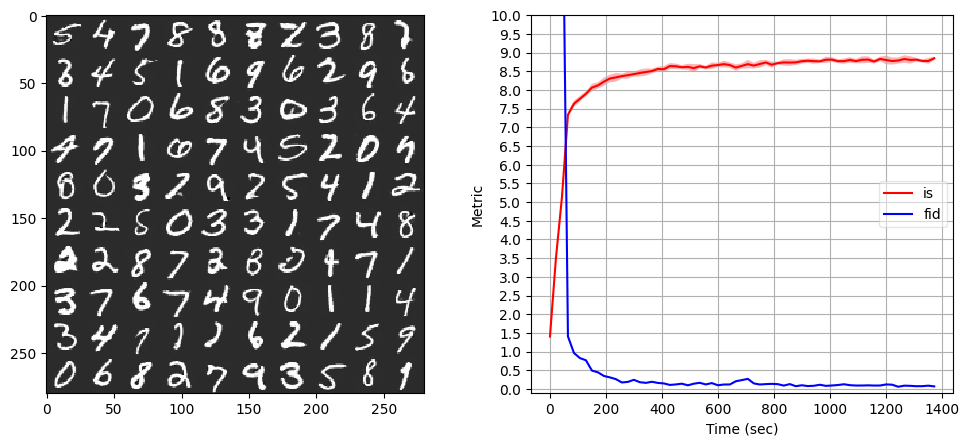

Iter 65000: Mean proba from D(G(z)): 0.4797 +/- 0.2311


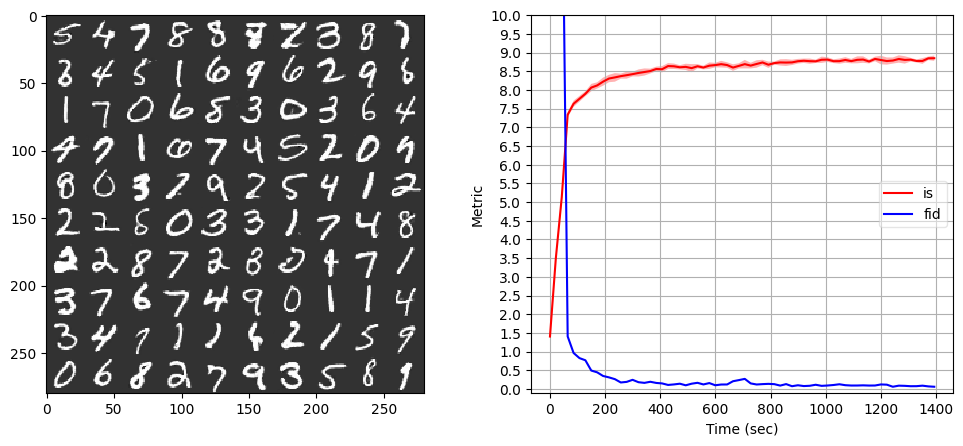

Iter 66000: Mean proba from D(G(z)): 0.3771 +/- 0.2248


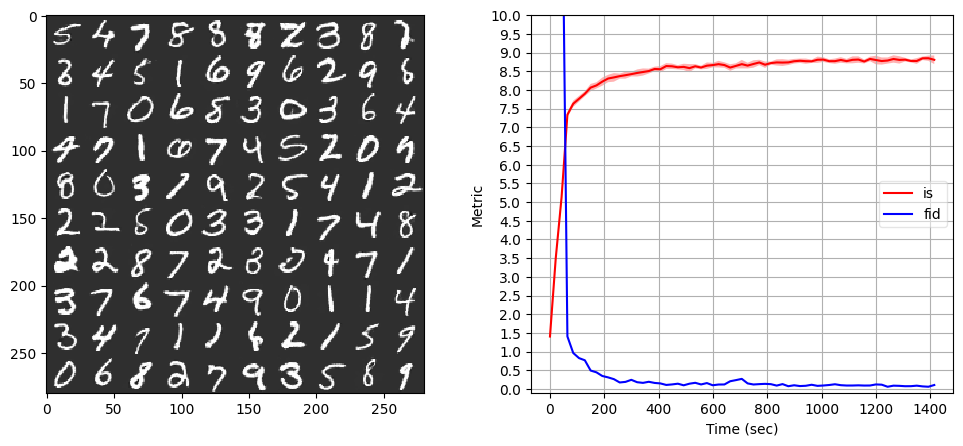

Iter 67000: Mean proba from D(G(z)): 0.5598 +/- 0.2515


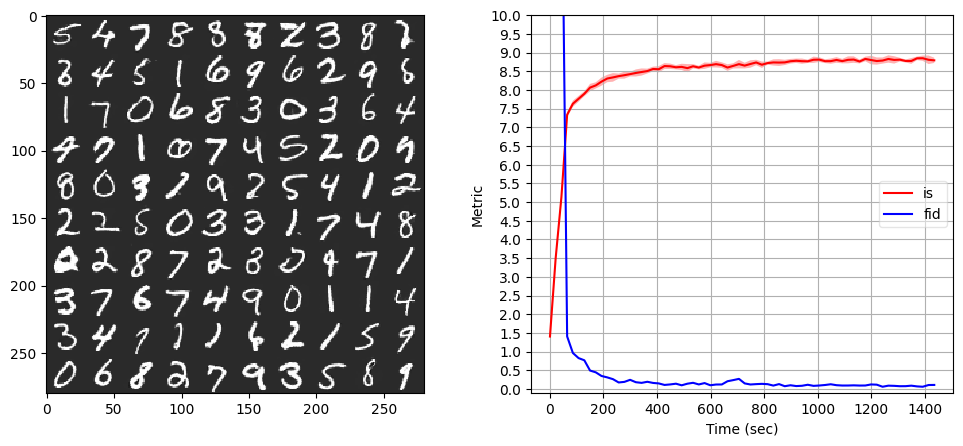

Iter 68000: Mean proba from D(G(z)): 0.4235 +/- 0.2637


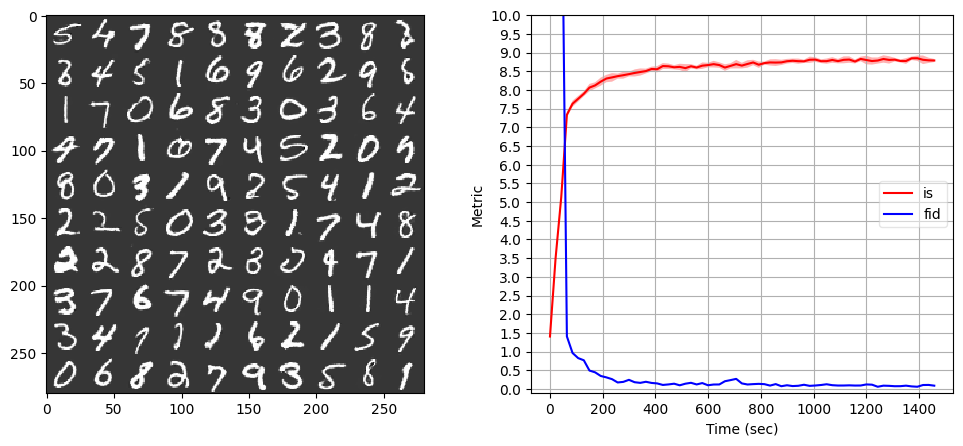

Iter 69000: Mean proba from D(G(z)): 0.3891 +/- 0.2478


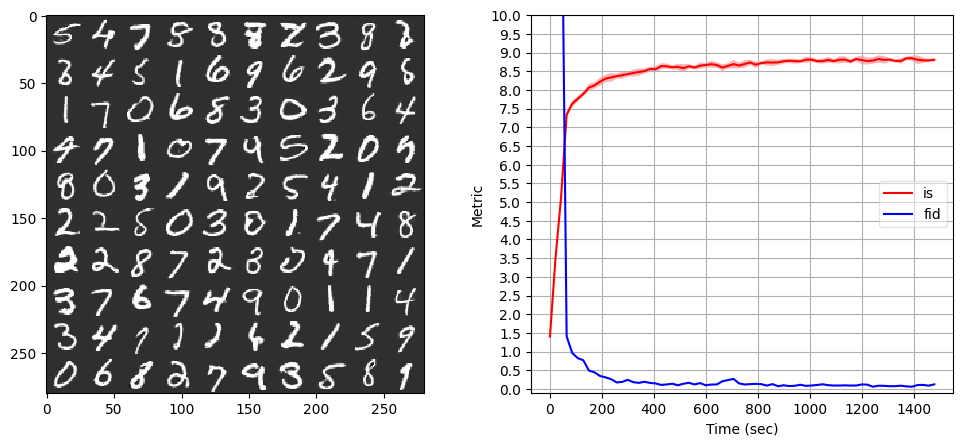

Iter 70000: Mean proba from D(G(z)): 0.4140 +/- 0.2356


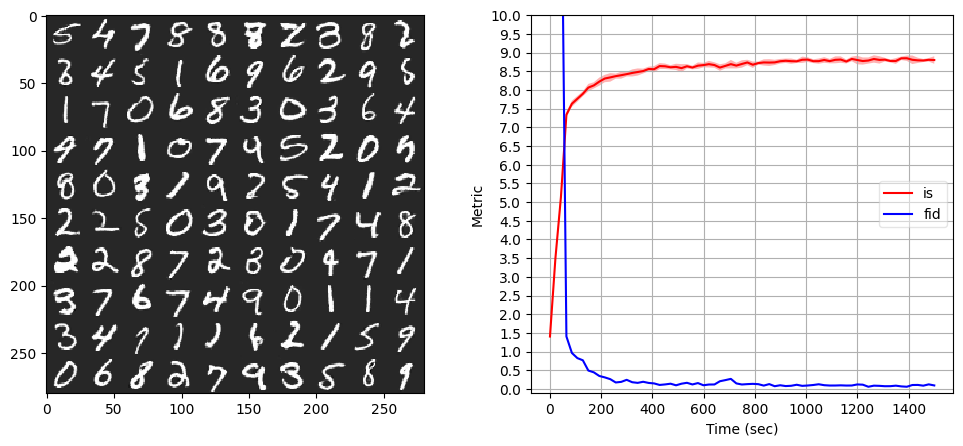

Iter 71000: Mean proba from D(G(z)): 0.4266 +/- 0.2246


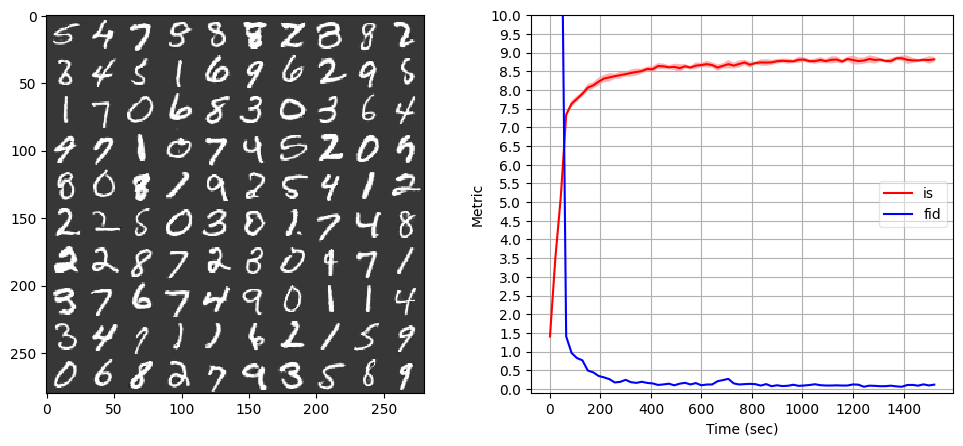

Iter 72000: Mean proba from D(G(z)): 0.5552 +/- 0.2294


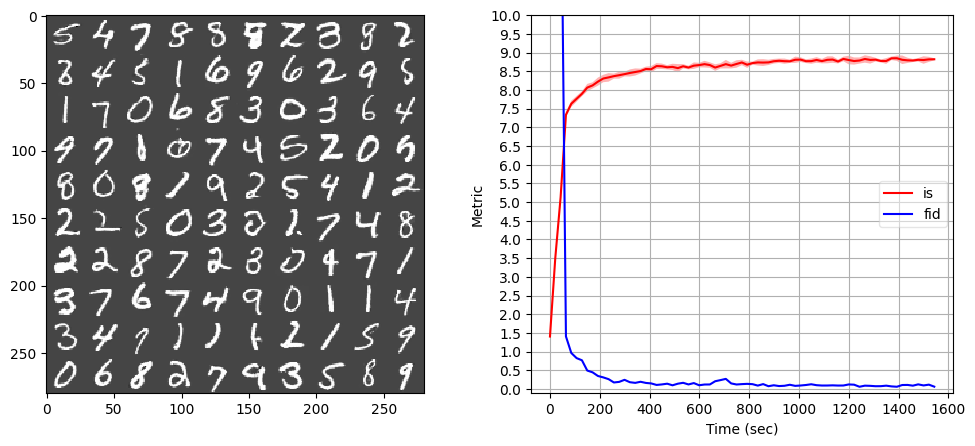

Iter 73000: Mean proba from D(G(z)): 0.4275 +/- 0.2212


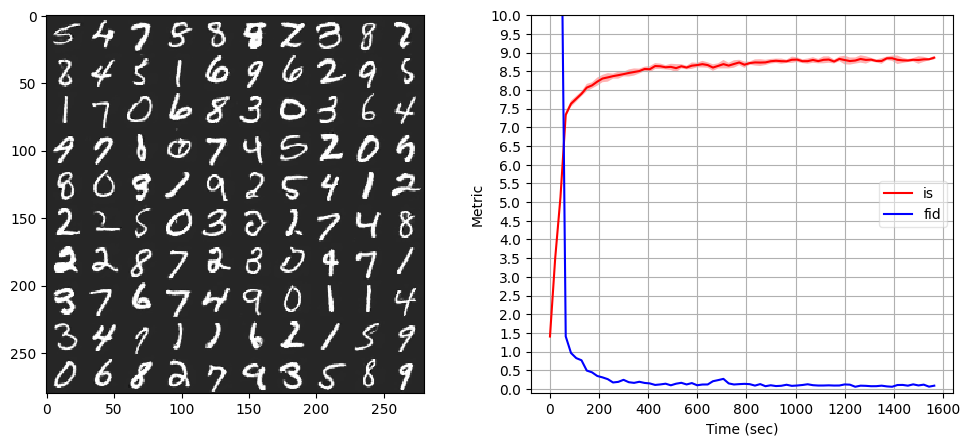

Iter 74000: Mean proba from D(G(z)): 0.5140 +/- 0.2293


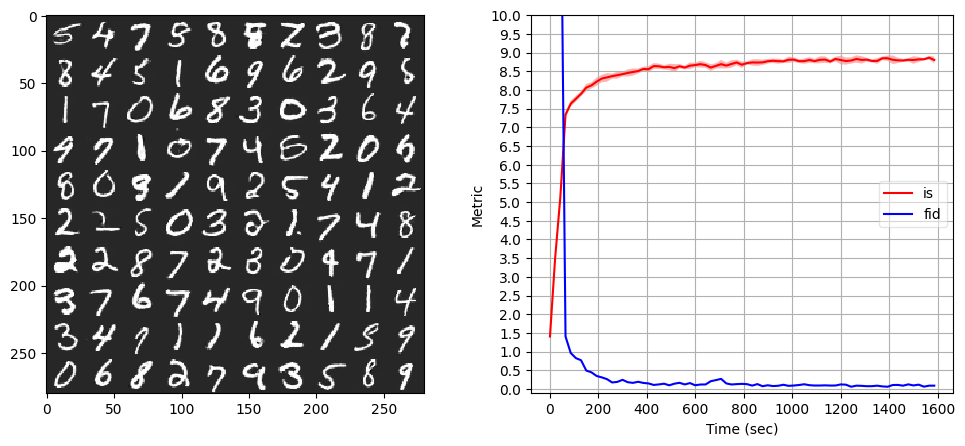

Iter 75000: Mean proba from D(G(z)): 0.3083 +/- 0.2062


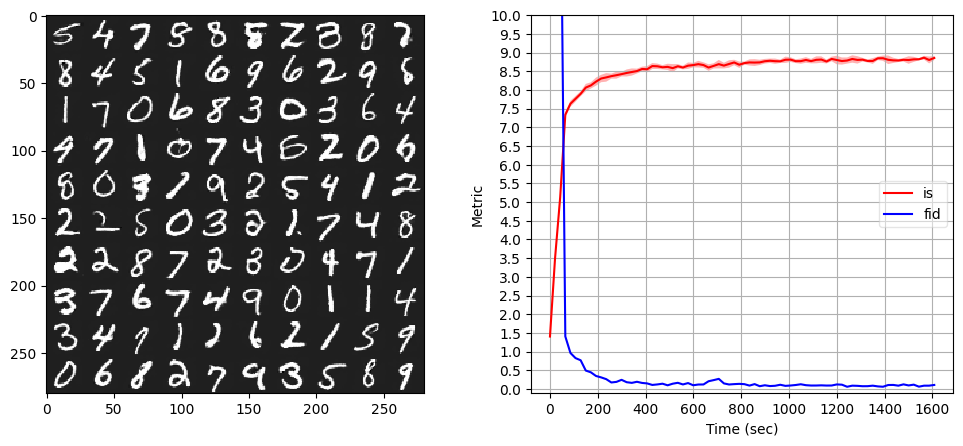

Iter 76000: Mean proba from D(G(z)): 0.3751 +/- 0.2125


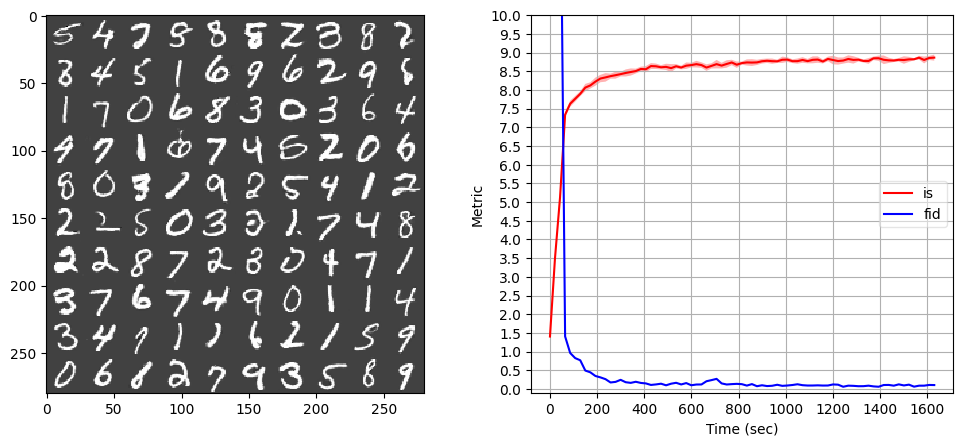

Iter 77000: Mean proba from D(G(z)): 0.3247 +/- 0.2038


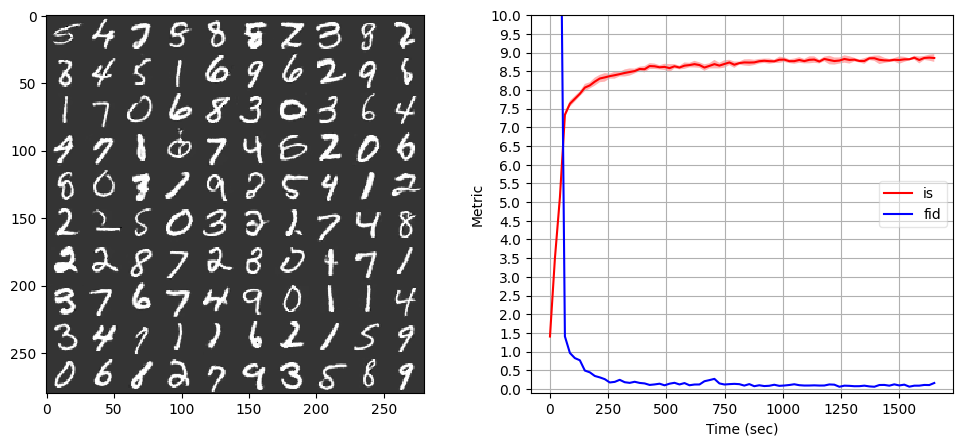

Iter 78000: Mean proba from D(G(z)): 0.5025 +/- 0.2367


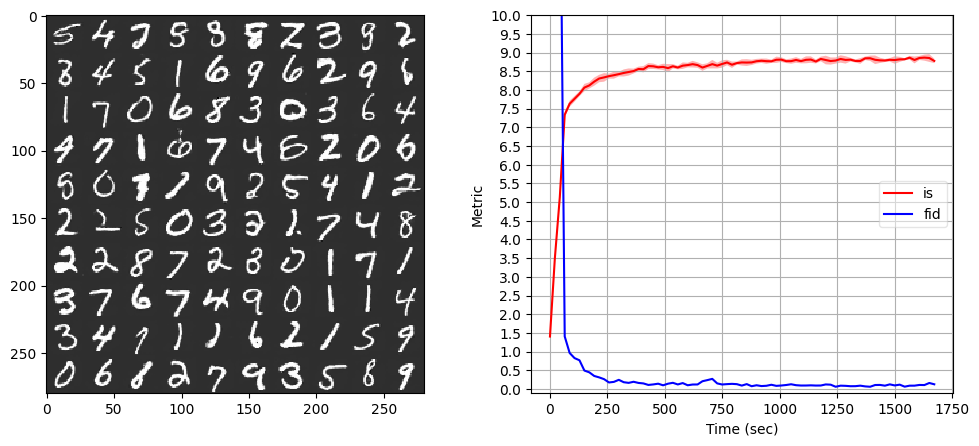

Iter 79000: Mean proba from D(G(z)): 0.6496 +/- 0.2275


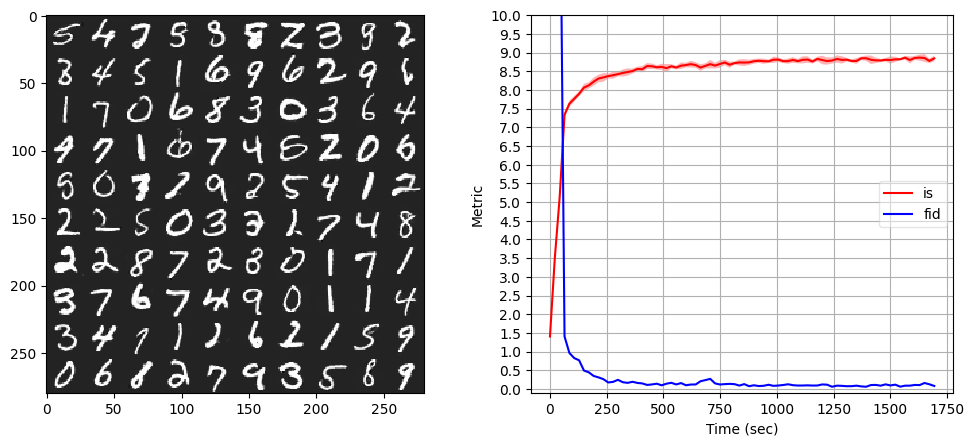

Iter 80000: Mean proba from D(G(z)): 0.4489 +/- 0.2324


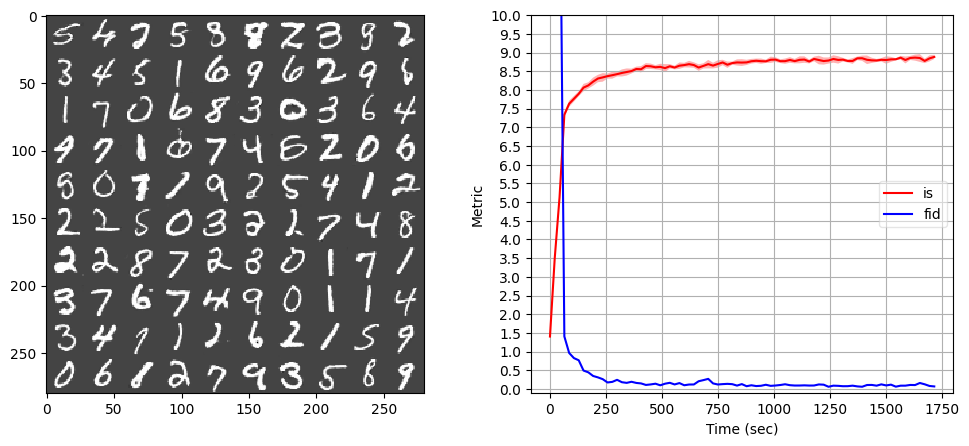

Iter 81000: Mean proba from D(G(z)): 0.5102 +/- 0.2362


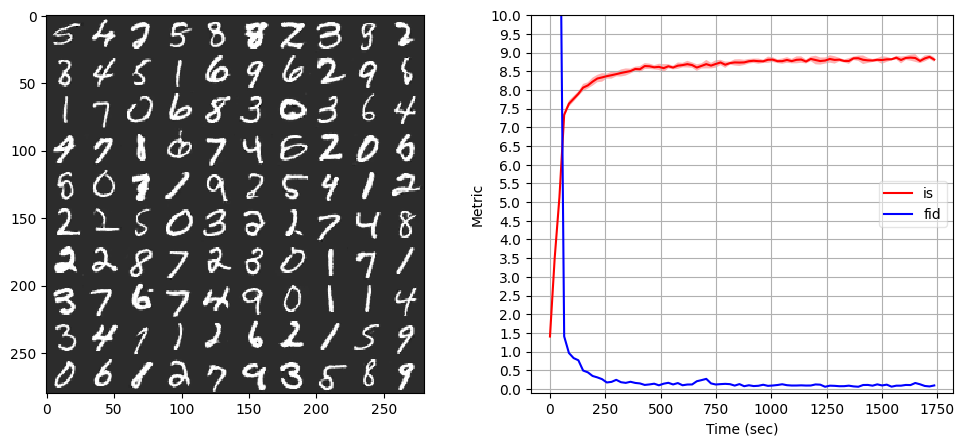

Iter 82000: Mean proba from D(G(z)): 0.2681 +/- 0.2155


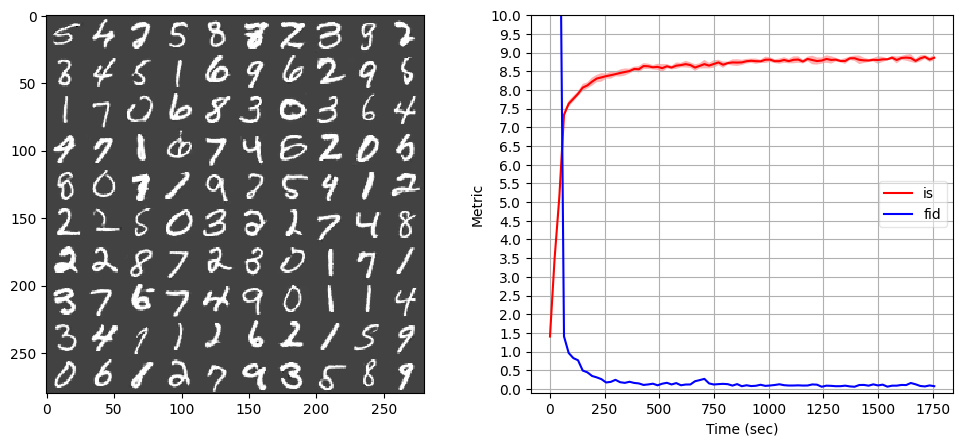

Iter 83000: Mean proba from D(G(z)): 0.2119 +/- 0.2013


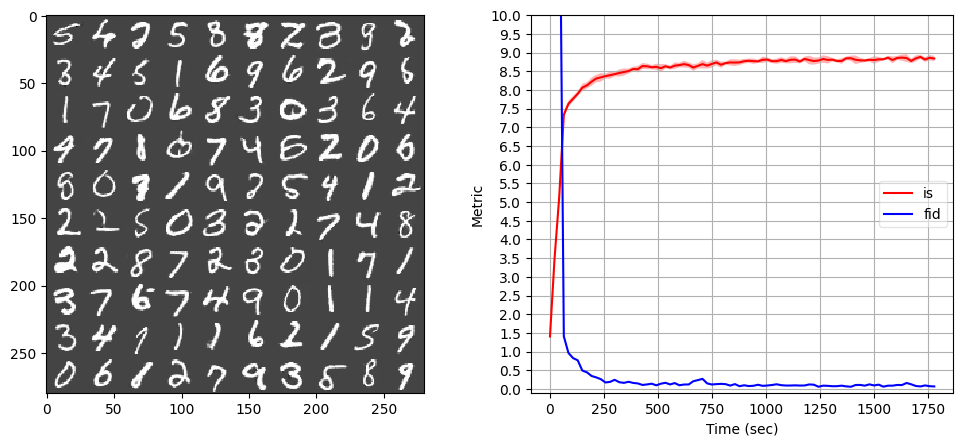

Iter 84000: Mean proba from D(G(z)): 0.3312 +/- 0.2301


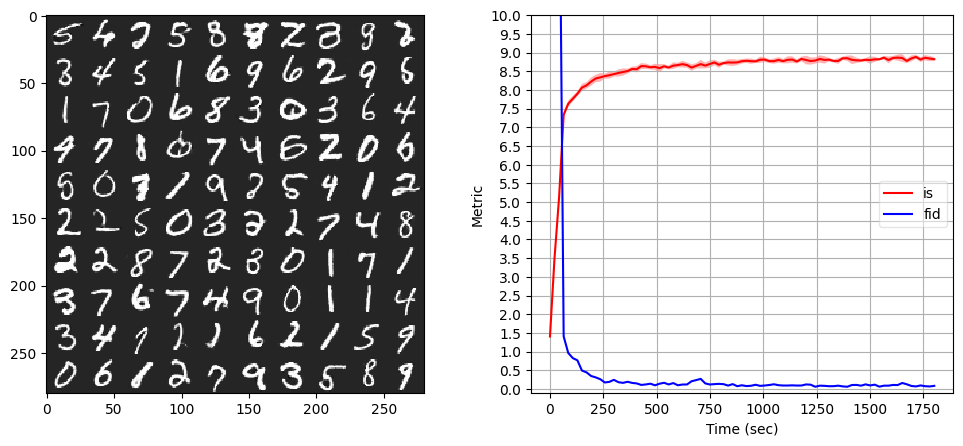

Iter 85000: Mean proba from D(G(z)): 0.2089 +/- 0.1827


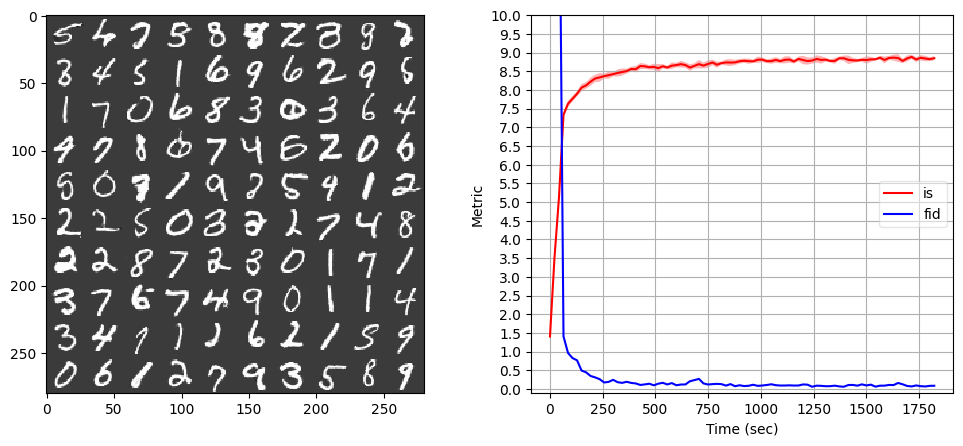

Iter 86000: Mean proba from D(G(z)): 0.3453 +/- 0.2175


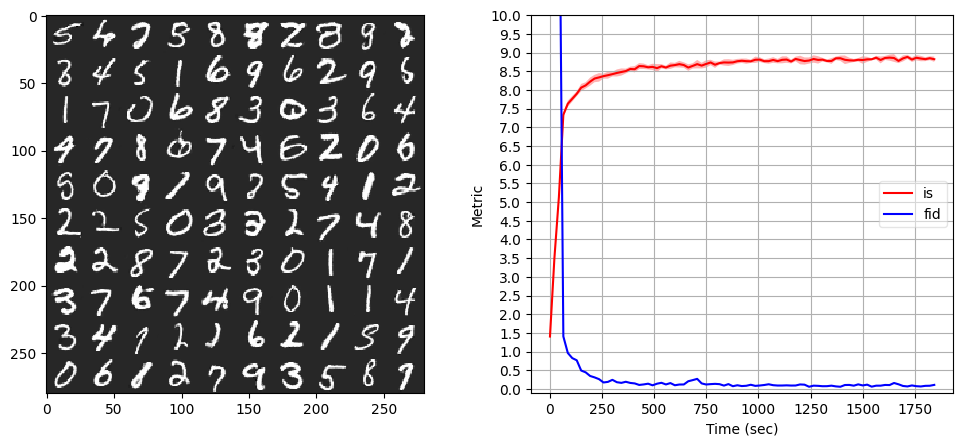

Iter 87000: Mean proba from D(G(z)): 0.3065 +/- 0.2260


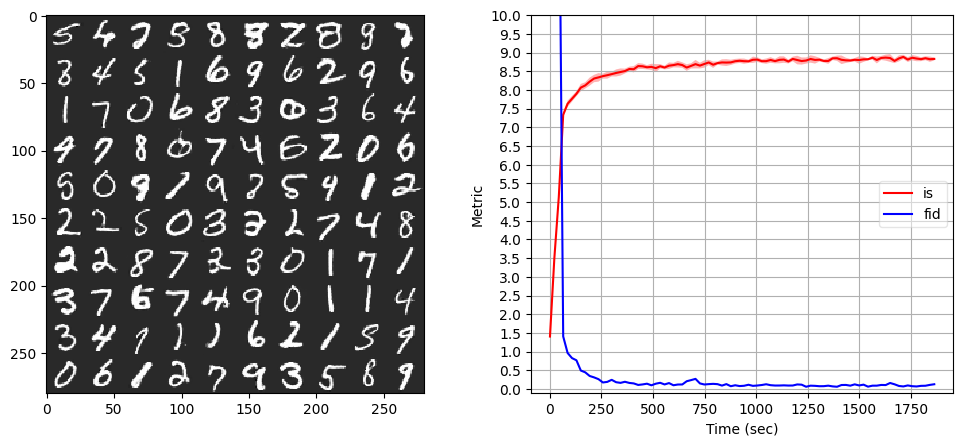

Iter 88000: Mean proba from D(G(z)): 0.4362 +/- 0.2347


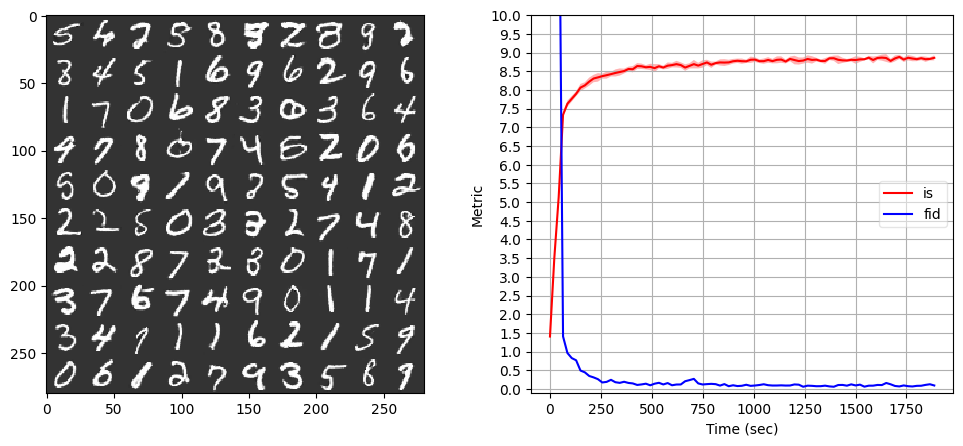

Iter 89000: Mean proba from D(G(z)): 0.3723 +/- 0.2463


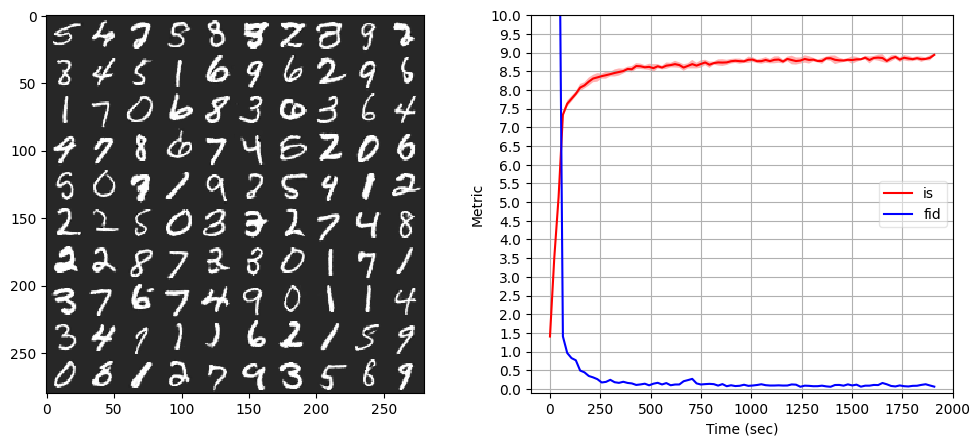

Iter 90000: Mean proba from D(G(z)): 0.3781 +/- 0.2280


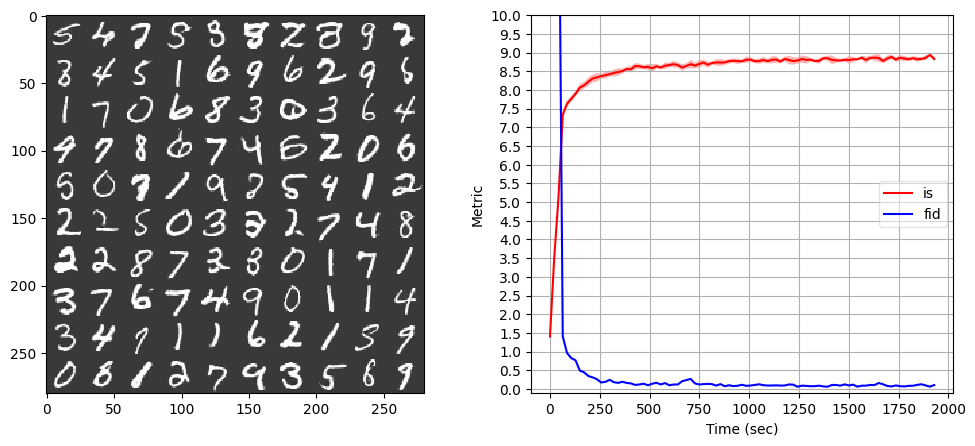

Iter 91000: Mean proba from D(G(z)): 0.3120 +/- 0.2234


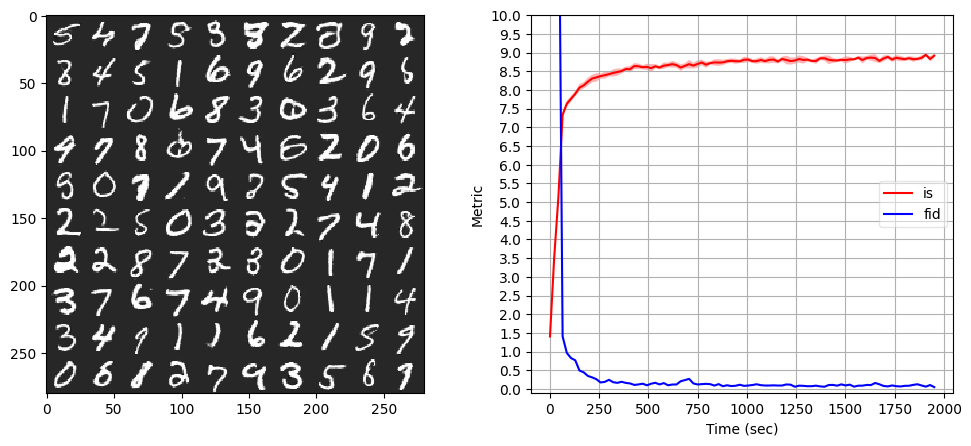

Iter 92000: Mean proba from D(G(z)): 0.0994 +/- 0.0992


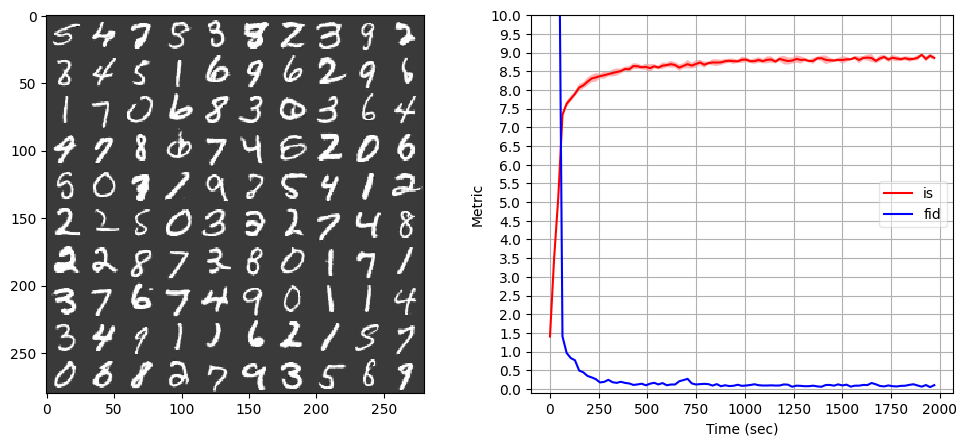

Iter 93000: Mean proba from D(G(z)): 0.1365 +/- 0.1474


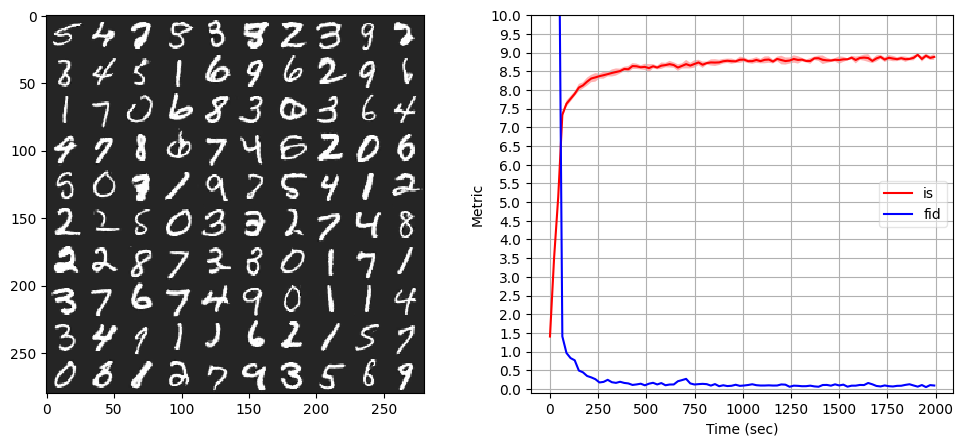

Iter 94000: Mean proba from D(G(z)): 0.2655 +/- 0.2195


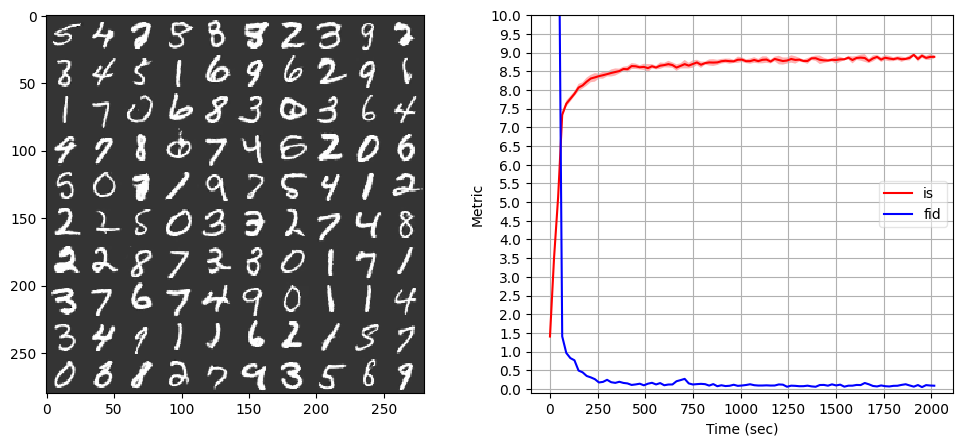

Iter 95000: Mean proba from D(G(z)): 0.4027 +/- 0.2574


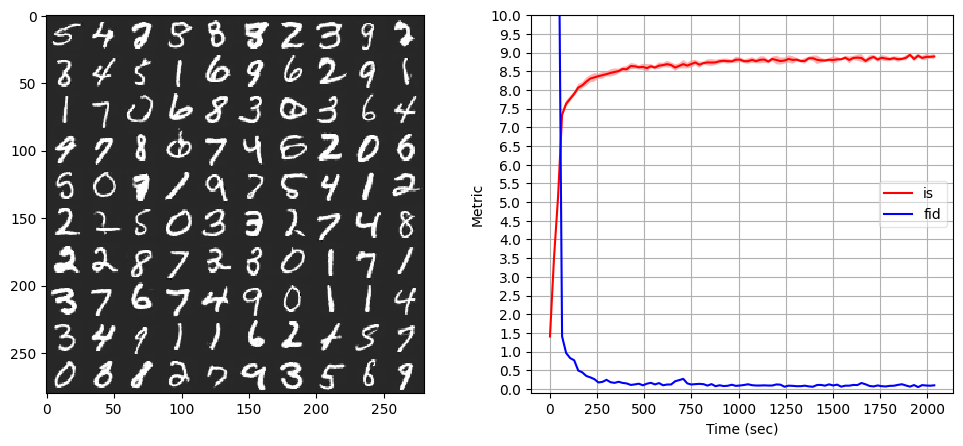

Iter 96000: Mean proba from D(G(z)): 0.3482 +/- 0.2376


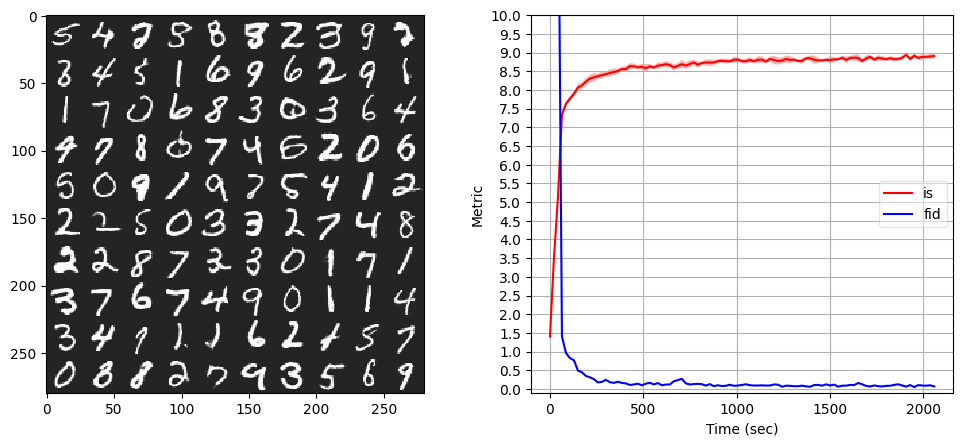

Iter 97000: Mean proba from D(G(z)): 0.3310 +/- 0.2566


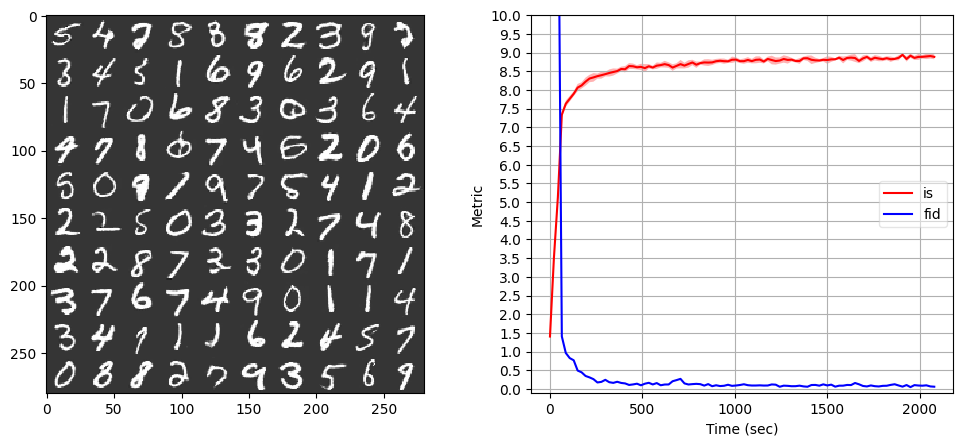

Iter 98000: Mean proba from D(G(z)): 0.1734 +/- 0.1611


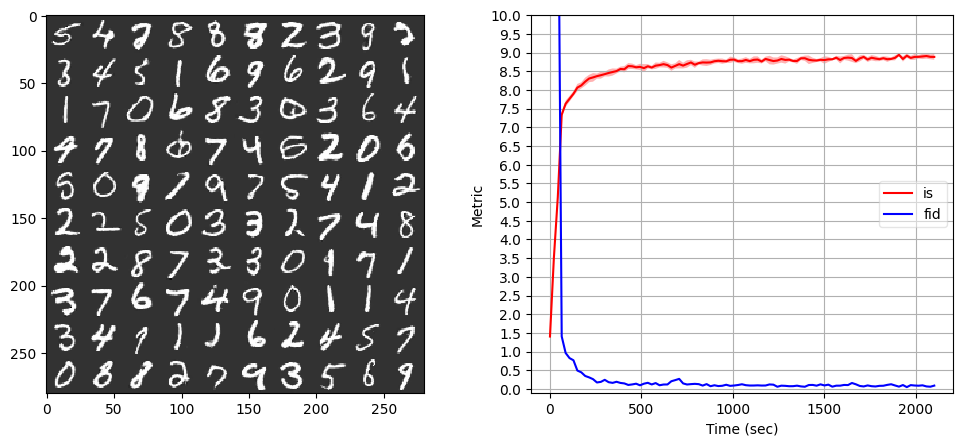

Iter 99000: Mean proba from D(G(z)): 0.2803 +/- 0.2297


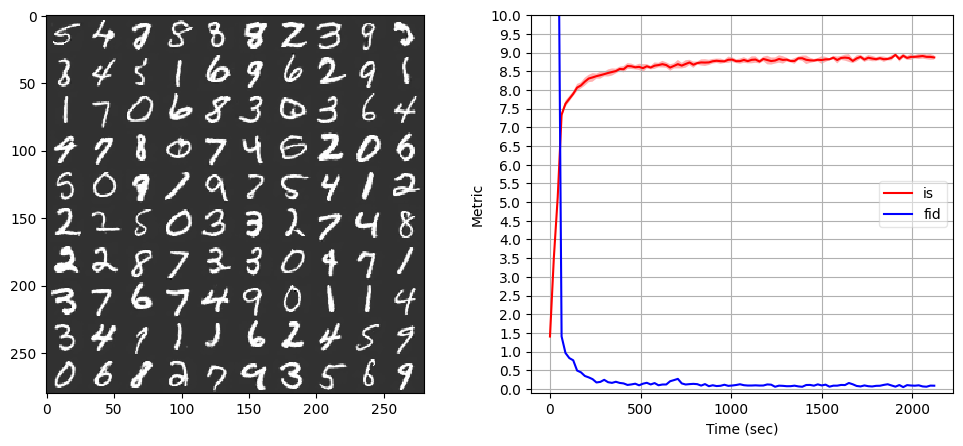

Iter 99999: Mean proba from D(G(z)): 0.0862 +/- 0.1125


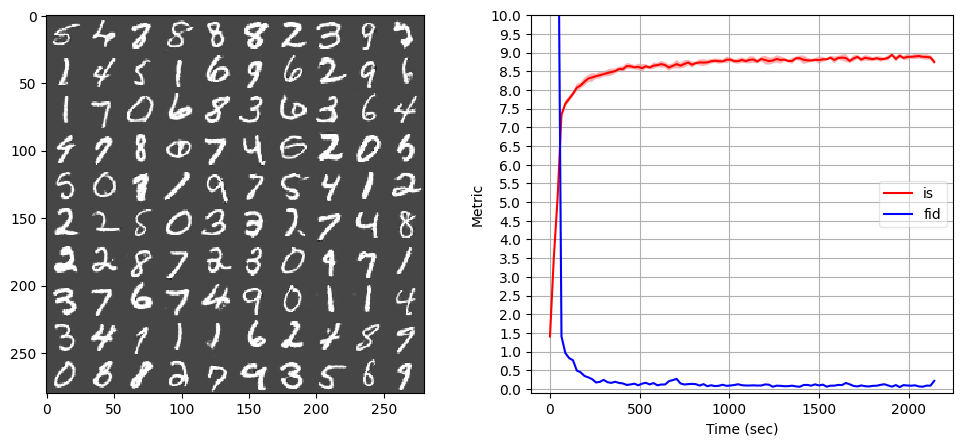

Loading trained model from ./drive/My Drive/Data/models/mnist.pth
in init of lookahead
in init of lookahead
Iter 0: Mean proba from D(G(z)): 0.9966 +/- 0.0017


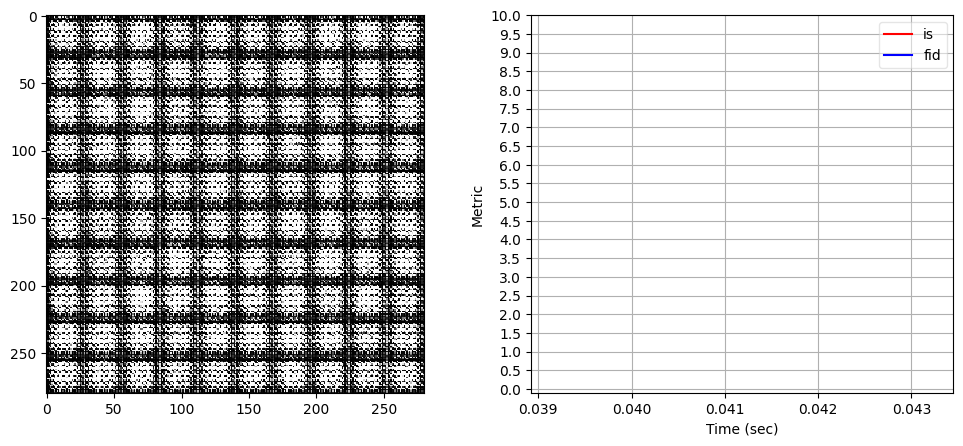

Iter 1000: Mean proba from D(G(z)): 0.0000 +/- 0.0001


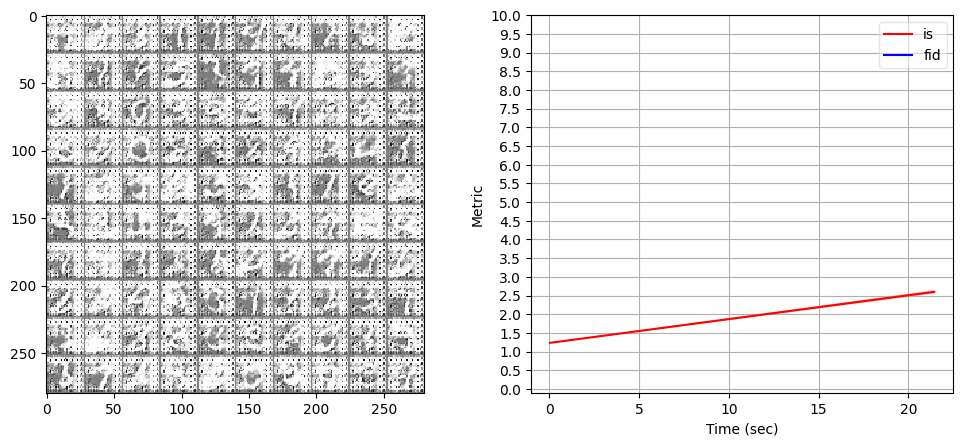

Iter 2000: Mean proba from D(G(z)): 0.0000 +/- 0.0000


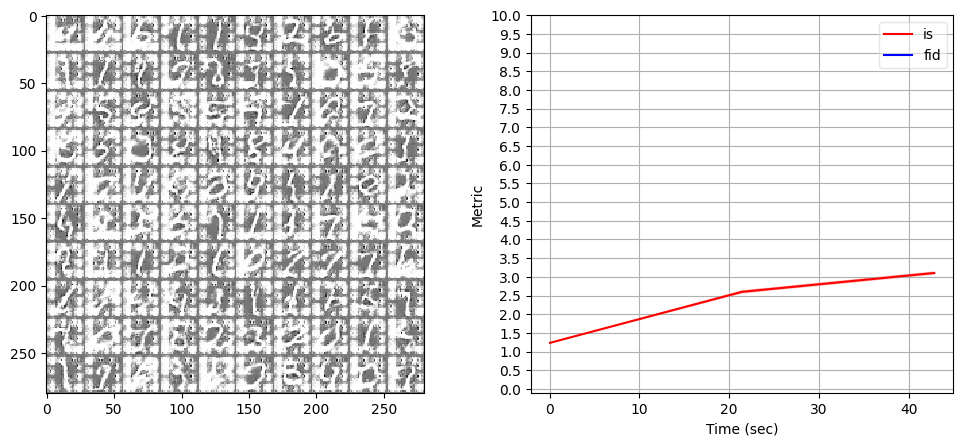

Iter 3000: Mean proba from D(G(z)): 0.0003 +/- 0.0003


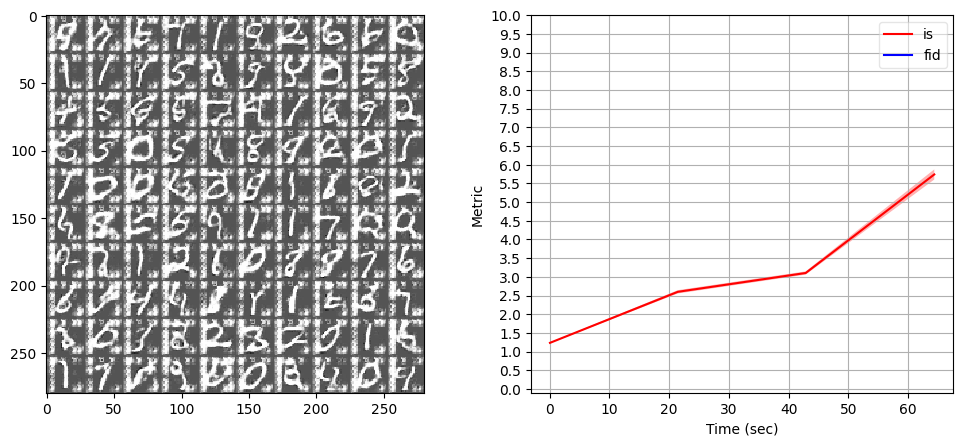

Iter 4000: Mean proba from D(G(z)): 0.4076 +/- 0.1715


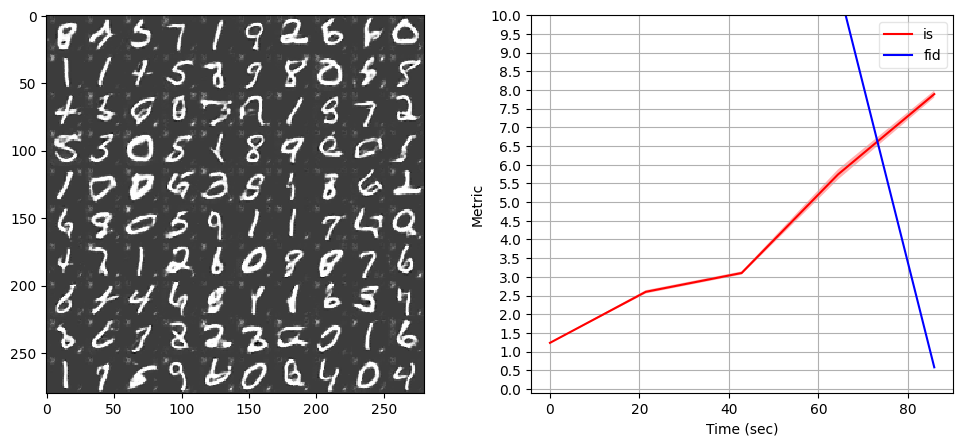

Iter 5000: Mean proba from D(G(z)): 0.5132 +/- 0.2125


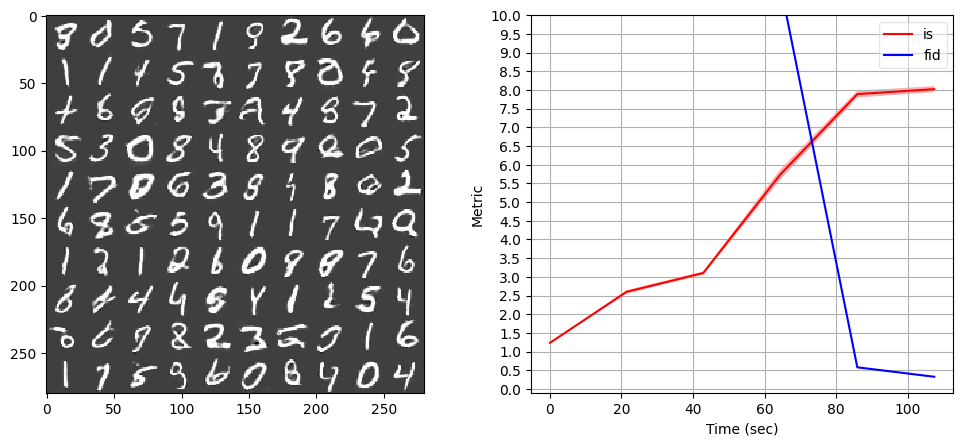

Iter 6000: Mean proba from D(G(z)): 0.3312 +/- 0.1694


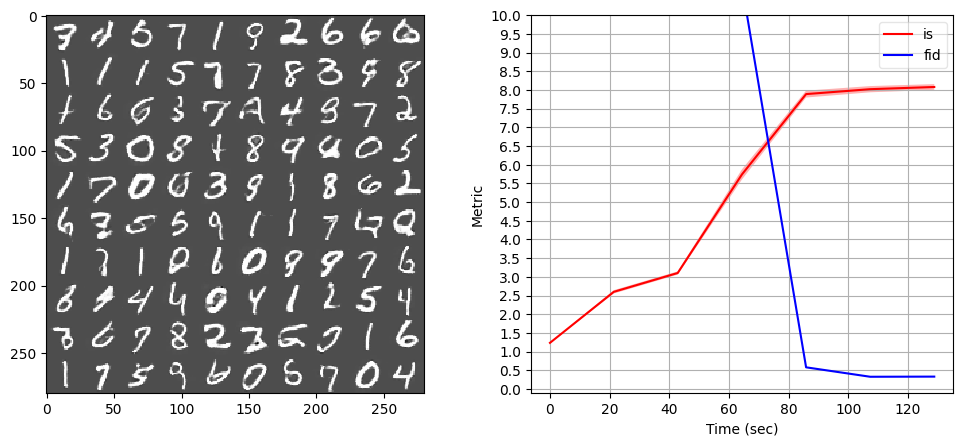

Iter 7000: Mean proba from D(G(z)): 0.2597 +/- 0.1563


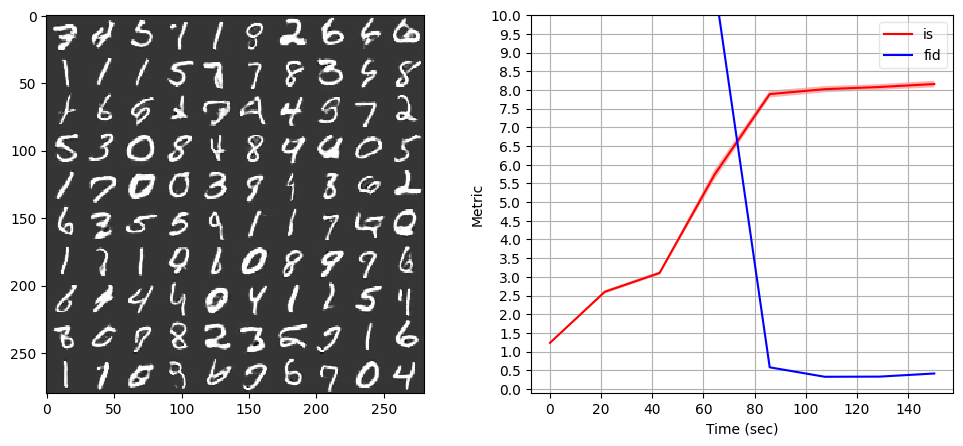

Iter 8000: Mean proba from D(G(z)): 0.2699 +/- 0.1371


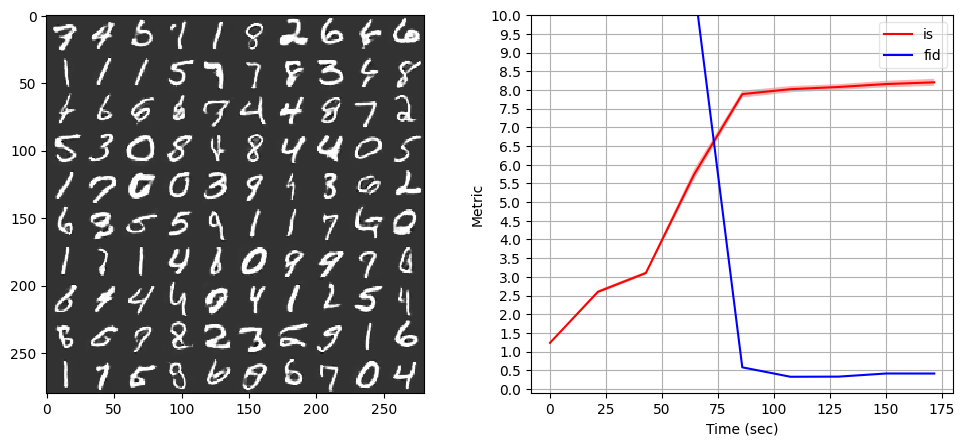

Iter 9000: Mean proba from D(G(z)): 0.3417 +/- 0.1409


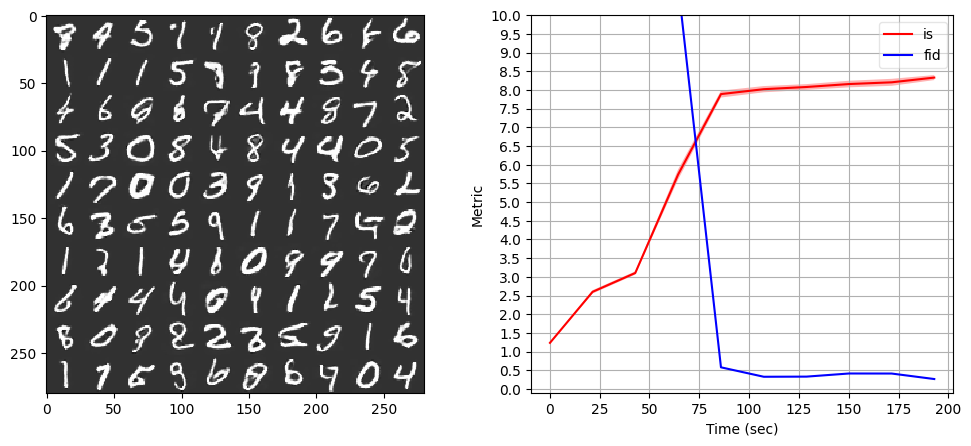

Iter 10000: Mean proba from D(G(z)): 0.2847 +/- 0.1543


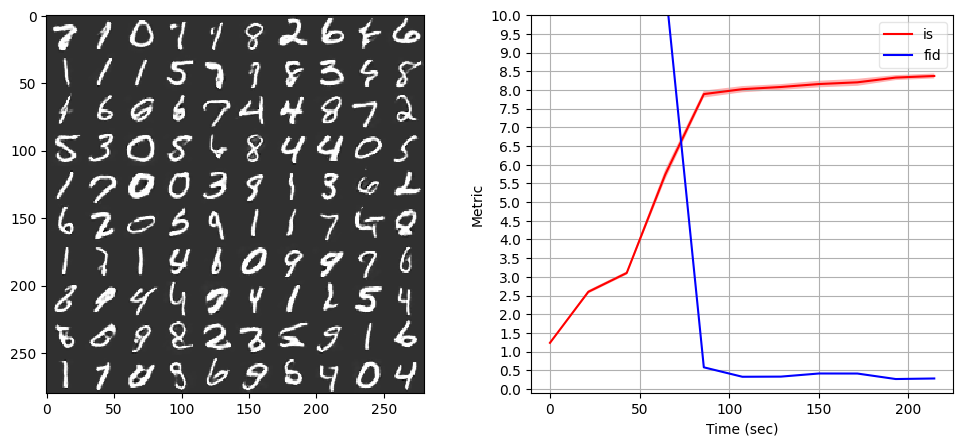

Iter 11000: Mean proba from D(G(z)): 0.3571 +/- 0.1675


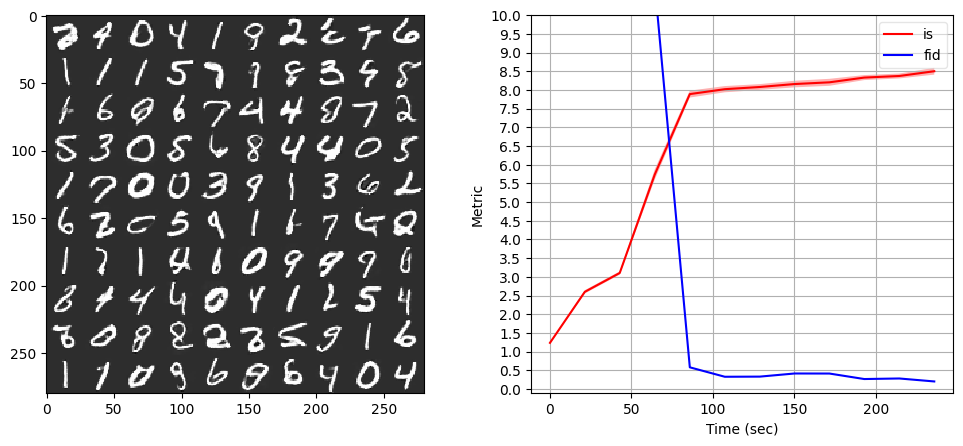

Iter 12000: Mean proba from D(G(z)): 0.4447 +/- 0.1820


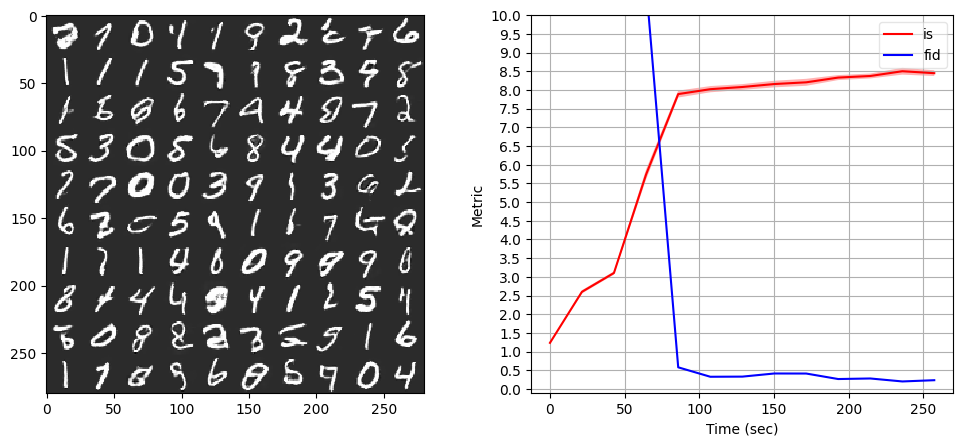

Iter 13000: Mean proba from D(G(z)): 0.4693 +/- 0.1710


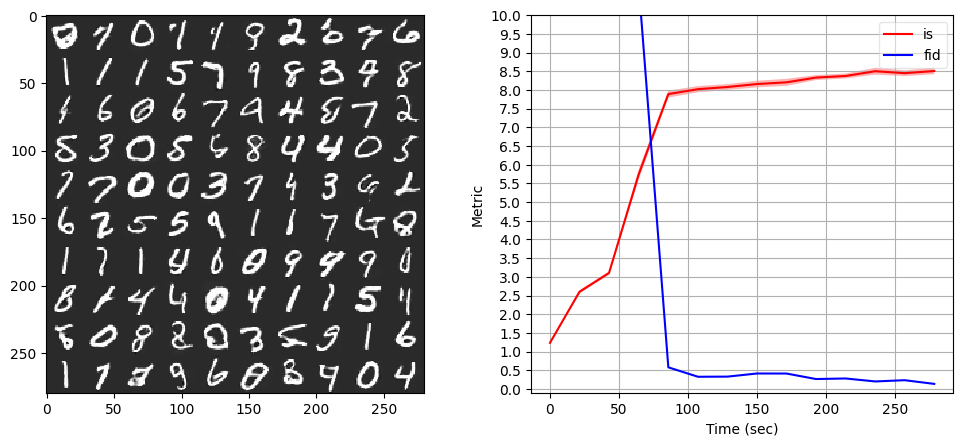

Iter 14000: Mean proba from D(G(z)): 0.4318 +/- 0.1534


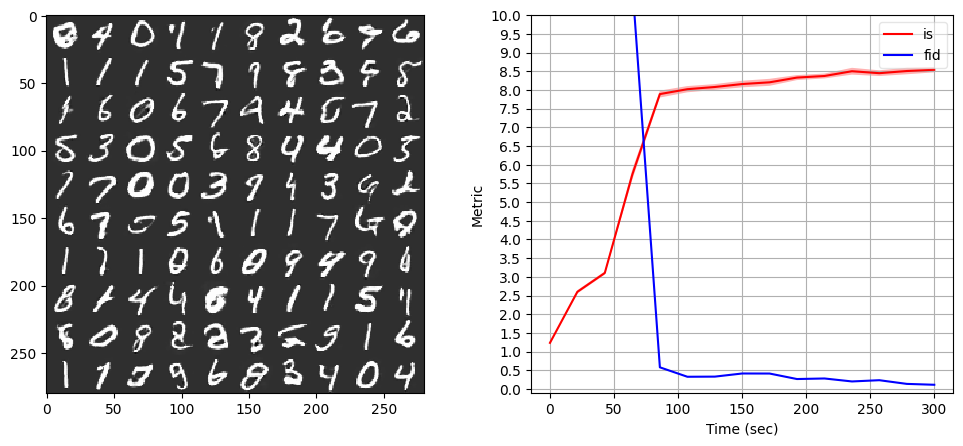

Iter 15000: Mean proba from D(G(z)): 0.5052 +/- 0.1748


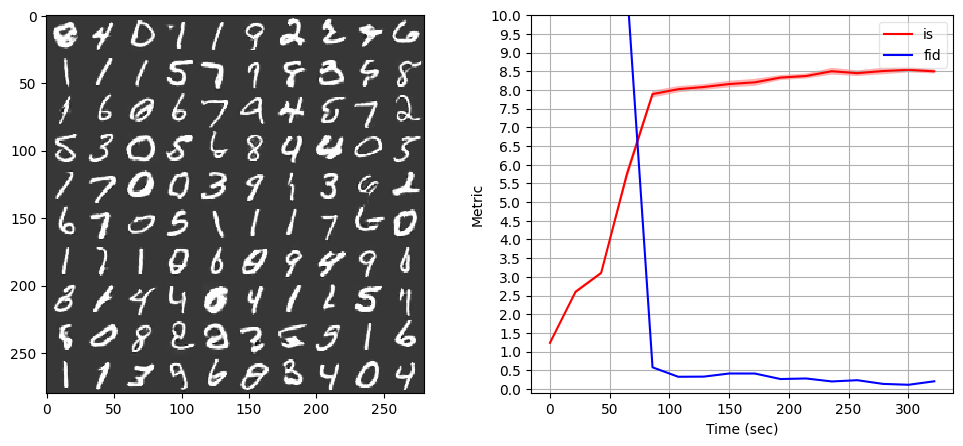

Iter 16000: Mean proba from D(G(z)): 0.4205 +/- 0.1855


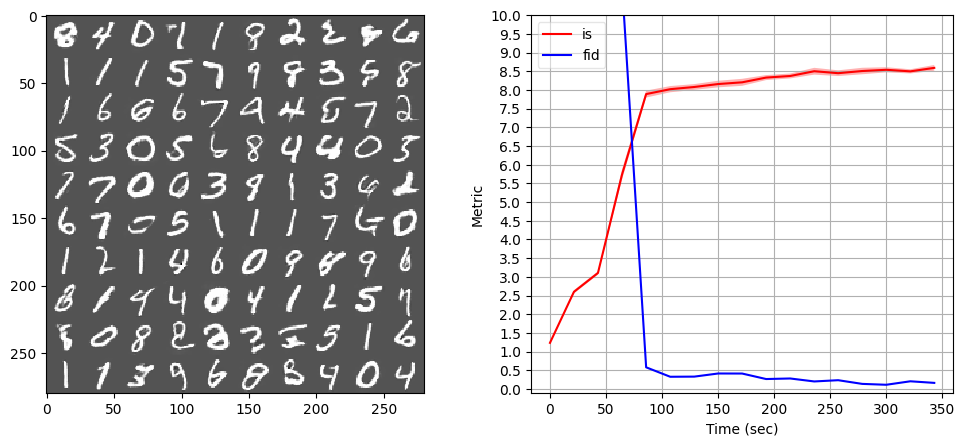

Iter 17000: Mean proba from D(G(z)): 0.3056 +/- 0.1721


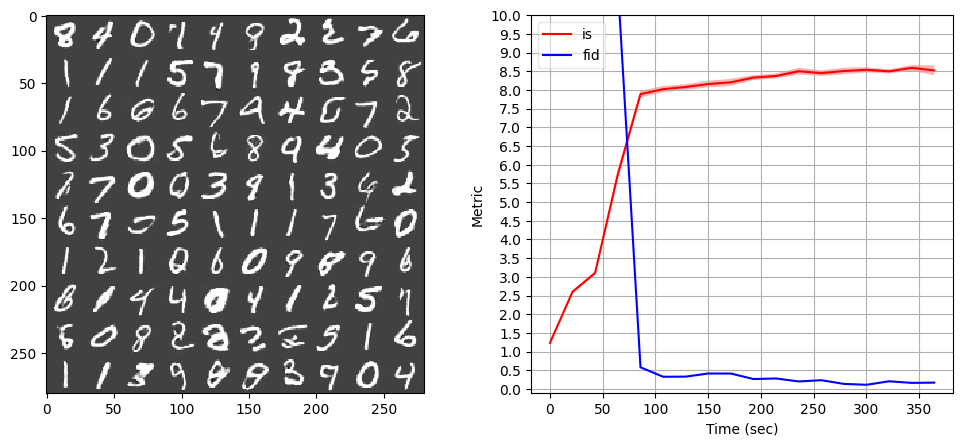

Iter 18000: Mean proba from D(G(z)): 0.3459 +/- 0.1727


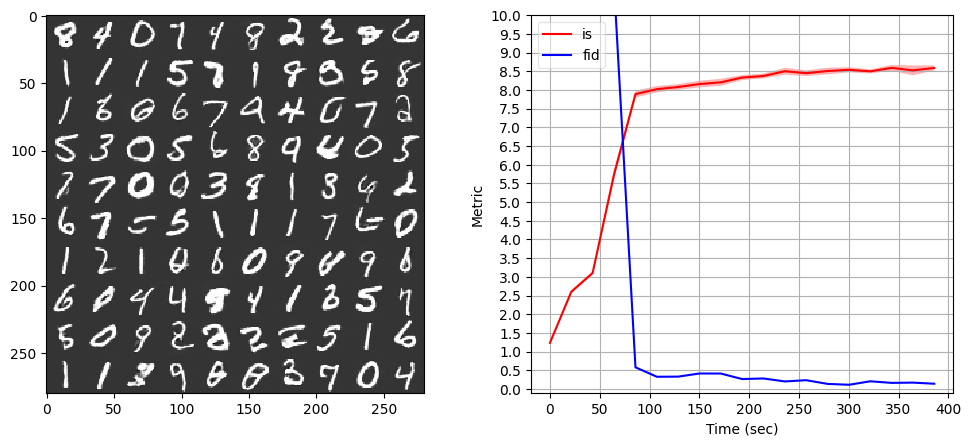

Iter 19000: Mean proba from D(G(z)): 0.3376 +/- 0.1677


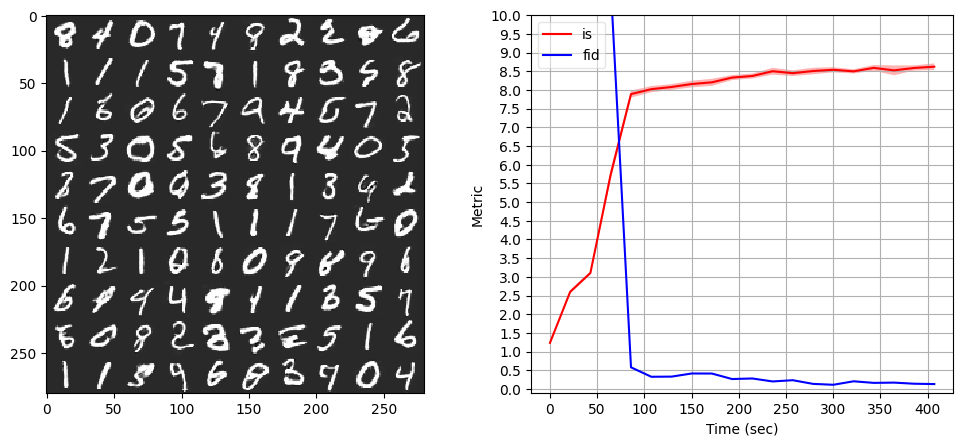

Iter 20000: Mean proba from D(G(z)): 0.2942 +/- 0.1804


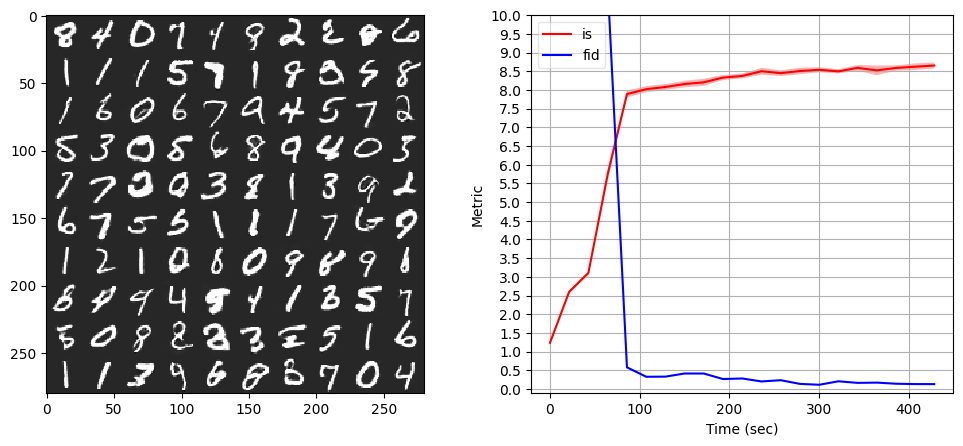

Iter 21000: Mean proba from D(G(z)): 0.3032 +/- 0.1883


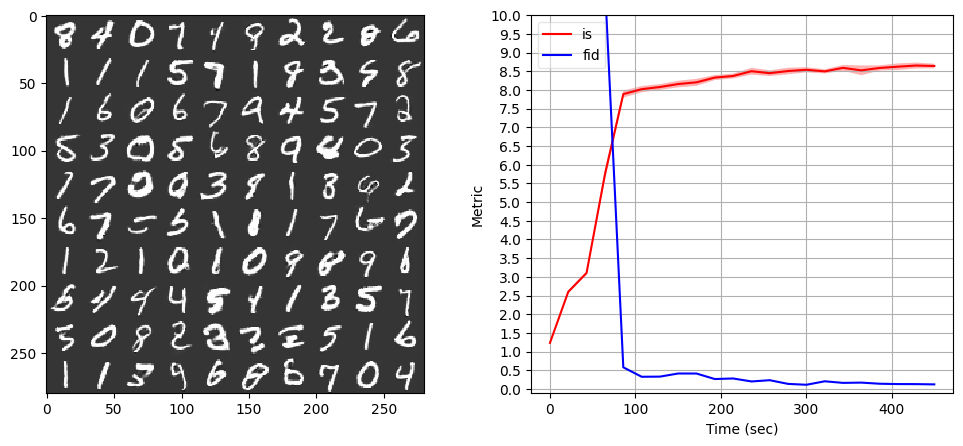

Iter 22000: Mean proba from D(G(z)): 0.2870 +/- 0.1625


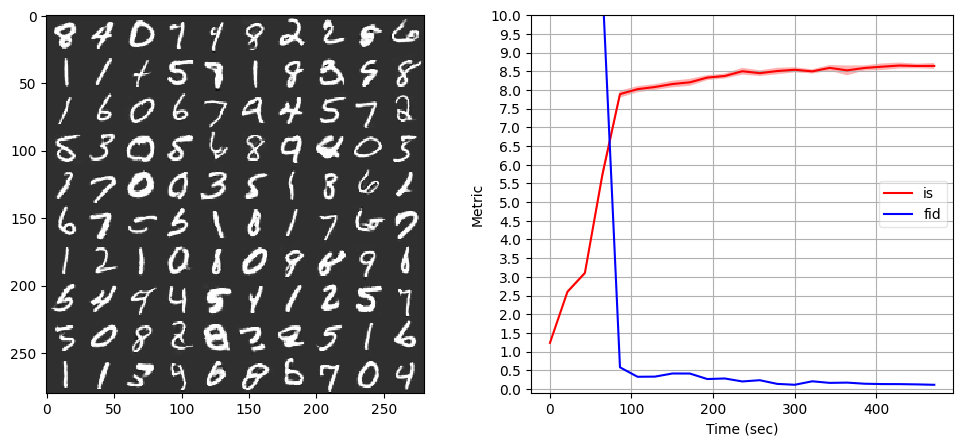

Iter 23000: Mean proba from D(G(z)): 0.2959 +/- 0.1761


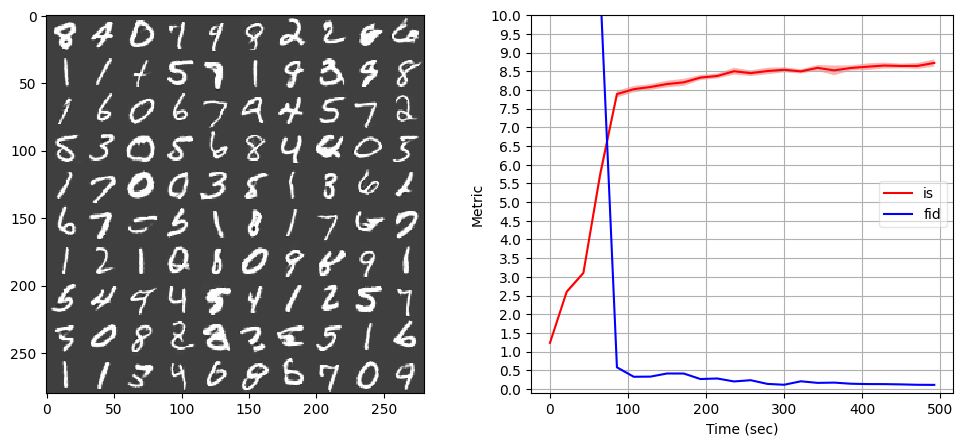

Iter 24000: Mean proba from D(G(z)): 0.4805 +/- 0.2163


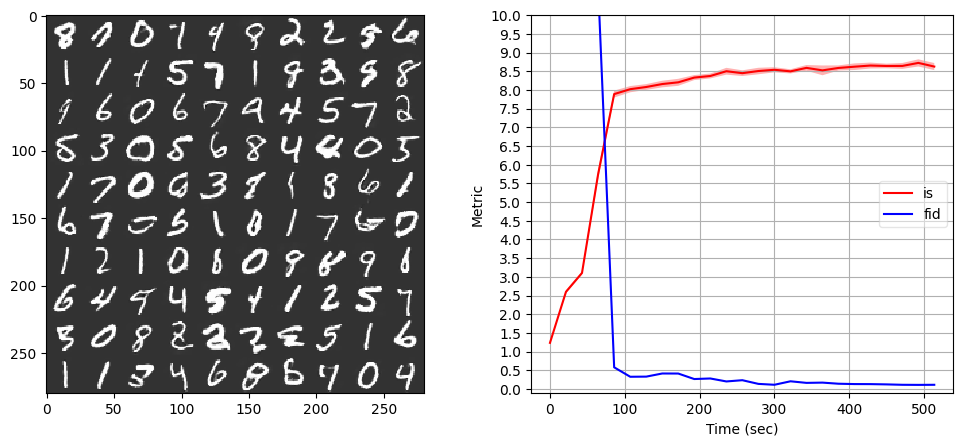

Iter 25000: Mean proba from D(G(z)): 0.4605 +/- 0.2076


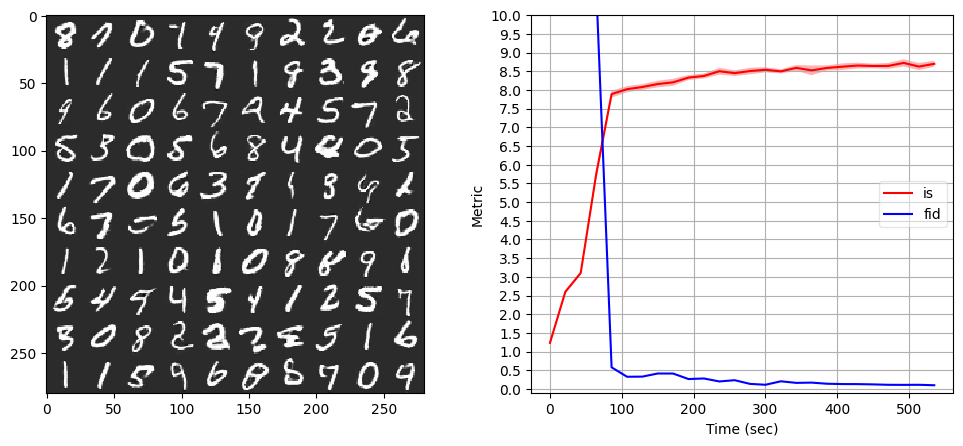

Iter 26000: Mean proba from D(G(z)): 0.4976 +/- 0.2112


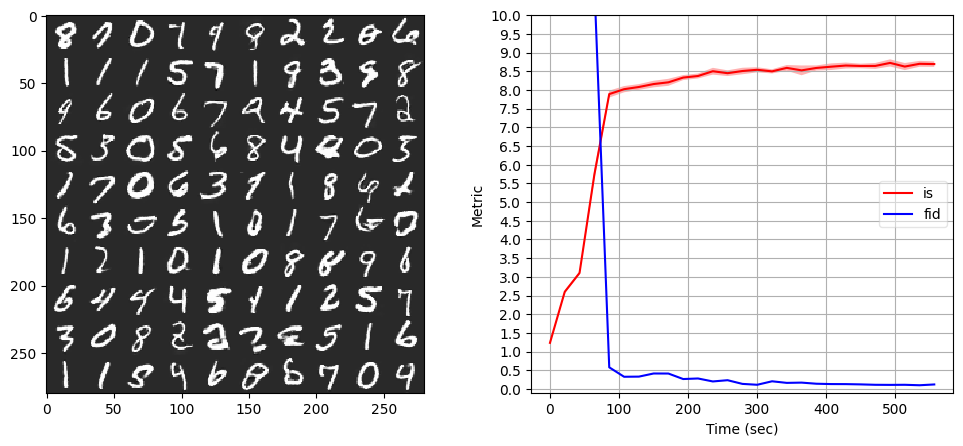

Iter 27000: Mean proba from D(G(z)): 0.4376 +/- 0.2183


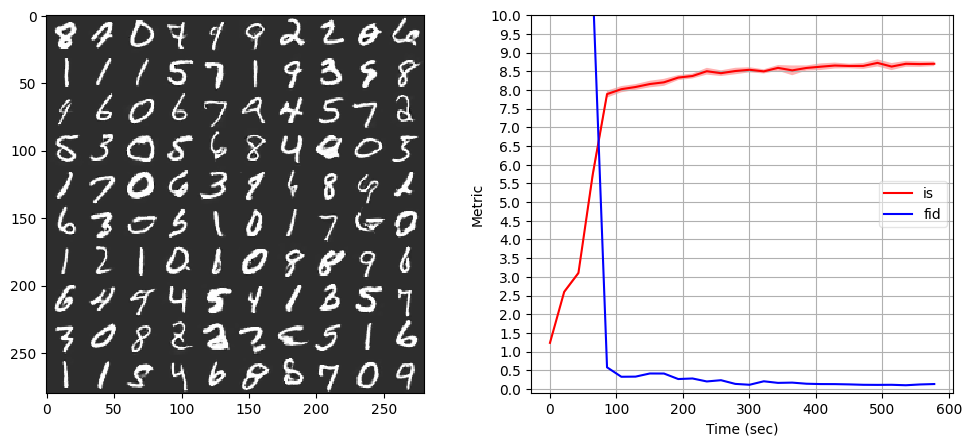

Iter 28000: Mean proba from D(G(z)): 0.3355 +/- 0.2049


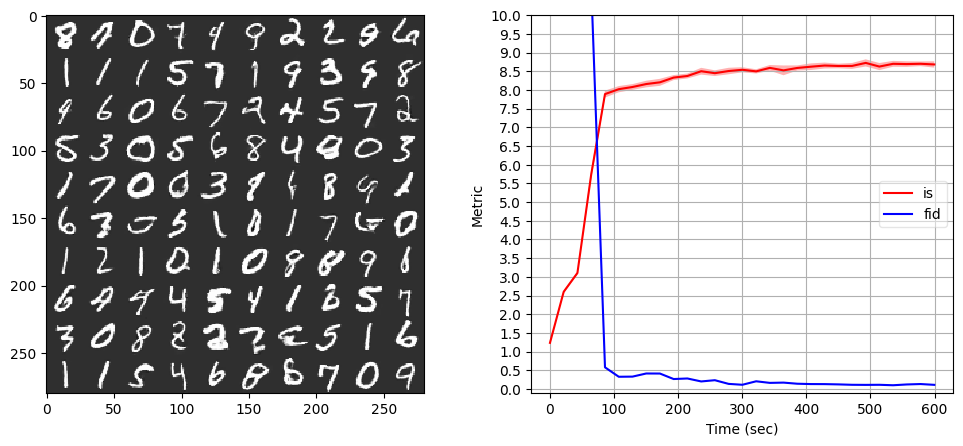

Iter 29000: Mean proba from D(G(z)): 0.2422 +/- 0.1554


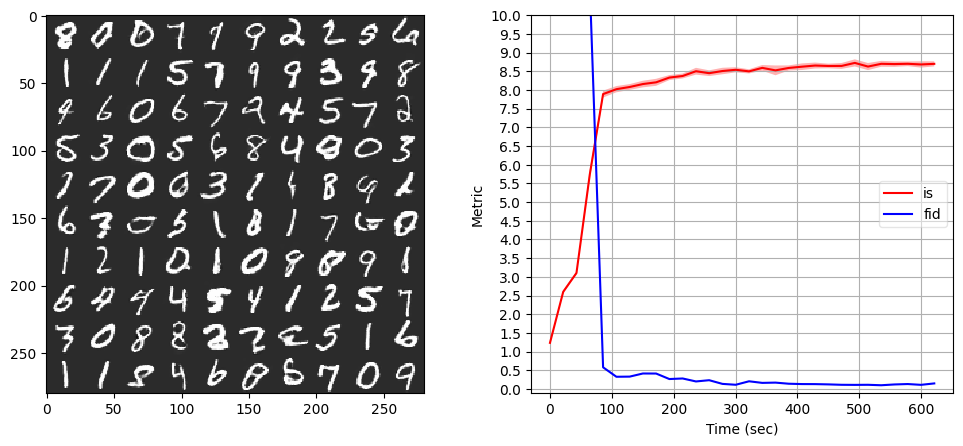

Iter 30000: Mean proba from D(G(z)): 0.3038 +/- 0.1874


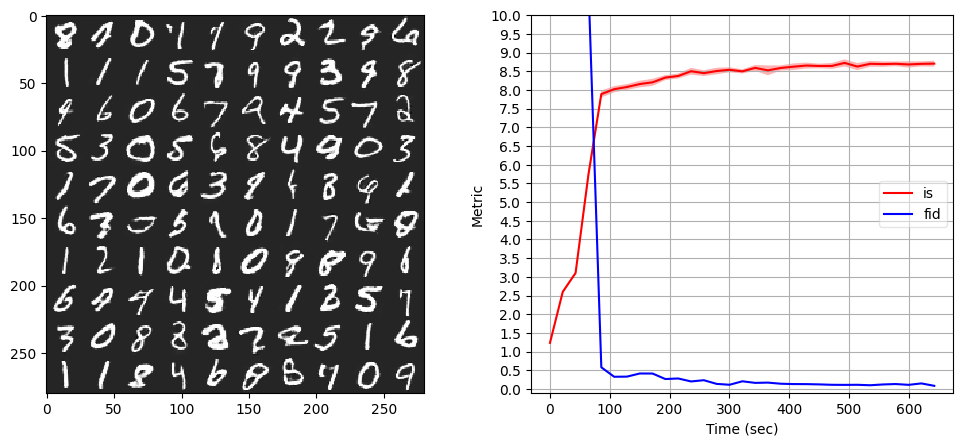

Iter 31000: Mean proba from D(G(z)): 0.3777 +/- 0.2091


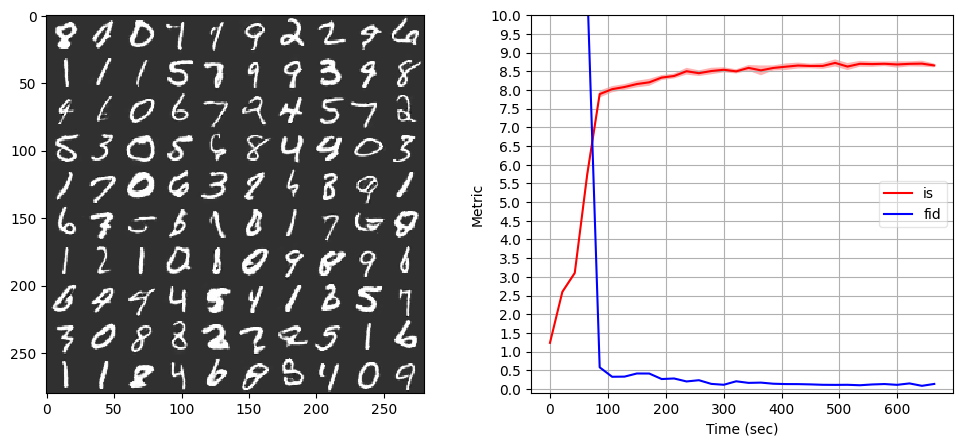

Iter 32000: Mean proba from D(G(z)): 0.3608 +/- 0.1928


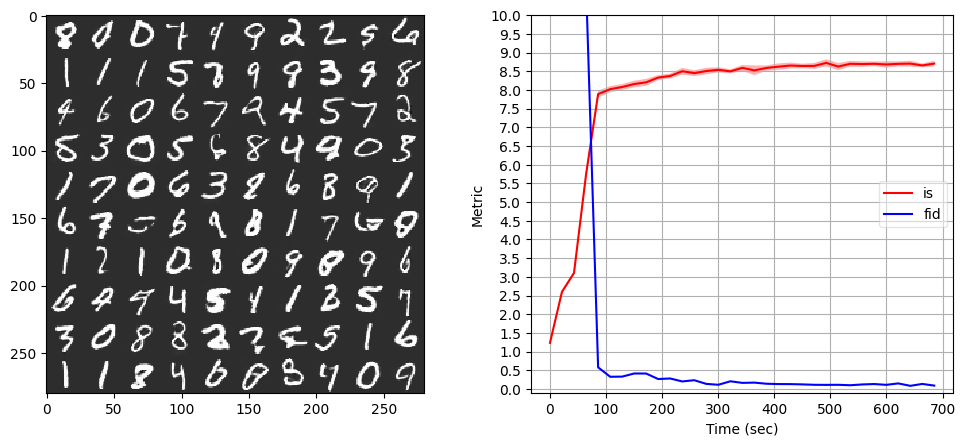

Iter 33000: Mean proba from D(G(z)): 0.3260 +/- 0.1727


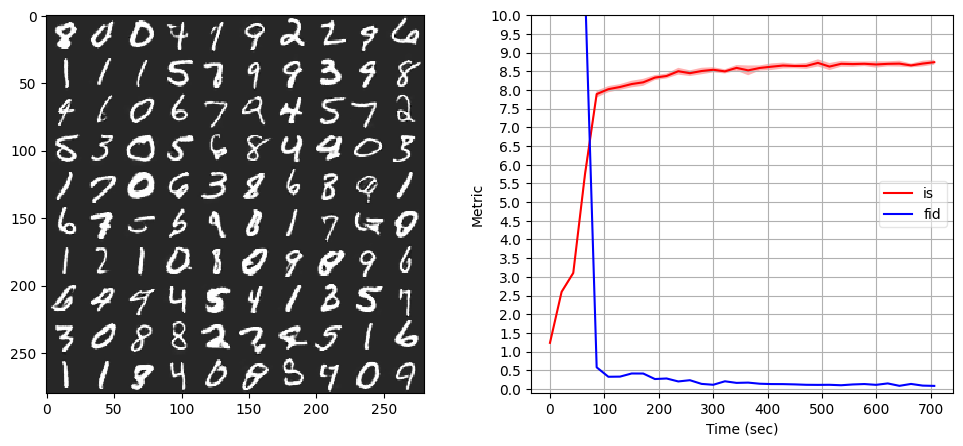

Iter 34000: Mean proba from D(G(z)): 0.1744 +/- 0.1364


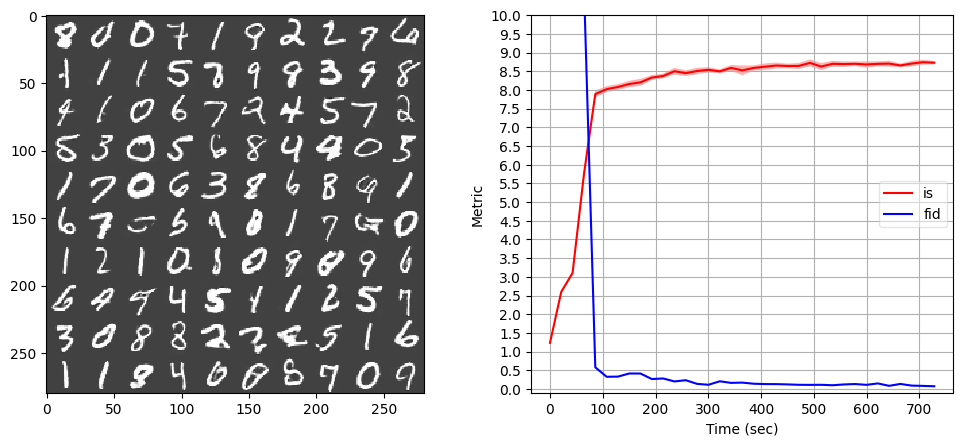

Iter 35000: Mean proba from D(G(z)): 0.1711 +/- 0.1244


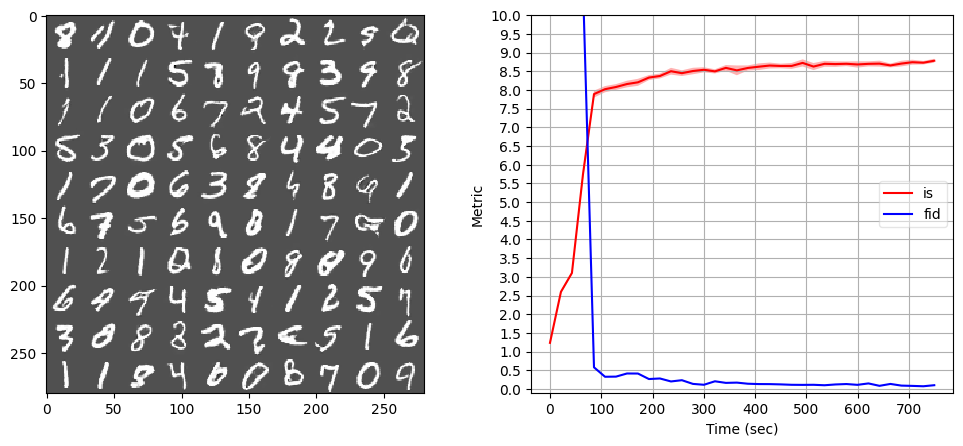

Iter 36000: Mean proba from D(G(z)): 0.2623 +/- 0.1760


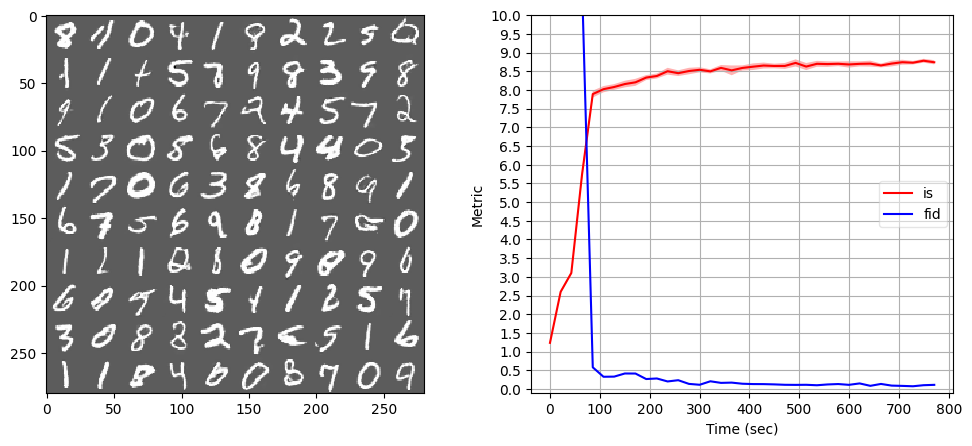

Iter 37000: Mean proba from D(G(z)): 0.2976 +/- 0.1858


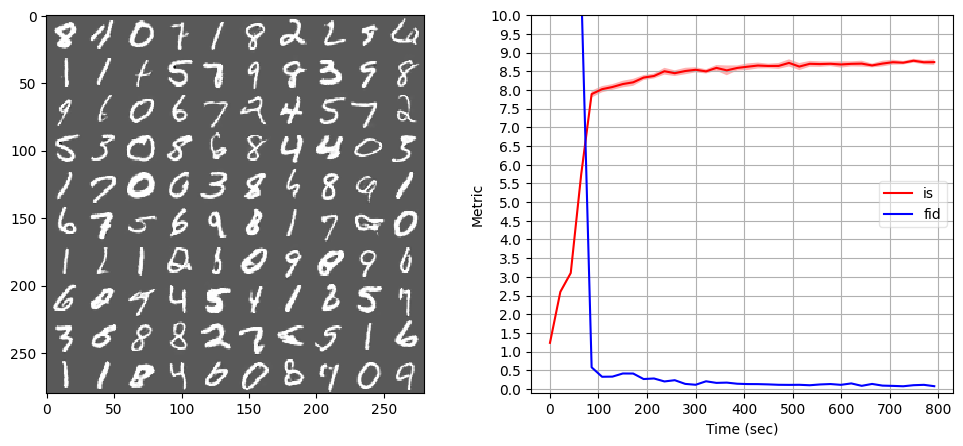

Iter 38000: Mean proba from D(G(z)): 0.3349 +/- 0.2009


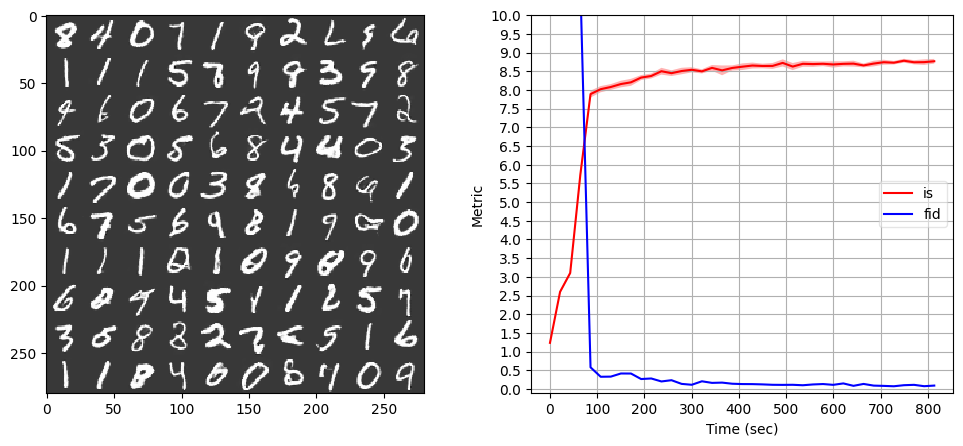

Iter 39000: Mean proba from D(G(z)): 0.4014 +/- 0.2177
Buffered data was truncated after reaching the output size limit.

In [ ]:
args = dict(iterations = 100000,
            batch_size = 50,
            lrD = 0.001,
            lrG = 0.001,
            beta1 = 0.05,
            extragrad = False,
            eval_every = 1000,
            lookahead = True,
            eval_avg = True,
            lookahead_k = 1000,
            n_workers = 5,
            device = 'cuda',
            grad_max_norm = None)


for k in range(1,5+1):
  exp_key = f"iter{args['iterations']}_bs{args['batch_size']}_lrD{args['lrD']}" + \
            f"_lrG{args['lrG']}_beta1{args['beta1']}_lookahead{args['lookahead']}" + \
            f"_lak{args['lookahead_k']}" + \
            f"_extragrad{args['extragrad']}_ee{args['eval_every']}"
  out_dir = f"./drive/My Drive/results/final/{exp_key}/{k}/"

  shutil.rmtree(out_dir, ignore_errors=True)
  if not os.path.exists(out_dir):
    os.makedirs(out_dir)

  with open(os.path.join(out_dir, 'args.json'), 'w') as fs:
    json.dump(args, fs)

  dataset = load_mnist(_data_root='datasets', binarized=False)

  plot_func = get_plot_func(out_dir=out_dir, 
                            img_size=dataset[0][0].size(),
                            num_samples_eval=10000)

  G = GeneratorCNN28(noise_dim=_NOISE_DIM, out_tanh=True)
  D = DiscriminatorCNN28(spectral_norm=False, img_size=28)

  train(G, D, dataset, 
        iterations=args['iterations'], 
        batch_size=args['batch_size'], 
        lookahead=args['lookahead'],
        lookahead_k=args['lookahead_k'],
        eval_avg=args['eval_avg'],
        lrD=args['lrD'], 
        lrG=args['lrG'], 
        beta1=args['beta1'], 
        extragrad=args['extragrad'],
        eval_every=args['eval_every'], 
        n_workers=args['n_workers'], 
        device=torch.device(args['device']), 
        grad_max_norm=args['grad_max_norm'], 
        plot_func=plot_func,
        out_dir=out_dir)

### ExtraGrad

In [ ]:
args = dict(iterations = 100000,
            batch_size = 50,
            lrD = 0.001,
            lrG = 0.001,
            beta1 = 0.05,
            extragrad = True,
            eval_every = 1000,
            lookahead = False,
            eval_avg = True,
            lookahead_k = 1000,
            n_workers = 5,
            device = 'cuda',
            grad_max_norm = None)


for k in range(1,5+1):
  exp_key = f"iter{args['iterations']}_bs{args['batch_size']}_lrD{args['lrD']}" + \
            f"_lrG{args['lrG']}_beta1{args['beta1']}_lookahead{args['lookahead']}" + \
            f"_lak{args['lookahead_k']}" + \
            f"_extragrad{args['extragrad']}_ee{args['eval_every']}"
  out_dir = f"./drive/My Drive/results/final-joint/{exp_key}/{k}/"

  shutil.rmtree(out_dir, ignore_errors=True)
  if not os.path.exists(out_dir):
    os.makedirs(out_dir)

  with open(os.path.join(out_dir, 'args.json'), 'w') as fs:
    json.dump(args, fs)

  dataset = load_mnist(_data_root='datasets', binarized=False)

  plot_func = get_plot_func(out_dir=out_dir, 
                            img_size=dataset[0][0].size(),
                            num_samples_eval=10000)

  G = GeneratorCNN28(noise_dim=_NOISE_DIM, out_tanh=True)
  D = DiscriminatorCNN28(spectral_norm=False, img_size=28)

  train(G, D, dataset, 
        iterations=args['iterations'], 
        batch_size=args['batch_size'], 
        lookahead=args['lookahead'],
        lookahead_k=args['lookahead_k'],
        eval_avg=args['eval_avg'],
        lrD=args['lrD'], 
        lrG=args['lrG'], 
        beta1=args['beta1'], 
        extragrad=args['extragrad'],
        eval_every=args['eval_every'], 
        n_workers=args['n_workers'], 
        device=torch.device(args['device']), 
        grad_max_norm=args['grad_max_norm'], 
        plot_func=plot_func,
        out_dir=out_dir)

### LA-ExtraGrad


In [ ]:
args = dict(iterations = 100000,
            batch_size = 50,
            lrD = 0.001,
            lrG = 0.001,
            beta1 = 0.05,
            extragrad = True,
            eval_every = 1000,
            lookahead = True,
            eval_avg = True,
            lookahead_k = 1000,
            n_workers = 5,
            device = 'cuda',
            grad_max_norm = None)


for k in range(1,5+1):
  exp_key = f"iter{args['iterations']}_bs{args['batch_size']}_lrD{args['lrD']}" + \
            f"_lrG{args['lrG']}_beta1{args['beta1']}_lookahead{args['lookahead']}" + \
            f"_lak{args['lookahead_k']}" + \
            f"_extragrad{args['extragrad']}_ee{args['eval_every']}"
  out_dir = f"./drive/My Drive/results/final/{exp_key}/{k}/"

  shutil.rmtree(out_dir, ignore_errors=True)
  if not os.path.exists(out_dir):
    os.makedirs(out_dir)

  with open(os.path.join(out_dir, 'args.json'), 'w') as fs:
    json.dump(args, fs)

  dataset = load_mnist(_data_root='datasets', binarized=False)

  plot_func = get_plot_func(out_dir=out_dir, 
                            img_size=dataset[0][0].size(),
                            num_samples_eval=10000)

  G = GeneratorCNN28(noise_dim=_NOISE_DIM, out_tanh=True)
  D = DiscriminatorCNN28(spectral_norm=False, img_size=28)

  train(G, D, dataset, 
        iterations=args['iterations'], 
        batch_size=args['batch_size'], 
        lookahead=args['lookahead'],
        lookahead_k=args['lookahead_k'],
        eval_avg=args['eval_avg'],
        lrD=args['lrD'], 
        lrG=args['lrG'], 
        beta1=args['beta1'], 
        extragrad=args['extragrad'],
        eval_every=args['eval_every'], 
        n_workers=args['n_workers'], 
        device=torch.device(args['device']), 
        grad_max_norm=args['grad_max_norm'], 
        plot_func=plot_func,
        out_dir=out_dir)